# Adjusted BARRA-R2/C2 evaluation against NatHERS
For Chun Hsu Su

In [1]:
import xarray as xr
import os
import sys
import glob
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import dask.distributed
from dask.distributed import Client
import tempfile
import dask
import calendar

# Import datafinder
sys.path.append('/home/565/dh4185/mn51-dh4185/repos_collab/dataset_finder/')
from dataset_finder import *

# # Import utils
# sys.path.append('/home/565/dh4185/mn51-dh4185/repos_collab/nesp_bff/')
# import utils

# Static metadata dictionaries
sys.path.append('/home/565/dh4185/mn51-dh4185/repos_collab/nesp_bff/')
from utils import locations, cmap_dict, preprocess_location, update_locations

from sklearn.metrics import confusion_matrix, accuracy_score
from scipy.stats import entropy, wasserstein_distance, chisquare

# plotting niceties
sns.set_style("whitegrid")
plt.rcParams.update({"figure.figsize": (9, 5), "font.size": 12})


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.09/lib/python3.11/site-packages/xclim/sdba.py:12: UserWarning: The `xclim.sdba` module has been split into its own package `xsdba`. Users are encouraged to use `xsdba` directly. For the time being, `xclim.sdba` will import `xsdba` to allow for API compatibility. This behaviour may change in the future. For more information, see: https://xsdba.readthedocs.io/en/stable/xclim_migration_guide.html
  warnings.warn(


In [2]:
# Dask settings
dask.config.set({
    #'array.chunk-size': "256 MiB",
    #'array.slicing.split_large_chunks': True, 
    'distributed.comm.timeouts.connect': '120s',
    'distributed.comm.timeouts.tcp': '120s',
    'distributed.comm.retry.count': 10,
    'distributed.scheduler.allowed-failures': 20,
    "distributed.scheduler.worker-saturation": 1.1, #< This should use the new behaviour which helps with memory pile up
})

mem_lim = "63000mb" # 252000mb 63000mb
worker_n = 20
       
client = Client(n_workers=worker_n, threads_per_worker=1, local_directory = tempfile.mkdtemp(), memory_limit = mem_lim)
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 20
Total threads: 20,Total memory: 1.15 TiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:34473,Workers: 0
Dashboard: /proxy/8787/status,Total threads: 0
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:44553,Total threads: 1
Dashboard: /proxy/45421/status,Memory: 58.67 GiB
Nanny: tcp://127.0.0.1:37477,


In [3]:
##### Settings
loc="Melbourne"

timezone_dict = {"Cairns":"Brisbane","Brisbane":"Brisbane","Melbourne":"Melbourne", "Darwin":"Darwin", 
                 "Longreach":"Brisbane","Mildura":"Melbourne","Adelaide":"Adelaide","Perth":"Perth",
                 "Sydney":"Sydney","Canberra":"Canberra","Hobart":"Hobart"}
start_year="1990"
end_year="2014"

# Directories
root_dir = "/g/data/eg3/nesp_bff/"
raw_barraC2_dir = "/g/data/eg3/spr548/projects/nesp_bff/BARRA-C2_raw_data_extraction/BARRA-C2/"
barraR2_adjust_dir = "/g/data/hd50/barra2/data/trials/chs548/output-Adjust/AUST-11/BOM/ERA5/historical/hres/BARRA-R2/v1-ACS-DailyLinearRescale-AGCDv1/1hr/tasAdjust/v20250701/"
barraC2_adjust_dir = "/g/data/hd50/barra2/data/trials/chs548/output-Adjust/AUST-04/BOM/ERA5/historical/hres/BARRA-C2/v1-ACS-DailyLinearRescale-AGCDv1/1hr/tasAdjust/v20250701/"


In [4]:
# Functions
def preprocess_location(ds,lat,lon):
    return ds.sel(lat=lat,lon=lon, method="nearest")

def convert_to_local_time(da,loc):
    da_loc = da.sel(loc=loc)
    
    # Convert to pandas DatetimeIndex, localize UTC, convert to local, remove tz info
    da_time_local = pd.to_datetime(da_loc.time.values).tz_localize('UTC') \
                                          .tz_convert(f'Australia/{timezone_dict[loc]}') \
                                          .tz_localize(None)
    
    # Assign back to the DataArray
    da_loc_local = da_loc.assign_coords(time=da_time_local)
    return da_loc_local

def compare_monthly_histograms_xr(
    da,
    source1,
    source2,
    location,
    label1='NatHERS',
    label2='BARRA-R2 Adjust',
    bins=25
):
    """
    Compare monthly hourly histograms (Dec–Nov) between two sources
    from an xarray.DataArray with dimensions (time, source).

    Parameters
    ----------
    da : xarray.DataArray
        DataArray with dims ('time', 'source')
    source1, source2 : str or int
        Values/indexers in the 'source' dimension to compare
    location: str
        Location for data
    label1, label2 : str
        Legend labels
    bins : int
        Number of histogram bins
    """

    # A4 portrait size
    figsize = (8.27, 11.69)
    fig, axes = plt.subplots(4, 3, figsize=figsize, sharex=True, sharey=True)
    axes = axes.flatten()

    # Month order starting from December
    month_order = [12, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]

    for i, month in enumerate(month_order):
        ax = axes[i]

        # Select data for the month and sources
        data1 = (
            da.sel(time=da['time.month'] == month, source=source1)
              .values
              .ravel()
        )
        data2 = (
            da.sel(time=da['time.month'] == month, source=source2)
              .values
              .ravel()
        )

        # Remove NaNs
        data1 = data1[~np.isnan(data1)]
        data2 = data2[~np.isnan(data2)]

        # Plot histograms
        sns.histplot(
            data1,
            bins=bins,
            kde=True,
            stat='density',
            alpha=0.4,
            color='orange',
            ax=ax,
            label=label1 if i == 0 else ""
        )

        sns.histplot(
            data2,
            bins=bins,
            kde=True,
            stat='density',
            alpha=0.4,
            color='blue',
            ax=ax,
            label=label2 if i == 0 else ""
        )

        # Monthly means
        if data1.size > 0 and data2.size > 0:
            mean1 = data1.mean()
            mean2 = data2.mean()
            diff = mean2 - mean1

            ax.axvline(mean1, color='orange', linestyle='--', lw=1)
            ax.axvline(mean2, color='blue', linestyle='--', lw=1)
            title = f"{calendar.month_abbr[month]} (Δμ={diff:.2f})"
        else:
            title = f"{calendar.month_abbr[month]} (no data)"

        # Axis labels
        if i in [0, 3, 6, 9]:
            ax.set_ylabel("Density", fontsize=9)

        if i >= 9:
            ax.set_xlabel(f"{da.name} [{da.attrs['units']}]", fontsize=9)

        # Legend only once
        if i == 0:
            ax.legend(loc="upper left", fontsize=8, frameon=False)

        ax.set_title(title, fontsize=10)

    # # Shared labels & layout
    # fig.text(0.04, 0.5, 'Density', va='center', rotation='vertical', fontsize=12)

    fig.suptitle(
        f"{l}: Comparison of hourly distribution of {da.name} (starting from Dec)",
        fontsize=11,
        weight='bold'
    )

    plt.tight_layout(pad=1.1, rect=[0, 0, 1, 1])
    plt.show()

def plot_monthly_difference_histograms_xr(
    da,
    obs_source,
    model_source,
    location,
    xlim=(-15, 15),
    ylim=(0, 0.4),
    bins=30
):
    """
    Plot monthly histograms of (Model - Obs) differences for hourly xarray data.

    Parameters
    ----------
    da : xarray.DataArray
        Dimensions must include ('month', 'source', 'time')
    obs_source, model_source : str
        Values in the 'source' coordinate
    location: str
        Location of the data
    xlim, ylim : tuple
        Axis limits
    bins : int
        Number of histogram bins
    """

    # Difference: model - obs
    da_diff = da.sel(source=model_source) - da.sel(source=obs_source)

    # Month order starting from December
    month_order = [12] + list(range(1, 12))

    figsize = (8.27, 11.69)
    fig, axes = plt.subplots(4, 3, figsize=figsize, sharex=True, sharey=True)
    axs = axes.flatten()

    for i, mon in enumerate(month_order):
        ax = axs[i]
        mon_name = calendar.month_abbr[mon]

        # Select month and flatten time dimension
        hr_diff = (
            da_diff.sel(time=da['time.month'] == mon)
                   .values
                   .ravel()
        )

        # Drop NaNs
        hr_diff = hr_diff[~np.isnan(hr_diff)]

        if hr_diff.size == 0:
            ax.set_title(f"{mon_name} (no data)")
            ax.axis("off")
            continue

        # Histogram
        sns.histplot(
            hr_diff,
            bins=bins,
            stat="density",
            ax=ax,
            color="steelblue",
            alpha=0.6
        )

        # Stats
        ax.text(0.6, 0.90, f"Min = {hr_diff.min():.1f}", transform=ax.transAxes)
        ax.text(0.6, 0.80, f"Max = {hr_diff.max():.1f}", transform=ax.transAxes)

        # Formatting
        ax.axvline(0, color="0.3", linestyle="--")
        ax.set_xlim(xlim)
        ax.set_ylim(ylim)
        ax.set_title(mon_name, fontsize=11)

        ax.xaxis.set_major_locator(plt.MultipleLocator(5))
        ax.xaxis.set_minor_locator(plt.MultipleLocator(1))
        ax.yaxis.set_major_locator(plt.MultipleLocator(0.05))

        if i in [0, 3, 6, 9]:
            ax.set_ylabel("Density", fontsize=9)
        if i >= 9:
            ax.set_xlabel(
                f"Hourly differences of {da.name} [{da.attrs['units']}]",
                fontsize=9
            )

    fig.suptitle(
        f"{location}: Distribution of hourly {da.name} differences "
        f"({model_source} − {obs_source}, starting from Dec)",
        fontsize=11,
        weight="bold"
    )

    plt.tight_layout(pad=1.1, rect=[0, 0, 1, 1])
    plt.show()


def plot_monthly_two_difference_histograms_xr(
    da,
    location,
    obs_source="NatHERS",
    model1_source="BARRA-R2",
    model2_source="BARRA-R2 Adjust",
    xlim=(-15, 15),
    ylim=(0, 0.4),
    bins=50
):
    """
    Plot monthly histograms of two difference distributions:
    Diff 1 = Obs - Model1
    Diff 2 = Obs - Model2
    """

    # Differences
    da_diff1 = da.sel(source=obs_source) - da.sel(source=model1_source)
    da_diff2 = da.sel(source=obs_source) - da.sel(source=model2_source)

    month_order = [12] + list(range(1, 12))

    figsize = (8.27, 11.69)
    fig, axes = plt.subplots(4, 3, figsize=figsize, sharex=True, sharey=True)
    axs = axes.flatten()

    for i, mon in enumerate(month_order):
        ax = axs[i]
        mon_name = calendar.month_abbr[mon]

        # Flatten time dimension
        diff1 = da_diff1.sel(time=da["time.month"] == mon).values.ravel()
        diff2 = da_diff2.sel(time=da["time.month"] == mon).values.ravel()

        diff1 = diff1[~np.isnan(diff1)]
        diff2 = diff2[~np.isnan(diff2)]

        if diff1.size == 0 and diff2.size == 0:
            ax.set_title(f"{mon_name} (no data)")
            ax.axis("off")
            continue

        # Determine shared min/max for the month
        vmin = min(diff1.min(), diff2.min())
        vmax = max(diff1.max(), diff2.max())
        
        # Create common bin edges
        bin_edges = np.linspace(vmin, vmax, bins + 1)
        
        # Plot histograms using the same bin edges
        sns.histplot(
            diff1,
            bins=bin_edges,
            stat="density",
            color="steelblue",
            alpha=0.45,
            ax=ax,
            label=f"{model1_source}"
        )
        
        sns.histplot(
            diff2,
            bins=bin_edges,
            stat="density",
            color="darkorange",
            alpha=0.45,
            ax=ax,
            label=f"{model2_source}"
        )

        # Min / max stats
        d1_min, d1_max = diff1.min(), diff1.max()
        d2_min, d2_max = diff2.min(), diff2.max()

        ax.text(
            0.02, 0.95,
            f"{model1_source}:\n"
            f"min = {d1_min:.1f}\n"
            f"max = {d1_max:.1f}",
            transform=ax.transAxes,
            fontsize=8,
            va="top",
            color="steelblue",
            bbox=dict(
                facecolor="white",
                edgecolor="none",
                alpha=0.8
            )
        )

        ax.text(
            0.60, 0.95,
            f"{model2_source}:\n"
            f"min = {d2_min:.1f}\n"
            f"max = {d2_max:.1f}",
            transform=ax.transAxes,
            fontsize=8,
            va="top",
            color="darkorange",
            bbox=dict(
                facecolor="white",
                edgecolor="none",
                alpha=0.8
            )
        )

        # Formatting
        ax.axvline(0, color="0.3", linestyle="--")
        ax.set_xlim(xlim)
        ax.set_ylim(ylim)
        ax.set_title(mon_name, fontsize=11)

        ax.xaxis.set_major_locator(plt.MultipleLocator(5))
        ax.xaxis.set_minor_locator(plt.MultipleLocator(1))
        ax.yaxis.set_major_locator(plt.MultipleLocator(0.05))

        if i in [0, 3, 6, 9]:
            ax.set_ylabel("Density", fontsize=9)
        if i >= 9:
            ax.set_xlabel(
                f"Hourly differences of {da.name} [{da.attrs['units']}]",
                fontsize=9
            )

        # Legend only once
        if i == 0:
            ax.legend(
                loc="lower right",
                bbox_to_anchor=(1.2, 0.58),
                frameon=False,
                fontsize=8
            )

    fig.suptitle(
        f"{location}: Distribution of hourly {da.name} differences (NatHERS - x)"
        f"(starting from Dec)",
        fontsize=11,
        weight="bold"
    )

    plt.tight_layout(pad=1.1, rect=[0, 0, 1, 1])
    plt.show()
    
from scipy.stats import ks_2samp, mannwhitneyu

def daily_stat_from_hourly(da, stat_type):
    """
    Compute daily statistic from hourly xarray DataArray.
    """
    if stat_type == "maximum":
        return da.resample(time="1D").max()
    elif stat_type == "minimum":
        return da.resample(time="1D").min()
    elif stat_type == "mean":
        tmax = da.resample(time="1D").max()
        tmin = da.resample(time="1D").min()
        return 0.5 * (tmax + tmin)
    else:
        raise ValueError(f"Unknown stat_type: {stat_type}")

def print_monthly_test_stats(
    loc,
    stat_type,
    month,
    obs_vals,
    mod_vals,
    conf_lev
):
    ks_stat, ks_p = ks_2samp(obs_vals, mod_vals)
    mw_stat, mw_p = mannwhitneyu(obs_vals, mod_vals)

    sig_ks = "SIG" if ks_p <= conf_lev else "ns"
    sig_mw = "SIG" if mw_p <= conf_lev else "ns"

    print(
        f"{loc:12s} | {stat_type:8s} | {calendar.month_abbr[month]:>3s} | "
        f"KS: stat={ks_stat:6.3f}, p={ks_p:6.3f} ({sig_ks}) | "
        f"MW: stat={mw_stat:8.1f}, p={mw_p:6.3f} ({sig_mw})"
    )


import numpy as np
import matplotlib.pyplot as plt
import calendar
from scipy.stats import ks_2samp, mannwhitneyu


def plot_monthly_daily_distribution_xr(
    da_loc,
    loc,
    obs_source="NatHERS",
    model_source="BARRA-R2",
    var_name="tasAdjust",
    stat_type_list=("maximum", "minimum", "mean"),
    conf_lev=0.1,
):
    """
    Pure xarray version of monthly daily-statistic comparison.
    """

    # Select sources
    da_obs = da_loc.sel(source=obs_source)
    da_mod = da_loc.sel(source=model_source)

    months = np.arange(1, 13)
    month_names = [calendar.month_abbr[m] for m in months]

    for stat_type in stat_type_list:

        print("\n" + "=" * 90)
        print(f"{loc} — DAILY {stat_type.upper()} TEMPERATURE")
        print("=" * 90)

        # --- daily stats ---
        obs_dly = daily_stat_from_hourly(da_obs, stat_type)
        mod_dly = daily_stat_from_hourly(da_mod, stat_type)

        # containers
        obs_month = {}
        mod_month = {}
        mod_sig   = {}

        # --- month-wise distributions + significance ---
        for m in months:
            o = obs_dly.sel(time=obs_dly.time.dt.month == m).values.flatten()
            r = mod_dly.sel(time=mod_dly.time.dt.month == m).values.flatten()

            o = o[~np.isnan(o)]
            r = r[~np.isnan(r)]

            obs_month[m] = o
            mod_month[m] = r

            if len(o) > 0 and len(r) > 0:
            
                # print stats
                print_monthly_test_stats(
                    loc=loc,
                    stat_type=stat_type,
                    month=m,
                    obs_vals=o,
                    mod_vals=r,
                    conf_lev=conf_lev,
                )
            
                ks_stat, p_ks = ks_2samp(o, r)
                mw_stat, p_mw = mannwhitneyu(o, r)
            
                if (p_ks <= conf_lev) and (p_mw <= conf_lev):
                    mod_sig[m] = r
                else:
                    mod_sig[m] = np.array([])

            else:
                mod_sig[m] = np.array([])

        # =========================
        # Plot OBS vs MODEL
        # =========================
        fig, ax = plt.subplots(figsize=(10, 6))

        pos = np.arange(12)

        bp_obs = ax.boxplot(
            [obs_month[m] for m in months],
            positions=pos - 0.15,
            widths=0.25,
            patch_artist=True,
            boxprops=dict(facecolor="white", color="orange"),
            medianprops=dict(color="k"),
            manage_ticks=False,
        )

        bp_mod = ax.boxplot(
            [mod_month[m] for m in months],
            positions=pos + 0.15,
            widths=0.25,
            patch_artist=True,
            boxprops=dict(facecolor="white", color="blue"),
            medianprops=dict(color="k"),
            manage_ticks=False,
        )

        # significant months (filled)
        ax.boxplot(
            [mod_sig[m] for m in months],
            positions=pos + 0.15,
            widths=0.25,
            patch_artist=True,
            boxprops=dict(facecolor="blue", color="blue"),
            medianprops=dict(color="k"),
            manage_ticks=False,
        )

        ax.set_xticks(pos)
        ax.set_xticklabels(month_names)
        ax.set_ylabel(f"Daily {stat_type} temperature (°C)")
        ax.set_title(f"{loc} – Daily {stat_type} temperature")
        ax.legend(
            [bp_obs["boxes"][0], bp_mod["boxes"][0]],
            [obs_source, model_source],
            loc="upper center",
        )

        ax.yaxis.set_major_locator(plt.MultipleLocator(5))
        ax.yaxis.set_minor_locator(plt.MultipleLocator(1))

        plt.show()
        plt.close()

        # =========================
        # Plot DIFFERENCES
        # =========================
        fig, ax = plt.subplots(figsize=(10, 6))

        diffs = {m: mod_month[m] - obs_month[m] for m in months}
        diffs_sig = {
            m: diffs[m] if len(mod_sig[m]) > 0 else np.array([])
            for m in months
        }

        bp_diff = ax.boxplot(
            [diffs[m] for m in months],
            widths=0.4,
            patch_artist=True,
            boxprops=dict(facecolor="white", color="0.2"),
            medianprops=dict(color="k"),
            manage_ticks=False,
        )

        ax.boxplot(
            [diffs_sig[m] for m in months],
            widths=0.4,
            patch_artist=True,
            boxprops=dict(facecolor="0.2", color="0.2"),
            medianprops=dict(color="k"),
            manage_ticks=False,
        )

        ax.axhline(0, color="k", linestyle="--")
        ax.set_xticks(pos)
        ax.set_xticklabels(month_names)
        ax.set_ylabel(f"Difference in daily {stat_type} temperature (°C)")
        ax.set_title(f"{loc} – {model_source} minus {obs_source}")

        ax.yaxis.set_major_locator(plt.MultipleLocator(4))
        ax.yaxis.set_minor_locator(plt.MultipleLocator(1))

        plt.show()
        plt.close()

from IPython.display import display, HTML

def display_location_header(loc):
    display(HTML(f"<h2 style='text-align:center; margin-top:30px'>{loc}</h2>"))


## Compiling dataset with NatHERS, BARRA-R2 (Adjust) and BARRA-C2 (Adjust)

In [7]:
%%time
# Corrects location coordinates specified in locations dictionary in utils.py to ensure the selected grid cell from an RCM is on land.  
barra_r2_sftlf = xr.open_dataset("/g/data/ob53/BARRA2/output/reanalysis/AUS-11/BOM/ERA5/historical/hres/BARRA-R2/v1/fx/sftlf/latest/sftlf_AUS-11_ERA5_historical_hres_BOM_BARRA-R2_v1.nc").sftlf
loc_update_barra_r2 = update_locations(barra_r2_sftlf,locations)
barra_c2_sftlf = xr.open_dataset("/g/data/ob53/BARRA2/output/reanalysis/AUST-04/BOM/ERA5/historical/hres/BARRA-C2/v1/fx/sftlf/latest/sftlf_AUST-04_ERA5_historical_hres_BOM_BARRA-C2_v1.nc").sftlf
loc_update_barra_c2 = update_locations(barra_c2_sftlf,locations)
    
loc_list_barra_r2=[]
loc_list_barra_c2=[]
loc_list_barra_c2_adj=[]
loc_list_barra_r2_adj=[]
loc_list_nathers=[]

for loc in timezone_dict:
    print(loc)
    
    # NatHERS
    ds_nathers = xr.open_dataset(glob.glob(f"{root_dir}/NatHERS/raw_data/{loc}_*_NatHERS_1990-2015.nc")[0]).tas.load()
    print(f"NatHERS coordinates for {loc}: Lat: {ds_nathers.lat.values}, Lon: {ds_nathers.lon.values}")

    # BARRA-R2
    ds_barra_r2 = xr.open_dataset(f"{root_dir}step1_raw_data_extraction/BARRA-R2/{loc}_AUS-11_ERA5_historical_hres_BOM_BARRA-R2_v1_1hr_1985-2014.nc").sel(time=slice("1990","2014")).tas.load()
    print(f"BARRA-R2 (raw) coordinates for {loc}: Lat: {ds_barra_r2.lat.values}, Lon: {ds_barra_r2.lon.values}")
    
    # BARRA-C2
    ds_barra_c2 = xr.open_dataset(f"{raw_barraC2_dir}{loc}_AUST-04_ERA5_historical_hres_BOM_BARRA-C2_v1_1hr_1985-2024.nc").sel(time=slice("1990","2014")).tas.load()
    print(f"BARRA-C2 (raw) coordinates for {loc}: Lat: {ds_barra_c2.lat.values}, Lon: {ds_barra_c2.lon.values}")

    # adjusted BARRA-R data
    ds_barra_r2adj = xr.open_mfdataset(glob.glob(f"{barraR2_adjust_dir}tasAdjust_AUST-11_ERA5_historical_hres_BOM_BARRA-R2_v1_ACS-DailyLinearRescale-AGCDv1_1hr_*.nc"), parallel=True,
                        preprocess=lambda ds: preprocess_location(ds, 
                                                                    loc_update_barra_r2[loc]['Lat'],
                                                                    loc_update_barra_r2[loc]['Lon'])).sel(time=slice(start_year,end_year)).tasAdjust.load()
    print(f"BARRA-R2 Adjust coordinates for {loc}: Lat: {ds_barra_r2adj.lat.values}, Lon: {ds_barra_r2adj.lon.values}")

    # adjusted barra c2 data
    ds_barra_c2adj = xr.open_mfdataset(glob.glob(f"{barraC2_adjust_dir}tasAdjust_AUST-04_ERA5_historical_hres_BOM_BARRA-C2_v1_ACS-DailyLinearRescale-AGCDv1_1hr_*.nc"), parallel=True,
                        preprocess=lambda ds: preprocess_location(ds, 
                                                                    loc_update_barra_c2[loc]['Lat'],
                                                                    loc_update_barra_c2[loc]['Lon'])).sel(time=slice(start_year,end_year)).tasAdjust.load()
    print(f"BARRA-C2 Adjust coordinates for {loc}: Lat: {ds_barra_c2adj.lat.values}, Lon: {ds_barra_c2adj.lon.values}")

    # Align
    ds_nathers, ds_barra_r2, ds_barra_c2, ds_barra_r2adj, ds_barra_c2adj = xr.align(
        ds_nathers,
        ds_barra_r2,
        ds_barra_c2,
        ds_barra_r2adj,
        ds_barra_c2adj,
        join="inner",
    )
    
    # Append to lists
    loc_list_barra_r2.append(ds_barra_r2.expand_dims(source=["BARRA-R2"]).drop(["lat","lon","crs"]))
    loc_list_barra_c2.append(ds_barra_c2.expand_dims(source=["BARRA-C2"]).drop(["lat","lon","crs"]))
    loc_list_barra_r2_adj.append(ds_barra_r2adj.expand_dims(source=["BARRA-R2 Adjust"]).drop(["lat","lon","crs"]))
    loc_list_barra_c2_adj.append(ds_barra_c2adj.expand_dims(source=["BARRA-C2 Adjust"]).drop(["lat","lon","crs"]))
    loc_list_nathers.append(ds_nathers.expand_dims(source=["NatHERS"]).drop(["lat","lon","round_method"]))
    
barra_r2 = xr.concat(loc_list_barra_r2, pd.Index(list(timezone_dict.keys()),name="loc"))
barra_c2 = xr.concat(loc_list_barra_c2, pd.Index(list(timezone_dict.keys()),name="loc"))
barra_r2_adj = xr.concat(loc_list_barra_r2_adj, pd.Index(list(timezone_dict.keys()),name="loc"))
barra_c2_adj = xr.concat(loc_list_barra_c2_adj, pd.Index(list(timezone_dict.keys()),name="loc"))
nathers = xr.concat(loc_list_nathers, pd.Index(list(timezone_dict.keys()),name="loc"))

da = xr.concat([barra_c2_adj,
                barra_r2_adj,
                barra_c2,
                barra_r2,
                nathers],
               dim="source",coords='minimal')
da

Cairns
NatHERS coordinates for Cairns: Lat: -16.874, Lon: 145.746
BARRA-R2 (raw) coordinates for Cairns: Lat: -16.83, Lon: 145.68
BARRA-C2 (raw) coordinates for Cairns: Lat: -16.89, Lon: 145.74
BARRA-R2 Adjust coordinates for Cairns: Lat: -16.83, Lon: 145.68
BARRA-C2 Adjust coordinates for Cairns: Lat: -16.89, Lon: 145.74
Brisbane
NatHERS coordinates for Brisbane: Lat: -27.392, Lon: 153.129
BARRA-R2 (raw) coordinates for Brisbane: Lat: -27.5, Lon: 153.05
BARRA-C2 (raw) coordinates for Brisbane: Lat: -27.49, Lon: 153.02
BARRA-R2 Adjust coordinates for Brisbane: Lat: -27.39, Lon: 153.05
BARRA-C2 Adjust coordinates for Brisbane: Lat: -27.41, Lon: 153.1
Melbourne
NatHERS coordinates for Melbourne: Lat: -37.666, Lon: 144.832
BARRA-R2 (raw) coordinates for Melbourne: Lat: -37.62, Lon: 144.8
BARRA-C2 (raw) coordinates for Melbourne: Lat: -37.69, Lon: 144.82
BARRA-R2 Adjust coordinates for Melbourne: Lat: -37.62, Lon: 144.8
BARRA-C2 Adjust coordinates for Melbourne: Lat: -37.65, Lon: 144.82
Da

<xarray.DataArray 'tasAdjust' (loc: 11, source: 5, time: 219144)> Size: 96MB
array([[[302.20958825, 303.14269372, 303.70250817, ..., 300.26152027,
         302.50834644, 303.75663745],
        [301.231643  , 302.25654535, 303.26435785, ..., 299.11961453,
         300.96336453, 302.58079617],
        [302.046875  , 302.984375  , 303.546875  , ..., 301.125     ,
         302.8125    , 303.75      ],
        [300.59375   , 301.53125   , 302.453125  , ..., 298.34375   ,
         300.        , 301.453125  ],
        [300.16      , 302.16      , 303.16      , ..., 301.16      ,
         302.96      , 303.46      ]],

       [[299.28527184, 300.06139489, 300.72448083, ..., 299.66996753,
         300.50321949, 301.48808277],
        [298.55366449, 299.86079339, 300.54463128, ..., 297.10203641,
         298.18992703, 299.36302274],
        [299.484375  , 301.125     , 302.390625  , ..., 300.09375   ,
         301.140625  , 302.046875  ],
        [299.515625  , 300.84375   , 301.84375   , ..., 298.203125  ,
         299.296875  , 300.1875    ],
        [301.96      , 303.46      , 304.46      , ..., 300.16      ,
...
         294.78837574, 296.33012378],
        [304.28926019, 306.68159417, 307.95771722, ..., 291.67283719,
         293.94261258, 296.53929227],
        [304.203125  , 306.6875    , 307.84375   , ..., 290.671875  ,
         292.75      , 295.375     ],
        [304.03125   , 306.140625  , 307.265625  , ..., 289.828125  ,
         292.4375    , 295.375     ],
        [302.16      , 305.16      , 307.16      , ..., 292.66      ,
         294.06      , 296.86      ]],

       [[292.42003747, 293.67296715, 294.70372887, ..., 288.14970386,
         289.48954761, 290.92045581],
        [285.74311761, 287.30366449, 289.68574457, ..., 285.33982938,
         286.49314969, 288.80711453],
        [290.734375  , 291.703125  , 292.5       , ..., 288.59375   ,
         289.875     , 290.140625  ],
        [287.203125  , 288.09375   , 289.453125  , ..., 286.3125    ,
         287.59375   , 288.8125    ],
        [294.56      , 295.86      , 296.86      , ..., 288.16      ,
         290.36      , 291.46      ]]])
Coordinates:
  * source       (source) object 40B 'BARRA-C2 Adjust' ... 'NatHERS'
  * time         (time) datetime64[ns] 2MB 1990-01-01 ... 2014-12-31T23:00:00
  * loc          (loc) object 88B 'Cairns' 'Brisbane' ... 'Canberra' 'Hobart'
    time_offset  (loc) float64 88B 10.0 10.0 10.0 9.5 ... 8.0 10.0 10.0 10.0
Attributes:
    long_name:      Near-Surface Air Temperature
    standard_name:  air_temperature
    units:          K
    cell_methods:   time: point (interval: 1H)
    grid_mapping:   crs

In [8]:
da.to_netcdf("/home/565/dh4185/mn51-dh4185/repos_collab/nesp_bff/BARRA_adjust_comparison_Chun-Hsu.nc")

## Read file created above

In [9]:
temp_conversion = -273.16
filename = "/home/565/dh4185/mn51-dh4185/repos_collab/nesp_bff/BARRA_adjust_comparison_Chun-Hsu.nc"
da = (xr.open_dataset(filename).tasAdjust.load()+temp_conversion).rename("tas")
da.attrs["units"]= "degC"
da

<xarray.DataArray 'tas' (loc: 11, source: 5, time: 219144)> Size: 96MB
array([[[29.04947009, 29.98257556, 30.54239002, ..., 27.10147205,
         29.34829822, 30.59658924],
        [28.07168689, 29.09658924, 30.10440174, ..., 25.95962634,
         27.80337634, 29.42080799],
        [28.88687244, 29.82437244, 30.38687244, ..., 27.96499744,
         29.65249744, 30.58999744],
        [27.43374744, 28.37124744, 29.29312244, ..., 25.18374744,
         26.83999744, 28.29312244],
        [26.99990955, 28.99990955, 29.99990955, ..., 27.99990955,
         29.79995838, 30.29995838]],

       [[26.12515369, 26.90127674, 27.56436267, ..., 26.50991931,
         27.34317127, 28.32803455],
        [25.39370838, 26.70083728, 27.38467517, ..., 23.94204822,
         25.02993884, 26.20303455],
        [26.32437244, 27.96499744, 29.23062244, ..., 26.93374744,
         27.98062244, 28.88687244],
        [26.35562244, 27.68374744, 28.68374744, ..., 25.04312244,
         26.13687244, 27.02749744],
        [28.79995838, 30.29995838, 31.29995838, ..., 26.99990955,
...
         21.62832752, 23.17007556],
        [31.12930408, 33.52163806, 34.79776111, ..., 18.512849  ,
         20.78262439, 23.37930408],
        [31.04312244, 33.52749744, 34.68374744, ..., 17.51187244,
         19.58999744, 22.21499744],
        [30.87124744, 32.98062244, 34.10562244, ..., 16.66812244,
         19.27749744, 22.21499744],
        [28.99990955, 31.99990955, 33.99990955, ..., 19.49990955,
         20.90005603, 23.70010486]],

       [[19.25991931, 20.512849  , 21.54361072, ..., 14.98965564,
         16.32949939, 17.76040759],
        [12.5831615 , 14.14370838, 16.52578845, ..., 12.17984119,
         13.3331615 , 15.64712634],
        [17.57437244, 18.54312244, 19.33999744, ..., 15.43374744,
         16.71499744, 16.98062244],
        [14.04312244, 14.93374744, 16.29312244, ..., 13.15249744,
         14.43374744, 15.65249744],
        [21.40005603, 22.70010486, 23.70010486, ..., 14.99990955,
         17.20010486, 18.29995838]]])
Coordinates:
  * source       (source) <U15 300B 'BARRA-C2 Adjust' ... 'NatHERS'
  * time         (time) datetime64[ns] 2MB 1990-01-01 ... 2014-12-31T23:00:00
  * loc          (loc) <U9 396B 'Cairns' 'Brisbane' ... 'Canberra' 'Hobart'
    time_offset  (loc) float64 88B 10.0 10.0 10.0 9.5 ... 8.0 10.0 10.0 10.0
Attributes:
    units:    degC

### Mean annual diurnal cycle for all locations and datasets

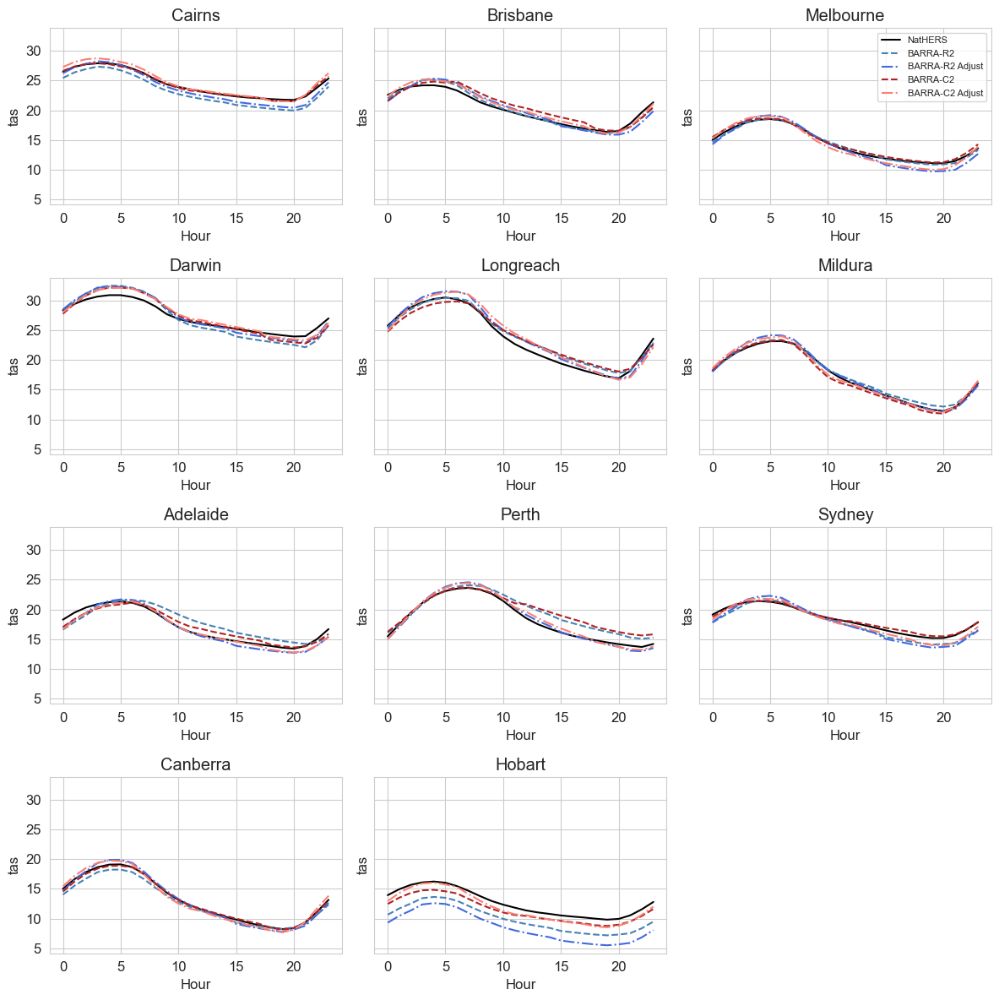

In [10]:
source_order = ["NatHERS", "BARRA-R2", "BARRA-R2 Adjust", "BARRA-C2", "BARRA-C2 Adjust"]
linestyles = ["-", "--", "-.", "--","-."]  
colors = ["black", "steelblue", "royalblue", "firebrick", "salmon"]

n_locs = len(da["loc"])
ncols = min(3, n_locs)  # max 3 columns
nrows = int(np.ceil(n_locs / ncols))

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(4*ncols, 3*nrows), sharey=True)
axes = np.array(axes).flatten()  # flatten in case of single row/col

for ax, loc in zip(axes, da["loc"].values):
    for src, ls, col in zip(source_order, linestyles, colors):
        da.sel(source=src, loc=loc).groupby("time.hour").mean("time").plot(
            ax=ax, color=col, linestyle=ls, label=src
        )
    ax.set_title(loc)
    ax.set_xlabel("Hour")
    ax.set_ylabel(da.name)
    # Add legend only to the first subplot
    if loc == "Melbourne":
        ax.legend(fontsize=8)

# Hide unused axes if any
for ax in axes[n_locs:]:
    ax.axis("off")

plt.tight_layout()
plt.show()


### Diurnal cycle for each month and location for all datasets

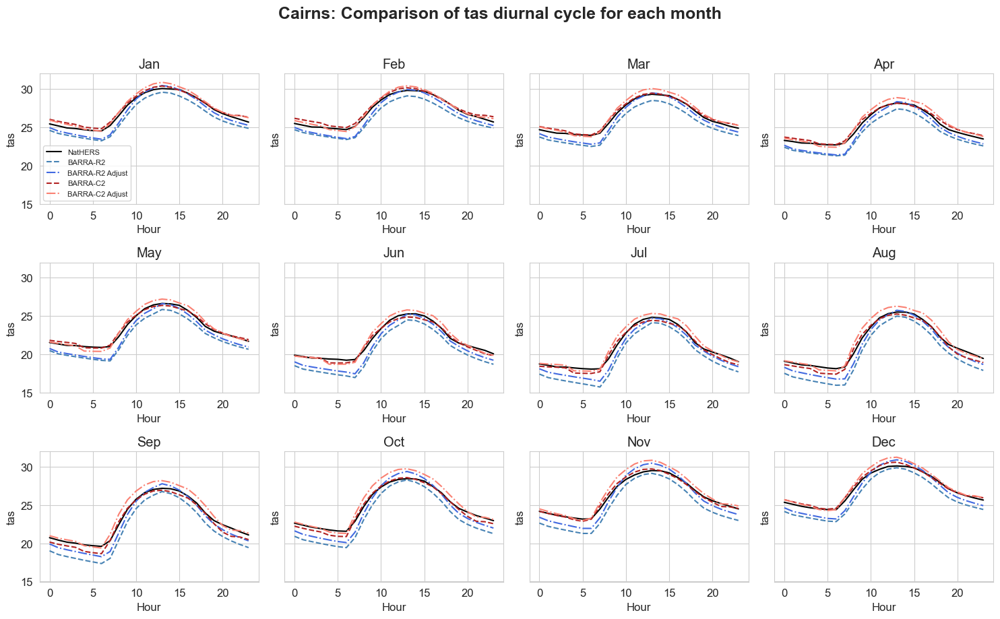

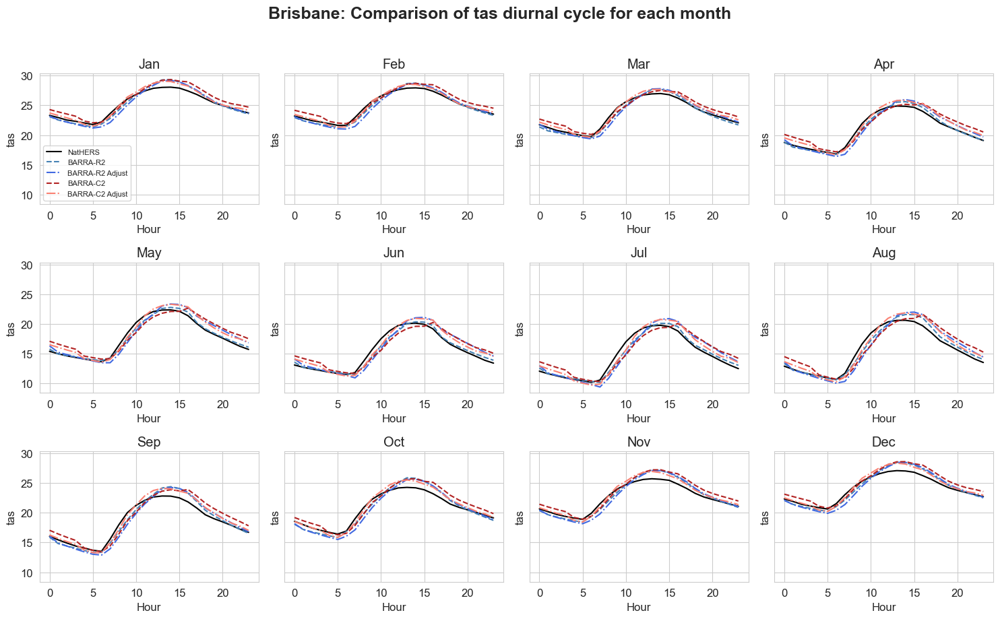

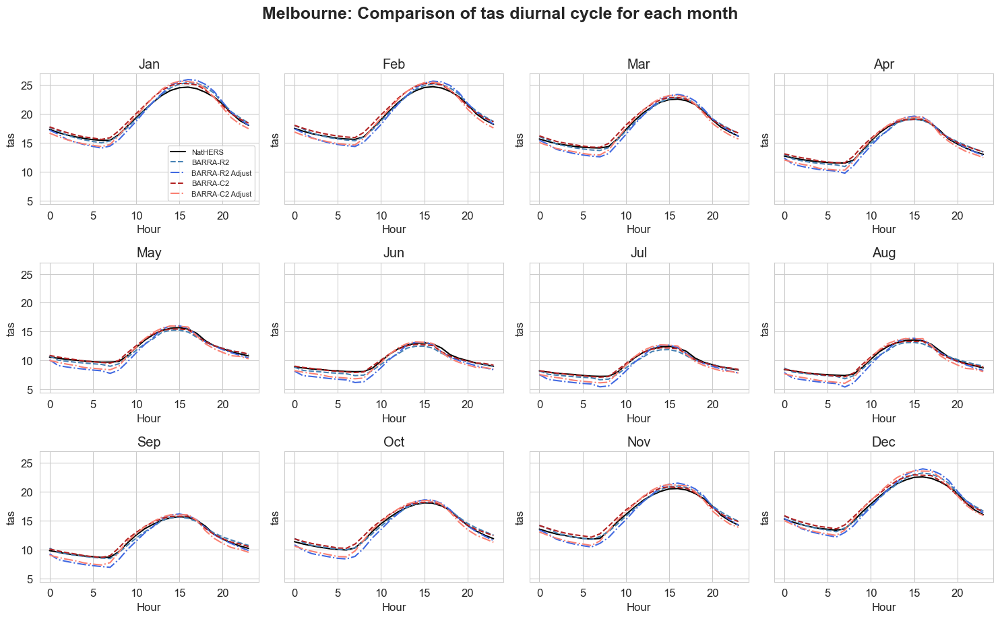

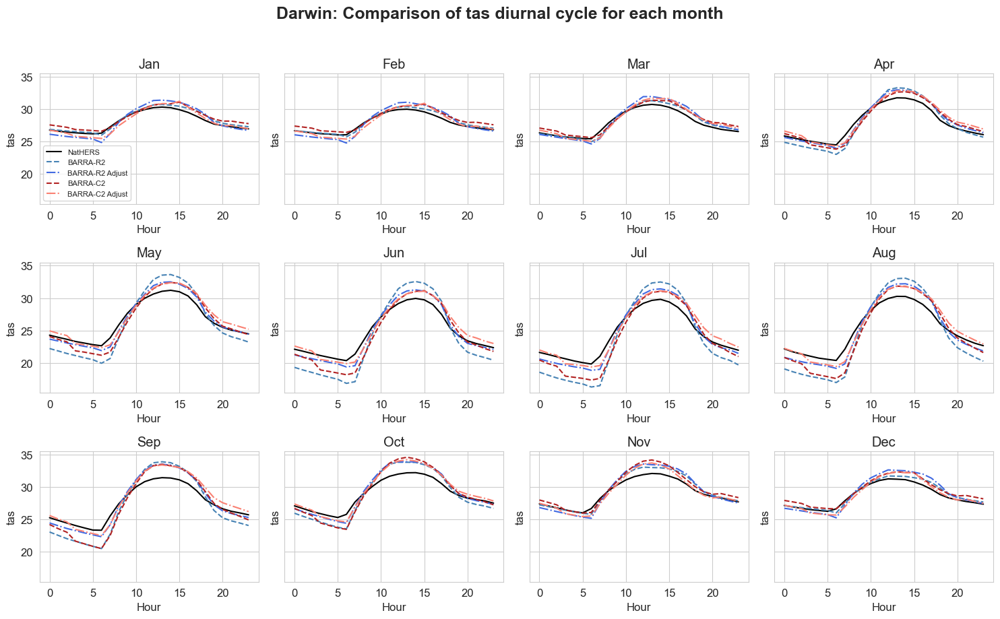

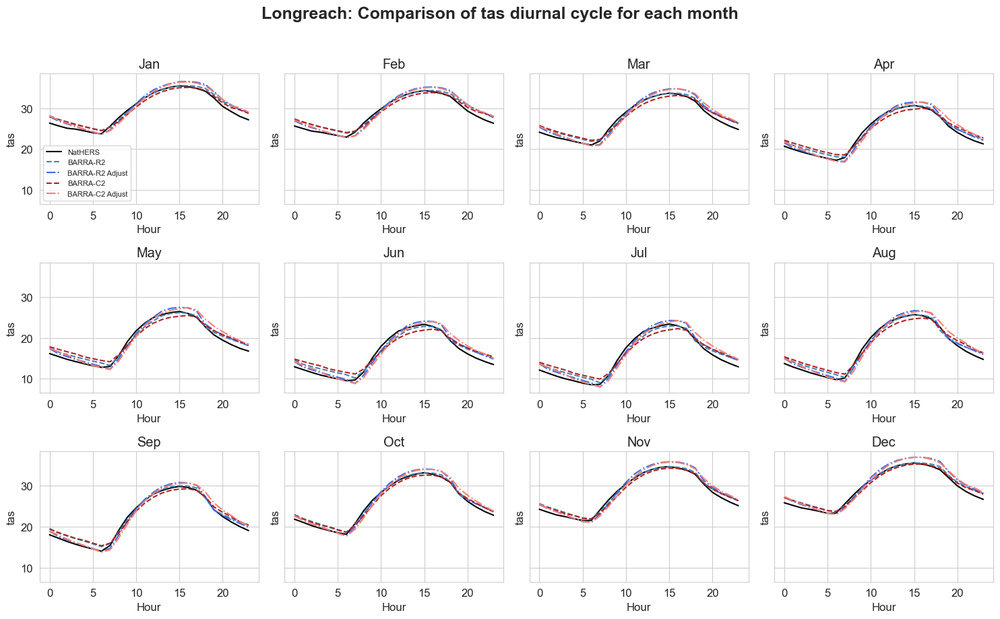

...

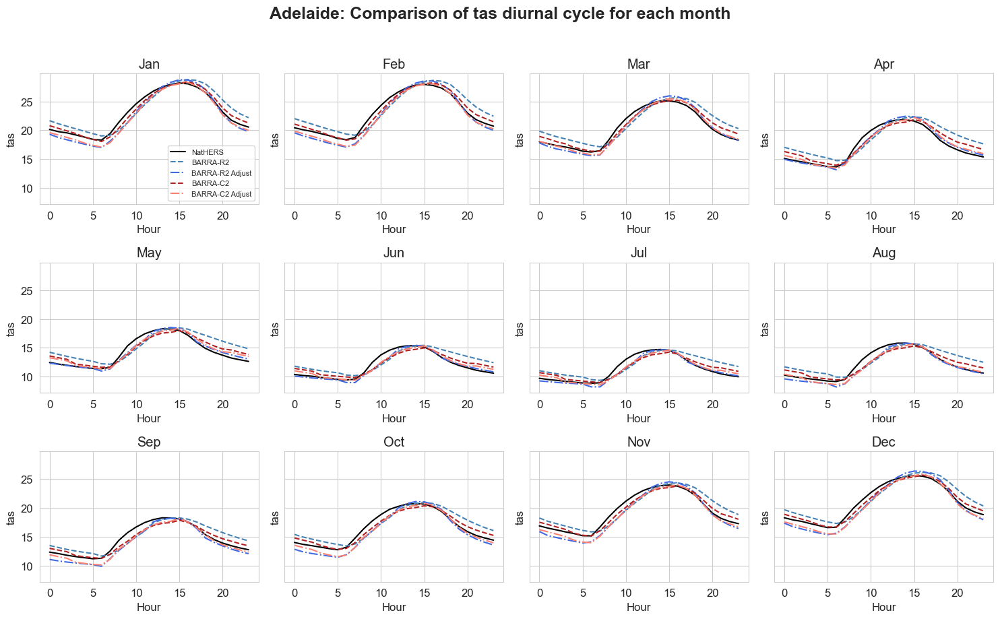

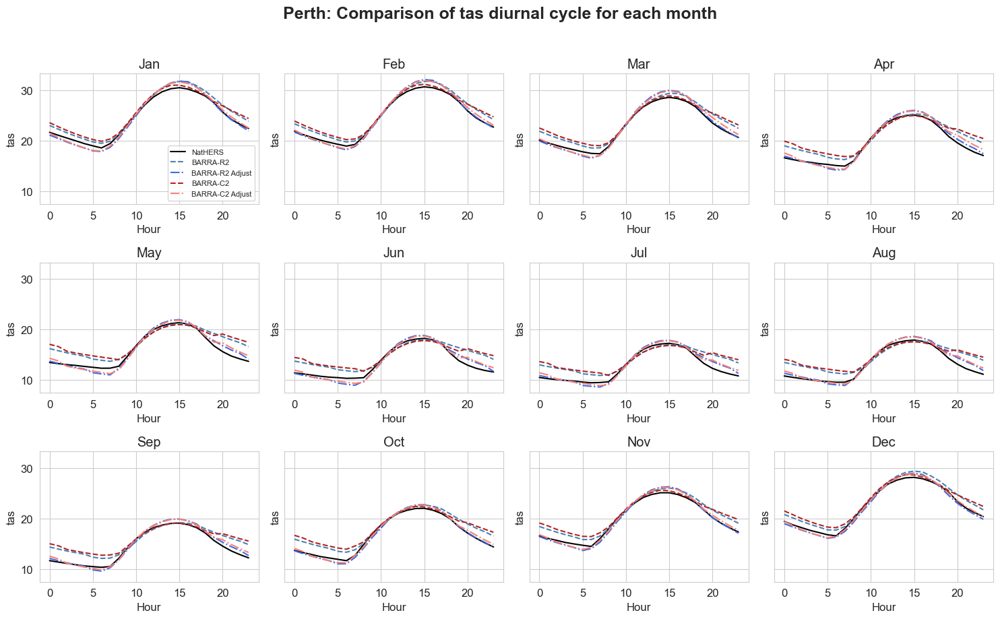

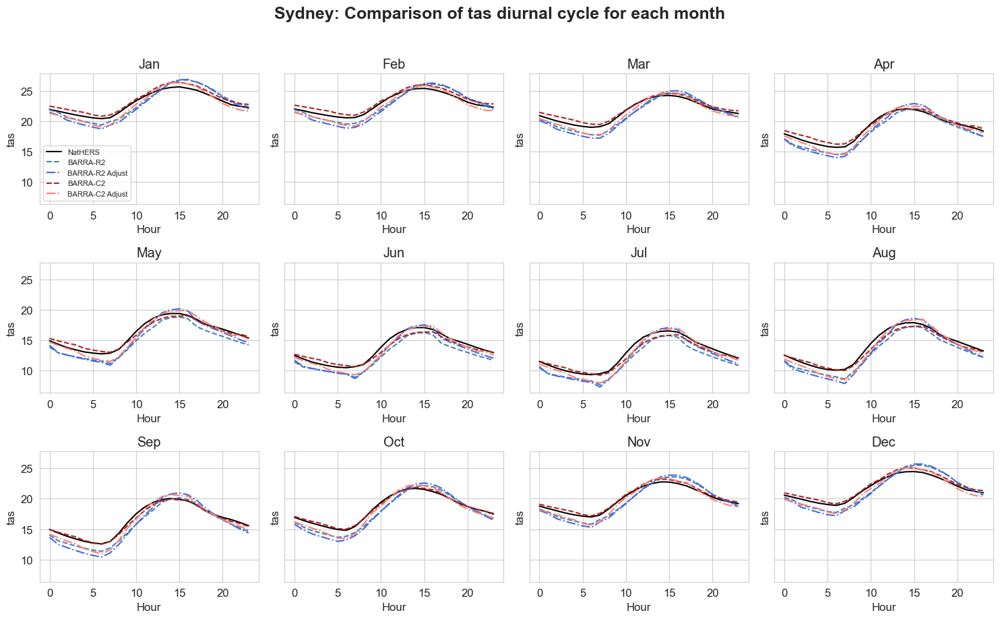

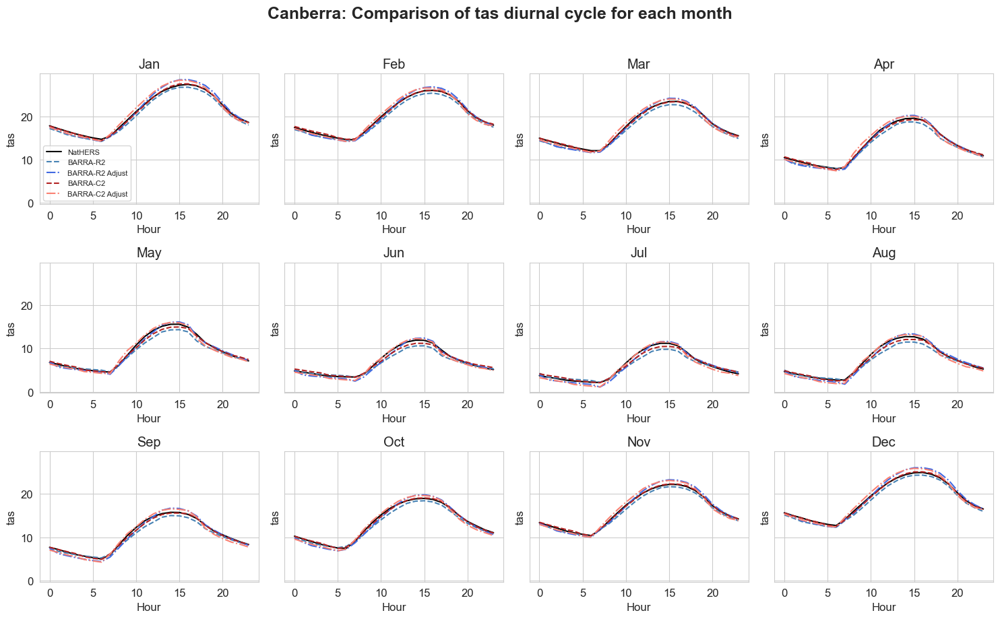

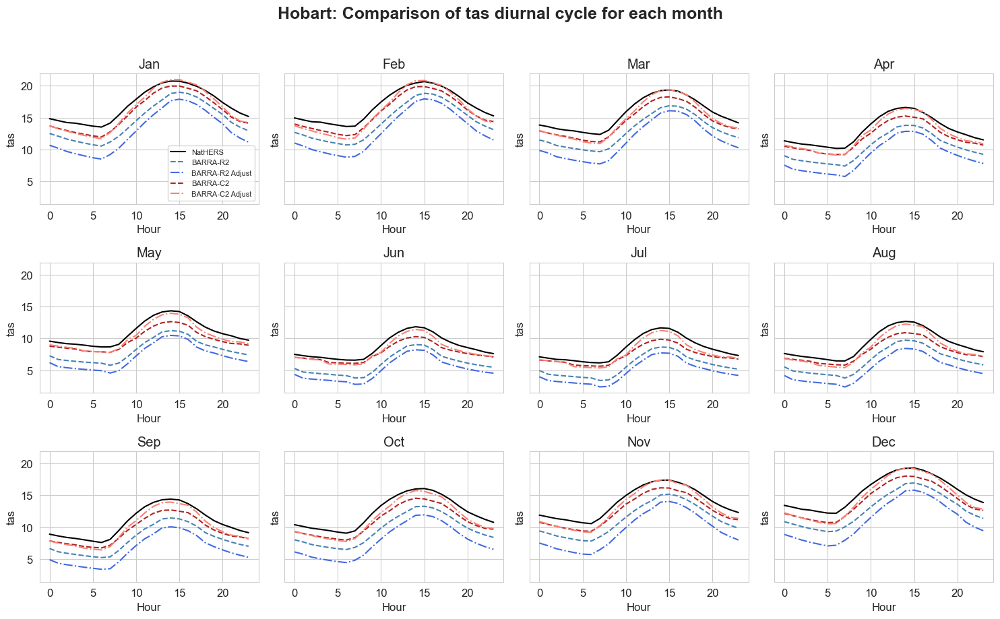

In [11]:
for l in da["loc"].values:
    da_loc = convert_to_local_time(da,l)
    mon_list = []
    for m in np.arange(1,13,1):
        da_temp = da_loc.sel(time=da_loc['time.month'] == m).groupby("time.hour").mean("time")
        mon_list.append(da_temp)

    da_mon = xr.concat(mon_list,pd.Index(np.arange(1,13,1),name="month"))

    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15, 9), sharey=True)
    axes = axes.flatten()  # flatten in case of single row/col
    
    for m, ax in enumerate(axes, start=1):
        for src, ls, col in zip(source_order, linestyles, colors):
            da_mon.sel(month=m, source=src).plot(
                ax=ax, color=col, linestyle=ls, label=src
            )
        ax.set_title(f"{calendar.month_abbr[m]}")
        ax.set_xlabel("Hour")
        ax.set_ylabel(da_mon.name)
        if m == 1:
            ax.legend(fontsize=8)
            
    plt.suptitle(f"{l}: Comparison of {da_mon.name} diurnal cycle for each month", 
                 y=1.02, fontsize=18, weight='bold')
    plt.tight_layout()
    plt.show()


## Evaluation of BARRA-C2 Adjust

### Density distribution for each month and location

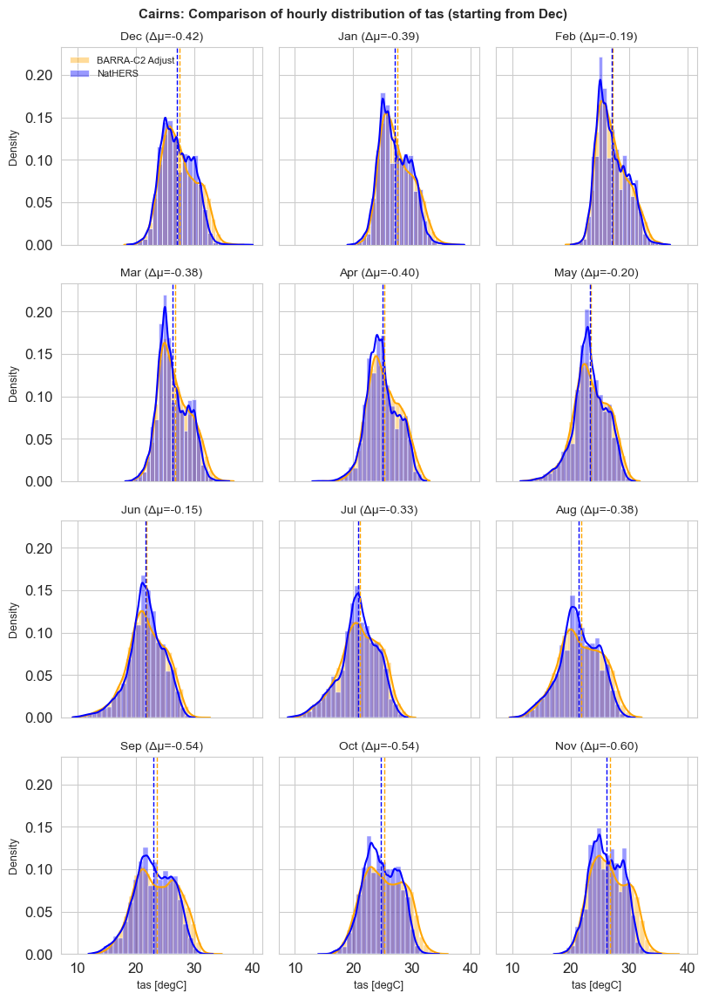

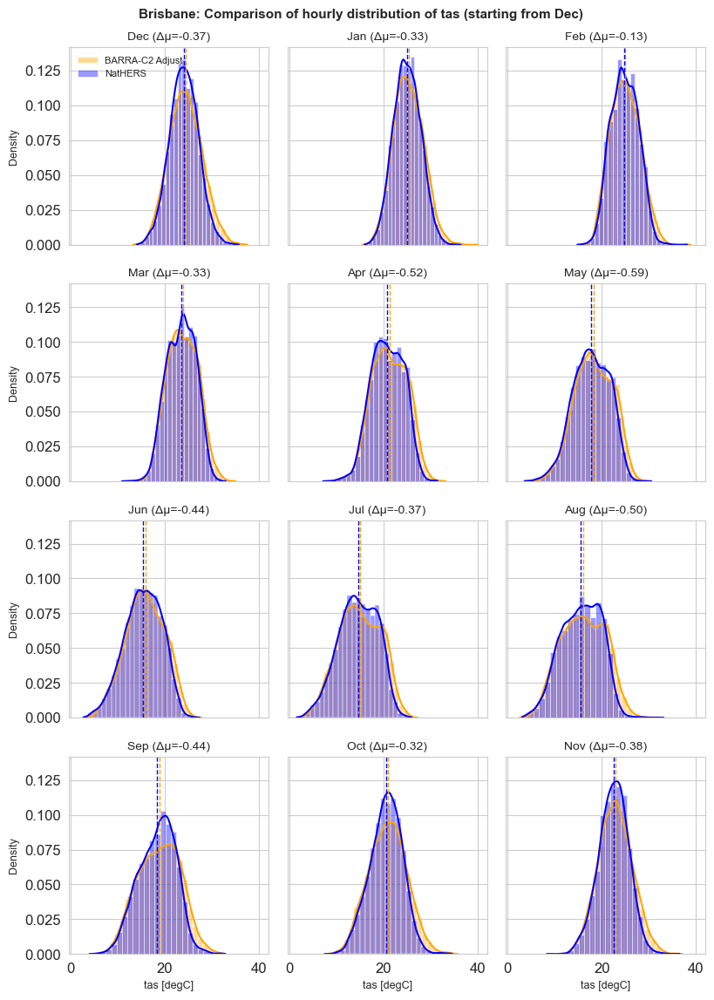

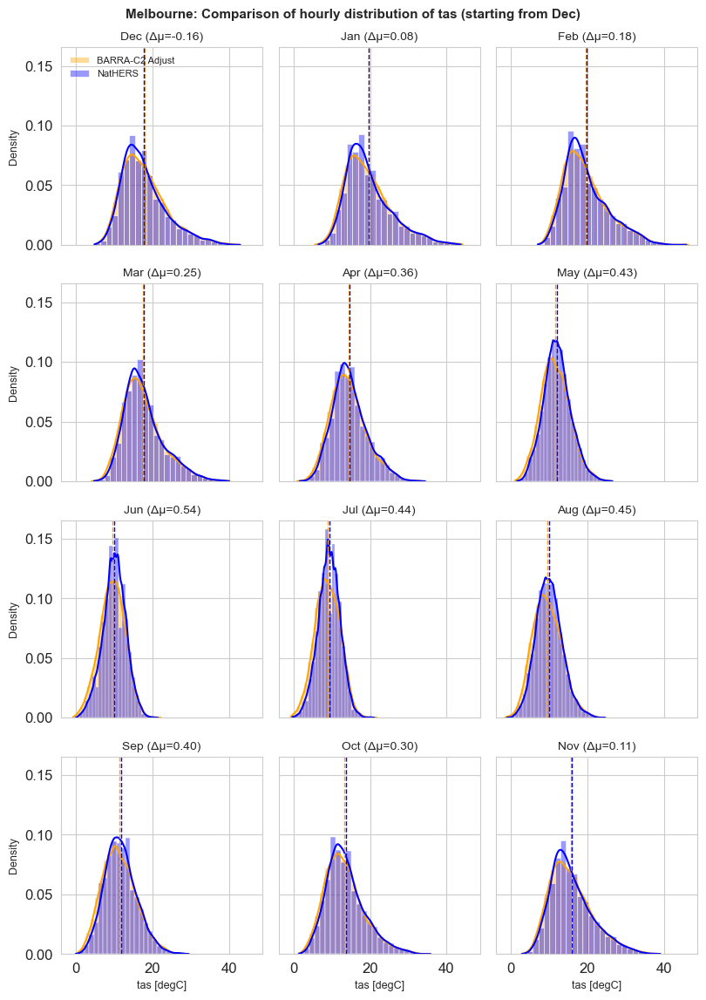

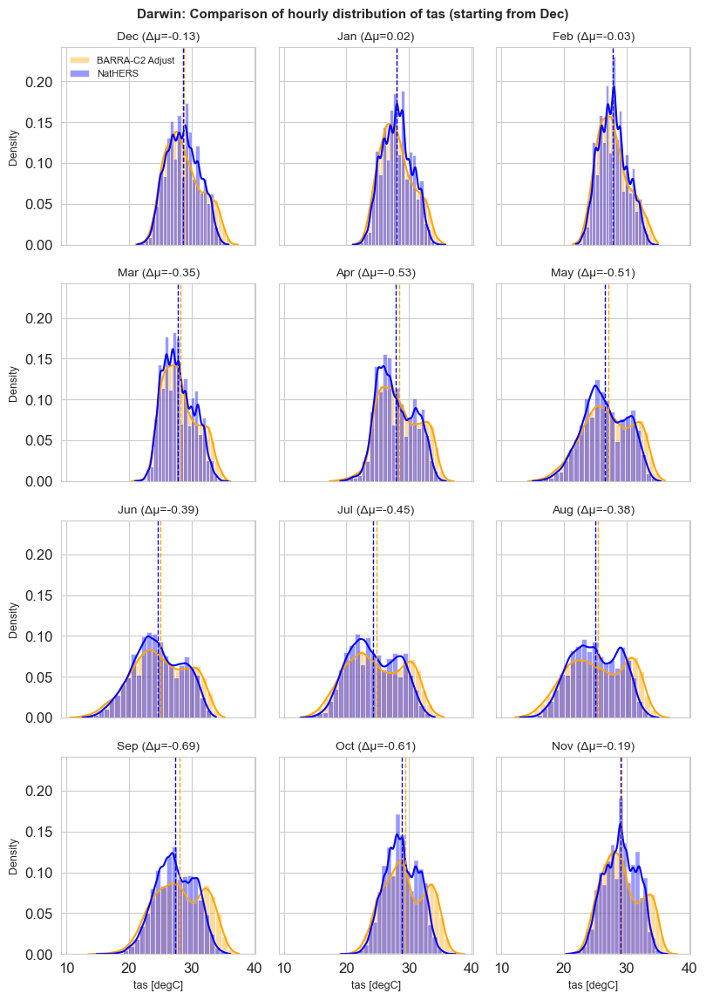

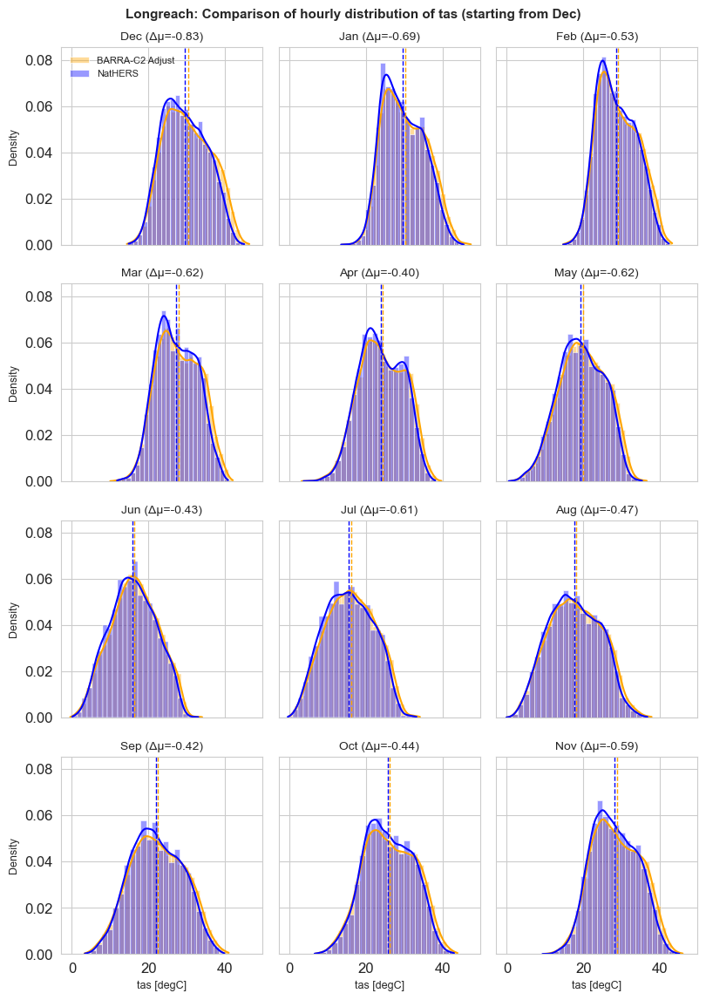

...

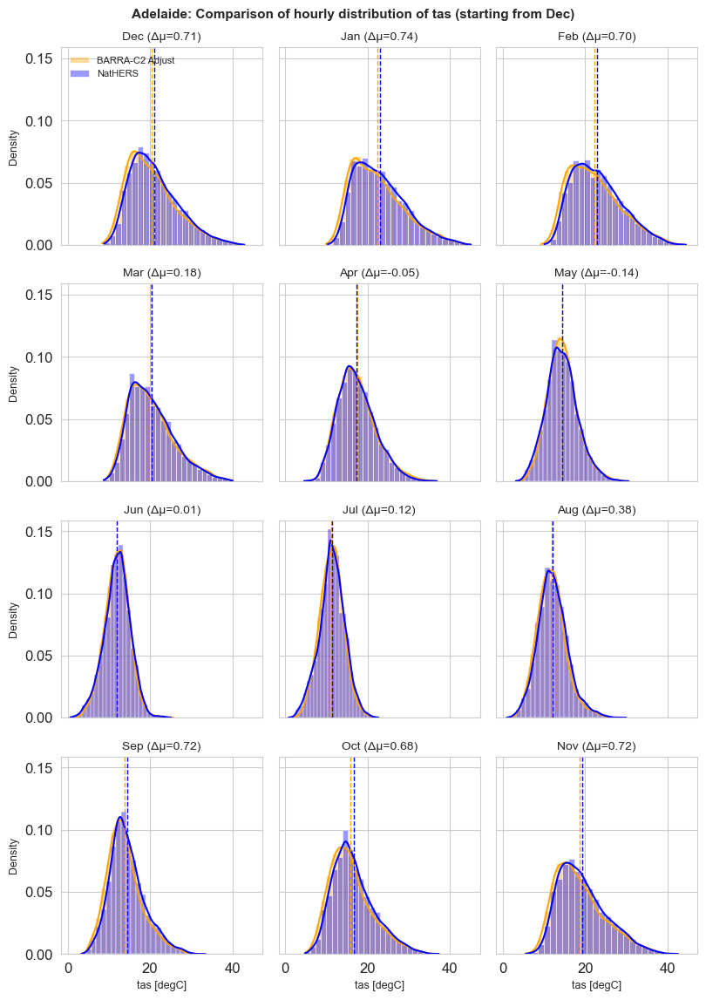

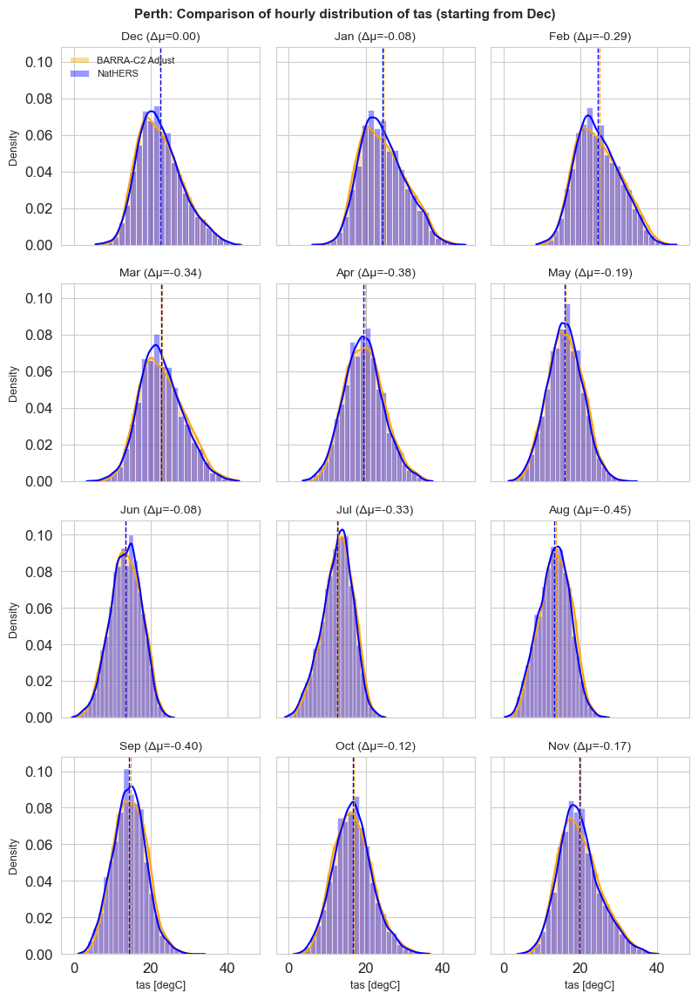

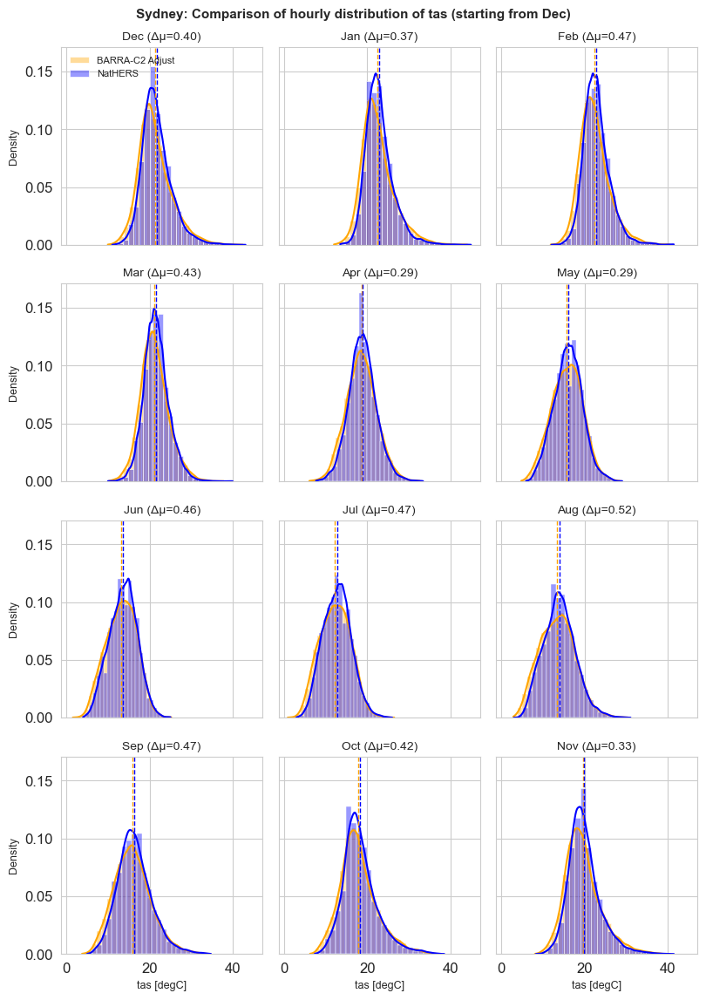

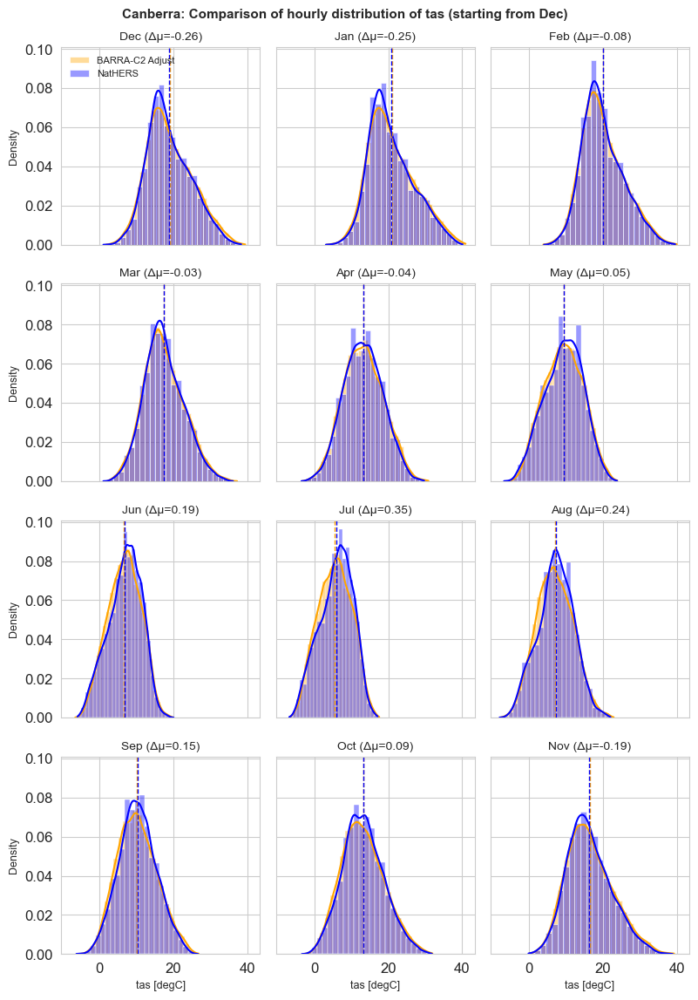

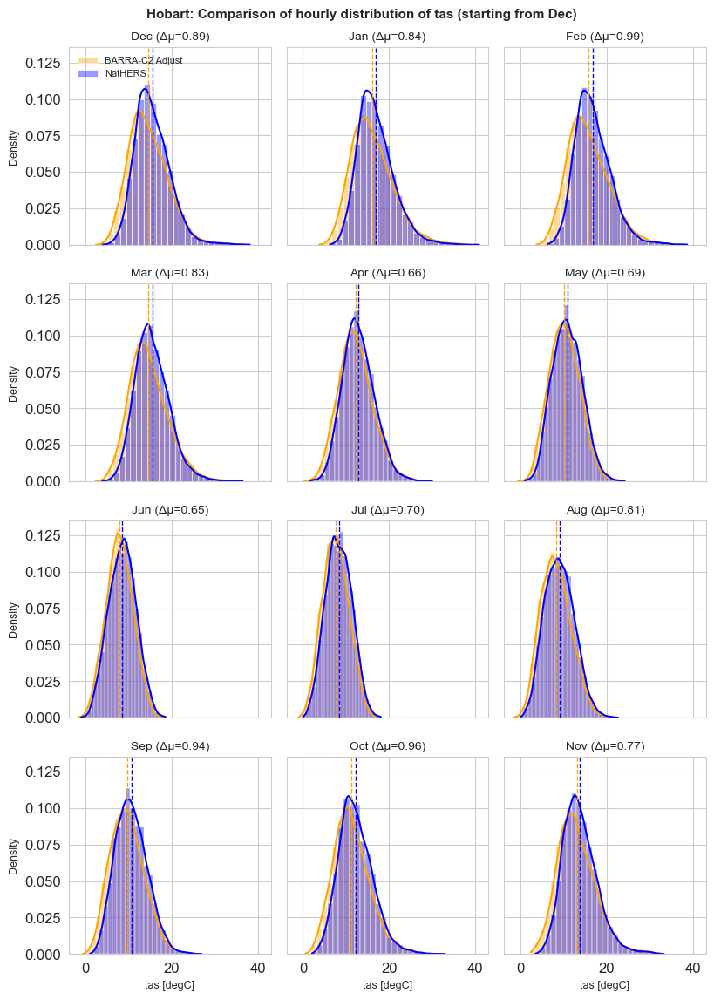

In [12]:
for l in da["loc"].values:
    data = convert_to_local_time(da,l)

    compare_monthly_histograms_xr(
        da=data,
        source1="BARRA-C2 Adjust",
        source2="NatHERS",
        location=l,
        label1="BARRA-C2 Adjust",
        label2="NatHERS",
        bins=25
    )


### Density distribution of hourly differences between BARRA-C2 and NatHERS

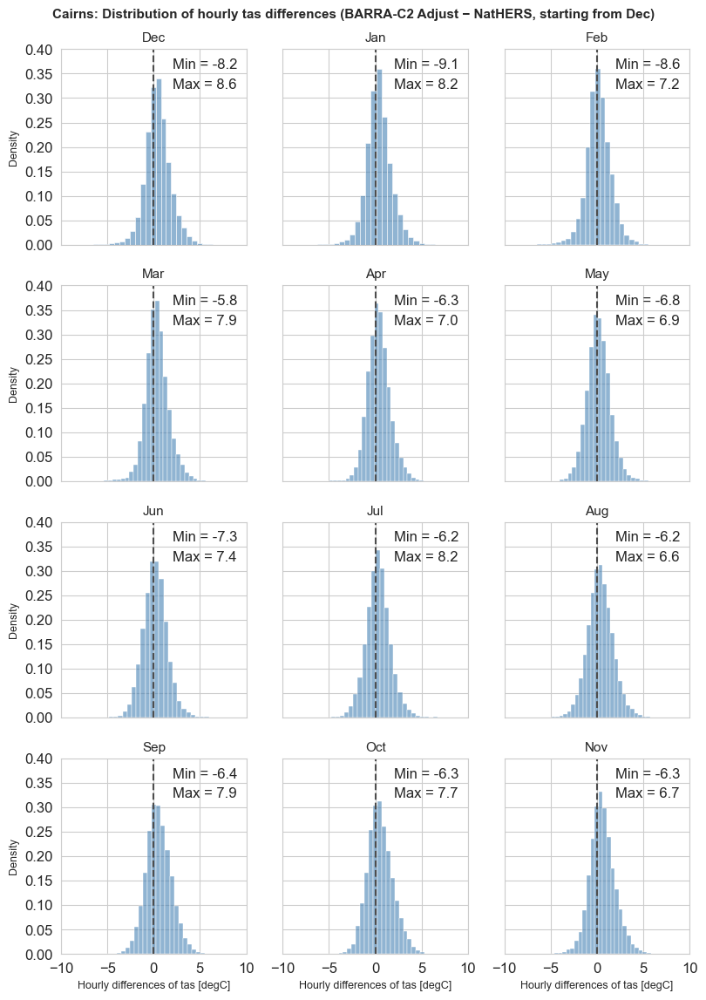

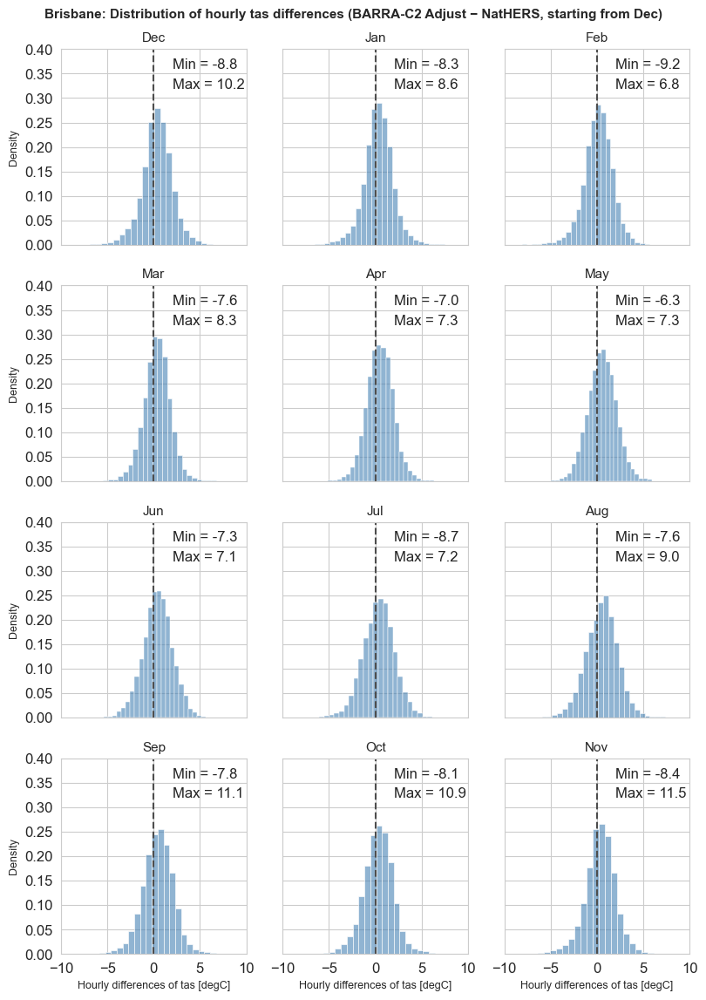

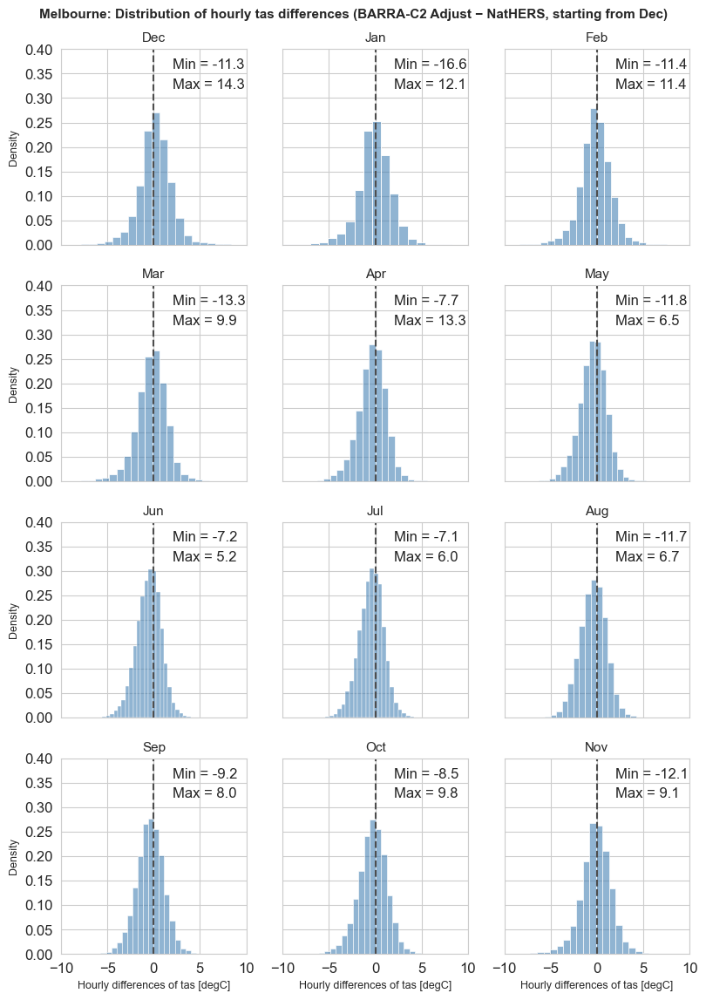

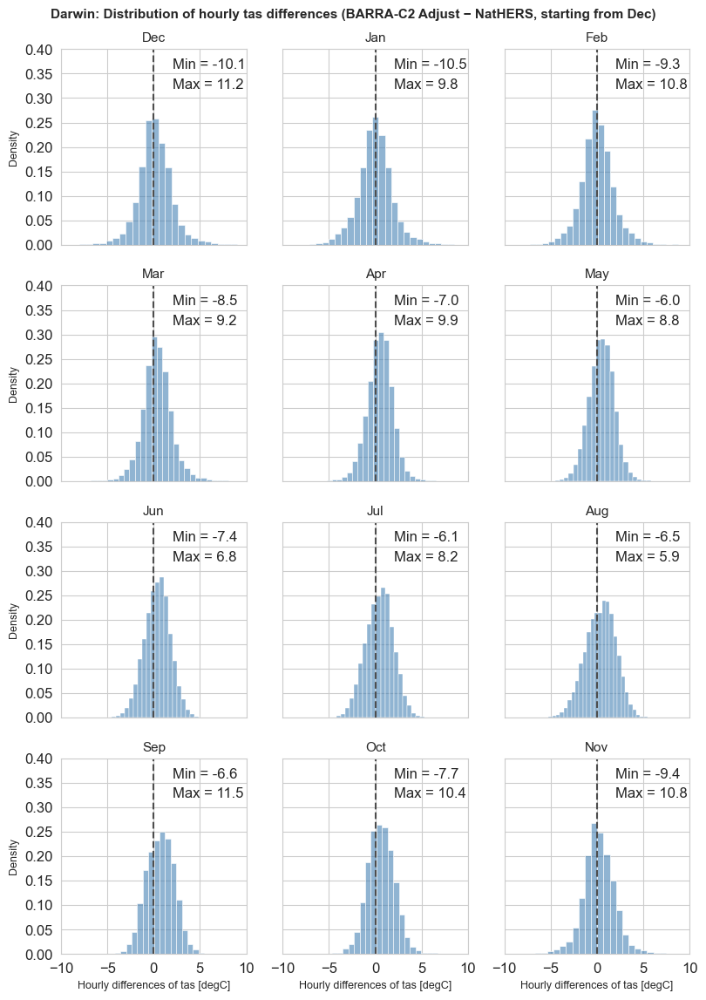

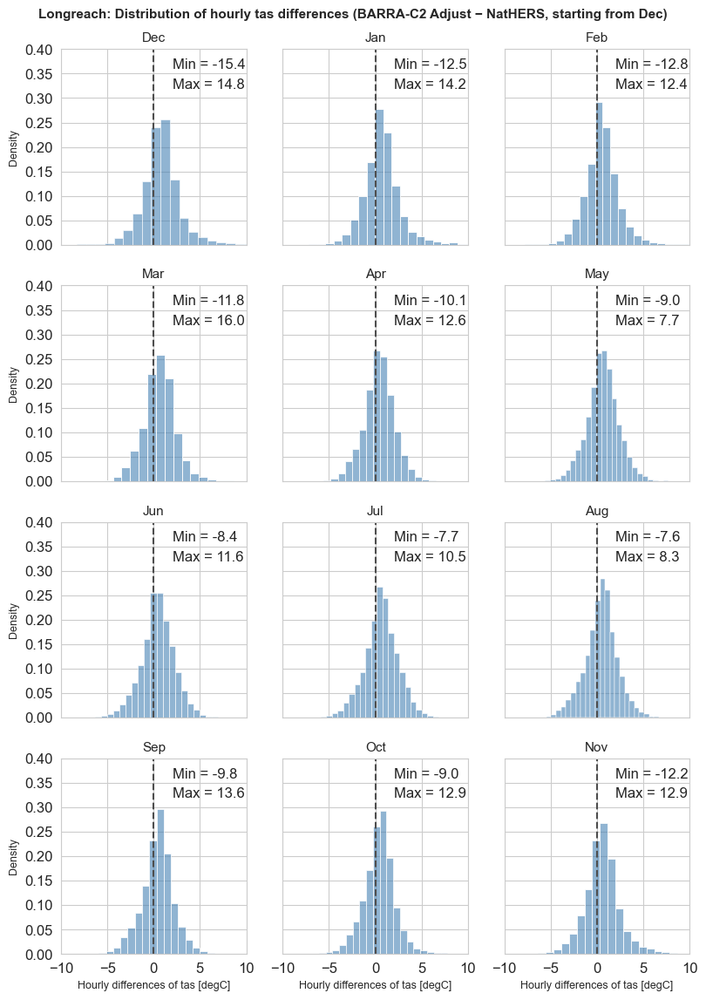

...

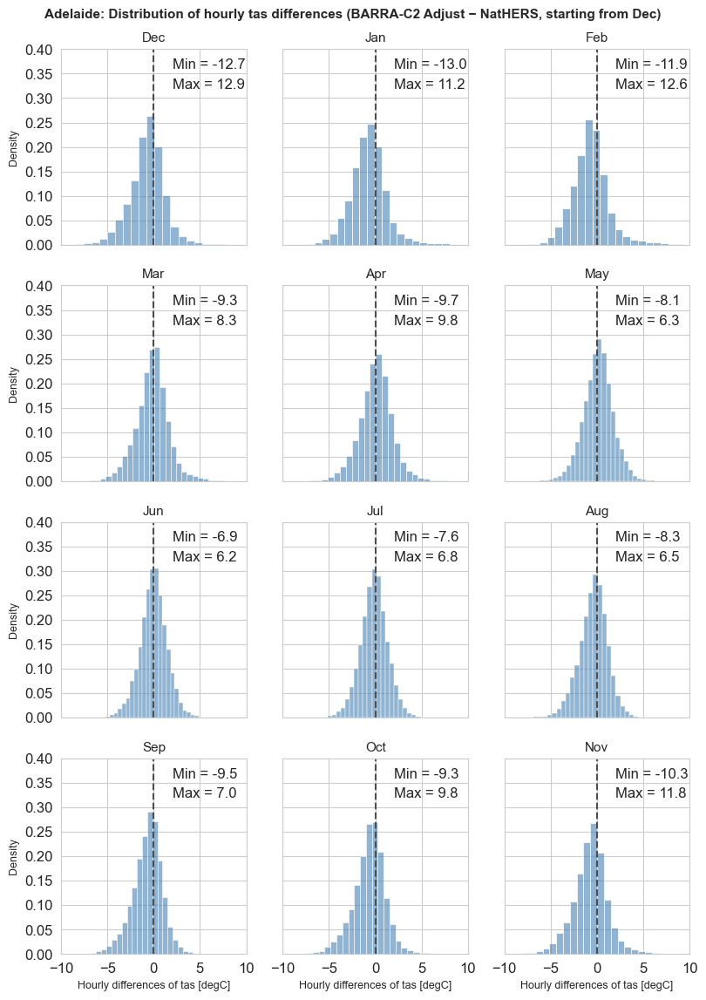

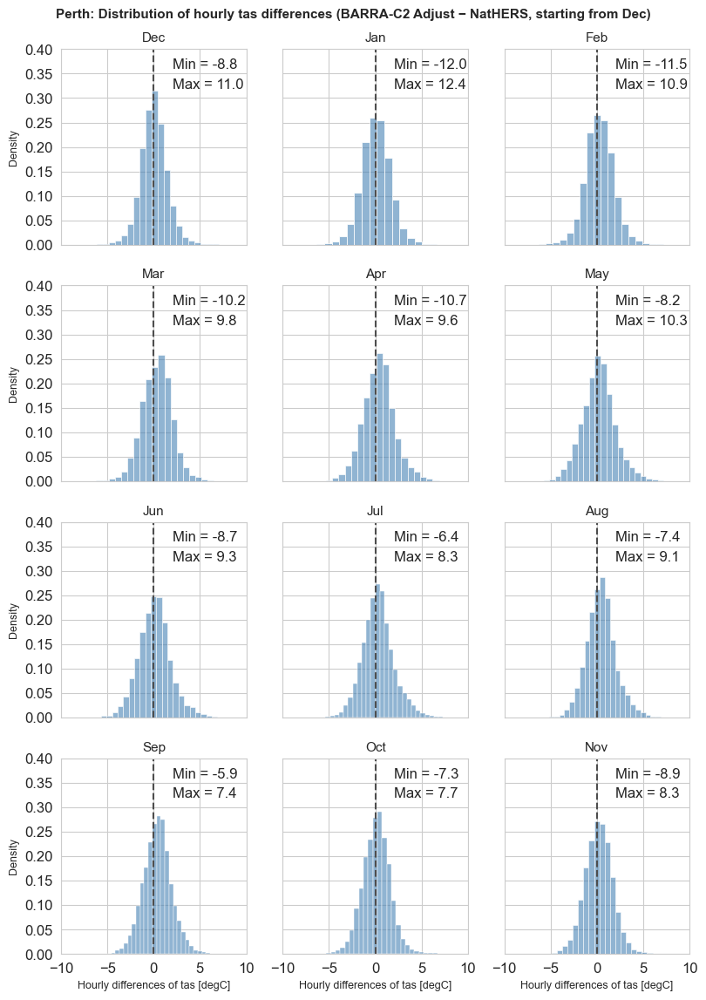

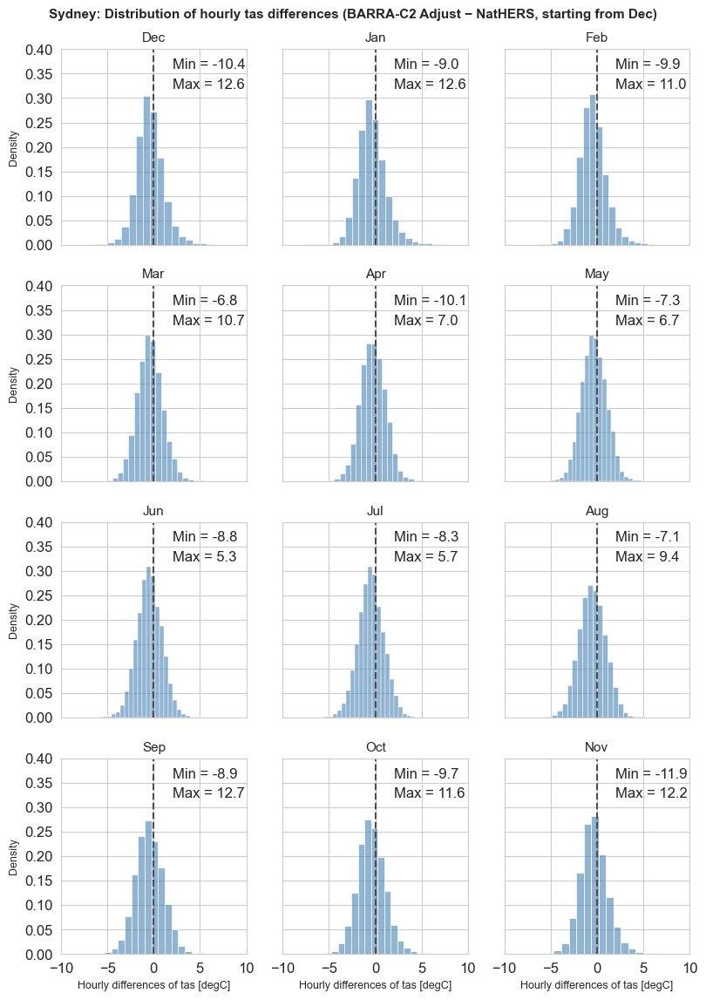

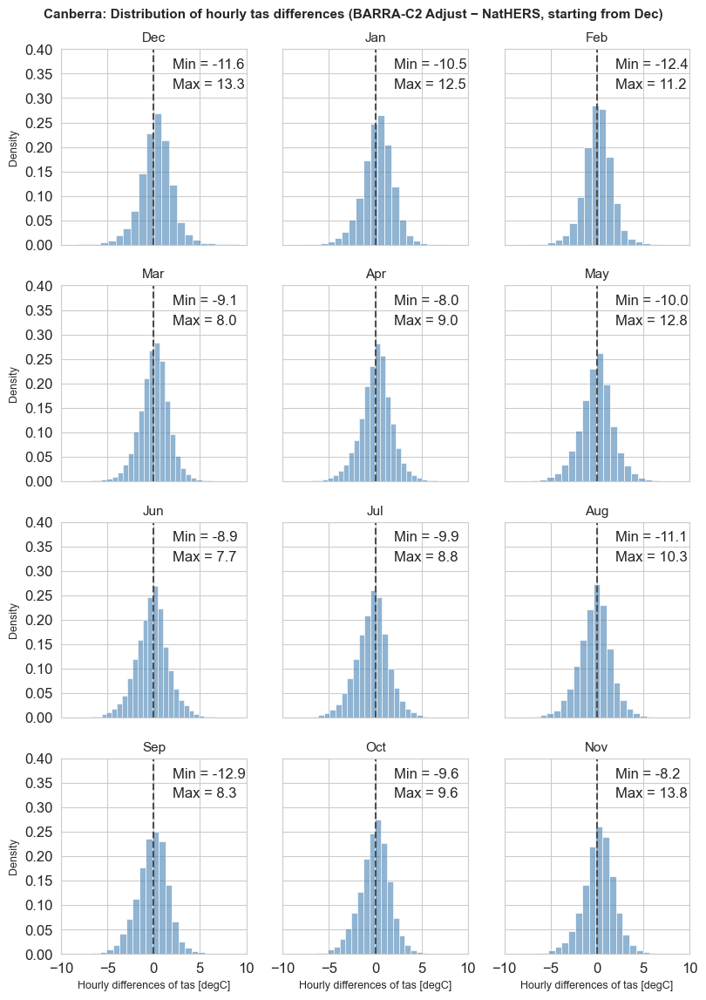

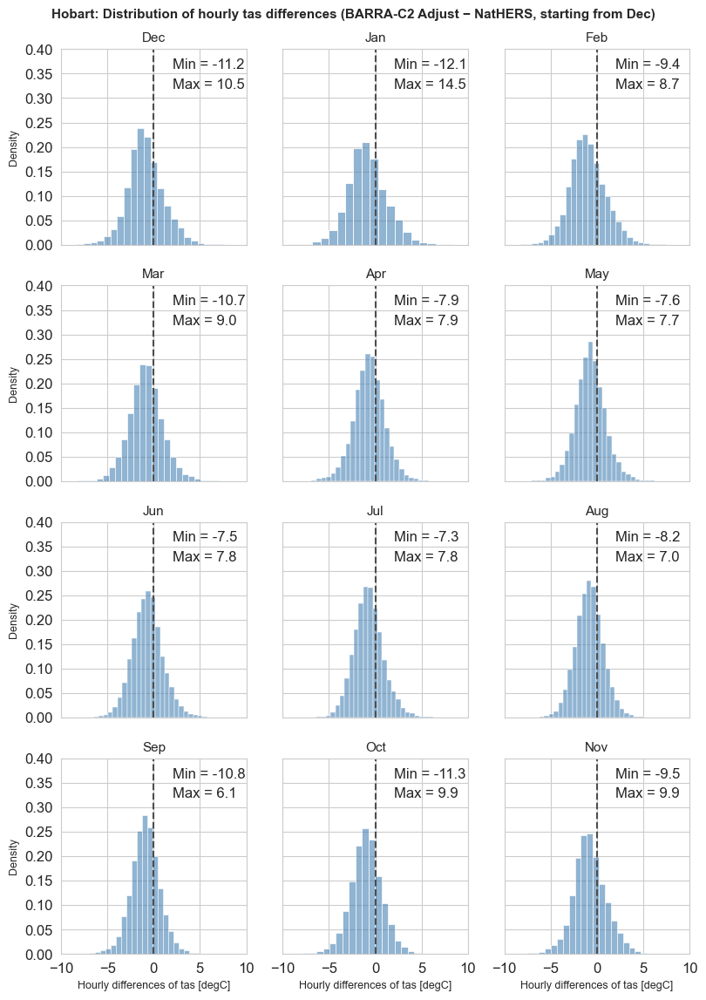

In [13]:
for l in da["loc"].values:
    data = convert_to_local_time(da,l)

    plot_monthly_difference_histograms_xr(
        da=data,
        obs_source="NatHERS",
        location=l,
        model_source="BARRA-C2 Adjust",
        xlim=(-10, 10),
        bins=30
    )

### Same as above overlaid with unadjusted/raw BARRA-C2 hourly difference

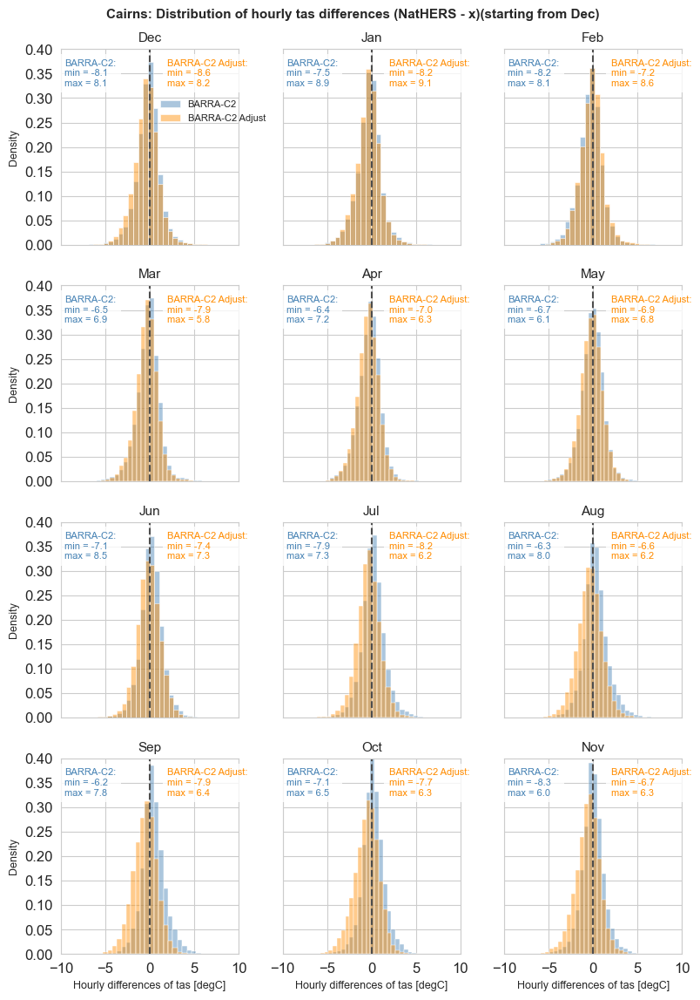

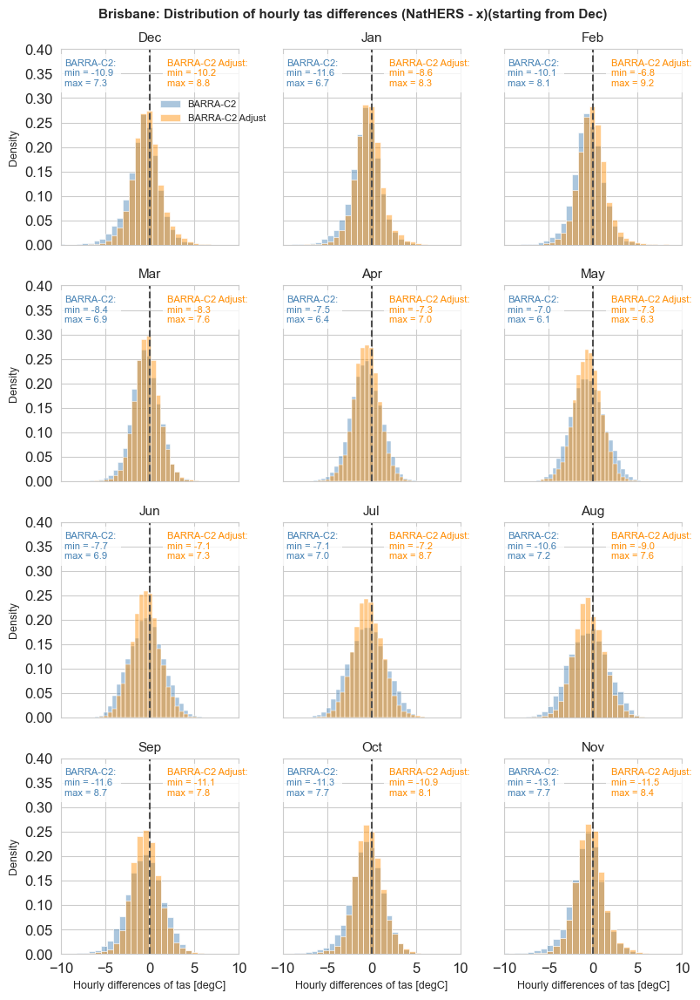

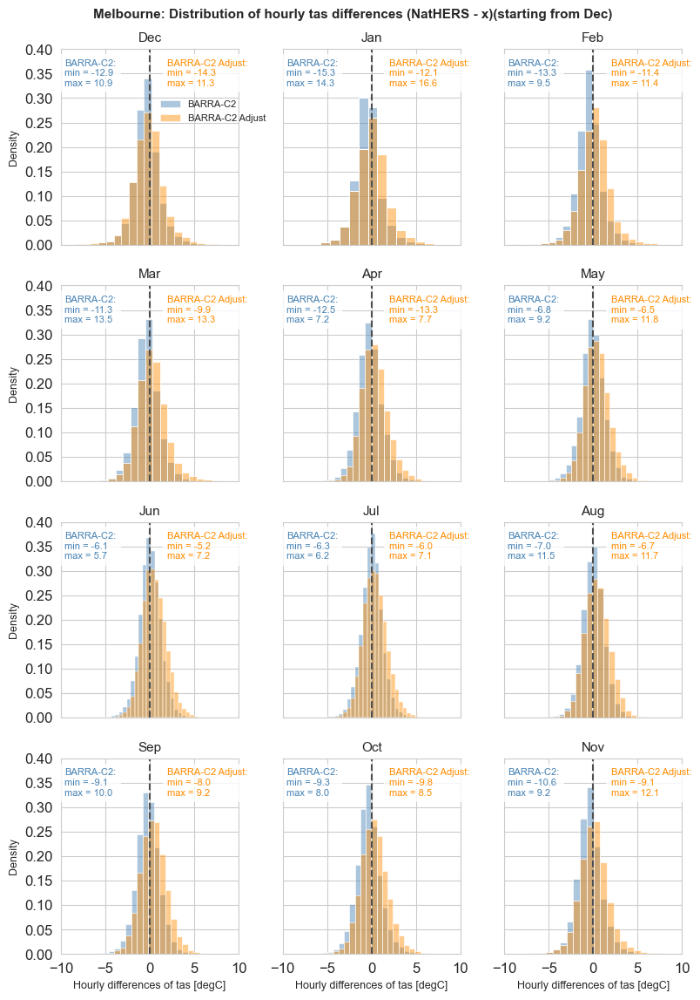

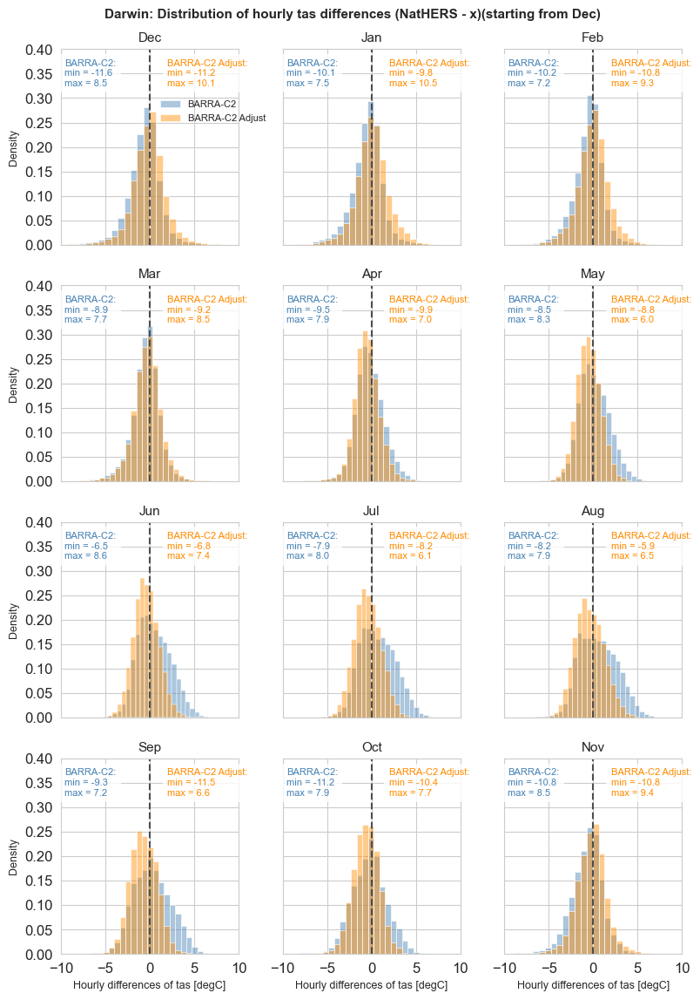

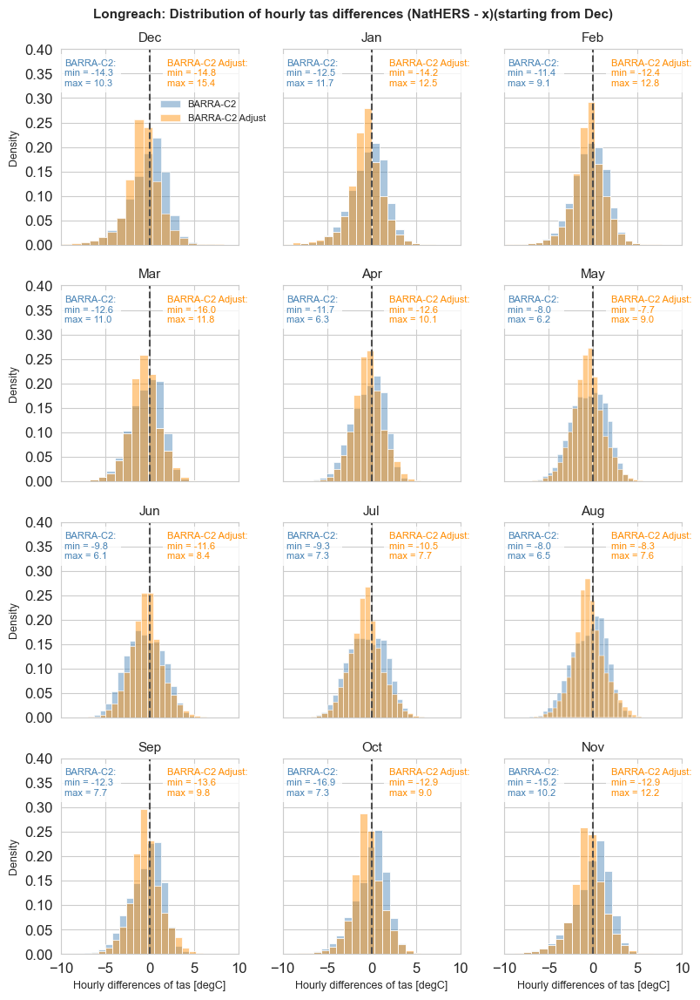

...

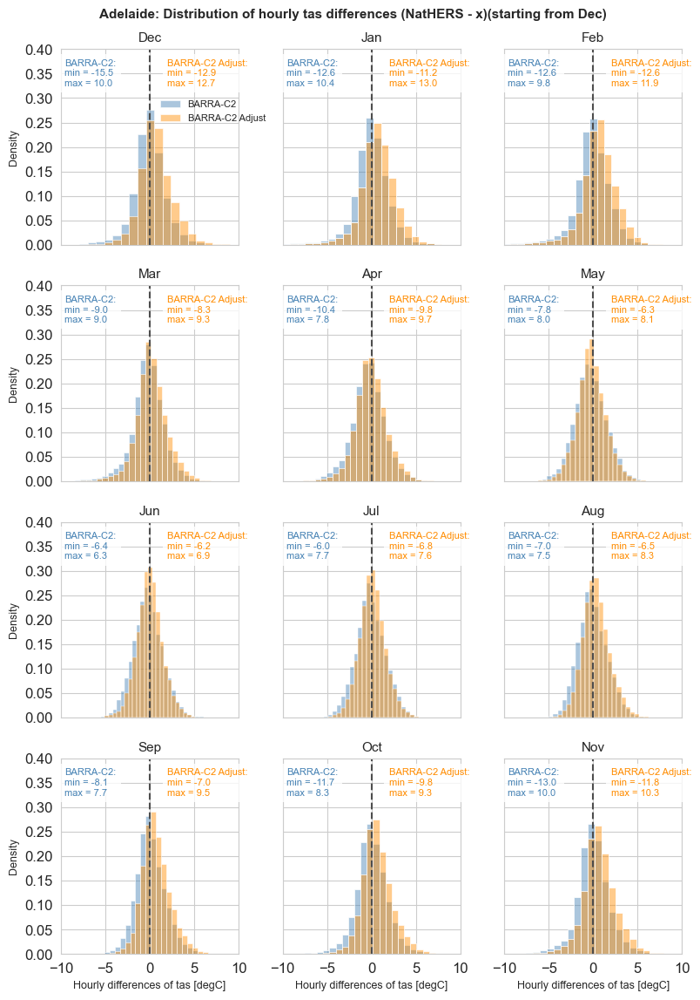

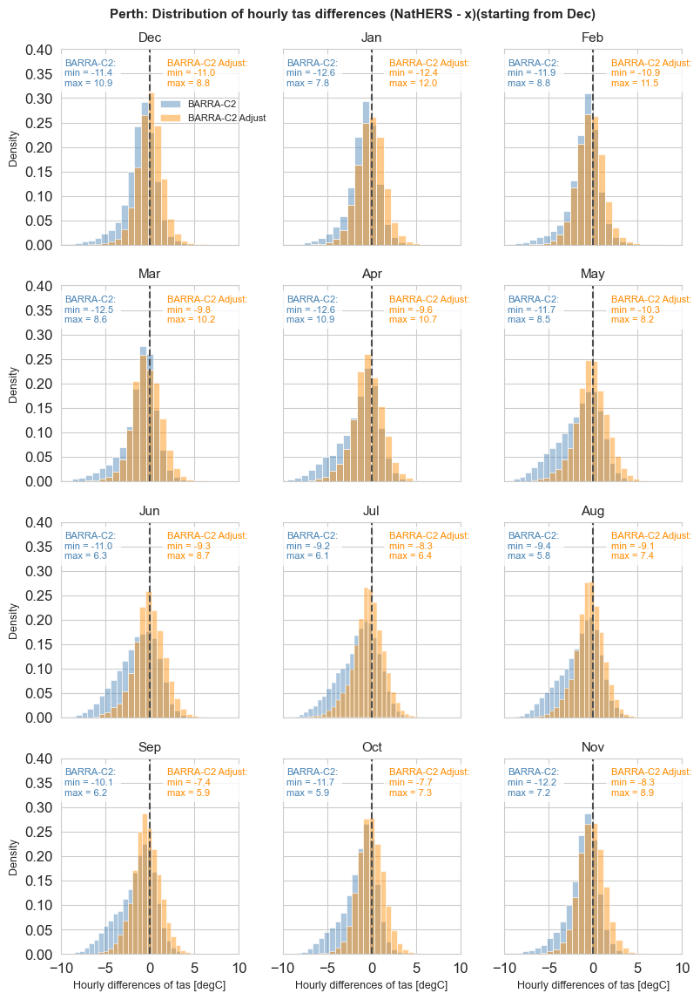

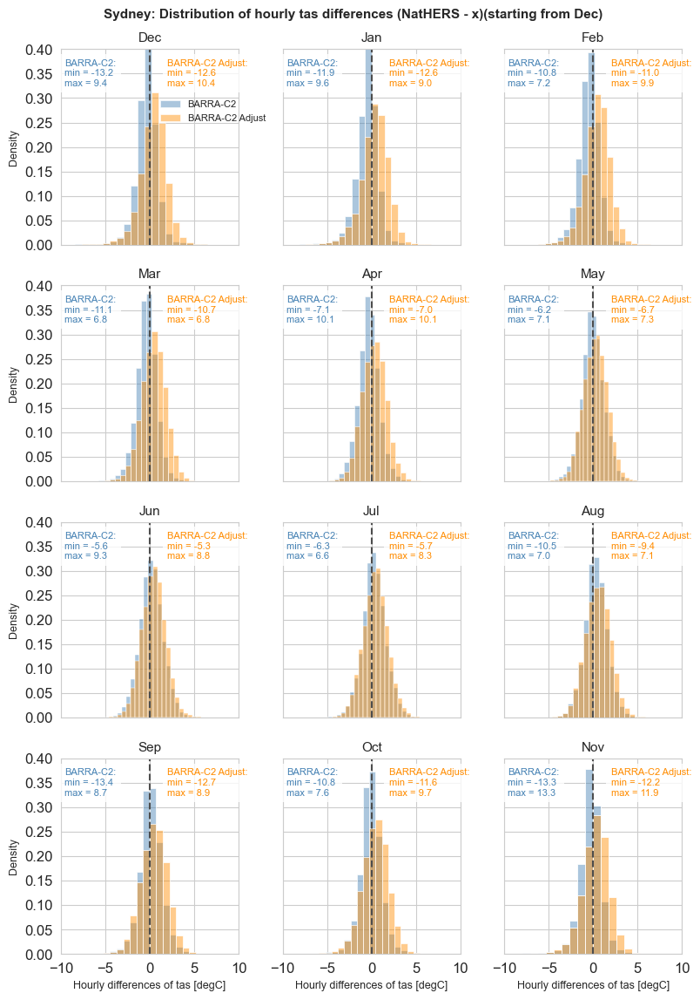

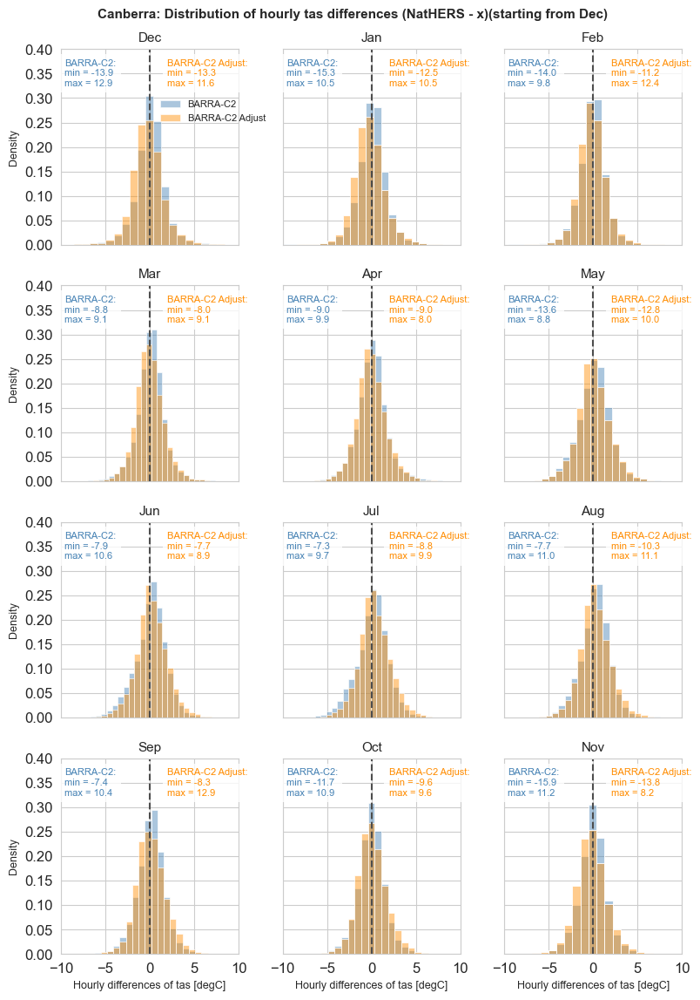

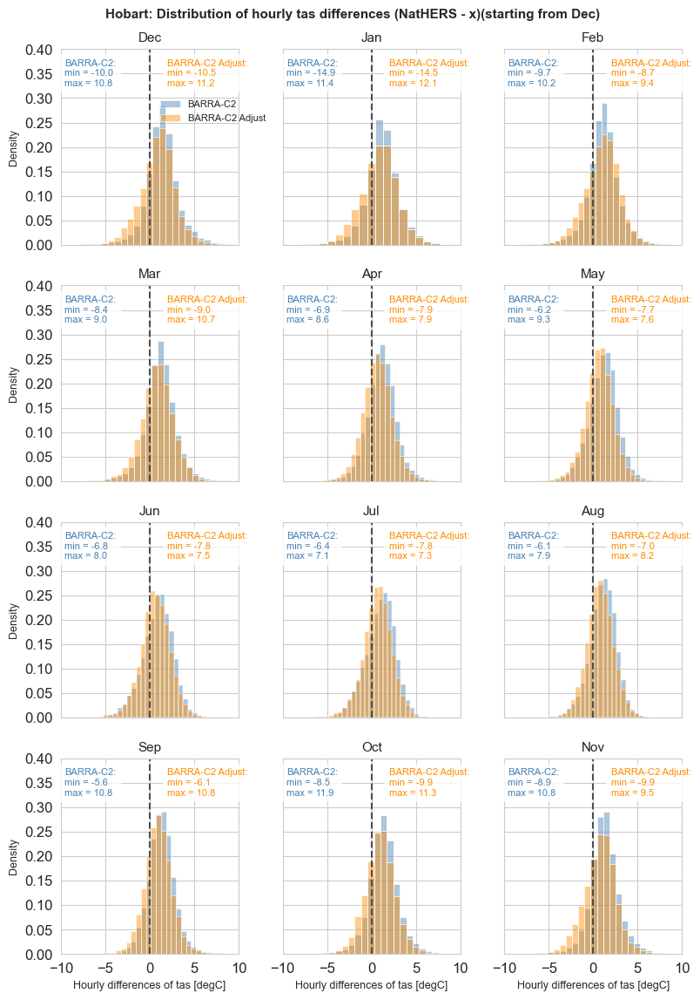

In [14]:
for l in da["loc"].values:
    data = convert_to_local_time(da,l)

    plot_monthly_two_difference_histograms_xr(
        da=data,
        location=l,
        obs_source="NatHERS",
        model1_source="BARRA-C2",
        model2_source="BARRA-C2 Adjust",
        xlim=(-10, 10),
        bins=30
    )


### Statistical tests of differences in daily temperature distributions
Distributional consistency tests for daily max, mean and minimum temperature: Kolmogorov–Smirnov (KS, shape of distribution) and Mann–Whitney (MW, tendency)


Cairns — DAILY MAXIMUM TEMPERATURE
Cairns       | maximum  | Jan | KS: stat= 0.245, p= 0.000 (SIG) | MW: stat=225372.5, p= 0.000 (SIG)
Cairns       | maximum  | Feb | KS: stat= 0.171, p= 0.000 (SIG) | MW: stat=207835.0, p= 0.000 (SIG)
Cairns       | maximum  | Mar | KS: stat= 0.227, p= 0.000 (SIG) | MW: stat=235635.0, p= 0.000 (SIG)
Cairns       | maximum  | Apr | KS: stat= 0.172, p= 0.000 (SIG) | MW: stat=230418.0, p= 0.000 (SIG)
Cairns       | maximum  | May | KS: stat= 0.125, p= 0.000 (SIG) | MW: stat=261734.5, p= 0.000 (SIG)
Cairns       | maximum  | Jun | KS: stat= 0.123, p= 0.000 (SIG) | MW: stat=249978.0, p= 0.000 (SIG)
Cairns       | maximum  | Jul | KS: stat= 0.135, p= 0.000 (SIG) | MW: stat=268004.0, p= 0.000 (SIG)
Cairns       | maximum  | Aug | KS: stat= 0.196, p= 0.000 (SIG) | MW: stat=249896.5, p= 0.000 (SIG)
Cairns       | maximum  | Sep | KS: stat= 0.233, p= 0.000 (SIG) | MW: stat=209837.0, p= 0.000 (SIG)
Cairns       | maximum  | Oct | KS: stat= 0.323, p= 0.000 (SIG) 

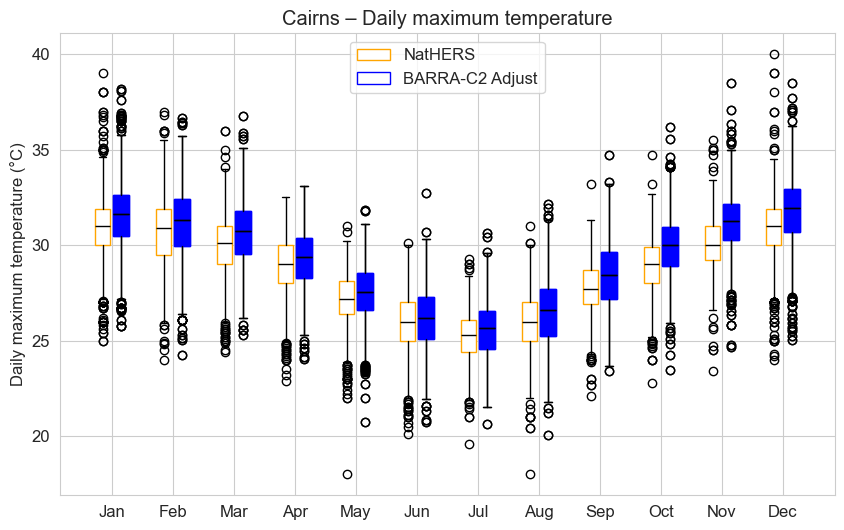

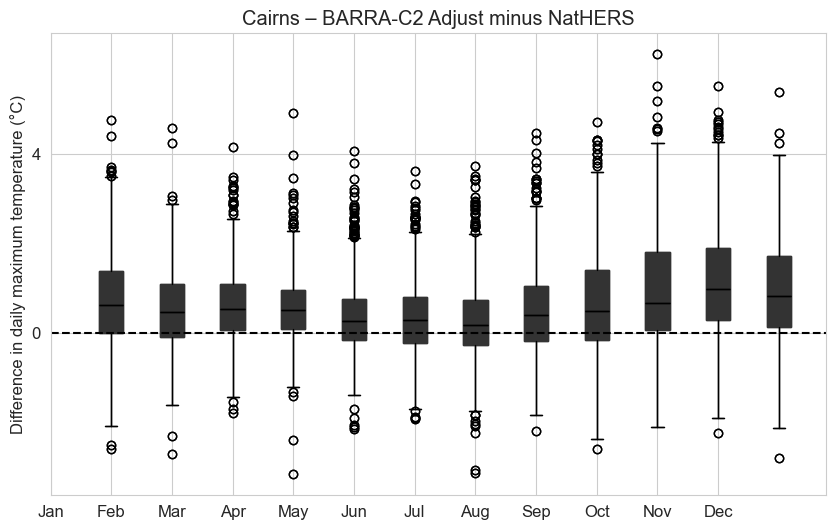


Cairns — DAILY MINIMUM TEMPERATURE
Cairns       | minimum  | Jan | KS: stat= 0.120, p= 0.000 (SIG) | MW: stat=286128.0, p= 0.090 (SIG)
Cairns       | minimum  | Feb | KS: stat= 0.078, p= 0.028 (SIG) | MW: stat=255723.5, p= 0.396 (ns)
Cairns       | minimum  | Mar | KS: stat= 0.066, p= 0.070 (SIG) | MW: stat=302038.0, p= 0.845 (ns)
Cairns       | minimum  | Apr | KS: stat= 0.072, p= 0.041 (SIG) | MW: stat=291987.0, p= 0.201 (ns)
Cairns       | minimum  | May | KS: stat= 0.151, p= 0.000 (SIG) | MW: stat=332191.0, p= 0.000 (SIG)
Cairns       | minimum  | Jun | KS: stat= 0.160, p= 0.000 (SIG) | MW: stat=316657.0, p= 0.000 (SIG)
Cairns       | minimum  | Jul | KS: stat= 0.106, p= 0.000 (SIG) | MW: stat=312855.0, p= 0.155 (ns)
Cairns       | minimum  | Aug | KS: stat= 0.129, p= 0.000 (SIG) | MW: stat=318230.0, p= 0.042 (SIG)
Cairns       | minimum  | Sep | KS: stat= 0.120, p= 0.000 (SIG) | MW: stat=299826.0, p= 0.027 (SIG)
Cairns       | minimum  | Oct | KS: stat= 0.142, p= 0.000 (SIG) | MW

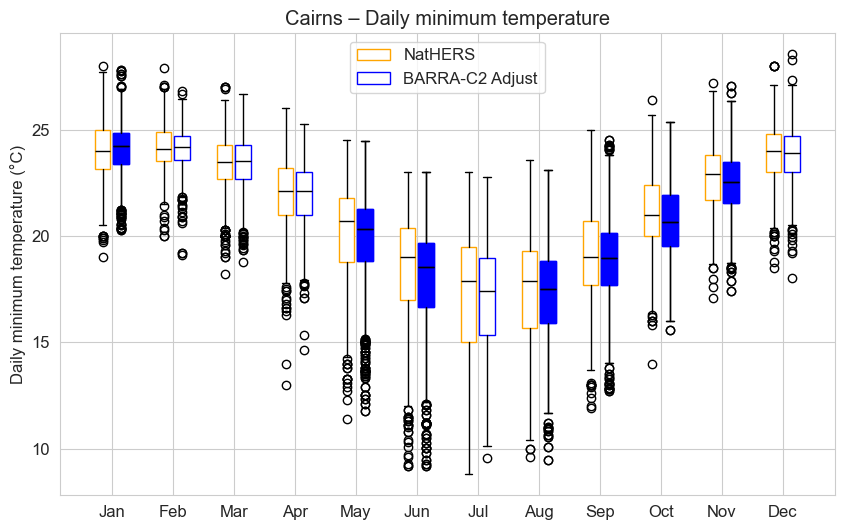

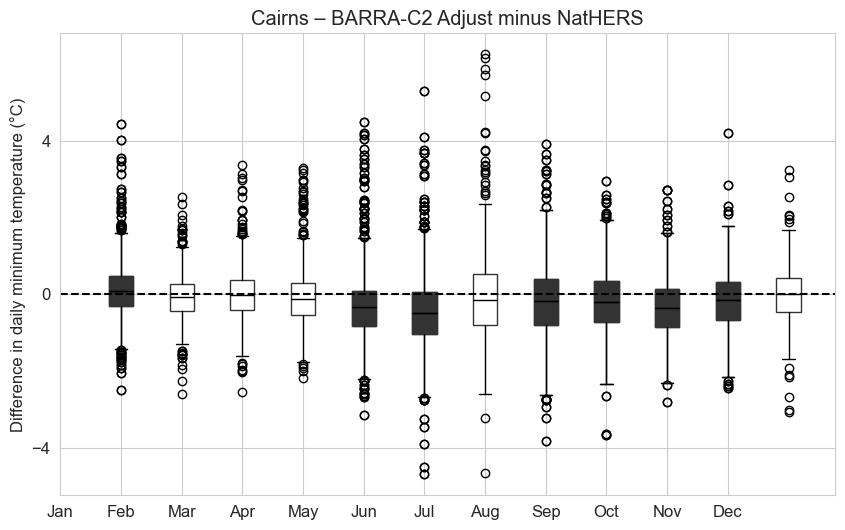


Cairns — DAILY MEAN TEMPERATURE
Cairns       | mean     | Jan | KS: stat= 0.186, p= 0.000 (SIG) | MW: stat=241872.0, p= 0.000 (SIG)
Cairns       | mean     | Feb | KS: stat= 0.108, p= 0.001 (SIG) | MW: stat=220481.5, p= 0.000 (SIG)
Cairns       | mean     | Mar | KS: stat= 0.138, p= 0.000 (SIG) | MW: stat=252366.5, p= 0.000 (SIG)
Cairns       | mean     | Apr | KS: stat= 0.105, p= 0.000 (SIG) | MW: stat=252624.0, p= 0.001 (SIG)
Cairns       | mean     | May | KS: stat= 0.061, p= 0.116 (ns) | MW: stat=297719.0, p= 0.769 (ns)
Cairns       | mean     | Jun | KS: stat= 0.067, p= 0.071 (SIG) | MW: stat=289247.0, p= 0.340 (ns)
Cairns       | mean     | Jul | KS: stat= 0.050, p= 0.280 (ns) | MW: stat=293363.0, p= 0.430 (ns)
Cairns       | mean     | Aug | KS: stat= 0.085, p= 0.007 (SIG) | MW: stat=283696.0, p= 0.059 (SIG)
Cairns       | mean     | Sep | KS: stat= 0.089, p= 0.005 (SIG) | MW: stat=255346.0, p= 0.002 (SIG)
Cairns       | mean     | Oct | KS: stat= 0.111, p= 0.000 (SIG) | MW: st

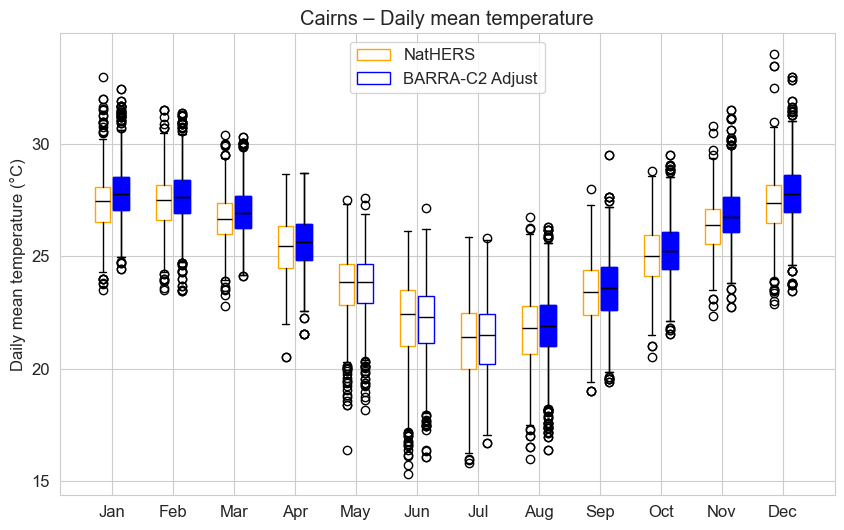

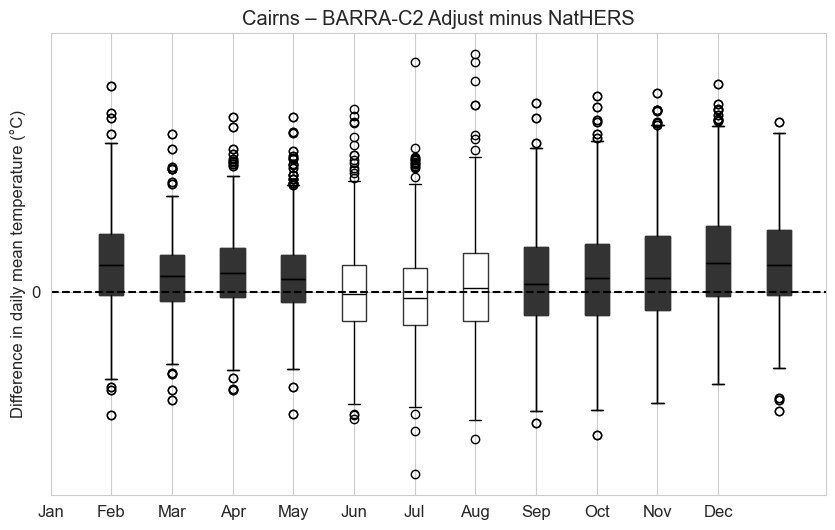


Brisbane — DAILY MAXIMUM TEMPERATURE
Brisbane     | maximum  | Jan | KS: stat= 0.187, p= 0.000 (SIG) | MW: stat=232641.5, p= 0.000 (SIG)
Brisbane     | maximum  | Feb | KS: stat= 0.132, p= 0.000 (SIG) | MW: stat=209966.0, p= 0.000 (SIG)
Brisbane     | maximum  | Mar | KS: stat= 0.163, p= 0.000 (SIG) | MW: stat=238617.0, p= 0.000 (SIG)
Brisbane     | maximum  | Apr | KS: stat= 0.240, p= 0.000 (SIG) | MW: stat=202999.5, p= 0.000 (SIG)
Brisbane     | maximum  | May | KS: stat= 0.250, p= 0.000 (SIG) | MW: stat=213007.0, p= 0.000 (SIG)
Brisbane     | maximum  | Jun | KS: stat= 0.225, p= 0.000 (SIG) | MW: stat=207713.0, p= 0.000 (SIG)
Brisbane     | maximum  | Jul | KS: stat= 0.274, p= 0.000 (SIG) | MW: stat=199240.0, p= 0.000 (SIG)
Brisbane     | maximum  | Aug | KS: stat= 0.276, p= 0.000 (SIG) | MW: stat=197113.0, p= 0.000 (SIG)
Brisbane     | maximum  | Sep | KS: stat= 0.256, p= 0.000 (SIG) | MW: stat=198708.0, p= 0.000 (SIG)
Brisbane     | maximum  | Oct | KS: stat= 0.222, p= 0.000 (SIG

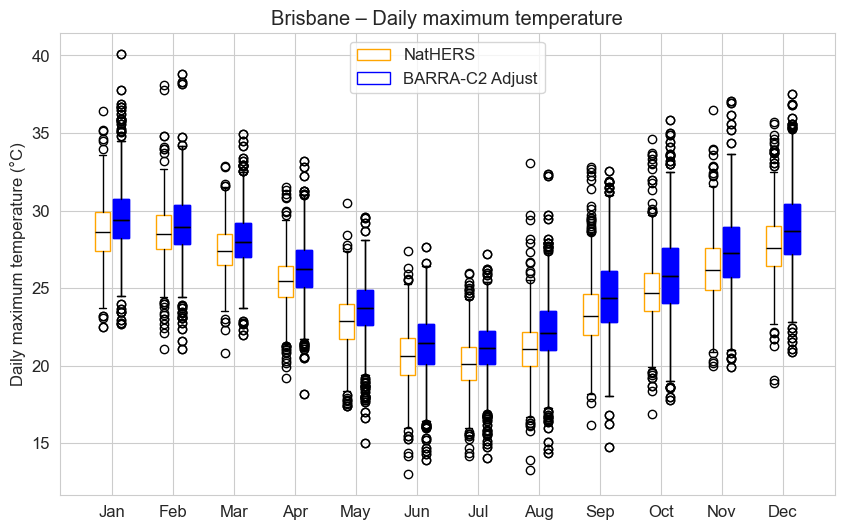

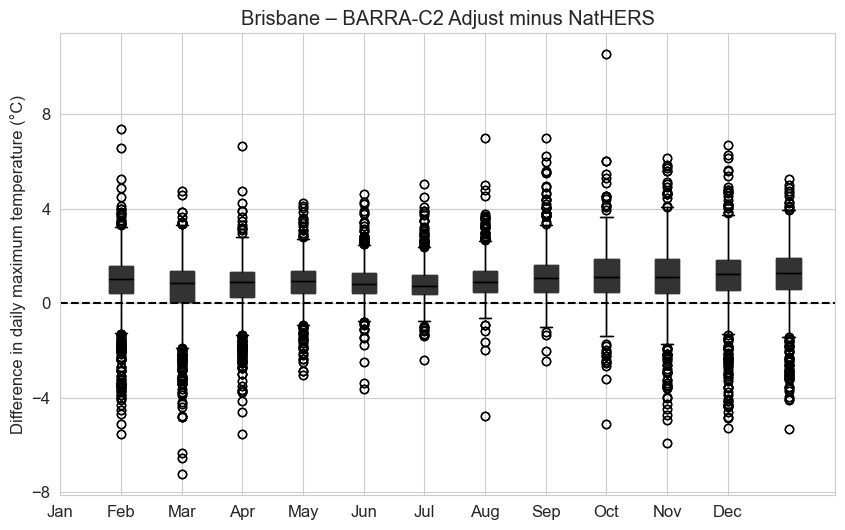


Brisbane — DAILY MINIMUM TEMPERATURE
Brisbane     | minimum  | Jan | KS: stat= 0.052, p= 0.254 (ns) | MW: stat=313689.0, p= 0.153 (ns)
Brisbane     | minimum  | Feb | KS: stat= 0.075, p= 0.037 (SIG) | MW: stat=265996.0, p= 0.029 (SIG)
Brisbane     | minimum  | Mar | KS: stat= 0.030, p= 0.885 (ns) | MW: stat=298685.0, p= 0.853 (ns)
Brisbane     | minimum  | Apr | KS: stat= 0.049, p= 0.321 (ns) | MW: stat=275382.0, p= 0.484 (ns)
Brisbane     | minimum  | May | KS: stat= 0.039, p= 0.607 (ns) | MW: stat=293143.5, p= 0.416 (ns)
Brisbane     | minimum  | Jun | KS: stat= 0.036, p= 0.716 (ns) | MW: stat=280061.0, p= 0.887 (ns)
Brisbane     | minimum  | Jul | KS: stat= 0.081, p= 0.012 (SIG) | MW: stat=317478.0, p= 0.051 (SIG)
Brisbane     | minimum  | Aug | KS: stat= 0.075, p= 0.026 (SIG) | MW: stat=313239.5, p= 0.142 (ns)
Brisbane     | minimum  | Sep | KS: stat= 0.057, p= 0.170 (ns) | MW: stat=294203.5, p= 0.123 (ns)
Brisbane     | minimum  | Oct | KS: stat= 0.077, p= 0.019 (SIG) | MW: stat=

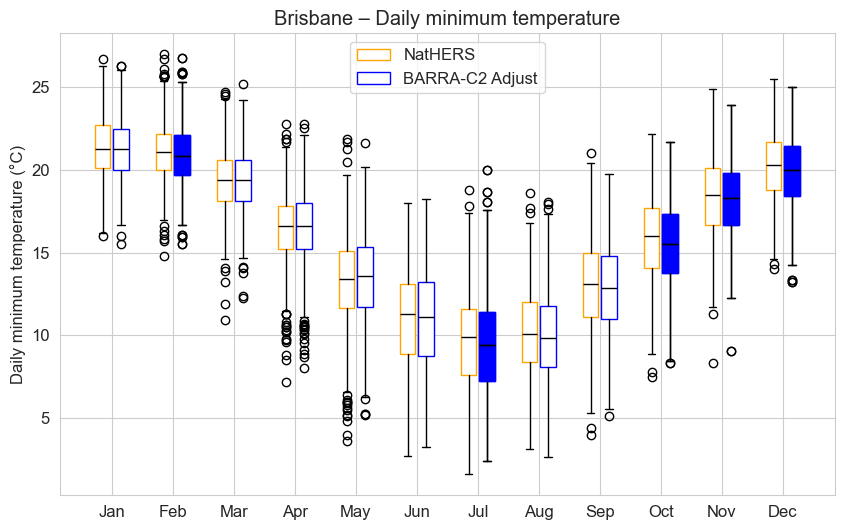

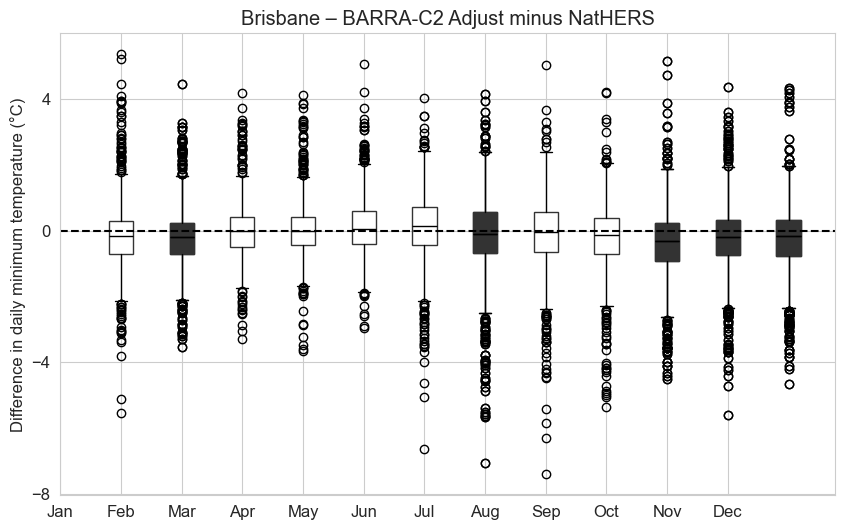


Brisbane — DAILY MEAN TEMPERATURE
Brisbane     | mean     | Jan | KS: stat= 0.079, p= 0.017 (SIG) | MW: stat=271913.0, p= 0.001 (SIG)
Brisbane     | mean     | Feb | KS: stat= 0.064, p= 0.114 (ns) | MW: stat=237573.5, p= 0.129 (ns)
Brisbane     | mean     | Mar | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=264719.0, p= 0.000 (SIG)
Brisbane     | mean     | Apr | KS: stat= 0.160, p= 0.000 (SIG) | MW: stat=231204.0, p= 0.000 (SIG)
Brisbane     | mean     | May | KS: stat= 0.145, p= 0.000 (SIG) | MW: stat=251036.5, p= 0.000 (SIG)
Brisbane     | mean     | Jun | KS: stat= 0.107, p= 0.000 (SIG) | MW: stat=246604.0, p= 0.000 (SIG)
Brisbane     | mean     | Jul | KS: stat= 0.110, p= 0.000 (SIG) | MW: stat=265380.5, p= 0.000 (SIG)
Brisbane     | mean     | Aug | KS: stat= 0.137, p= 0.000 (SIG) | MW: stat=252079.5, p= 0.000 (SIG)
Brisbane     | mean     | Sep | KS: stat= 0.099, p= 0.001 (SIG) | MW: stat=244203.5, p= 0.000 (SIG)
Brisbane     | mean     | Oct | KS: stat= 0.083, p= 0.010 (SIG) | M

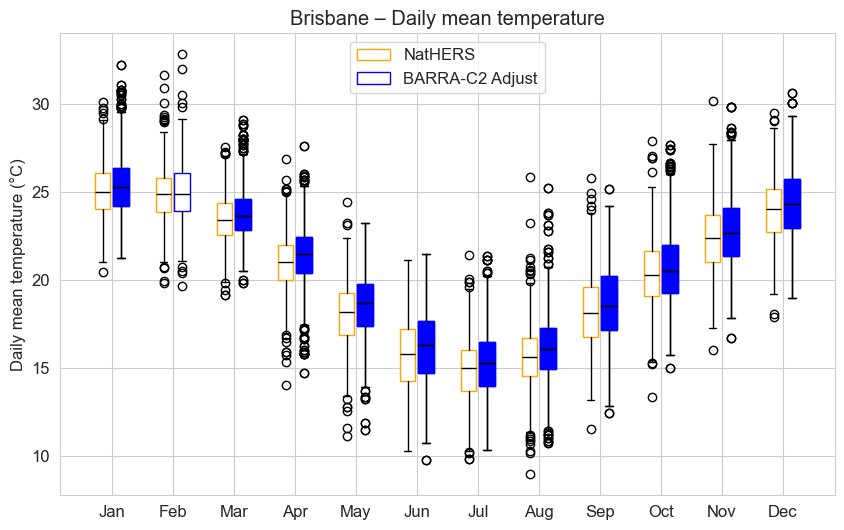

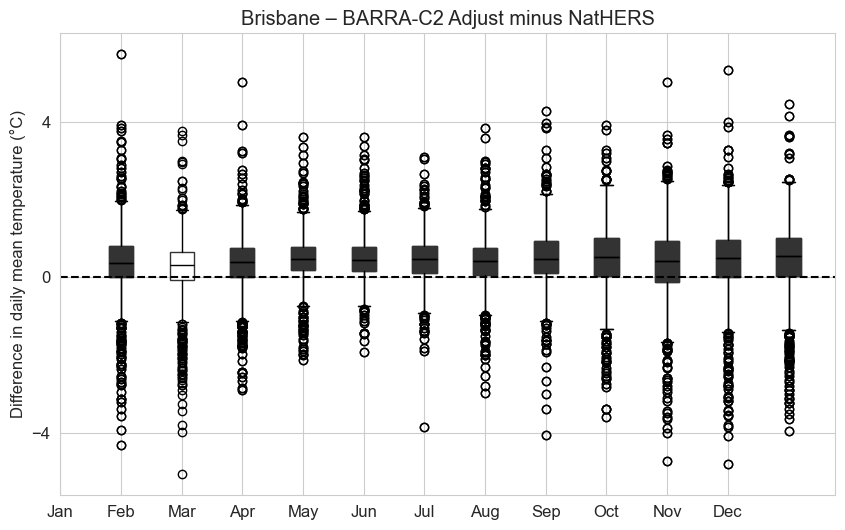


Melbourne — DAILY MAXIMUM TEMPERATURE
Melbourne    | maximum  | Jan | KS: stat= 0.116, p= 0.000 (SIG) | MW: stat=270303.5, p= 0.000 (SIG)
Melbourne    | maximum  | Feb | KS: stat= 0.091, p= 0.006 (SIG) | MW: stat=230756.0, p= 0.016 (SIG)
Melbourne    | maximum  | Mar | KS: stat= 0.111, p= 0.000 (SIG) | MW: stat=274541.0, p= 0.003 (SIG)
Melbourne    | maximum  | Apr | KS: stat= 0.084, p= 0.010 (SIG) | MW: stat=261647.5, p= 0.019 (SIG)
Melbourne    | maximum  | May | KS: stat= 0.107, p= 0.000 (SIG) | MW: stat=272348.5, p= 0.002 (SIG)
Melbourne    | maximum  | Jun | KS: stat= 0.105, p= 0.000 (SIG) | MW: stat=263099.5, p= 0.030 (SIG)
Melbourne    | maximum  | Jul | KS: stat= 0.147, p= 0.000 (SIG) | MW: stat=261966.0, p= 0.000 (SIG)
Melbourne    | maximum  | Aug | KS: stat= 0.126, p= 0.000 (SIG) | MW: stat=269137.0, p= 0.000 (SIG)
Melbourne    | maximum  | Sep | KS: stat= 0.104, p= 0.001 (SIG) | MW: stat=256114.0, p= 0.003 (SIG)
Melbourne    | maximum  | Oct | KS: stat= 0.097, p= 0.001 (SI

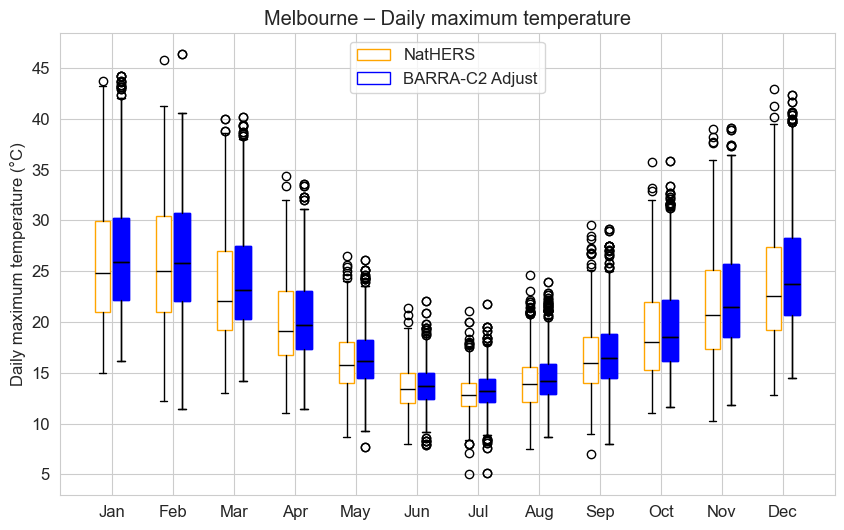

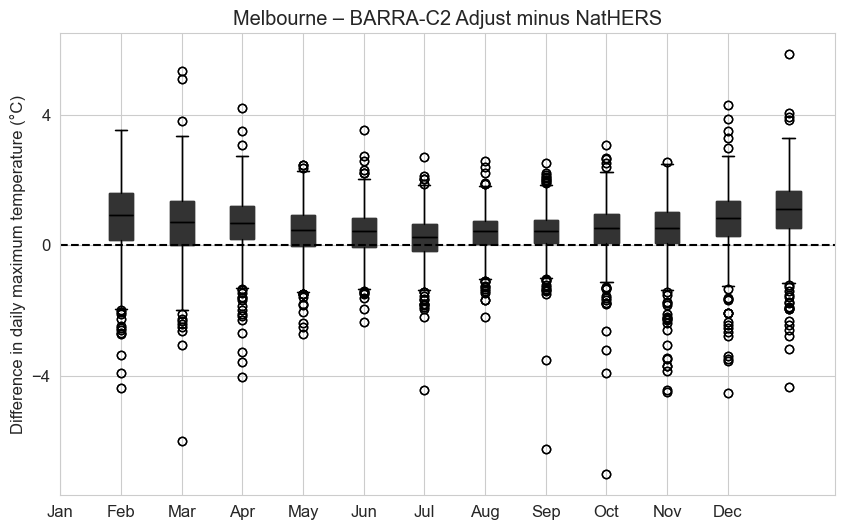


Melbourne — DAILY MINIMUM TEMPERATURE
Melbourne    | minimum  | Jan | KS: stat= 0.121, p= 0.000 (SIG) | MW: stat=336291.0, p= 0.000 (SIG)
Melbourne    | minimum  | Feb | KS: stat= 0.123, p= 0.000 (SIG) | MW: stat=277780.0, p= 0.000 (SIG)
Melbourne    | minimum  | Mar | KS: stat= 0.142, p= 0.000 (SIG) | MW: stat=346942.0, p= 0.000 (SIG)
Melbourne    | minimum  | Apr | KS: stat= 0.140, p= 0.000 (SIG) | MW: stat=322317.5, p= 0.000 (SIG)
Melbourne    | minimum  | May | KS: stat= 0.160, p= 0.000 (SIG) | MW: stat=356840.5, p= 0.000 (SIG)
Melbourne    | minimum  | Jun | KS: stat= 0.191, p= 0.000 (SIG) | MW: stat=342256.0, p= 0.000 (SIG)
Melbourne    | minimum  | Jul | KS: stat= 0.183, p= 0.000 (SIG) | MW: stat=364797.5, p= 0.000 (SIG)
Melbourne    | minimum  | Aug | KS: stat= 0.206, p= 0.000 (SIG) | MW: stat=370776.5, p= 0.000 (SIG)
Melbourne    | minimum  | Sep | KS: stat= 0.165, p= 0.000 (SIG) | MW: stat=333165.5, p= 0.000 (SIG)
Melbourne    | minimum  | Oct | KS: stat= 0.139, p= 0.000 (SI

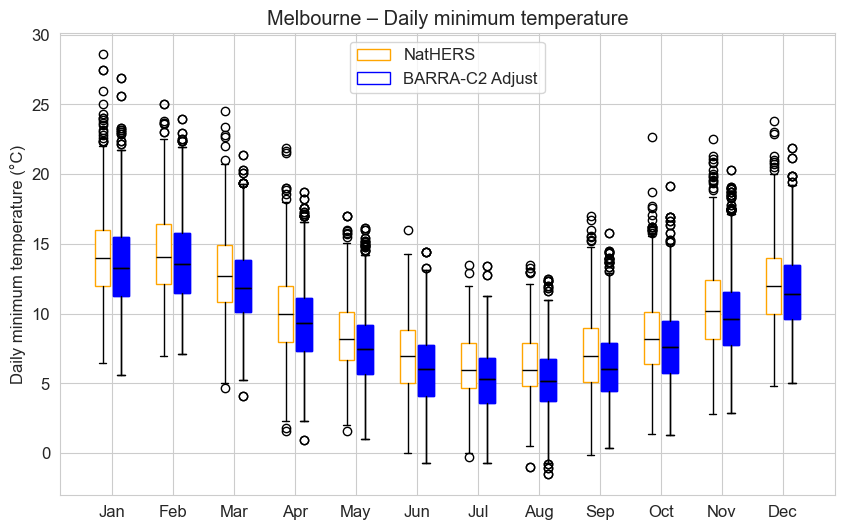

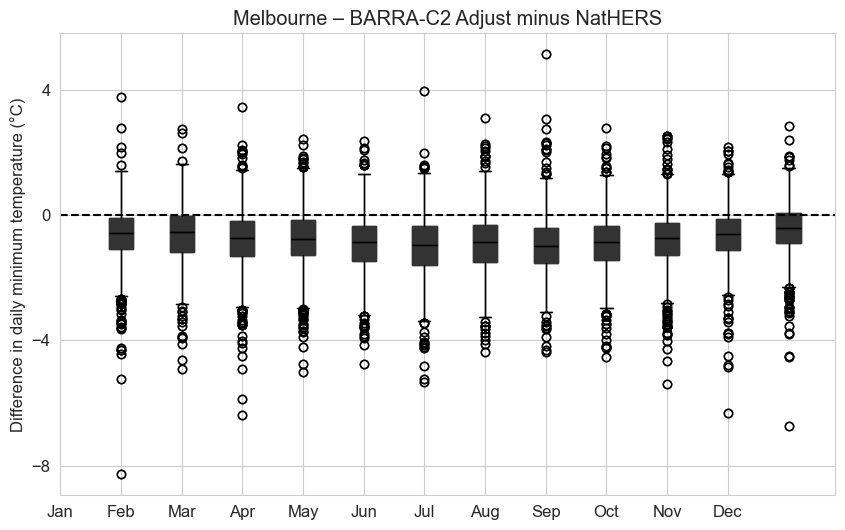


Melbourne — DAILY MEAN TEMPERATURE
Melbourne    | mean     | Jan | KS: stat= 0.052, p= 0.254 (ns) | MW: stat=293224.5, p= 0.373 (ns)
Melbourne    | mean     | Feb | KS: stat= 0.037, p= 0.725 (ns) | MW: stat=247032.0, p= 0.775 (ns)
Melbourne    | mean     | Mar | KS: stat= 0.035, p= 0.735 (ns) | MW: stat=301375.0, p= 0.904 (ns)
Melbourne    | mean     | Apr | KS: stat= 0.036, p= 0.716 (ns) | MW: stat=288525.0, p= 0.386 (ns)
Melbourne    | mean     | May | KS: stat= 0.066, p= 0.070 (SIG) | MW: stat=316906.0, p= 0.060 (SIG)
Melbourne    | mean     | Jun | KS: stat= 0.108, p= 0.000 (SIG) | MW: stat=312752.0, p= 0.000 (SIG)
Melbourne    | mean     | Jul | KS: stat= 0.077, p= 0.019 (SIG) | MW: stat=323587.0, p= 0.008 (SIG)
Melbourne    | mean     | Aug | KS: stat= 0.086, p= 0.006 (SIG) | MW: stat=322697.0, p= 0.011 (SIG)
Melbourne    | mean     | Sep | KS: stat= 0.056, p= 0.190 (ns) | MW: stat=292303.5, p= 0.188 (ns)
Melbourne    | mean     | Oct | KS: stat= 0.041, p= 0.524 (ns) | MW: stat=

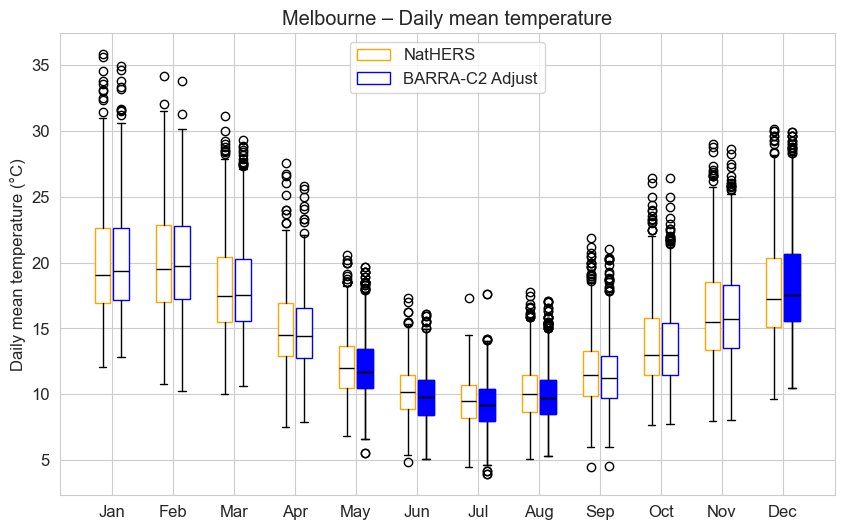

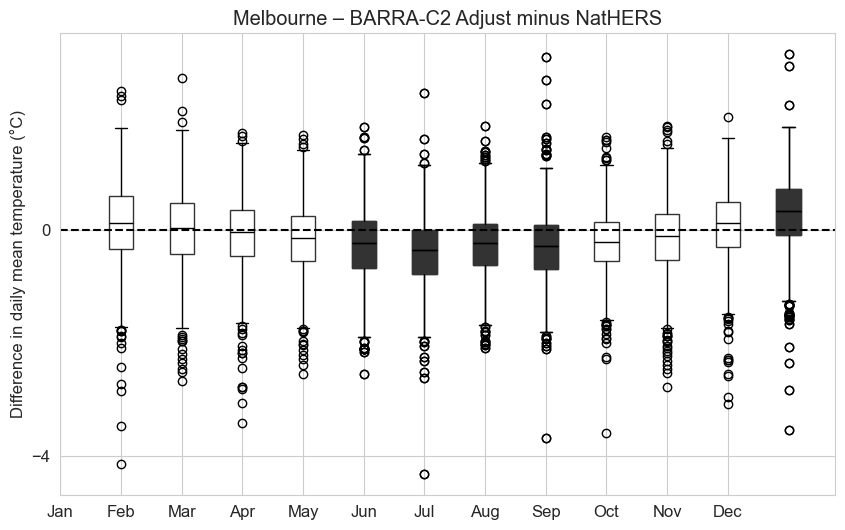


Darwin — DAILY MAXIMUM TEMPERATURE
Darwin       | maximum  | Jan | KS: stat= 0.354, p= 0.000 (SIG) | MW: stat=181187.0, p= 0.000 (SIG)
Darwin       | maximum  | Feb | KS: stat= 0.272, p= 0.000 (SIG) | MW: stat=163053.5, p= 0.000 (SIG)
Darwin       | maximum  | Mar | KS: stat= 0.412, p= 0.000 (SIG) | MW: stat=164796.0, p= 0.000 (SIG)
Darwin       | maximum  | Apr | KS: stat= 0.459, p= 0.000 (SIG) | MW: stat=133338.0, p= 0.000 (SIG)
Darwin       | maximum  | May | KS: stat= 0.431, p= 0.000 (SIG) | MW: stat=152481.5, p= 0.000 (SIG)
Darwin       | maximum  | Jun | KS: stat= 0.349, p= 0.000 (SIG) | MW: stat=168817.0, p= 0.000 (SIG)
Darwin       | maximum  | Jul | KS: stat= 0.426, p= 0.000 (SIG) | MW: stat=146440.0, p= 0.000 (SIG)
Darwin       | maximum  | Aug | KS: stat= 0.494, p= 0.000 (SIG) | MW: stat=121067.0, p= 0.000 (SIG)
Darwin       | maximum  | Sep | KS: stat= 0.532, p= 0.000 (SIG) | MW: stat= 96885.0, p= 0.000 (SIG)
Darwin       | maximum  | Oct | KS: stat= 0.583, p= 0.000 (SIG) 

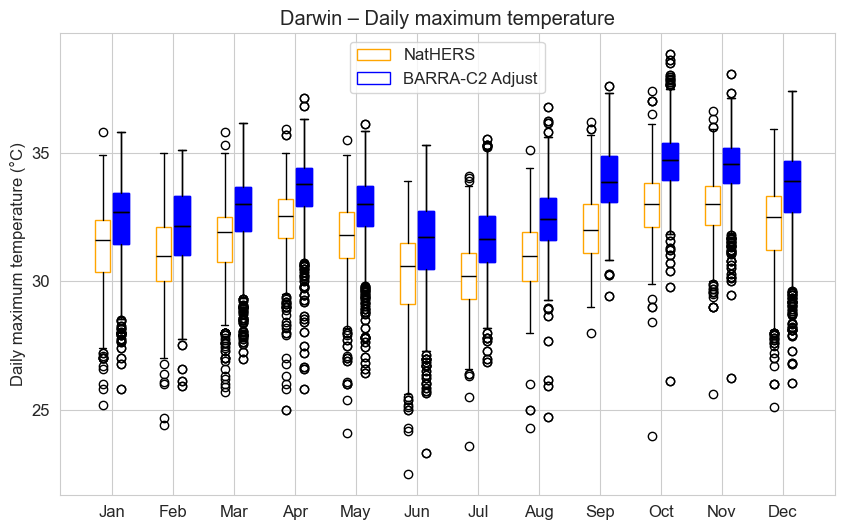

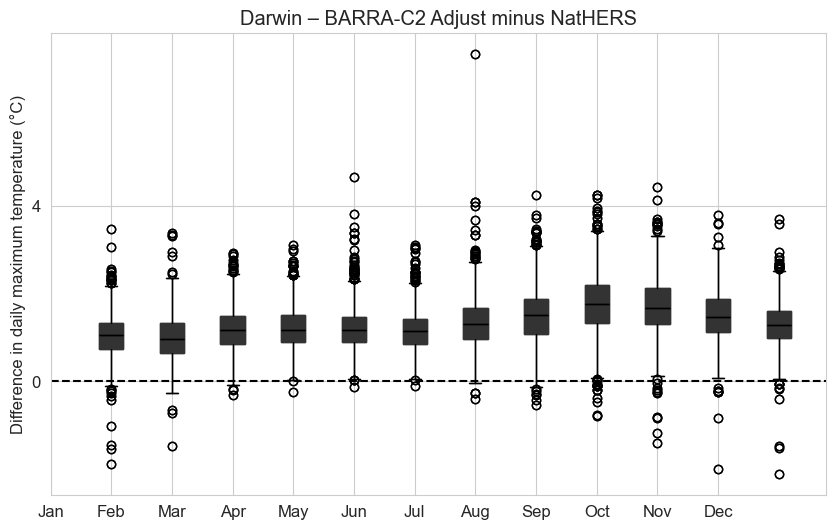


Darwin — DAILY MINIMUM TEMPERATURE
Darwin       | minimum  | Jan | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=342576.5, p= 0.000 (SIG)
Darwin       | minimum  | Feb | KS: stat= 0.163, p= 0.000 (SIG) | MW: stat=289665.5, p= 0.000 (SIG)
Darwin       | minimum  | Mar | KS: stat= 0.134, p= 0.000 (SIG) | MW: stat=330259.0, p= 0.001 (SIG)
Darwin       | minimum  | Apr | KS: stat= 0.067, p= 0.071 (SIG) | MW: stat=282480.0, p= 0.883 (ns)
Darwin       | minimum  | May | KS: stat= 0.077, p= 0.019 (SIG) | MW: stat=319102.5, p= 0.033 (SIG)
Darwin       | minimum  | Jun | KS: stat= 0.089, p= 0.005 (SIG) | MW: stat=308228.5, p= 0.001 (SIG)
Darwin       | minimum  | Jul | KS: stat= 0.126, p= 0.000 (SIG) | MW: stat=340167.0, p= 0.000 (SIG)
Darwin       | minimum  | Aug | KS: stat= 0.170, p= 0.000 (SIG) | MW: stat=358994.0, p= 0.000 (SIG)
Darwin       | minimum  | Sep | KS: stat= 0.209, p= 0.000 (SIG) | MW: stat=342022.0, p= 0.000 (SIG)
Darwin       | minimum  | Oct | KS: stat= 0.255, p= 0.000 (SIG) |

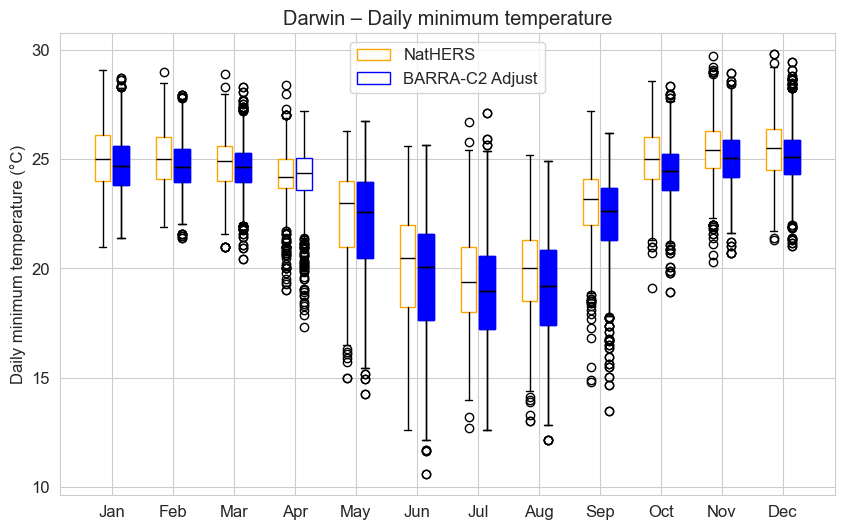

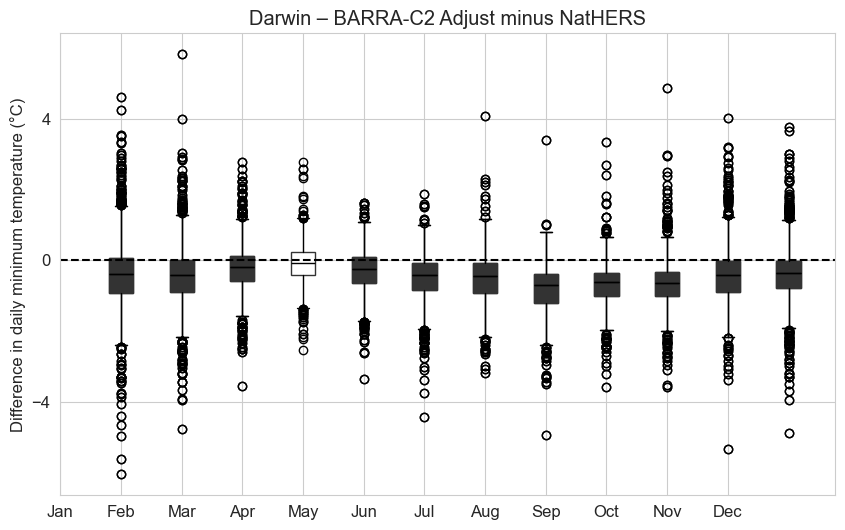


Darwin — DAILY MEAN TEMPERATURE
Darwin       | mean     | Jan | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=254178.5, p= 0.000 (SIG)
Darwin       | mean     | Feb | KS: stat= 0.149, p= 0.000 (SIG) | MW: stat=213562.0, p= 0.000 (SIG)
Darwin       | mean     | Mar | KS: stat= 0.235, p= 0.000 (SIG) | MW: stat=217007.0, p= 0.000 (SIG)
Darwin       | mean     | Apr | KS: stat= 0.293, p= 0.000 (SIG) | MW: stat=188492.0, p= 0.000 (SIG)
Darwin       | mean     | May | KS: stat= 0.194, p= 0.000 (SIG) | MW: stat=246250.5, p= 0.000 (SIG)
Darwin       | mean     | Jun | KS: stat= 0.129, p= 0.000 (SIG) | MW: stat=250871.5, p= 0.000 (SIG)
Darwin       | mean     | Jul | KS: stat= 0.139, p= 0.000 (SIG) | MW: stat=256988.5, p= 0.000 (SIG)
Darwin       | mean     | Aug | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=257282.5, p= 0.000 (SIG)
Darwin       | mean     | Sep | KS: stat= 0.219, p= 0.000 (SIG) | MW: stat=207337.5, p= 0.000 (SIG)
Darwin       | mean     | Oct | KS: stat= 0.259, p= 0.000 (SIG) | M

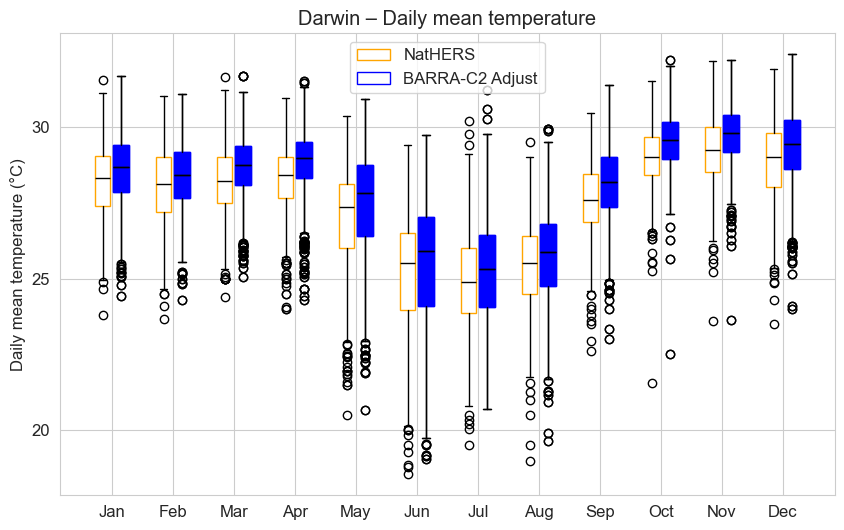

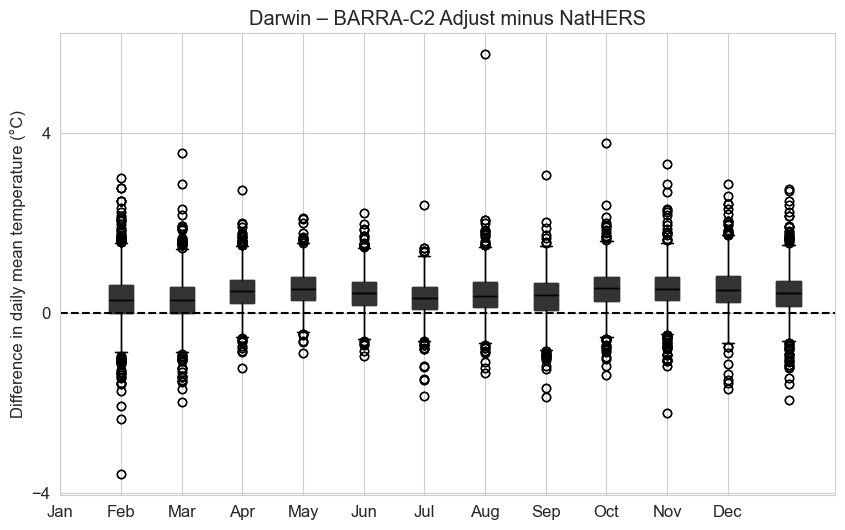


Longreach — DAILY MAXIMUM TEMPERATURE
Longreach    | maximum  | Jan | KS: stat= 0.129, p= 0.000 (SIG) | MW: stat=255234.0, p= 0.000 (SIG)
Longreach    | maximum  | Feb | KS: stat= 0.125, p= 0.000 (SIG) | MW: stat=214371.0, p= 0.000 (SIG)
Longreach    | maximum  | Mar | KS: stat= 0.186, p= 0.000 (SIG) | MW: stat=235685.0, p= 0.000 (SIG)
Longreach    | maximum  | Apr | KS: stat= 0.144, p= 0.000 (SIG) | MW: stat=238541.0, p= 0.000 (SIG)
Longreach    | maximum  | May | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=249198.0, p= 0.000 (SIG)
Longreach    | maximum  | Jun | KS: stat= 0.089, p= 0.005 (SIG) | MW: stat=249901.0, p= 0.000 (SIG)
Longreach    | maximum  | Jul | KS: stat= 0.134, p= 0.000 (SIG) | MW: stat=258158.5, p= 0.000 (SIG)
Longreach    | maximum  | Aug | KS: stat= 0.124, p= 0.000 (SIG) | MW: stat=259202.5, p= 0.000 (SIG)
Longreach    | maximum  | Sep | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=247382.5, p= 0.000 (SIG)
Longreach    | maximum  | Oct | KS: stat= 0.120, p= 0.000 (SI

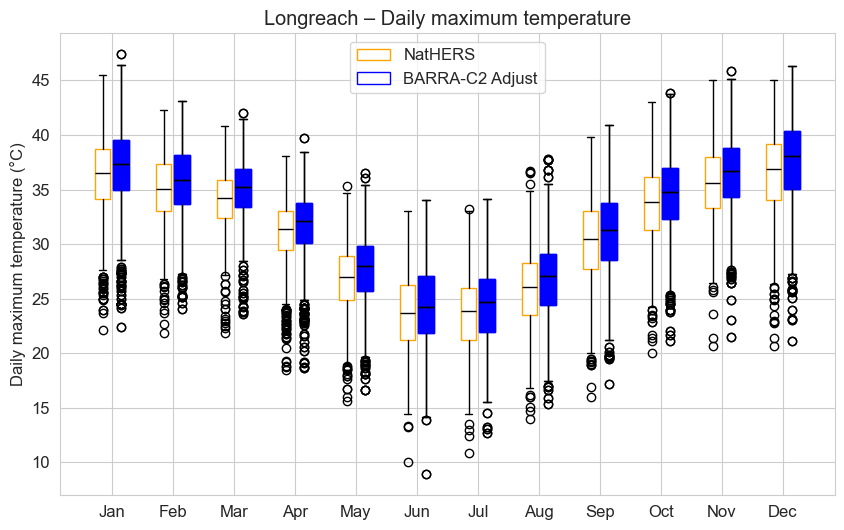

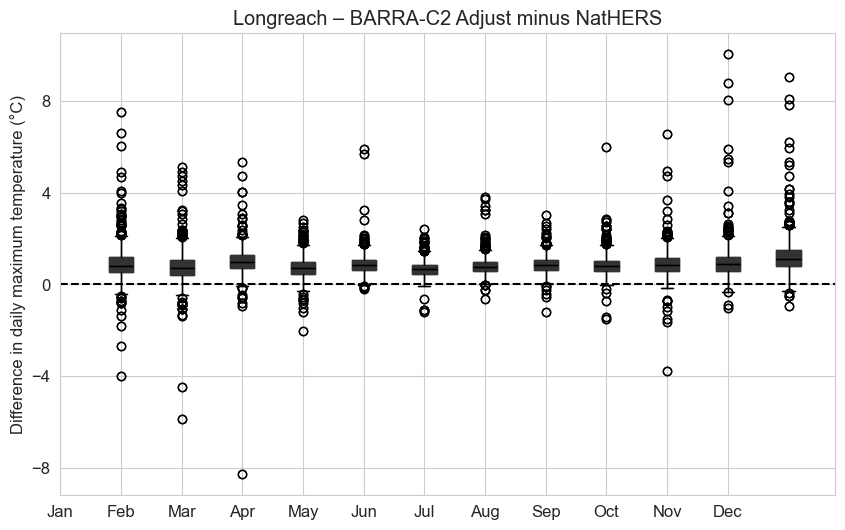


Longreach — DAILY MINIMUM TEMPERATURE
Longreach    | minimum  | Jan | KS: stat= 0.062, p= 0.103 (ns) | MW: stat=287287.0, p= 0.118 (ns)
Longreach    | minimum  | Feb | KS: stat= 0.034, p= 0.810 (ns) | MW: stat=247699.0, p= 0.843 (ns)
Longreach    | minimum  | Mar | KS: stat= 0.031, p= 0.852 (ns) | MW: stat=302555.5, p= 0.799 (ns)
Longreach    | minimum  | Apr | KS: stat= 0.055, p= 0.212 (ns) | MW: stat=291422.0, p= 0.225 (ns)
Longreach    | minimum  | May | KS: stat= 0.030, p= 0.885 (ns) | MW: stat=302356.0, p= 0.817 (ns)
Longreach    | minimum  | Jun | KS: stat= 0.036, p= 0.716 (ns) | MW: stat=285234.5, p= 0.635 (ns)
Longreach    | minimum  | Jul | KS: stat= 0.030, p= 0.885 (ns) | MW: stat=295156.5, p= 0.558 (ns)
Longreach    | minimum  | Aug | KS: stat= 0.025, p= 0.974 (ns) | MW: stat=299996.0, p= 0.971 (ns)
Longreach    | minimum  | Sep | KS: stat= 0.025, p= 0.970 (ns) | MW: stat=280526.5, p= 0.931 (ns)
Longreach    | minimum  | Oct | KS: stat= 0.031, p= 0.852 (ns) | MW: stat=30594

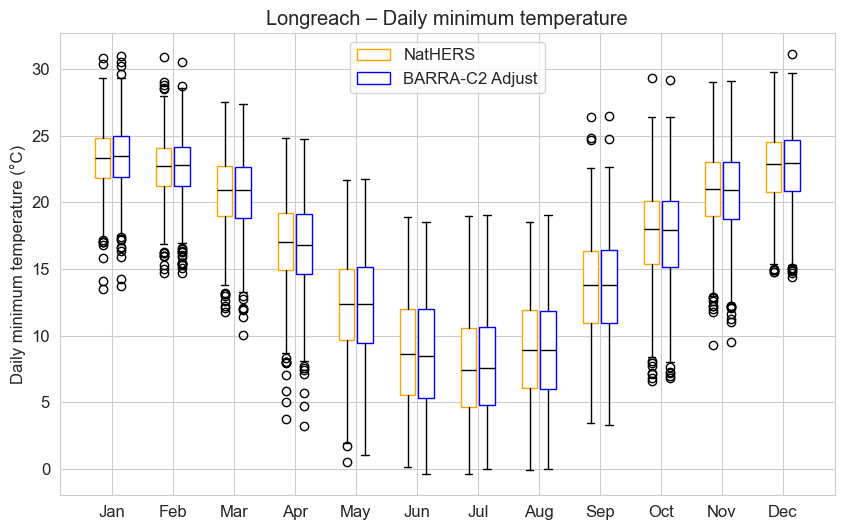

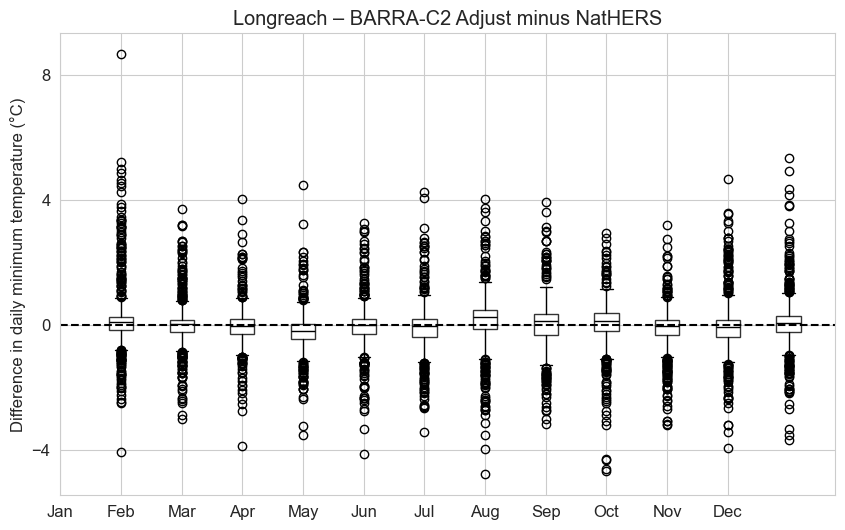


Longreach — DAILY MEAN TEMPERATURE
Longreach    | mean     | Jan | KS: stat= 0.106, p= 0.000 (SIG) | MW: stat=263047.0, p= 0.000 (SIG)
Longreach    | mean     | Feb | KS: stat= 0.092, p= 0.005 (SIG) | MW: stat=225773.0, p= 0.002 (SIG)
Longreach    | mean     | Mar | KS: stat= 0.102, p= 0.001 (SIG) | MW: stat=263914.0, p= 0.000 (SIG)
Longreach    | mean     | Apr | KS: stat= 0.057, p= 0.170 (ns) | MW: stat=264936.0, p= 0.052 (SIG)
Longreach    | mean     | May | KS: stat= 0.076, p= 0.022 (SIG) | MW: stat=276427.0, p= 0.007 (SIG)
Longreach    | mean     | Jun | KS: stat= 0.047, p= 0.388 (ns) | MW: stat=267023.5, p= 0.090 (SIG)
Longreach    | mean     | Jul | KS: stat= 0.071, p= 0.040 (SIG) | MW: stat=275065.0, p= 0.004 (SIG)
Longreach    | mean     | Aug | KS: stat= 0.076, p= 0.022 (SIG) | MW: stat=277198.0, p= 0.009 (SIG)
Longreach    | mean     | Sep | KS: stat= 0.063, p= 0.105 (ns) | MW: stat=262115.5, p= 0.023 (SIG)
Longreach    | mean     | Oct | KS: stat= 0.067, p= 0.061 (SIG) | M

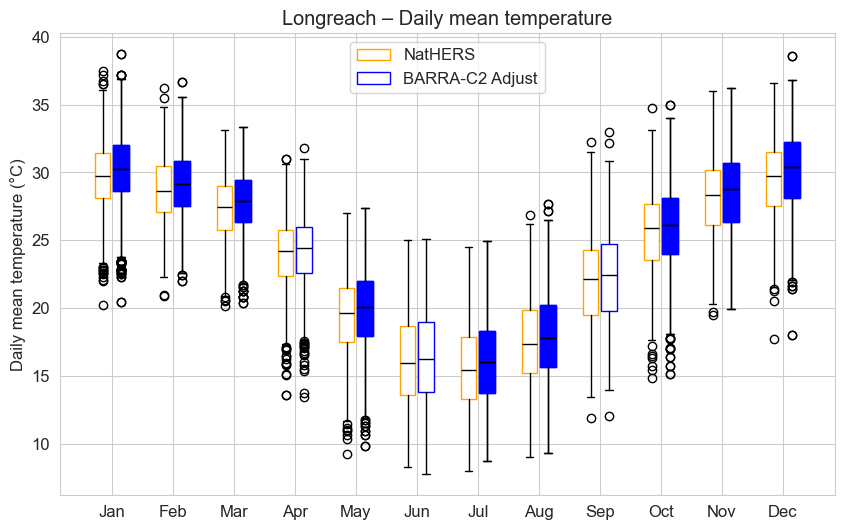

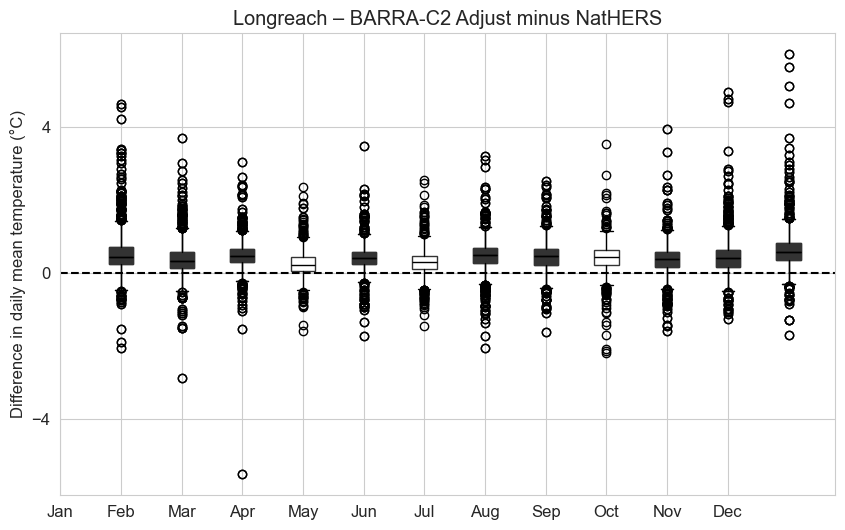


Mildura — DAILY MAXIMUM TEMPERATURE
Mildura      | maximum  | Jan | KS: stat= 0.079, p= 0.017 (SIG) | MW: stat=275864.0, p= 0.004 (SIG)
Mildura      | maximum  | Feb | KS: stat= 0.093, p= 0.004 (SIG) | MW: stat=226279.0, p= 0.003 (SIG)
Mildura      | maximum  | Mar | KS: stat= 0.080, p= 0.014 (SIG) | MW: stat=276829.0, p= 0.008 (SIG)
Mildura      | maximum  | Apr | KS: stat= 0.067, p= 0.071 (SIG) | MW: stat=261085.0, p= 0.016 (SIG)
Mildura      | maximum  | May | KS: stat= 0.115, p= 0.000 (SIG) | MW: stat=263471.0, p= 0.000 (SIG)
Mildura      | maximum  | Jun | KS: stat= 0.120, p= 0.000 (SIG) | MW: stat=243548.5, p= 0.000 (SIG)
Mildura      | maximum  | Jul | KS: stat= 0.105, p= 0.000 (SIG) | MW: stat=269675.0, p= 0.001 (SIG)
Mildura      | maximum  | Aug | KS: stat= 0.102, p= 0.001 (SIG) | MW: stat=265653.0, p= 0.000 (SIG)
Mildura      | maximum  | Sep | KS: stat= 0.100, p= 0.001 (SIG) | MW: stat=250052.0, p= 0.000 (SIG)
Mildura      | maximum  | Oct | KS: stat= 0.077, p= 0.019 (SIG)

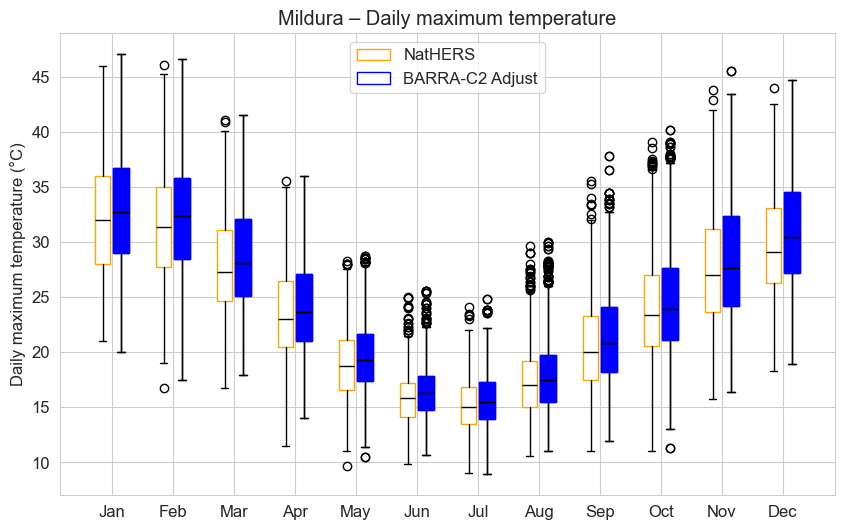

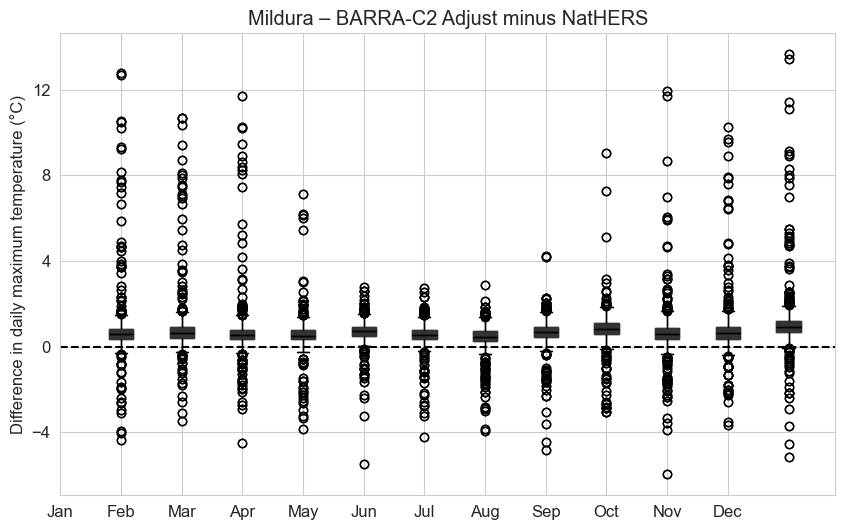


Mildura — DAILY MINIMUM TEMPERATURE
Mildura      | minimum  | Jan | KS: stat= 0.081, p= 0.012 (SIG) | MW: stat=318029.0, p= 0.055 (SIG)
Mildura      | minimum  | Feb | KS: stat= 0.047, p= 0.424 (ns) | MW: stat=256951.0, p= 0.313 (ns)
Mildura      | minimum  | Mar | KS: stat= 0.070, p= 0.046 (SIG) | MW: stat=320229.0, p= 0.024 (SIG)
Mildura      | minimum  | Apr | KS: stat= 0.039, p= 0.630 (ns) | MW: stat=284169.0, p= 0.728 (ns)
Mildura      | minimum  | May | KS: stat= 0.044, p= 0.445 (ns) | MW: stat=305393.0, p= 0.564 (ns)
Mildura      | minimum  | Jun | KS: stat= 0.075, p= 0.031 (SIG) | MW: stat=299644.0, p= 0.028 (SIG)
Mildura      | minimum  | Jul | KS: stat= 0.117, p= 0.000 (SIG) | MW: stat=323567.5, p= 0.008 (SIG)
Mildura      | minimum  | Aug | KS: stat= 0.050, p= 0.280 (ns) | MW: stat=301619.5, p= 0.882 (ns)
Mildura      | minimum  | Sep | KS: stat= 0.067, p= 0.071 (SIG) | MW: stat=276087.0, p= 0.538 (ns)
Mildura      | minimum  | Oct | KS: stat= 0.037, p= 0.650 (ns) | MW: sta

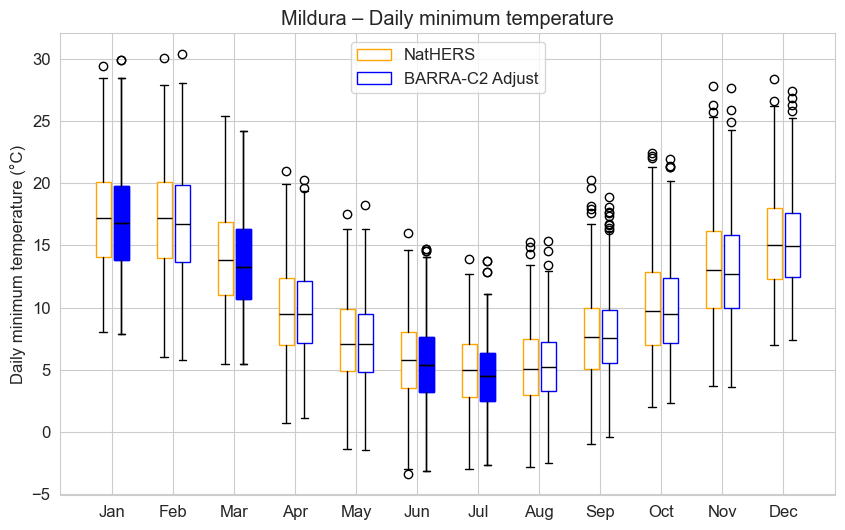

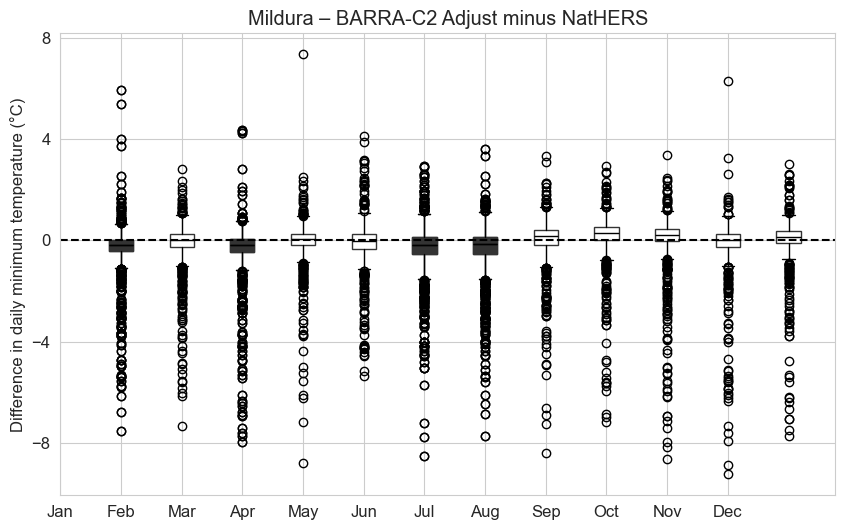


Mildura — DAILY MEAN TEMPERATURE
Mildura      | mean     | Jan | KS: stat= 0.040, p= 0.566 (ns) | MW: stat=293713.5, p= 0.404 (ns)
Mildura      | mean     | Feb | KS: stat= 0.051, p= 0.318 (ns) | MW: stat=238910.0, p= 0.178 (ns)
Mildura      | mean     | Mar | KS: stat= 0.032, p= 0.815 (ns) | MW: stat=296445.5, p= 0.661 (ns)
Mildura      | mean     | Apr | KS: stat= 0.043, p= 0.502 (ns) | MW: stat=271156.0, p= 0.229 (ns)
Mildura      | mean     | May | KS: stat= 0.061, p= 0.116 (ns) | MW: stat=282699.5, p= 0.046 (SIG)
Mildura      | mean     | Jun | KS: stat= 0.036, p= 0.716 (ns) | MW: stat=275248.0, p= 0.474 (ns)
Mildura      | mean     | Jul | KS: stat= 0.034, p= 0.776 (ns) | MW: stat=298915.0, p= 0.874 (ns)
Mildura      | mean     | Aug | KS: stat= 0.074, p= 0.030 (SIG) | MW: stat=279245.0, p= 0.017 (SIG)
Mildura      | mean     | Sep | KS: stat= 0.079, p= 0.019 (SIG) | MW: stat=258217.0, p= 0.006 (SIG)
Mildura      | mean     | Oct | KS: stat= 0.052, p= 0.253 (ns) | MW: stat=28706

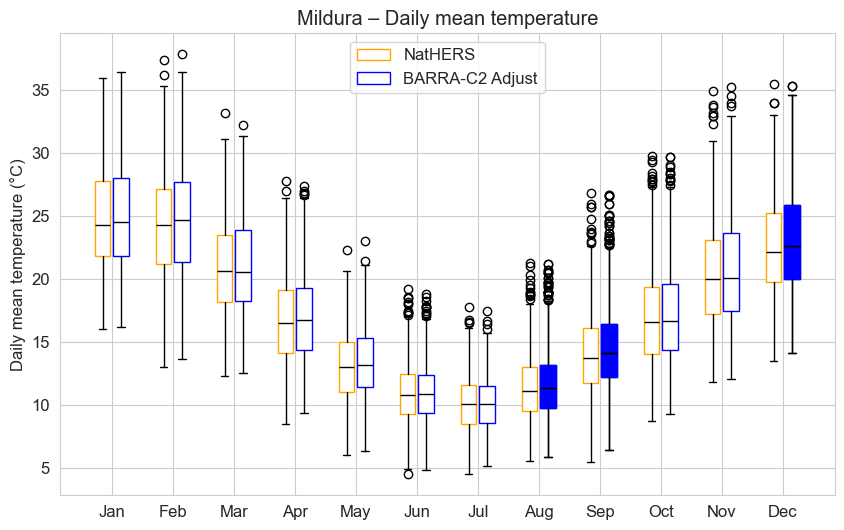

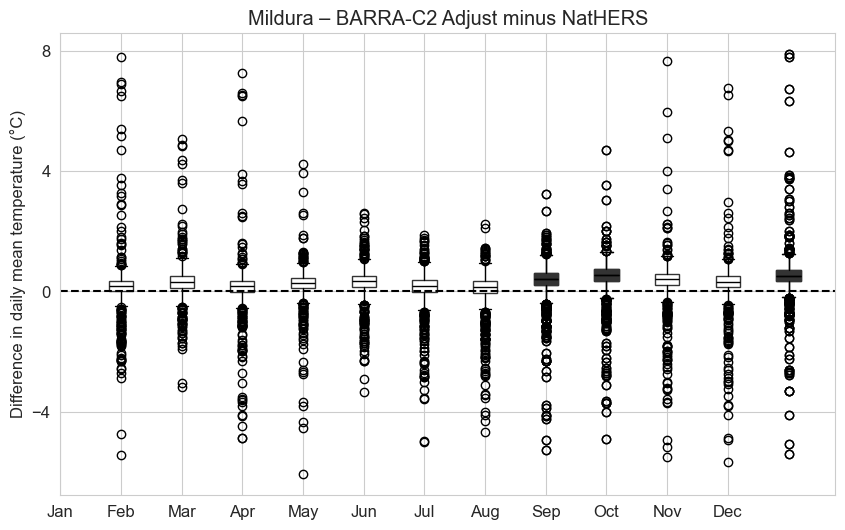


Adelaide — DAILY MAXIMUM TEMPERATURE
Adelaide     | maximum  | Jan | KS: stat= 0.049, p= 0.310 (ns) | MW: stat=305780.5, p= 0.595 (ns)
Adelaide     | maximum  | Feb | KS: stat= 0.042, p= 0.547 (ns) | MW: stat=252535.0, p= 0.665 (ns)
Adelaide     | maximum  | Mar | KS: stat= 0.043, p= 0.484 (ns) | MW: stat=293126.0, p= 0.415 (ns)
Adelaide     | maximum  | Apr | KS: stat= 0.047, p= 0.388 (ns) | MW: stat=276170.0, p= 0.545 (ns)
Adelaide     | maximum  | May | KS: stat= 0.045, p= 0.408 (ns) | MW: stat=303276.0, p= 0.737 (ns)
Adelaide     | maximum  | Jun | KS: stat= 0.069, p= 0.054 (SIG) | MW: stat=294475.5, p= 0.115 (ns)
Adelaide     | maximum  | Jul | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=321052.5, p= 0.019 (SIG)
Adelaide     | maximum  | Aug | KS: stat= 0.089, p= 0.004 (SIG) | MW: stat=319543.0, p= 0.029 (SIG)
Adelaide     | maximum  | Sep | KS: stat= 0.091, p= 0.004 (SIG) | MW: stat=298157.0, p= 0.044 (SIG)
Adelaide     | maximum  | Oct | KS: stat= 0.046, p= 0.373 (ns) | MW: stat

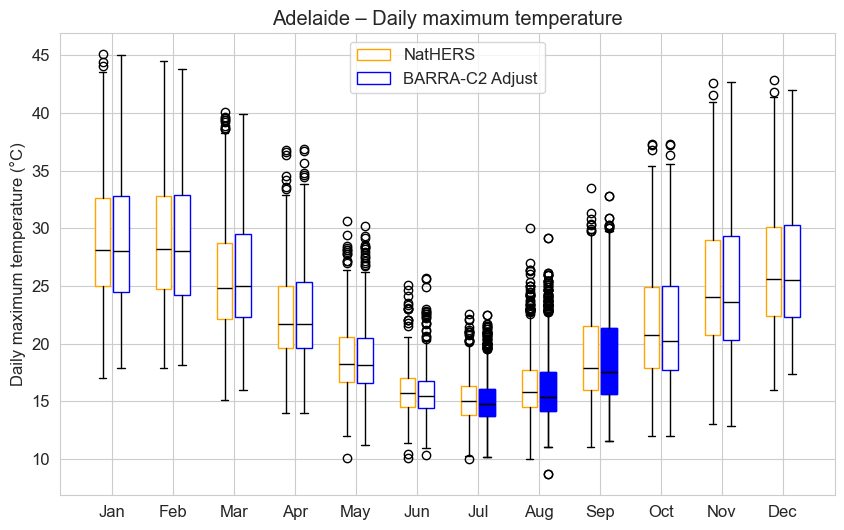

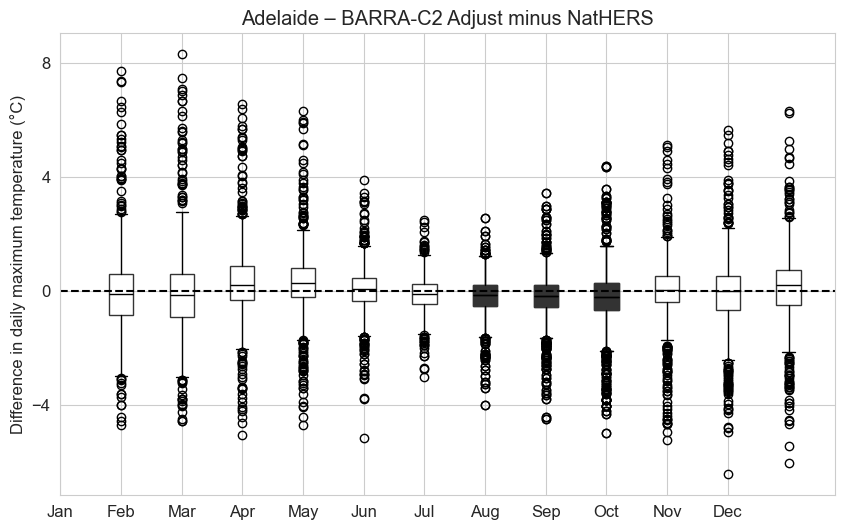


Adelaide — DAILY MINIMUM TEMPERATURE
Adelaide     | minimum  | Jan | KS: stat= 0.161, p= 0.000 (SIG) | MW: stat=351754.0, p= 0.000 (SIG)
Adelaide     | minimum  | Feb | KS: stat= 0.153, p= 0.000 (SIG) | MW: stat=289858.5, p= 0.000 (SIG)
Adelaide     | minimum  | Mar | KS: stat= 0.076, p= 0.022 (SIG) | MW: stat=318412.5, p= 0.040 (SIG)
Adelaide     | minimum  | Apr | KS: stat= 0.043, p= 0.502 (ns) | MW: stat=279447.5, p= 0.830 (ns)
Adelaide     | minimum  | May | KS: stat= 0.070, p= 0.046 (SIG) | MW: stat=281369.0, p= 0.032 (SIG)
Adelaide     | minimum  | Jun | KS: stat= 0.057, p= 0.170 (ns) | MW: stat=267994.0, p= 0.114 (ns)
Adelaide     | minimum  | Jul | KS: stat= 0.072, p= 0.035 (SIG) | MW: stat=291210.0, p= 0.302 (ns)
Adelaide     | minimum  | Aug | KS: stat= 0.068, p= 0.053 (SIG) | MW: stat=313174.0, p= 0.144 (ns)
Adelaide     | minimum  | Sep | KS: stat= 0.153, p= 0.000 (SIG) | MW: stat=325309.0, p= 0.000 (SIG)
Adelaide     | minimum  | Oct | KS: stat= 0.152, p= 0.000 (SIG) | MW

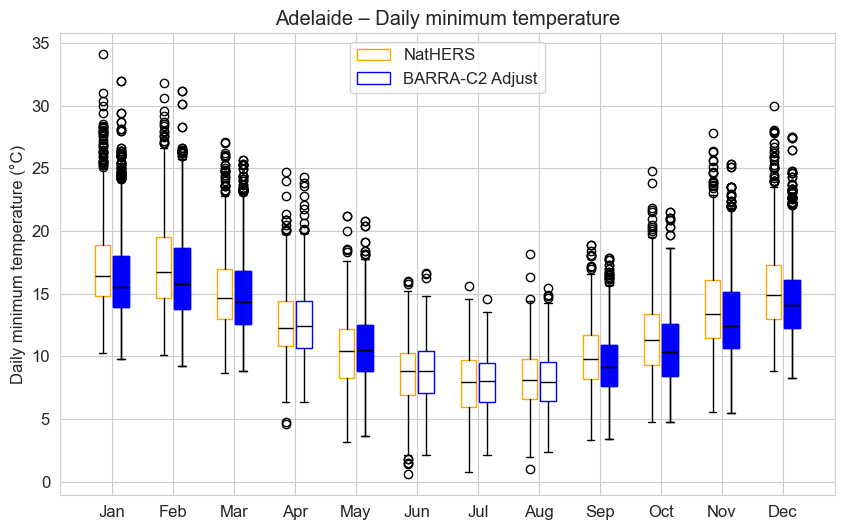

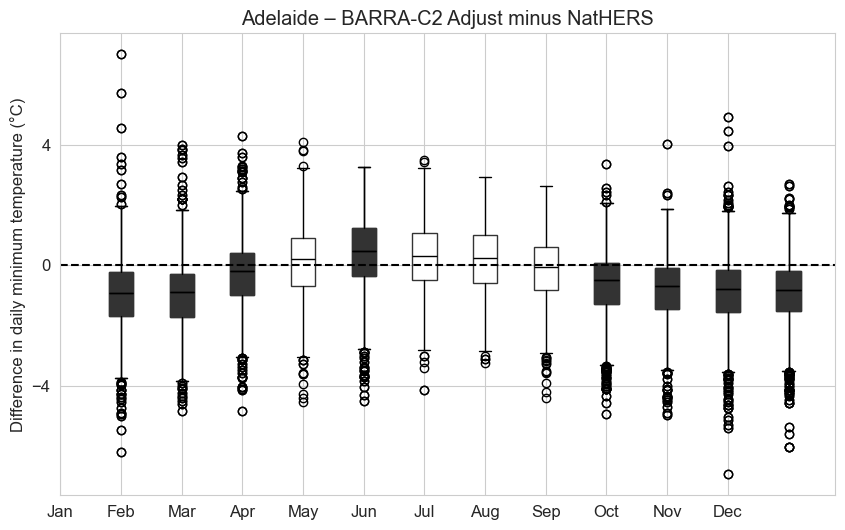


Adelaide — DAILY MEAN TEMPERATURE
Adelaide     | mean     | Jan | KS: stat= 0.080, p= 0.014 (SIG) | MW: stat=324500.5, p= 0.008 (SIG)
Adelaide     | mean     | Feb | KS: stat= 0.089, p= 0.007 (SIG) | MW: stat=268513.0, p= 0.012 (SIG)
Adelaide     | mean     | Mar | KS: stat= 0.052, p= 0.253 (ns) | MW: stat=304784.5, p= 0.612 (ns)
Adelaide     | mean     | Apr | KS: stat= 0.043, p= 0.502 (ns) | MW: stat=276347.5, p= 0.559 (ns)
Adelaide     | mean     | May | KS: stat= 0.034, p= 0.776 (ns) | MW: stat=290191.5, p= 0.251 (ns)
Adelaide     | mean     | Jun | KS: stat= 0.036, p= 0.716 (ns) | MW: stat=278068.5, p= 0.705 (ns)
Adelaide     | mean     | Jul | KS: stat= 0.050, p= 0.280 (ns) | MW: stat=302275.5, p= 0.824 (ns)
Adelaide     | mean     | Aug | KS: stat= 0.072, p= 0.035 (SIG) | MW: stat=318495.0, p= 0.039 (SIG)
Adelaide     | mean     | Sep | KS: stat= 0.120, p= 0.000 (SIG) | MW: stat=314577.0, p= 0.000 (SIG)
Adelaide     | mean     | Oct | KS: stat= 0.090, p= 0.004 (SIG) | MW: stat=

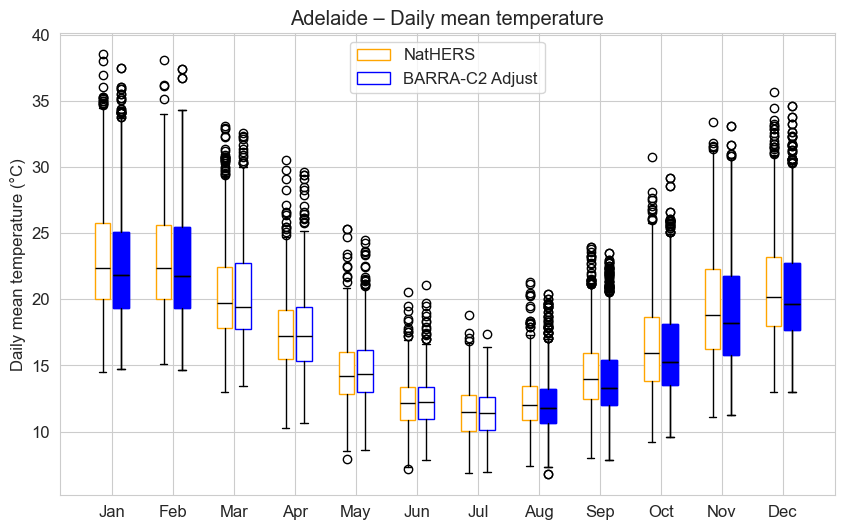

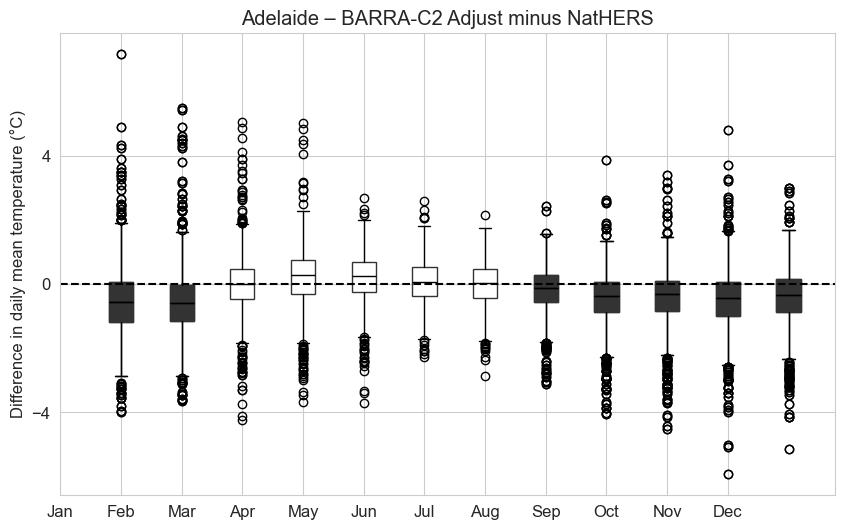


Perth — DAILY MAXIMUM TEMPERATURE
Perth        | maximum  | Jan | KS: stat= 0.095, p= 0.002 (SIG) | MW: stat=270329.0, p= 0.000 (SIG)
Perth        | maximum  | Feb | KS: stat= 0.103, p= 0.001 (SIG) | MW: stat=219218.0, p= 0.000 (SIG)
Perth        | maximum  | Mar | KS: stat= 0.130, p= 0.000 (SIG) | MW: stat=259314.0, p= 0.000 (SIG)
Perth        | maximum  | Apr | KS: stat= 0.099, p= 0.001 (SIG) | MW: stat=252379.5, p= 0.001 (SIG)
Perth        | maximum  | May | KS: stat= 0.105, p= 0.000 (SIG) | MW: stat=270532.5, p= 0.001 (SIG)
Perth        | maximum  | Jun | KS: stat= 0.115, p= 0.000 (SIG) | MW: stat=246134.0, p= 0.000 (SIG)
Perth        | maximum  | Jul | KS: stat= 0.138, p= 0.000 (SIG) | MW: stat=257518.0, p= 0.000 (SIG)
Perth        | maximum  | Aug | KS: stat= 0.173, p= 0.000 (SIG) | MW: stat=247744.0, p= 0.000 (SIG)
Perth        | maximum  | Sep | KS: stat= 0.163, p= 0.000 (SIG) | MW: stat=231883.0, p= 0.000 (SIG)
Perth        | maximum  | Oct | KS: stat= 0.111, p= 0.000 (SIG) |

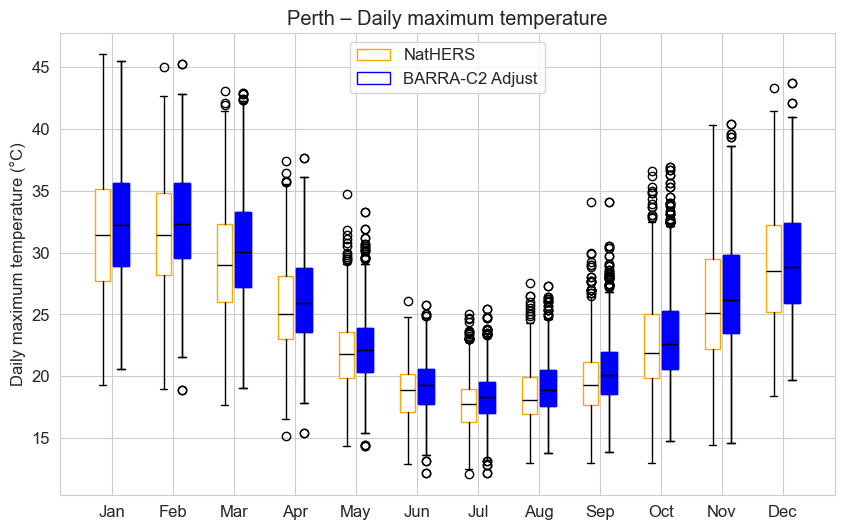

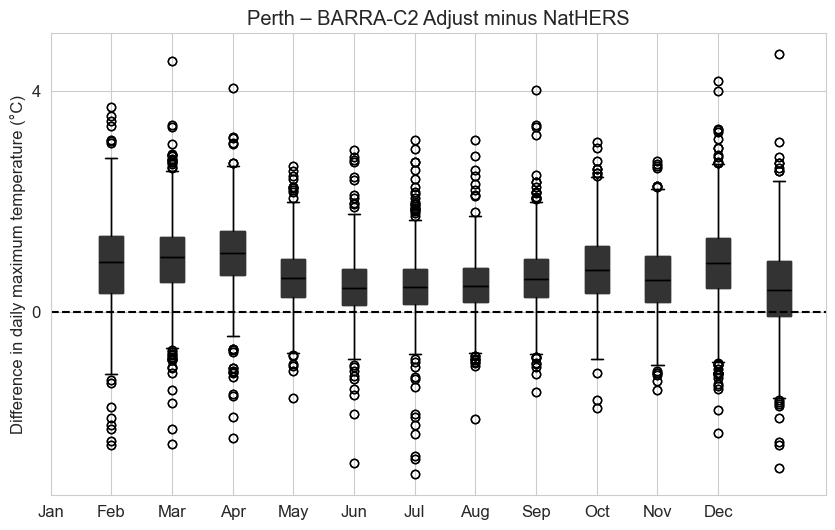


Perth — DAILY MINIMUM TEMPERATURE
Perth        | minimum  | Jan | KS: stat= 0.080, p= 0.014 (SIG) | MW: stat=318426.5, p= 0.050 (SIG)
Perth        | minimum  | Feb | KS: stat= 0.058, p= 0.185 (ns) | MW: stat=255228.0, p= 0.433 (ns)
Perth        | minimum  | Mar | KS: stat= 0.059, p= 0.130 (ns) | MW: stat=308722.0, p= 0.340 (ns)
Perth        | minimum  | Apr | KS: stat= 0.072, p= 0.041 (SIG) | MW: stat=277149.0, p= 0.625 (ns)
Perth        | minimum  | May | KS: stat= 0.070, p= 0.046 (SIG) | MW: stat=314449.5, p= 0.109 (ns)
Perth        | minimum  | Jun | KS: stat= 0.075, p= 0.031 (SIG) | MW: stat=298591.0, p= 0.039 (SIG)
Perth        | minimum  | Jul | KS: stat= 0.054, p= 0.205 (ns) | MW: stat=292759.5, p= 0.391 (ns)
Perth        | minimum  | Aug | KS: stat= 0.058, p= 0.147 (ns) | MW: stat=286784.0, p= 0.125 (ns)
Perth        | minimum  | Sep | KS: stat= 0.063, p= 0.105 (ns) | MW: stat=270462.0, p= 0.198 (ns)
Perth        | minimum  | Oct | KS: stat= 0.062, p= 0.102 (ns) | MW: stat=300

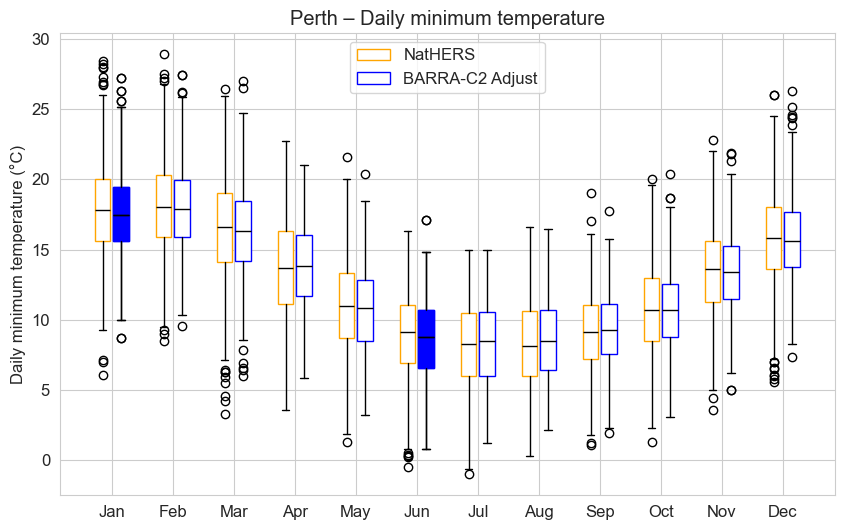

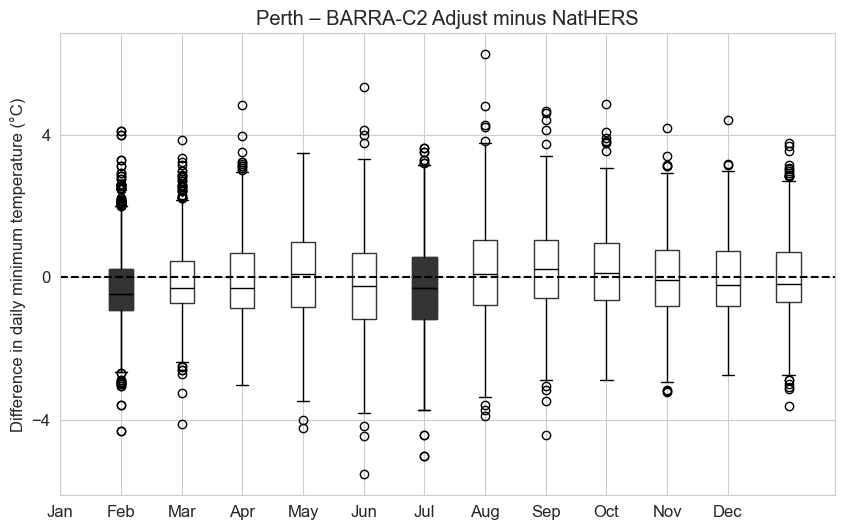


Perth — DAILY MEAN TEMPERATURE
Perth        | mean     | Jan | KS: stat= 0.068, p= 0.054 (SIG) | MW: stat=287045.5, p= 0.112 (ns)
Perth        | mean     | Feb | KS: stat= 0.076, p= 0.032 (SIG) | MW: stat=231982.0, p= 0.024 (SIG)
Perth        | mean     | Mar | KS: stat= 0.077, p= 0.019 (SIG) | MW: stat=277028.5, p= 0.008 (SIG)
Perth        | mean     | Apr | KS: stat= 0.092, p= 0.003 (SIG) | MW: stat=259929.0, p= 0.011 (SIG)
Perth        | mean     | May | KS: stat= 0.045, p= 0.408 (ns) | MW: stat=291278.5, p= 0.305 (ns)
Perth        | mean     | Jun | KS: stat= 0.045, p= 0.424 (ns) | MW: stat=274353.5, p= 0.411 (ns)
Perth        | mean     | Jul | KS: stat= 0.083, p= 0.010 (SIG) | MW: stat=274529.0, p= 0.003 (SIG)
Perth        | mean     | Aug | KS: stat= 0.115, p= 0.000 (SIG) | MW: stat=261447.0, p= 0.000 (SIG)
Perth        | mean     | Sep | KS: stat= 0.124, p= 0.000 (SIG) | MW: stat=242202.0, p= 0.000 (SIG)
Perth        | mean     | Oct | KS: stat= 0.102, p= 0.001 (SIG) | MW: sta

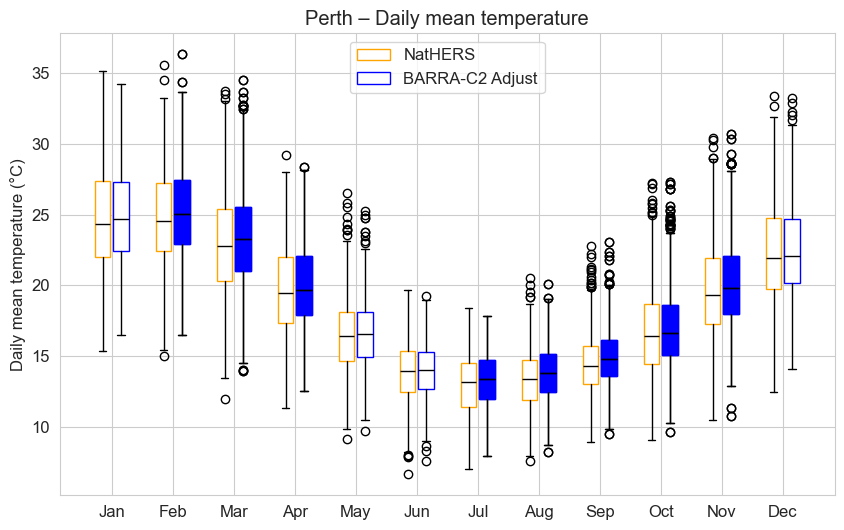

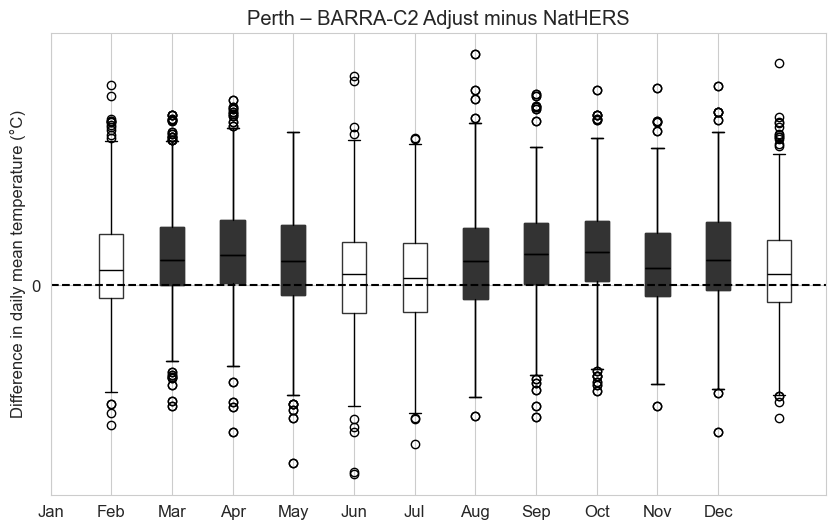


Sydney — DAILY MAXIMUM TEMPERATURE
Sydney       | maximum  | Jan | KS: stat= 0.084, p= 0.009 (SIG) | MW: stat=278219.0, p= 0.010 (SIG)
Sydney       | maximum  | Feb | KS: stat= 0.064, p= 0.114 (ns) | MW: stat=235226.5, p= 0.068 (SIG)
Sydney       | maximum  | Mar | KS: stat= 0.090, p= 0.004 (SIG) | MW: stat=274210.0, p= 0.003 (SIG)
Sydney       | maximum  | Apr | KS: stat= 0.136, p= 0.000 (SIG) | MW: stat=246405.0, p= 0.000 (SIG)
Sydney       | maximum  | May | KS: stat= 0.139, p= 0.000 (SIG) | MW: stat=256088.5, p= 0.000 (SIG)
Sydney       | maximum  | Jun | KS: stat= 0.132, p= 0.000 (SIG) | MW: stat=253005.0, p= 0.001 (SIG)
Sydney       | maximum  | Jul | KS: stat= 0.150, p= 0.000 (SIG) | MW: stat=257517.0, p= 0.000 (SIG)
Sydney       | maximum  | Aug | KS: stat= 0.134, p= 0.000 (SIG) | MW: stat=264647.0, p= 0.000 (SIG)
Sydney       | maximum  | Sep | KS: stat= 0.095, p= 0.002 (SIG) | MW: stat=256479.0, p= 0.003 (SIG)
Sydney       | maximum  | Oct | KS: stat= 0.085, p= 0.007 (SIG) |

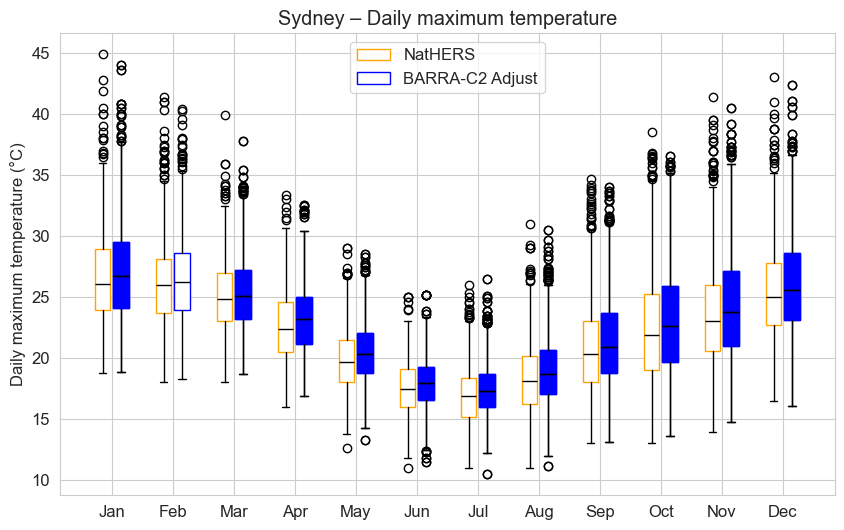

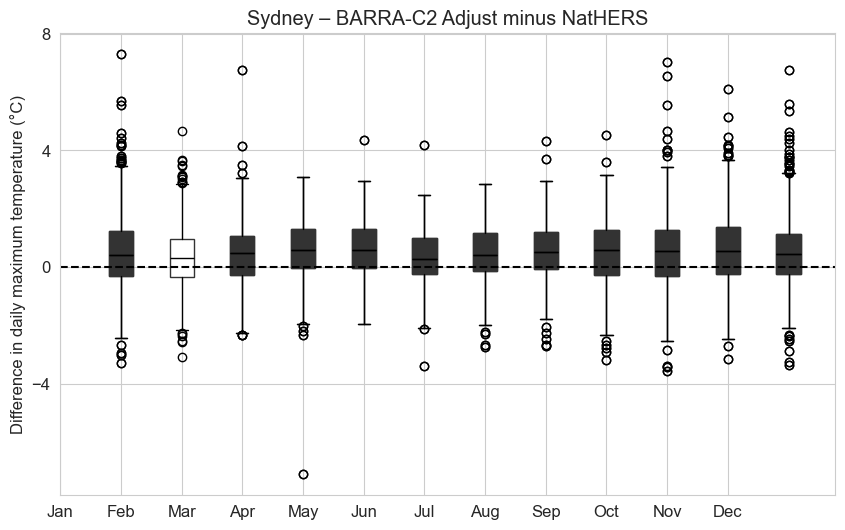


Sydney — DAILY MINIMUM TEMPERATURE
Sydney       | minimum  | Jan | KS: stat= 0.295, p= 0.000 (SIG) | MW: stat=405422.0, p= 0.000 (SIG)
Sydney       | minimum  | Feb | KS: stat= 0.285, p= 0.000 (SIG) | MW: stat=331989.0, p= 0.000 (SIG)
Sydney       | minimum  | Mar | KS: stat= 0.275, p= 0.000 (SIG) | MW: stat=399561.5, p= 0.000 (SIG)
Sydney       | minimum  | Apr | KS: stat= 0.213, p= 0.000 (SIG) | MW: stat=353386.0, p= 0.000 (SIG)
Sydney       | minimum  | May | KS: stat= 0.174, p= 0.000 (SIG) | MW: stat=363864.0, p= 0.000 (SIG)
Sydney       | minimum  | Jun | KS: stat= 0.181, p= 0.000 (SIG) | MW: stat=341889.0, p= 0.000 (SIG)
Sydney       | minimum  | Jul | KS: stat= 0.254, p= 0.000 (SIG) | MW: stat=382083.0, p= 0.000 (SIG)
Sydney       | minimum  | Aug | KS: stat= 0.230, p= 0.000 (SIG) | MW: stat=385107.5, p= 0.000 (SIG)
Sydney       | minimum  | Sep | KS: stat= 0.219, p= 0.000 (SIG) | MW: stat=359614.5, p= 0.000 (SIG)
Sydney       | minimum  | Oct | KS: stat= 0.222, p= 0.000 (SIG) 

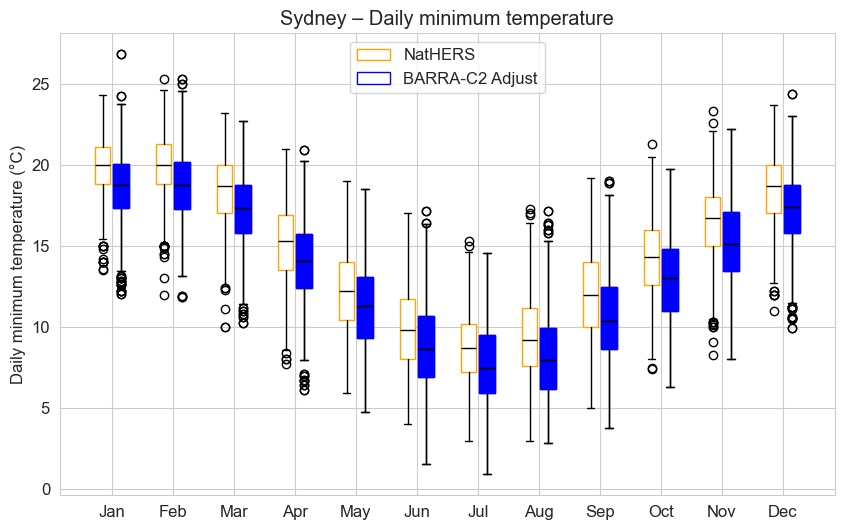

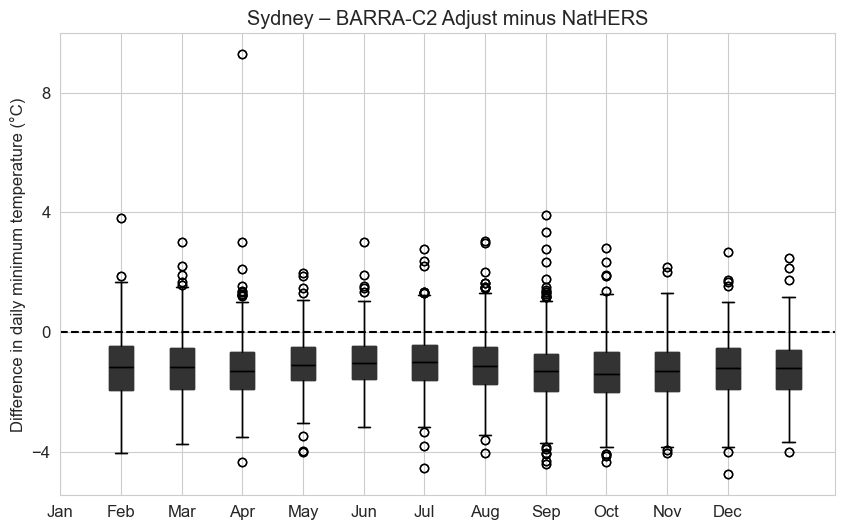


Sydney — DAILY MEAN TEMPERATURE
Sydney       | mean     | Jan | KS: stat= 0.079, p= 0.017 (SIG) | MW: stat=324507.0, p= 0.008 (SIG)
Sydney       | mean     | Feb | KS: stat= 0.098, p= 0.002 (SIG) | MW: stat=275329.0, p= 0.001 (SIG)
Sydney       | mean     | Mar | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=332823.0, p= 0.000 (SIG)
Sydney       | mean     | Apr | KS: stat= 0.080, p= 0.016 (SIG) | MW: stat=299401.0, p= 0.030 (SIG)
Sydney       | mean     | May | KS: stat= 0.070, p= 0.046 (SIG) | MW: stat=314739.0, p= 0.102 (ns)
Sydney       | mean     | Jun | KS: stat= 0.087, p= 0.007 (SIG) | MW: stat=307667.0, p= 0.002 (SIG)
Sydney       | mean     | Jul | KS: stat= 0.117, p= 0.000 (SIG) | MW: stat=329410.0, p= 0.001 (SIG)
Sydney       | mean     | Aug | KS: stat= 0.098, p= 0.001 (SIG) | MW: stat=327818.5, p= 0.002 (SIG)
Sydney       | mean     | Sep | KS: stat= 0.087, p= 0.007 (SIG) | MW: stat=304828.0, p= 0.005 (SIG)
Sydney       | mean     | Oct | KS: stat= 0.068, p= 0.053 (SIG) | MW

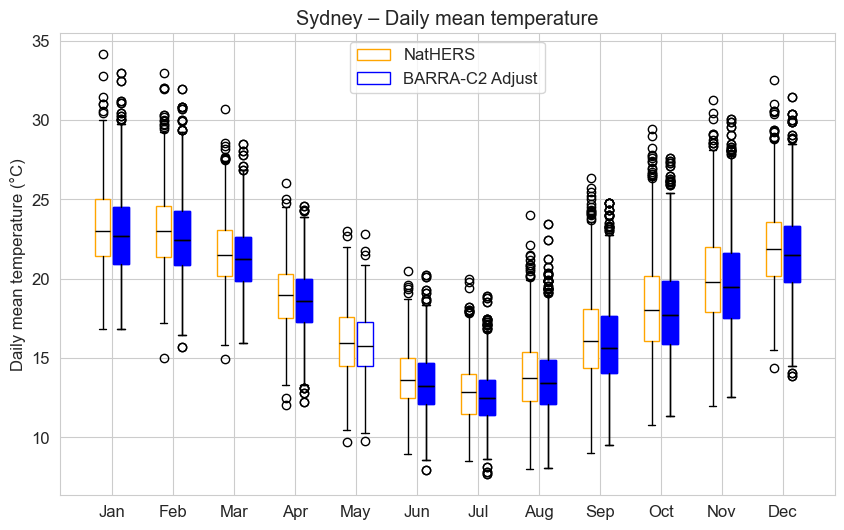

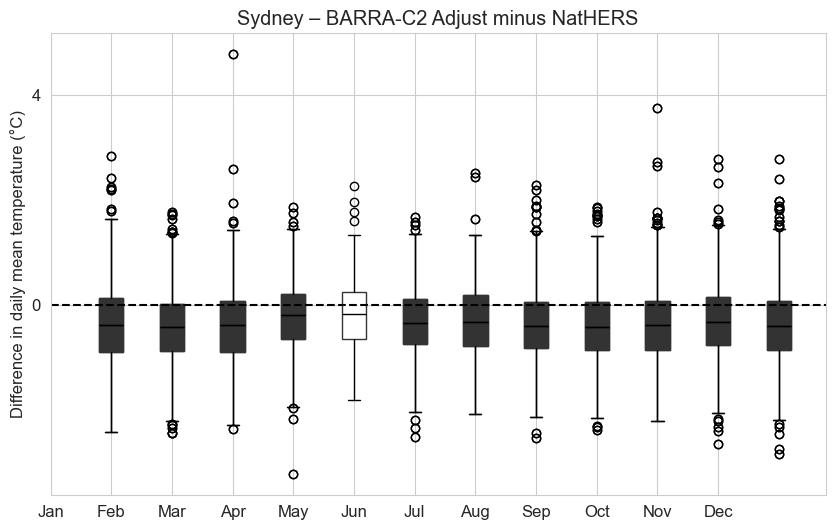


Canberra — DAILY MAXIMUM TEMPERATURE
Canberra     | maximum  | Jan | KS: stat= 0.091, p= 0.003 (SIG) | MW: stat=272004.5, p= 0.001 (SIG)
Canberra     | maximum  | Feb | KS: stat= 0.064, p= 0.114 (ns) | MW: stat=234535.0, p= 0.055 (SIG)
Canberra     | maximum  | Mar | KS: stat= 0.079, p= 0.016 (SIG) | MW: stat=279706.0, p= 0.019 (SIG)
Canberra     | maximum  | Apr | KS: stat= 0.080, p= 0.016 (SIG) | MW: stat=259693.5, p= 0.010 (SIG)
Canberra     | maximum  | May | KS: stat= 0.079, p= 0.016 (SIG) | MW: stat=279118.5, p= 0.016 (SIG)
Canberra     | maximum  | Jun | KS: stat= 0.092, p= 0.003 (SIG) | MW: stat=260838.0, p= 0.015 (SIG)
Canberra     | maximum  | Jul | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=276392.5, p= 0.007 (SIG)
Canberra     | maximum  | Aug | KS: stat= 0.108, p= 0.000 (SIG) | MW: stat=272886.0, p= 0.002 (SIG)
Canberra     | maximum  | Sep | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=247739.0, p= 0.000 (SIG)
Canberra     | maximum  | Oct | KS: stat= 0.089, p= 0.004 (SIG)

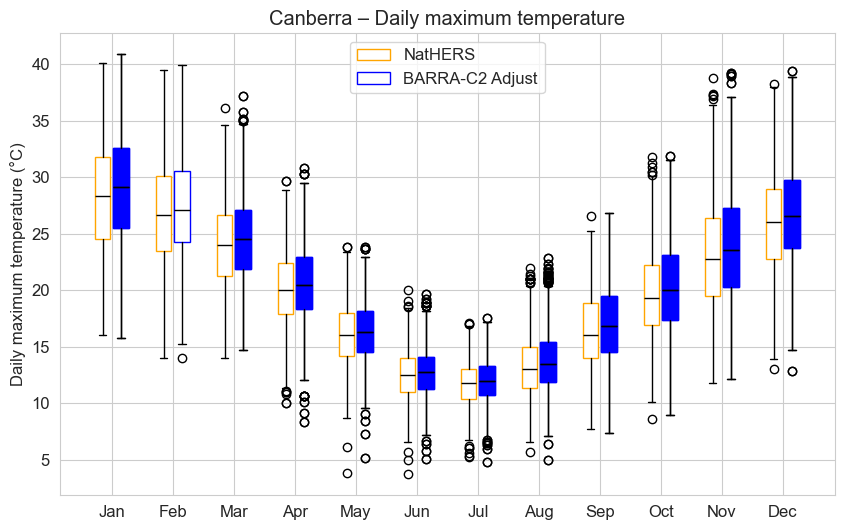

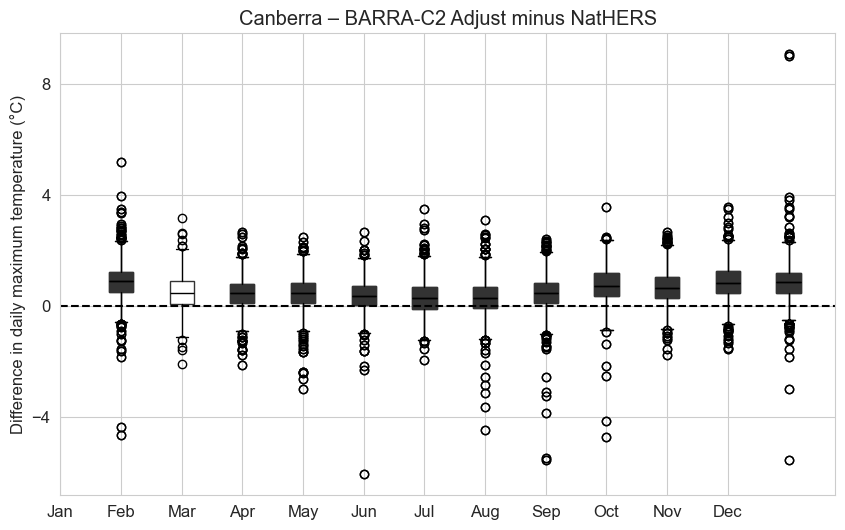


Canberra — DAILY MINIMUM TEMPERATURE
Canberra     | minimum  | Jan | KS: stat= 0.086, p= 0.006 (SIG) | MW: stat=322450.0, p= 0.016 (SIG)
Canberra     | minimum  | Feb | KS: stat= 0.065, p= 0.100 (SIG) | MW: stat=262560.0, p= 0.082 (SIG)
Canberra     | minimum  | Mar | KS: stat= 0.080, p= 0.014 (SIG) | MW: stat=321157.5, p= 0.018 (SIG)
Canberra     | minimum  | Apr | KS: stat= 0.083, p= 0.012 (SIG) | MW: stat=298862.5, p= 0.036 (SIG)
Canberra     | minimum  | May | KS: stat= 0.063, p= 0.090 (SIG) | MW: stat=316984.5, p= 0.058 (SIG)
Canberra     | minimum  | Jun | KS: stat= 0.088, p= 0.006 (SIG) | MW: stat=298478.5, p= 0.040 (SIG)
Canberra     | minimum  | Jul | KS: stat= 0.123, p= 0.000 (SIG) | MW: stat=329392.0, p= 0.001 (SIG)
Canberra     | minimum  | Aug | KS: stat= 0.128, p= 0.000 (SIG) | MW: stat=324789.0, p= 0.005 (SIG)
Canberra     | minimum  | Sep | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=307152.0, p= 0.002 (SIG)
Canberra     | minimum  | Oct | KS: stat= 0.092, p= 0.003 (SIG

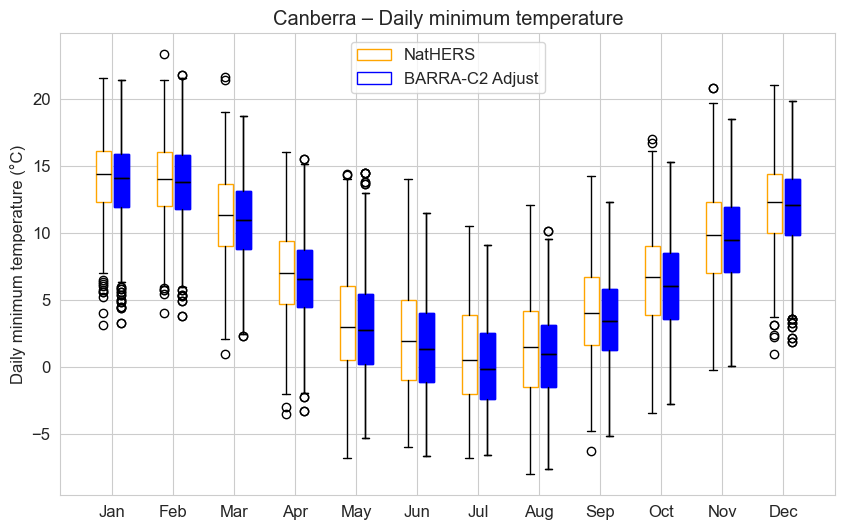

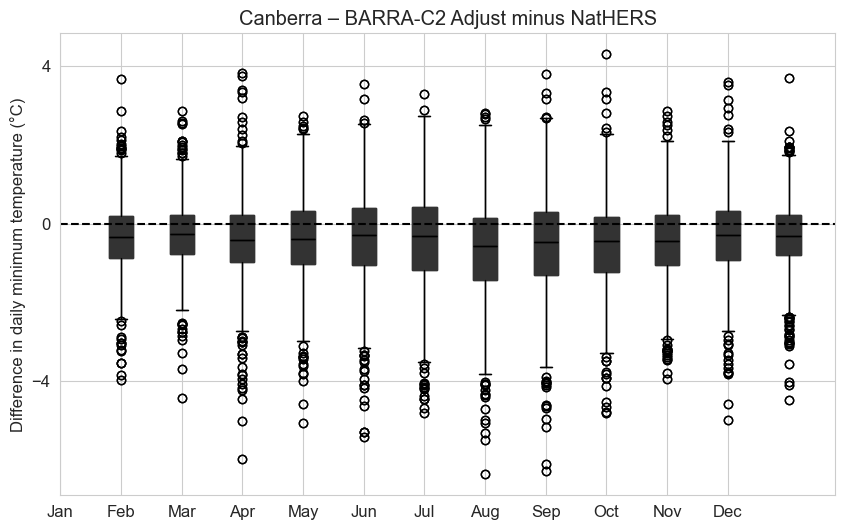


Canberra — DAILY MEAN TEMPERATURE
Canberra     | mean     | Jan | KS: stat= 0.059, p= 0.131 (ns) | MW: stat=287426.0, p= 0.122 (ns)
Canberra     | mean     | Feb | KS: stat= 0.042, p= 0.547 (ns) | MW: stat=244380.0, p= 0.528 (ns)
Canberra     | mean     | Mar | KS: stat= 0.026, p= 0.959 (ns) | MW: stat=298954.5, p= 0.878 (ns)
Canberra     | mean     | Apr | KS: stat= 0.039, p= 0.630 (ns) | MW: stat=278816.5, p= 0.772 (ns)
Canberra     | mean     | May | KS: stat= 0.037, p= 0.650 (ns) | MW: stat=301807.0, p= 0.865 (ns)
Canberra     | mean     | Jun | KS: stat= 0.045, p= 0.424 (ns) | MW: stat=284539.5, p= 0.695 (ns)
Canberra     | mean     | Jul | KS: stat= 0.063, p= 0.090 (SIG) | MW: stat=314226.5, p= 0.114 (ns)
Canberra     | mean     | Aug | KS: stat= 0.046, p= 0.373 (ns) | MW: stat=303230.5, p= 0.741 (ns)
Canberra     | mean     | Sep | KS: stat= 0.035, p= 0.759 (ns) | MW: stat=276545.0, p= 0.575 (ns)
Canberra     | mean     | Oct | KS: stat= 0.028, p= 0.914 (ns) | MW: stat=294857.0

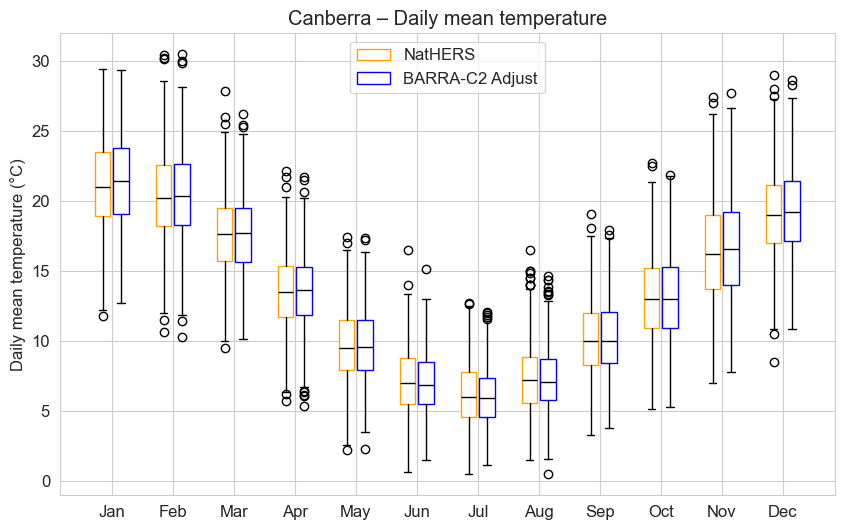

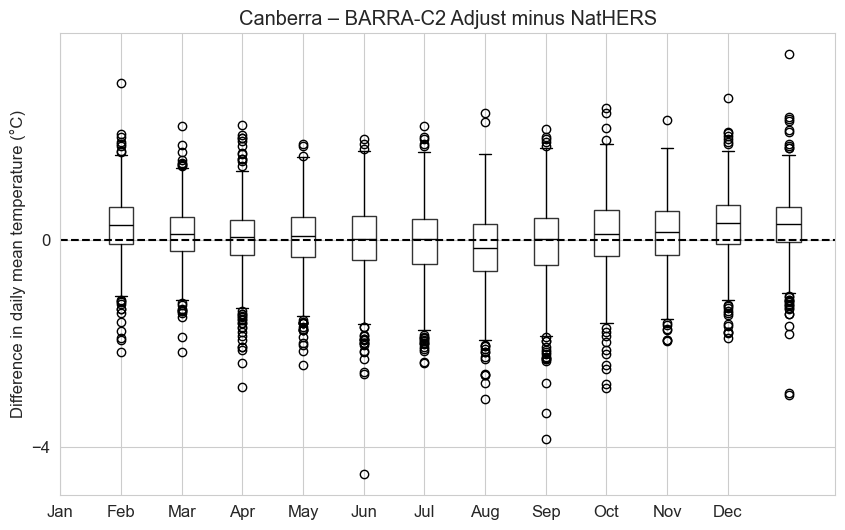


Hobart — DAILY MAXIMUM TEMPERATURE
Hobart       | maximum  | Jan | KS: stat= 0.045, p= 0.409 (ns) | MW: stat=295568.0, p= 0.532 (ns)
Hobart       | maximum  | Feb | KS: stat= 0.068, p= 0.076 (SIG) | MW: stat=239302.0, p= 0.196 (ns)
Hobart       | maximum  | Mar | KS: stat= 0.063, p= 0.090 (SIG) | MW: stat=298623.5, p= 0.848 (ns)
Hobart       | maximum  | Apr | KS: stat= 0.055, p= 0.212 (ns) | MW: stat=287503.0, p= 0.456 (ns)
Hobart       | maximum  | May | KS: stat= 0.068, p= 0.053 (SIG) | MW: stat=324239.0, p= 0.007 (SIG)
Hobart       | maximum  | Jun | KS: stat= 0.081, p= 0.014 (SIG) | MW: stat=308355.5, p= 0.001 (SIG)
Hobart       | maximum  | Jul | KS: stat= 0.092, p= 0.003 (SIG) | MW: stat=330053.5, p= 0.001 (SIG)
Hobart       | maximum  | Aug | KS: stat= 0.062, p= 0.102 (ns) | MW: stat=320245.0, p= 0.024 (SIG)
Hobart       | maximum  | Sep | KS: stat= 0.068, p= 0.062 (SIG) | MW: stat=300501.0, p= 0.022 (SIG)
Hobart       | maximum  | Oct | KS: stat= 0.071, p= 0.040 (SIG) | MW: s

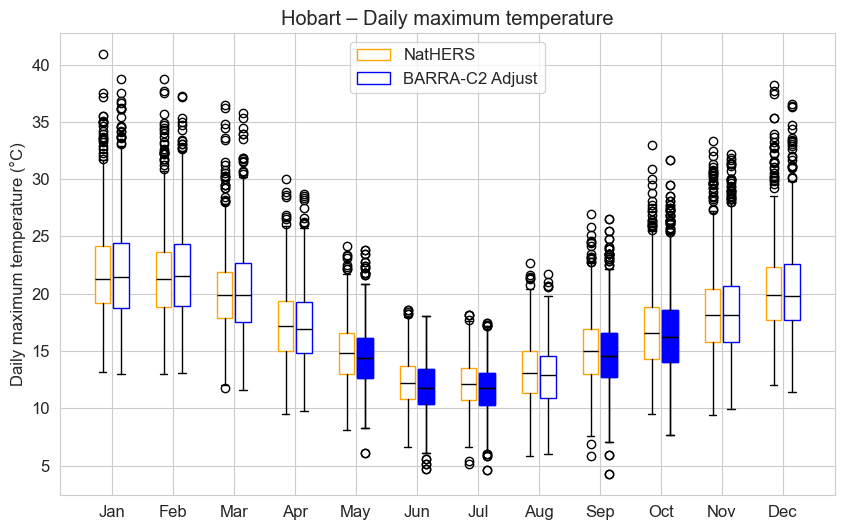

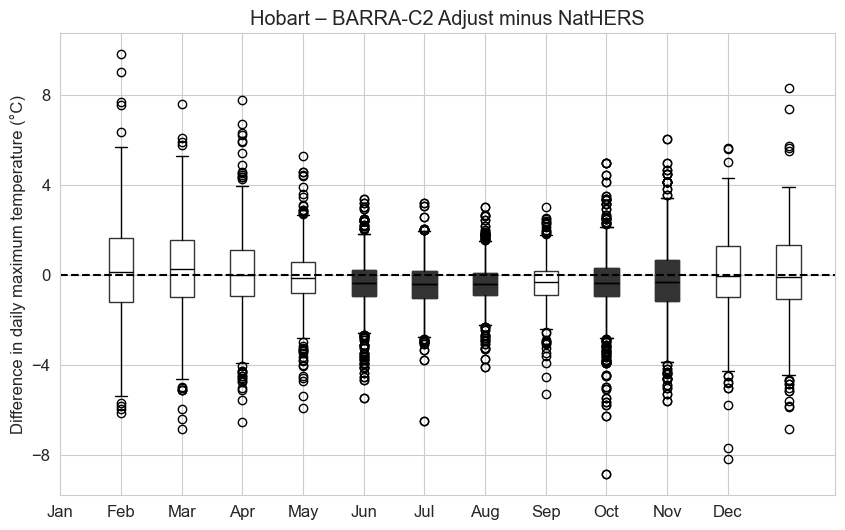


Hobart — DAILY MINIMUM TEMPERATURE
Hobart       | minimum  | Jan | KS: stat= 0.336, p= 0.000 (SIG) | MW: stat=429754.0, p= 0.000 (SIG)
Hobart       | minimum  | Feb | KS: stat= 0.350, p= 0.000 (SIG) | MW: stat=358287.0, p= 0.000 (SIG)
Hobart       | minimum  | Mar | KS: stat= 0.289, p= 0.000 (SIG) | MW: stat=406124.0, p= 0.000 (SIG)
Hobart       | minimum  | Apr | KS: stat= 0.213, p= 0.000 (SIG) | MW: stat=360772.5, p= 0.000 (SIG)
Hobart       | minimum  | May | KS: stat= 0.196, p= 0.000 (SIG) | MW: stat=374408.0, p= 0.000 (SIG)
Hobart       | minimum  | Jun | KS: stat= 0.192, p= 0.000 (SIG) | MW: stat=348807.0, p= 0.000 (SIG)
Hobart       | minimum  | Jul | KS: stat= 0.234, p= 0.000 (SIG) | MW: stat=388528.5, p= 0.000 (SIG)
Hobart       | minimum  | Aug | KS: stat= 0.241, p= 0.000 (SIG) | MW: stat=390626.0, p= 0.000 (SIG)
Hobart       | minimum  | Sep | KS: stat= 0.241, p= 0.000 (SIG) | MW: stat=369470.0, p= 0.000 (SIG)
Hobart       | minimum  | Oct | KS: stat= 0.253, p= 0.000 (SIG) 

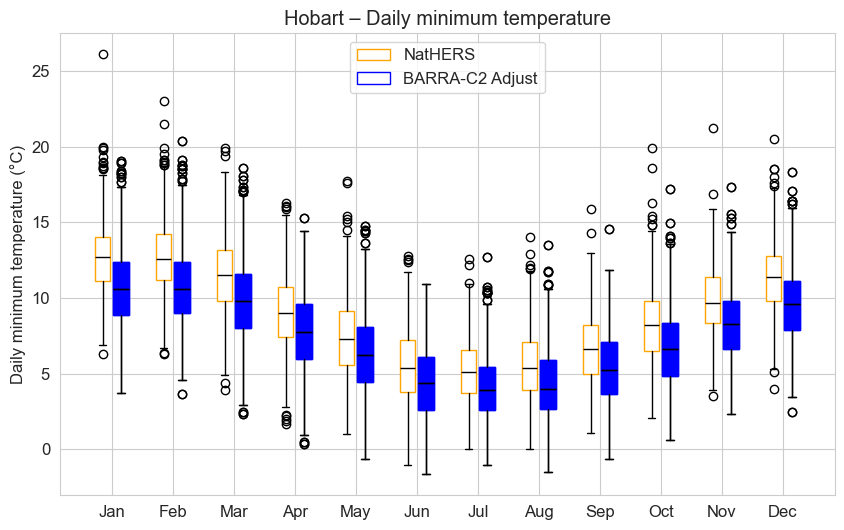

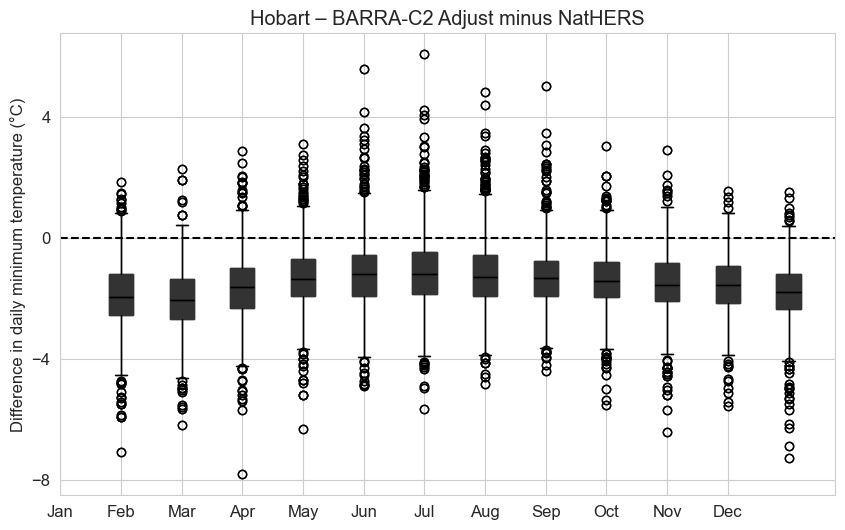


Hobart — DAILY MEAN TEMPERATURE
Hobart       | mean     | Jan | KS: stat= 0.166, p= 0.000 (SIG) | MW: stat=355023.5, p= 0.000 (SIG)
Hobart       | mean     | Feb | KS: stat= 0.152, p= 0.000 (SIG) | MW: stat=293744.0, p= 0.000 (SIG)
Hobart       | mean     | Mar | KS: stat= 0.142, p= 0.000 (SIG) | MW: stat=350009.5, p= 0.000 (SIG)
Hobart       | mean     | Apr | KS: stat= 0.141, p= 0.000 (SIG) | MW: stat=325556.0, p= 0.000 (SIG)
Hobart       | mean     | May | KS: stat= 0.146, p= 0.000 (SIG) | MW: stat=354389.0, p= 0.000 (SIG)
Hobart       | mean     | Jun | KS: stat= 0.155, p= 0.000 (SIG) | MW: stat=336676.5, p= 0.000 (SIG)
Hobart       | mean     | Jul | KS: stat= 0.177, p= 0.000 (SIG) | MW: stat=368313.5, p= 0.000 (SIG)
Hobart       | mean     | Aug | KS: stat= 0.147, p= 0.000 (SIG) | MW: stat=359960.0, p= 0.000 (SIG)
Hobart       | mean     | Sep | KS: stat= 0.149, p= 0.000 (SIG) | MW: stat=339174.0, p= 0.000 (SIG)
Hobart       | mean     | Oct | KS: stat= 0.152, p= 0.000 (SIG) | M

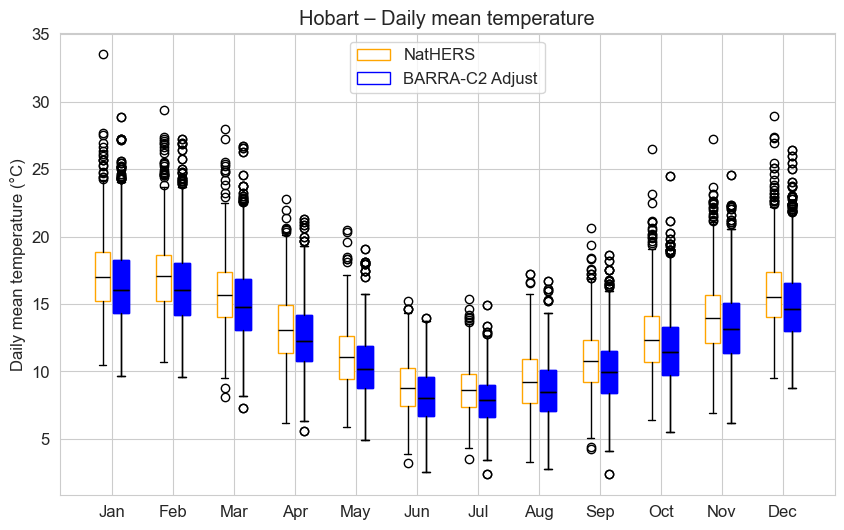

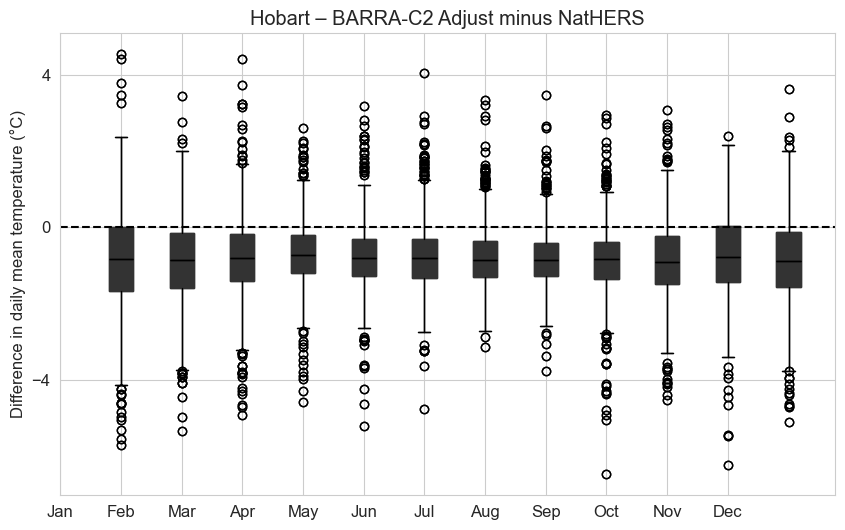

In [15]:
for l in da["loc"].values:
    display_location_header(l)
    data = convert_to_local_time(da,l)
    
    plot_monthly_daily_distribution_xr(
        data,
        loc=l,
        obs_source="NatHERS",
        model_source="BARRA-C2 Adjust",
        stat_type_list=("maximum", "minimum", "mean"),
    )


## Evaluation of BARRA-R2 Adjust

### Density distribution for each month and location

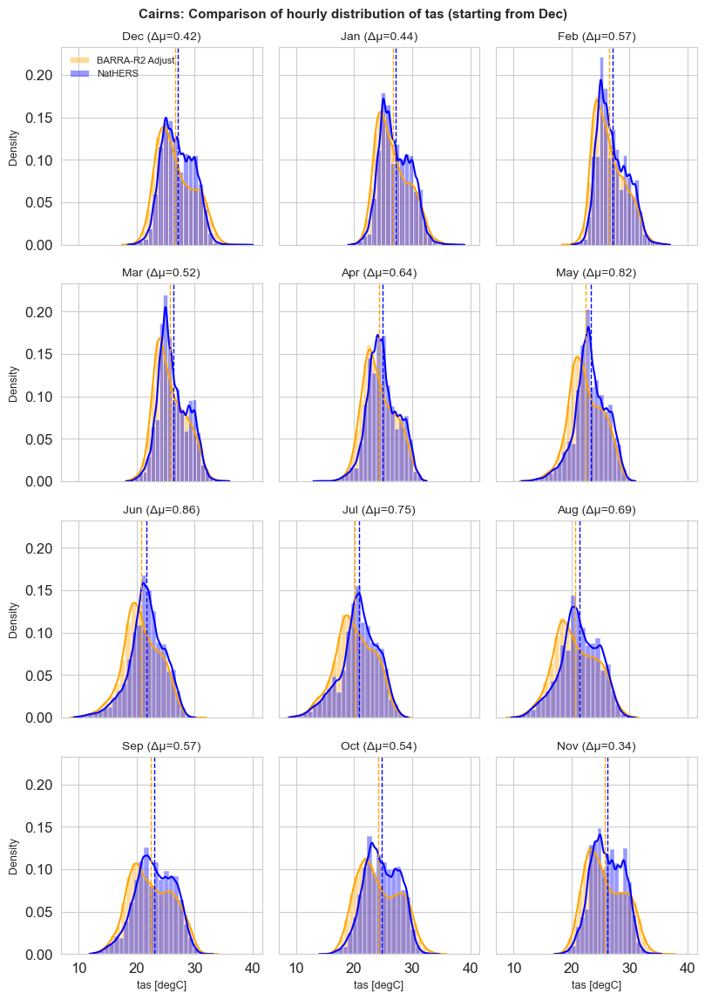

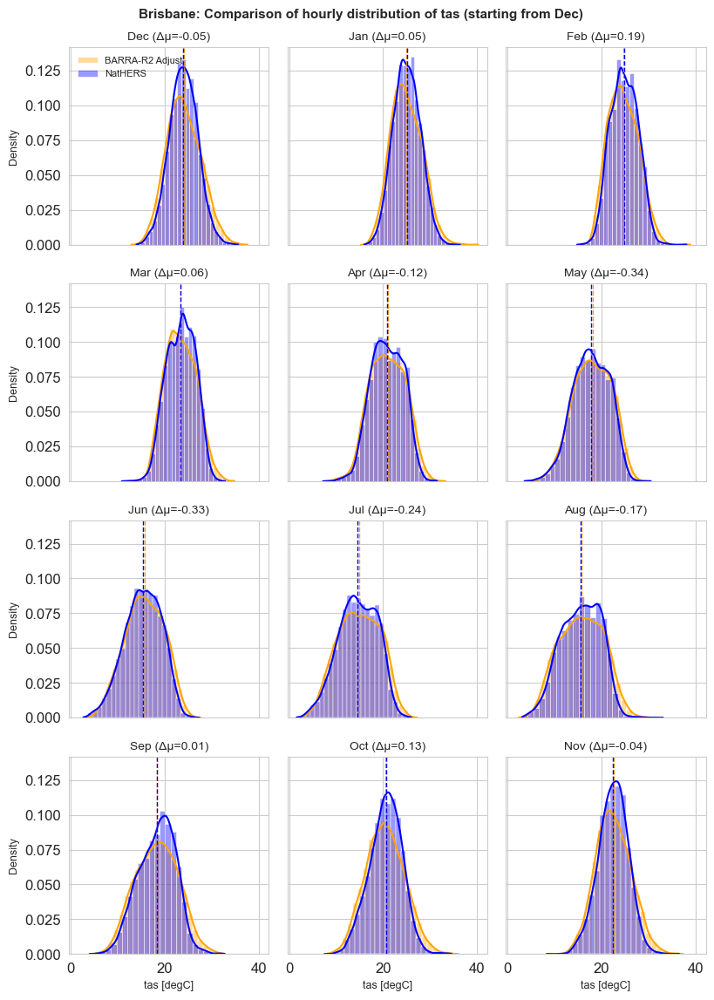

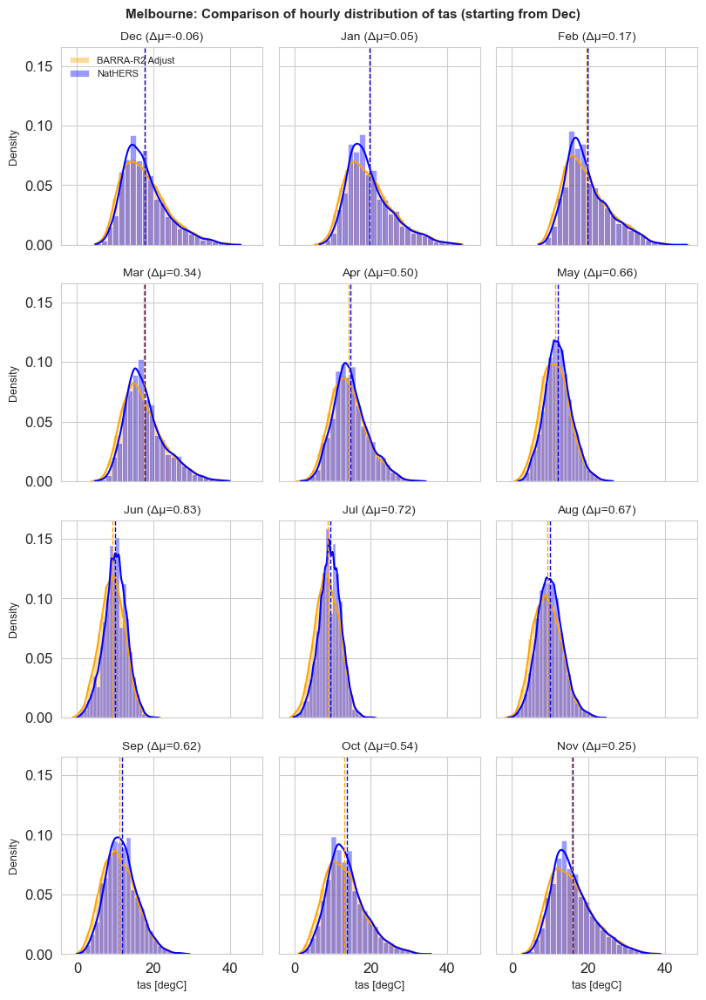

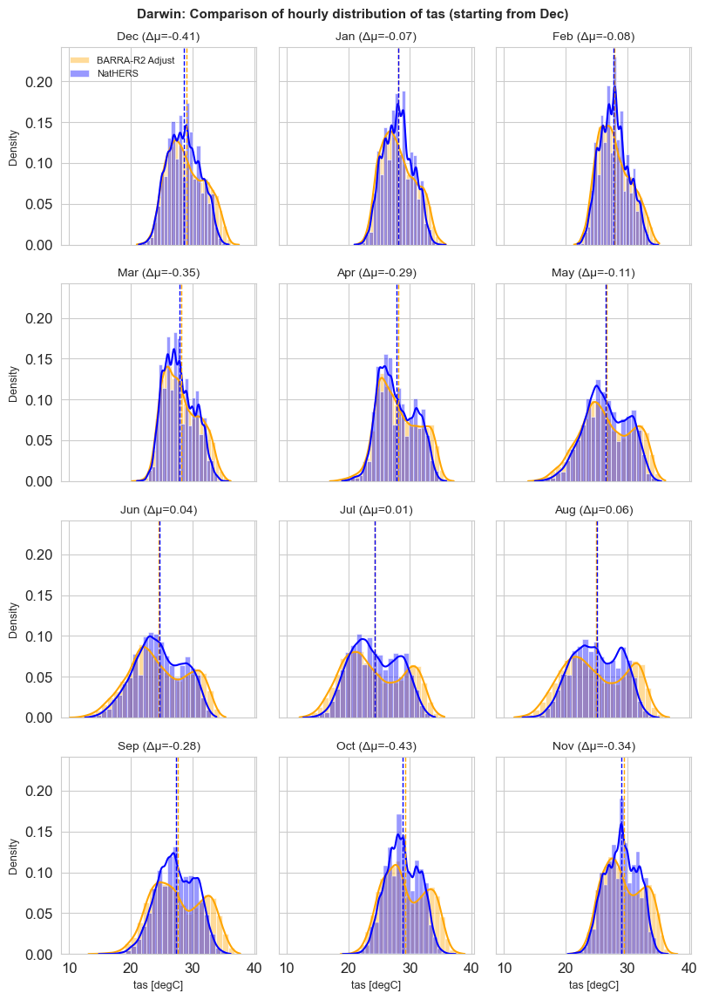

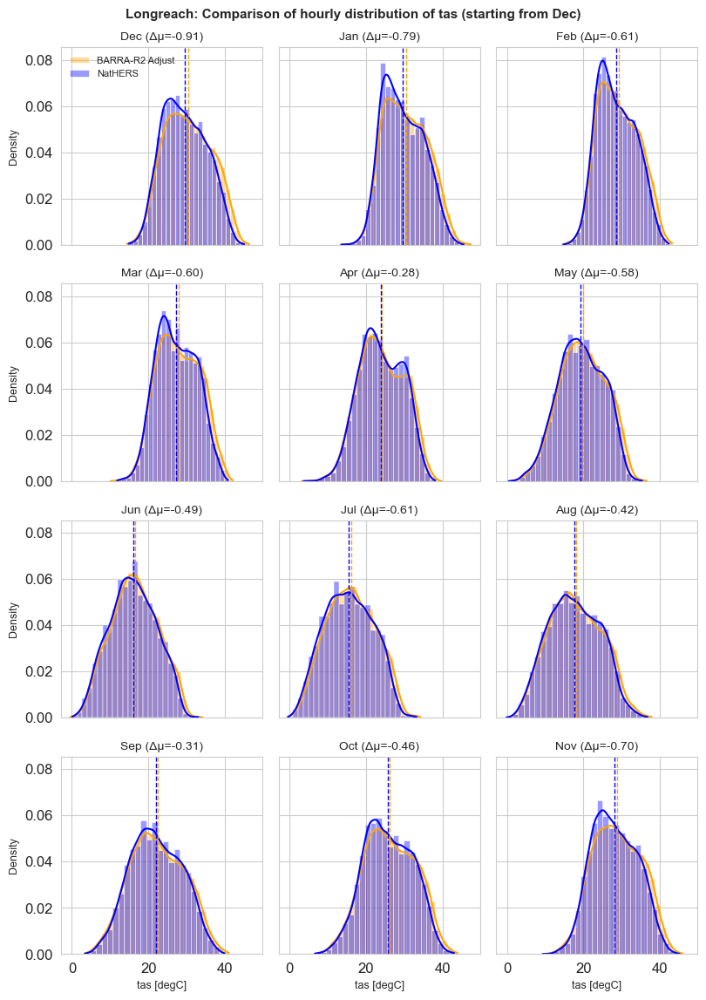

...

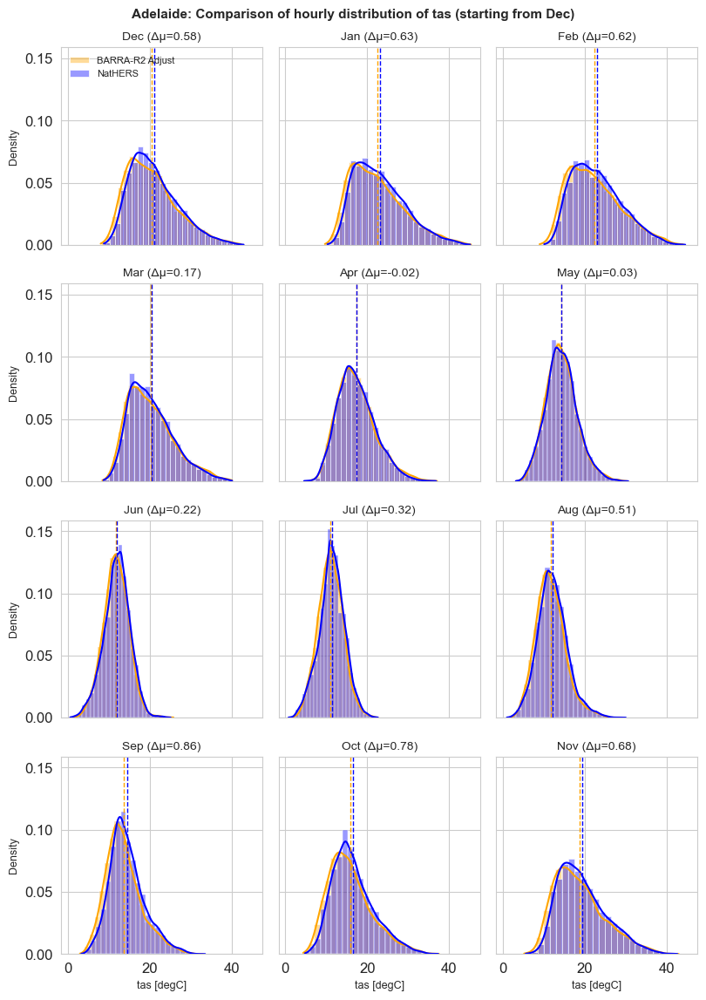

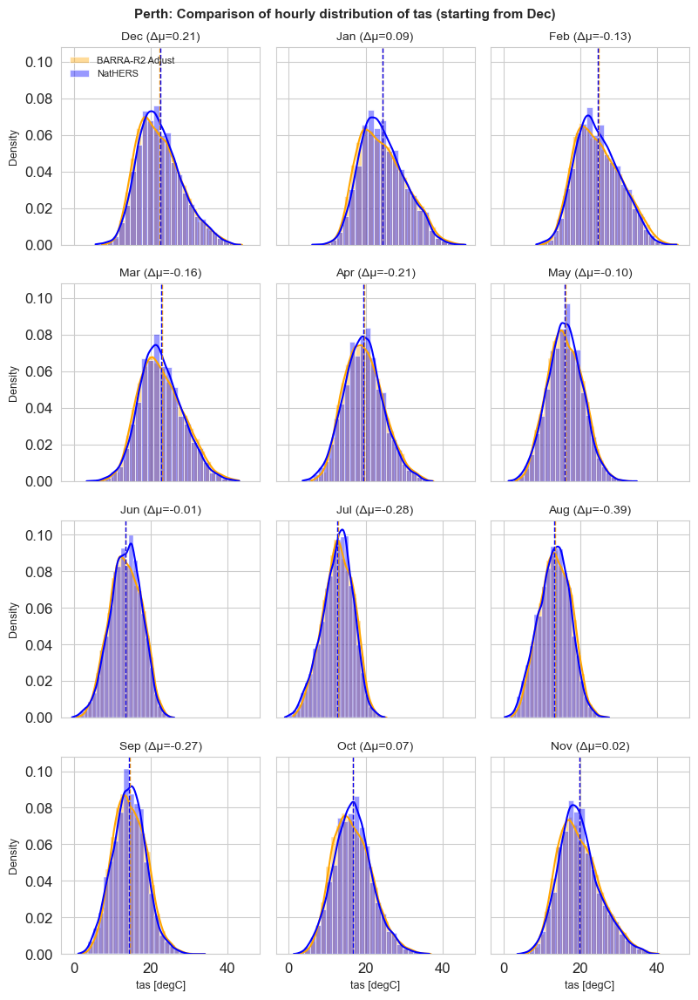

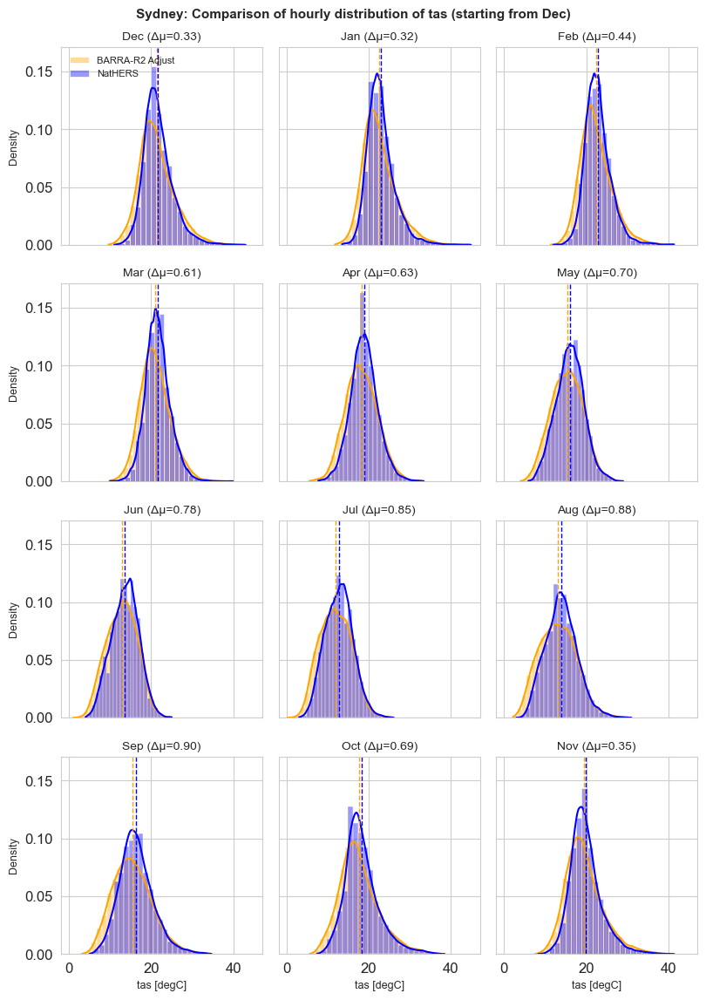

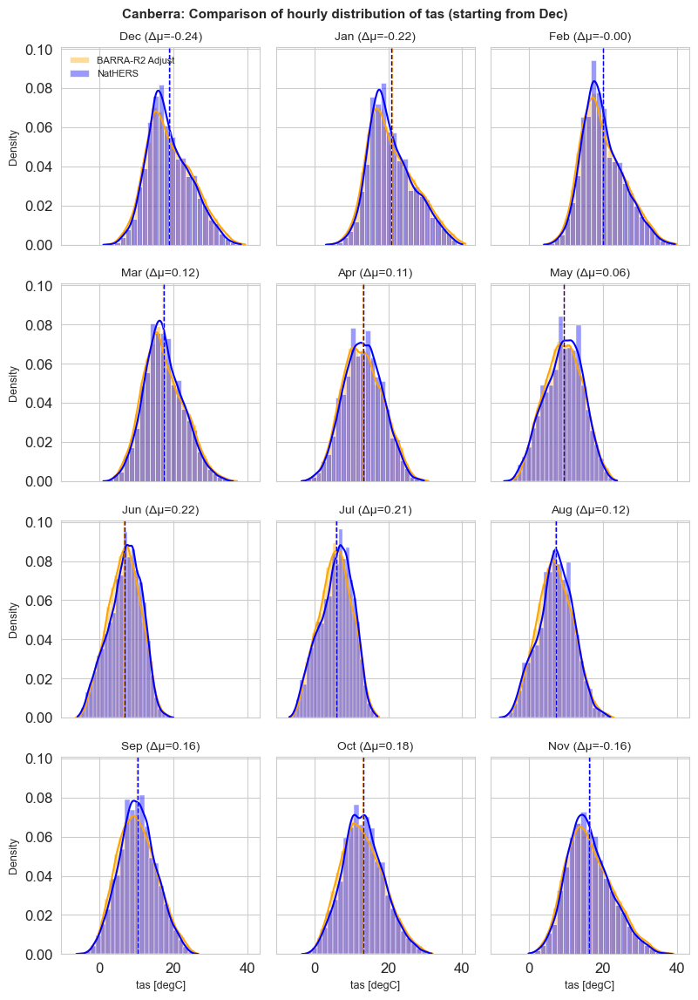

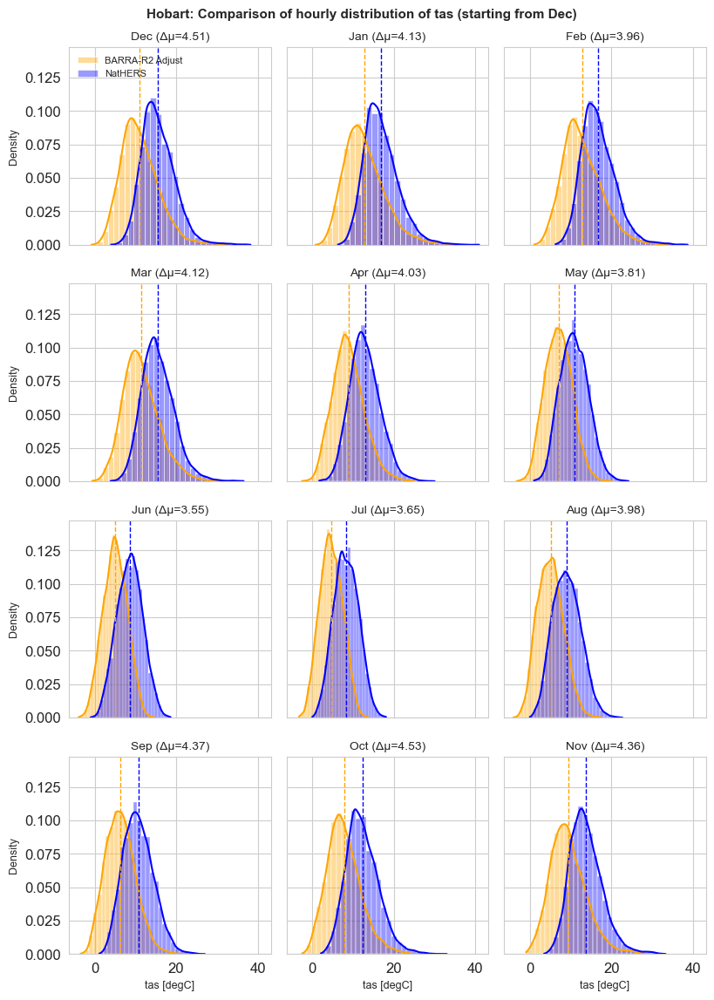

In [16]:
for l in da["loc"].values:
    data = convert_to_local_time(da,l)
    compare_monthly_histograms_xr(
        da=data,
        source1="BARRA-R2 Adjust",
        source2="NatHERS",
        location=l,
        label1="BARRA-R2 Adjust",
        label2="NatHERS",
        bins=25
    )


### Density distribution of hourly differences between BARRA-R2 and NatHERS

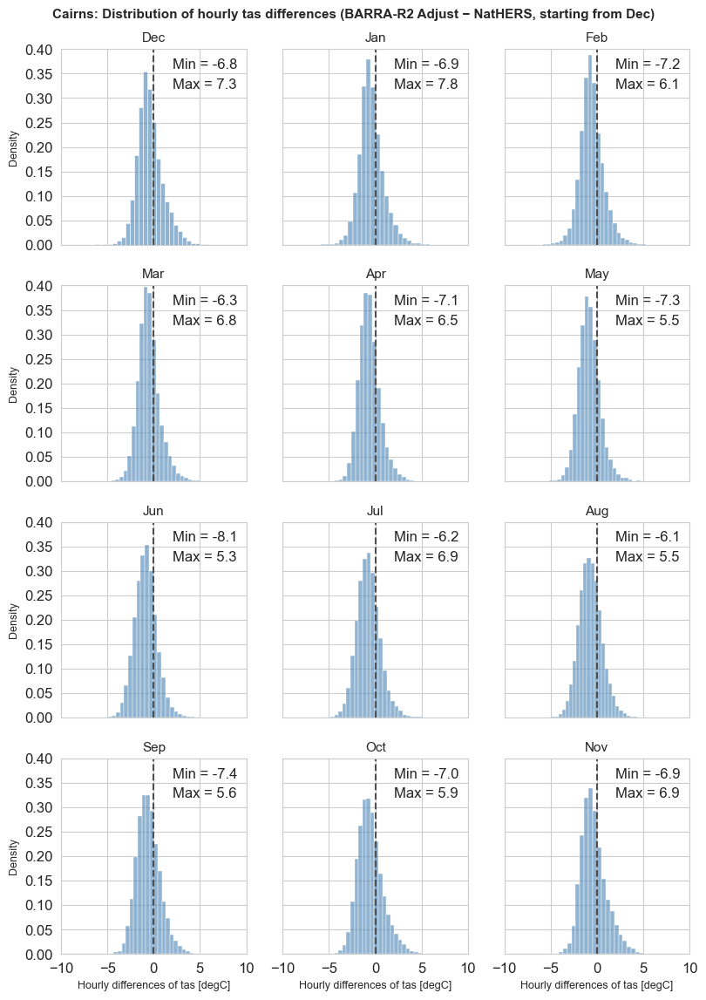

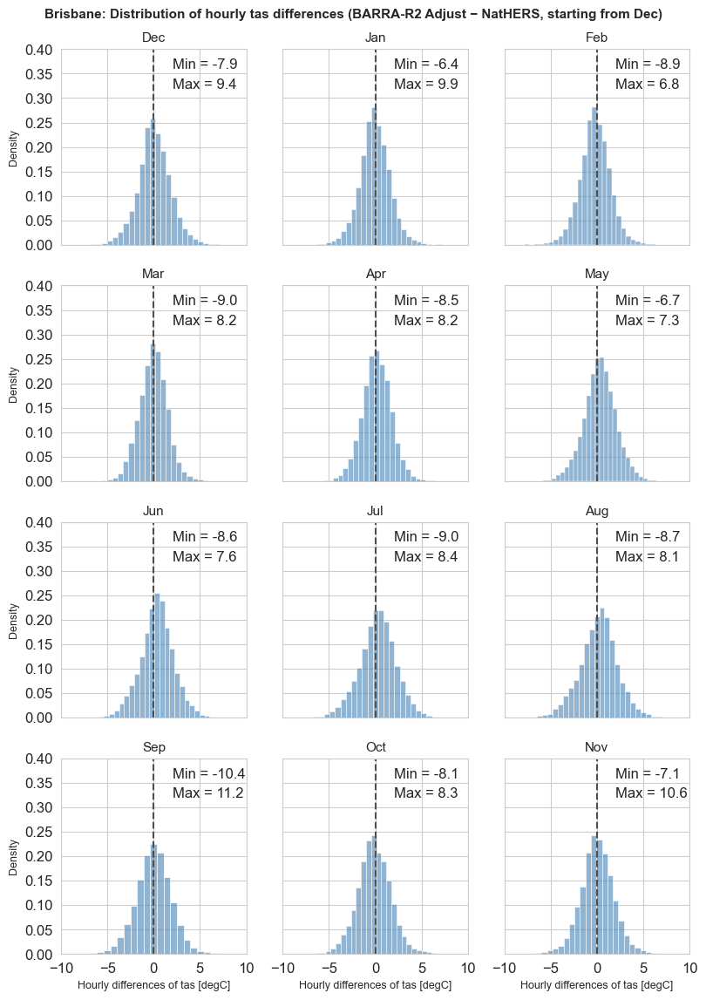

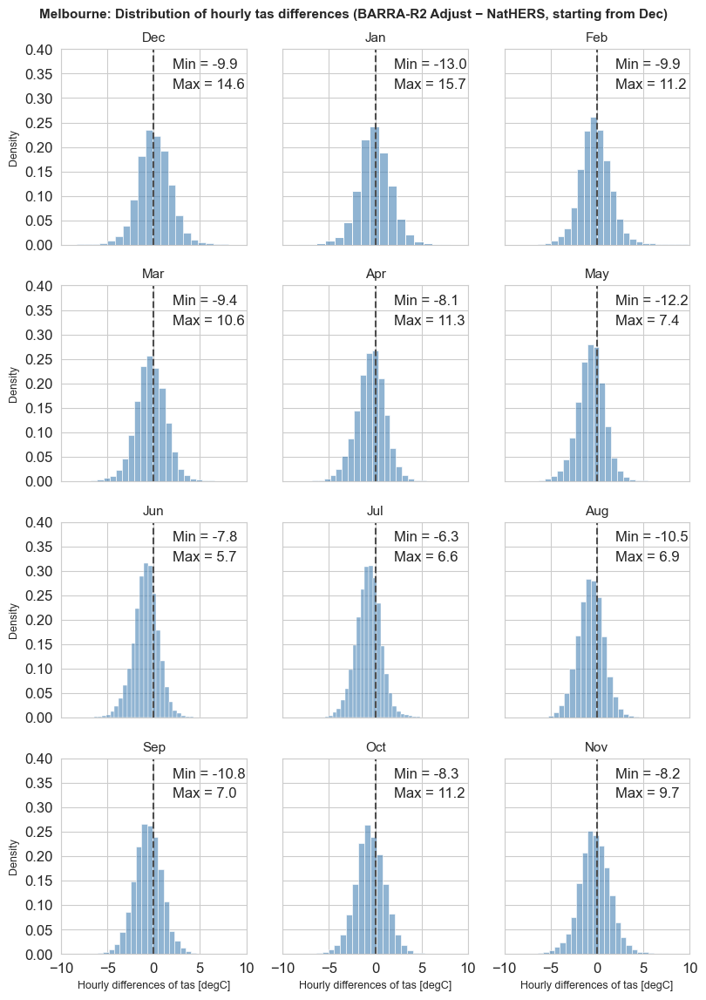

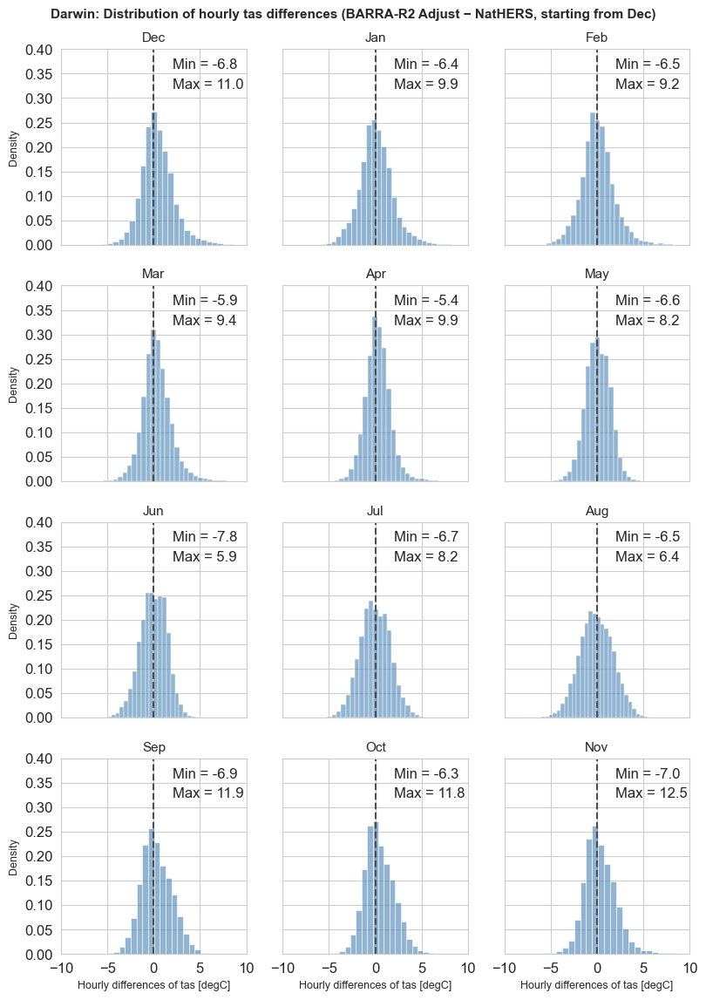

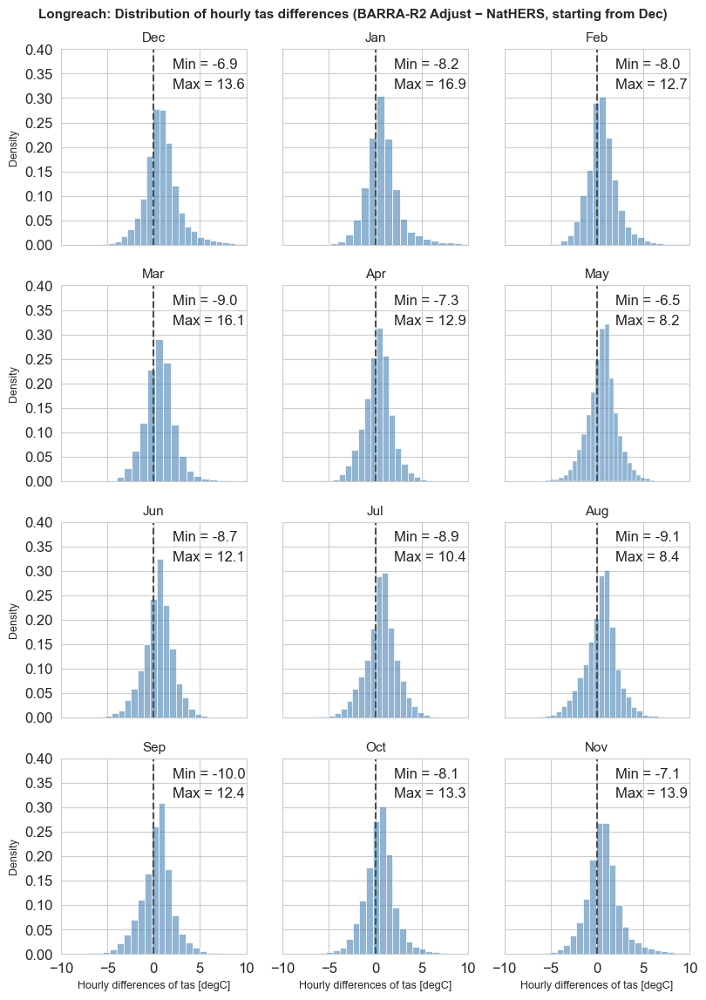

...

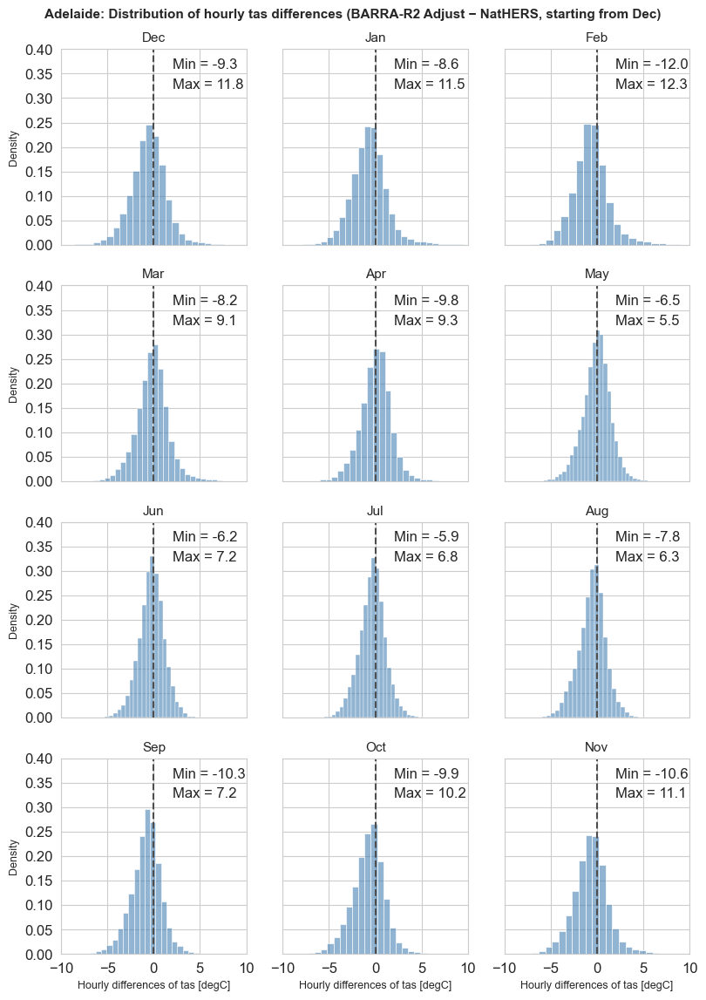

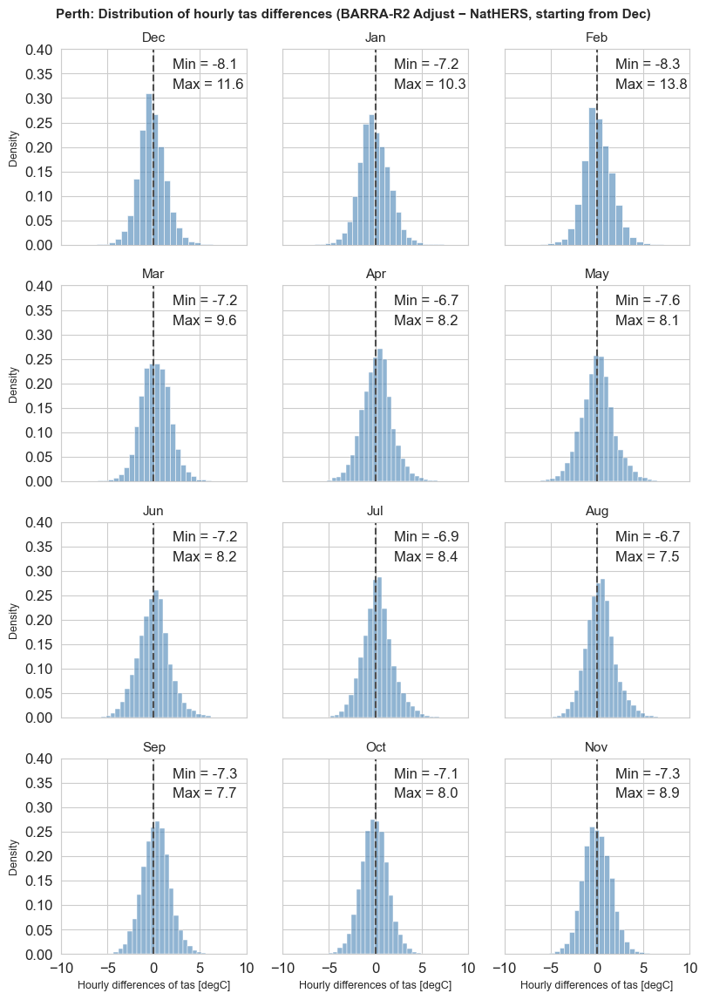

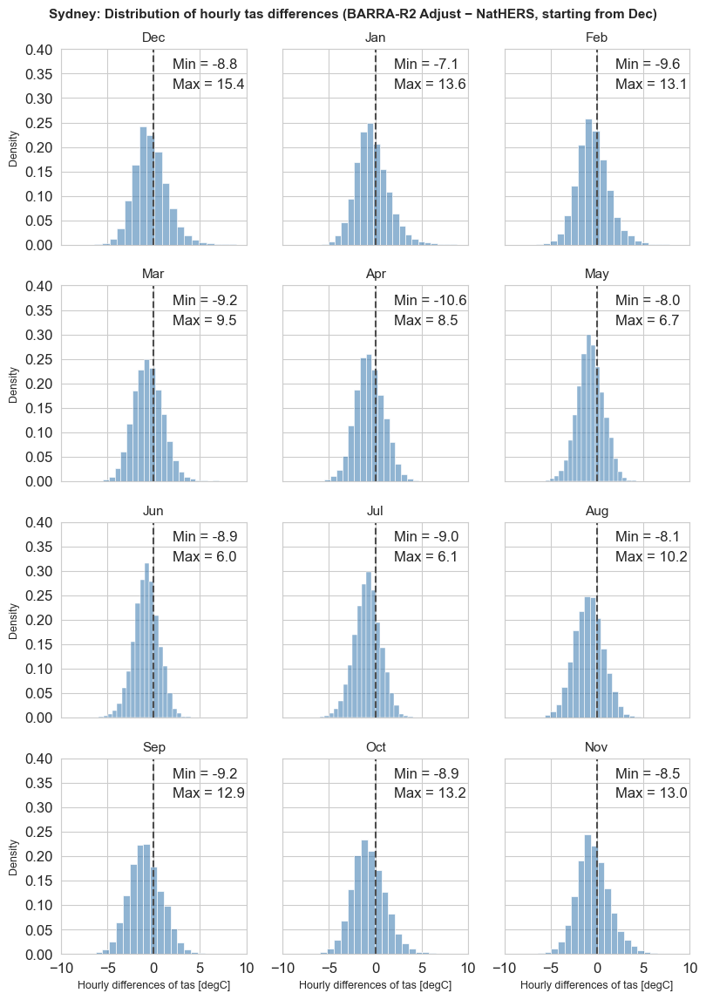

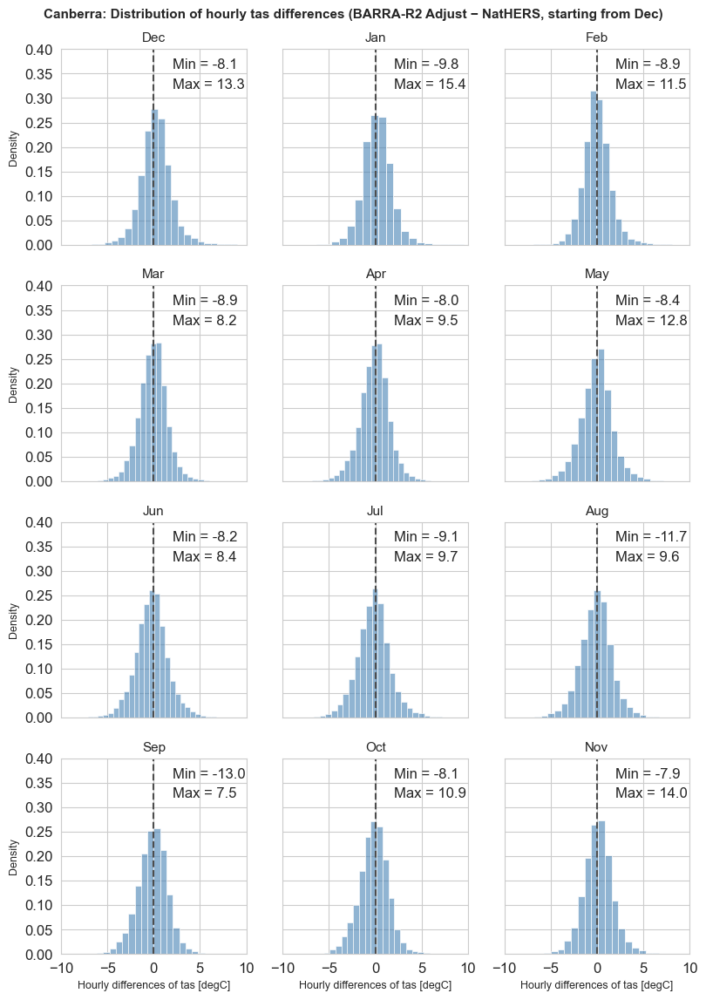

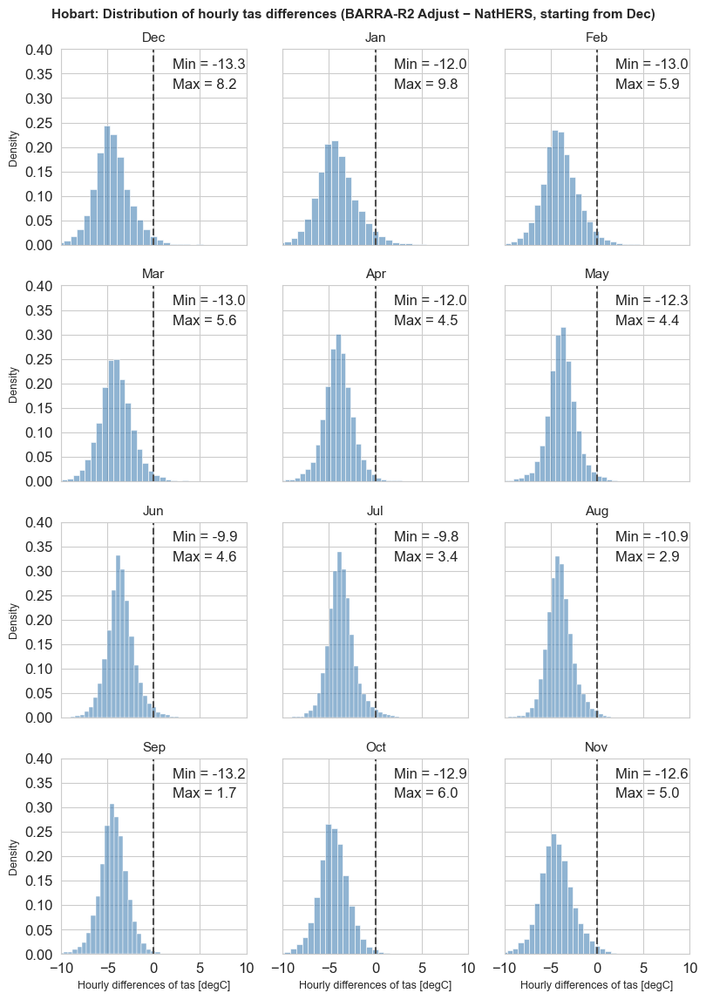

In [17]:
for l in da["loc"].values:
    data = convert_to_local_time(da,l)

    plot_monthly_difference_histograms_xr(
        da=da.sel(loc=l),
        obs_source="NatHERS",
        location=l,
        model_source="BARRA-R2 Adjust",
        xlim=(-10, 10),
        bins=30
    )

### Same as above overlaid with unadjusted/raw BARRA-R2 hourly difference

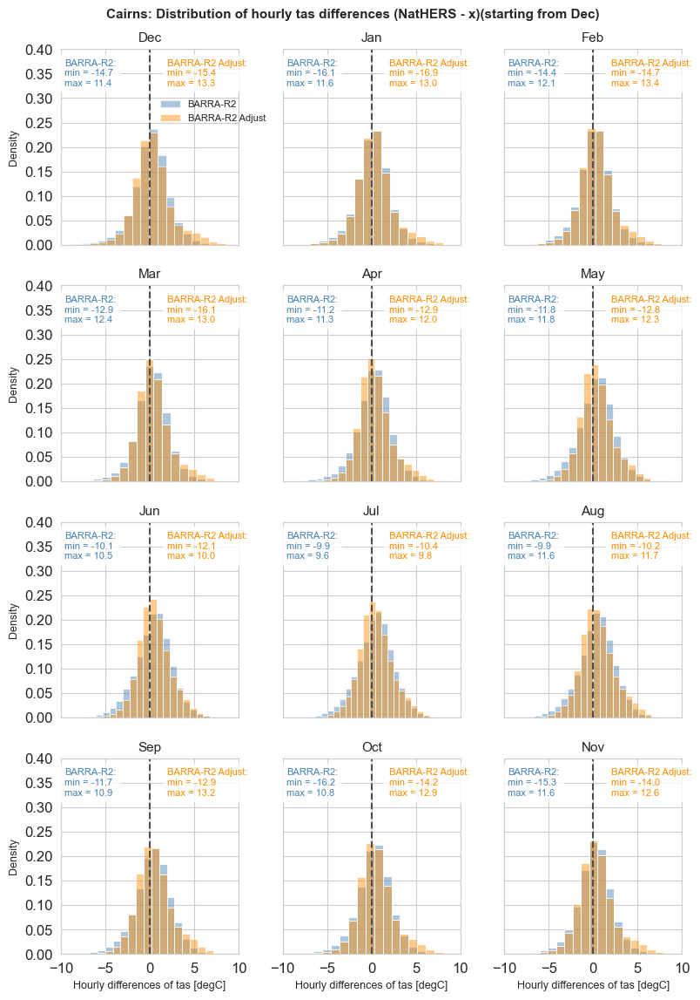

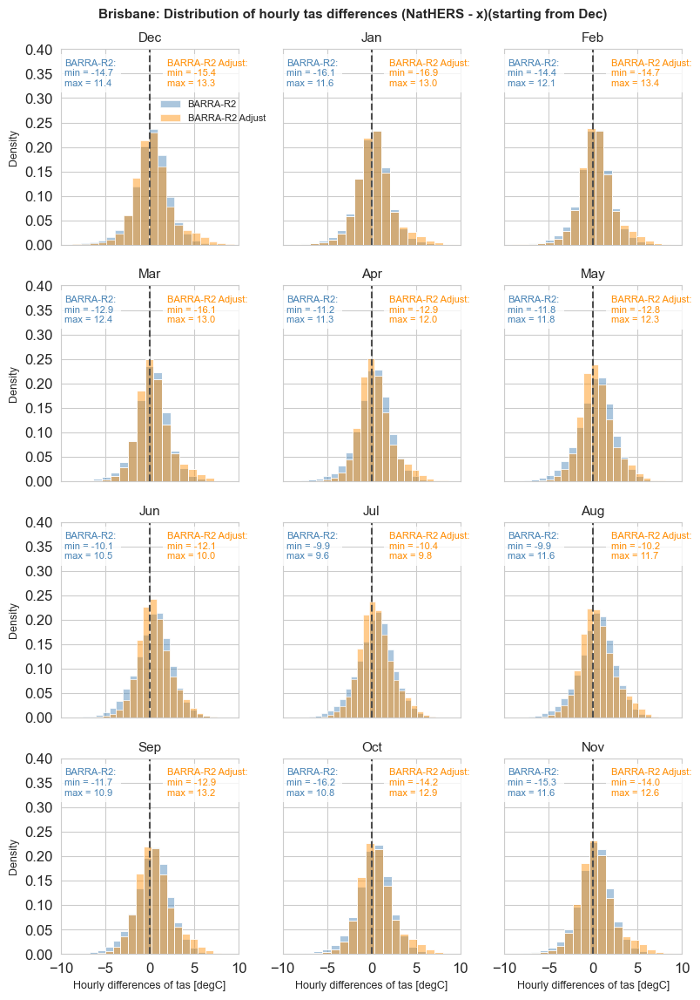

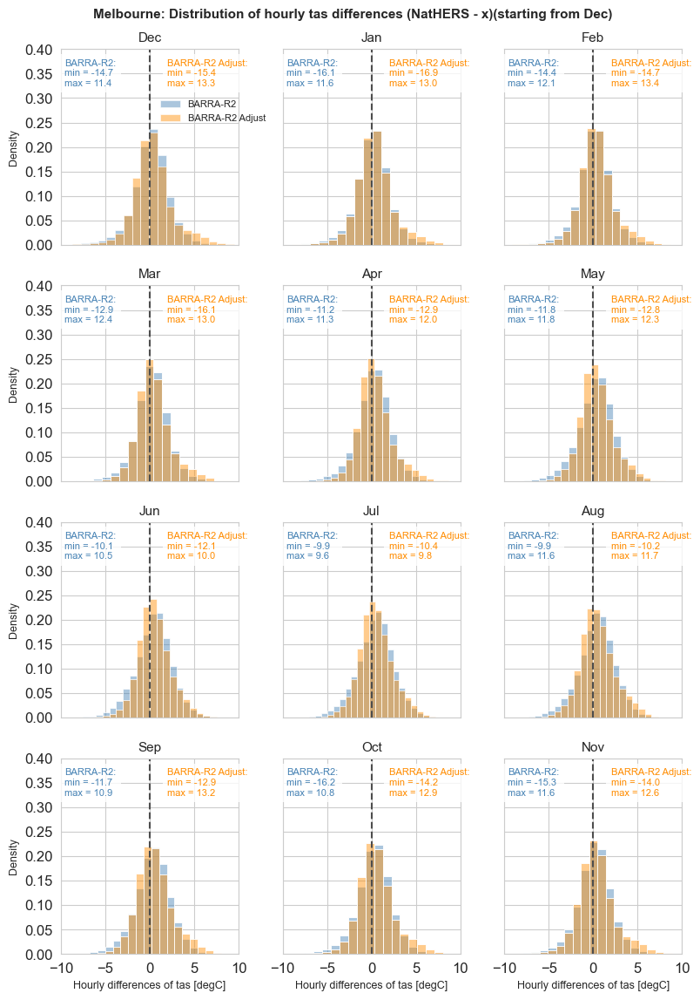

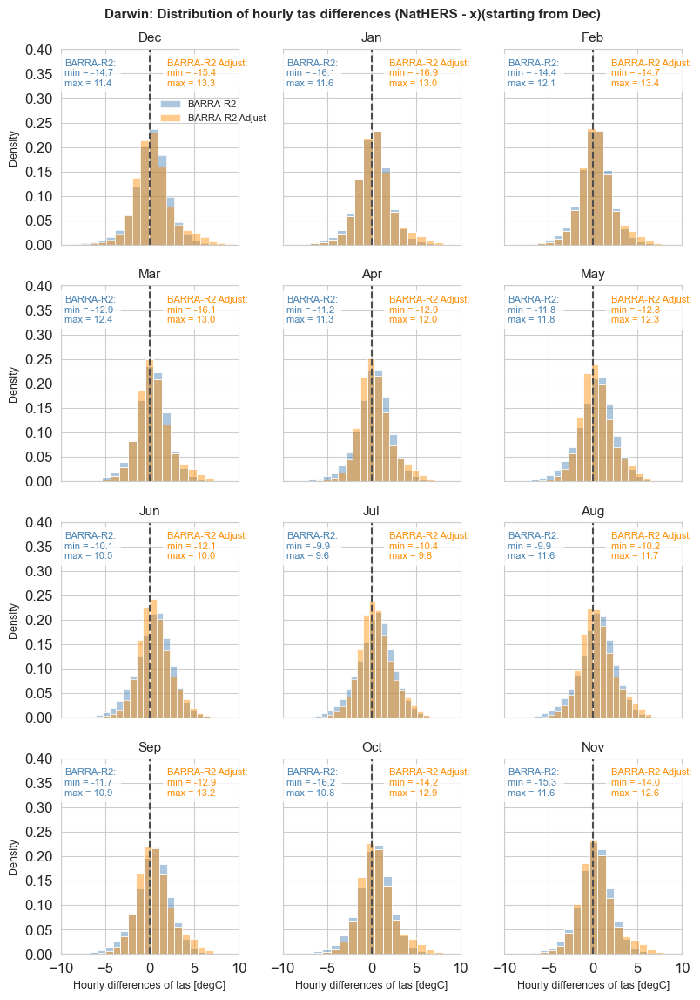

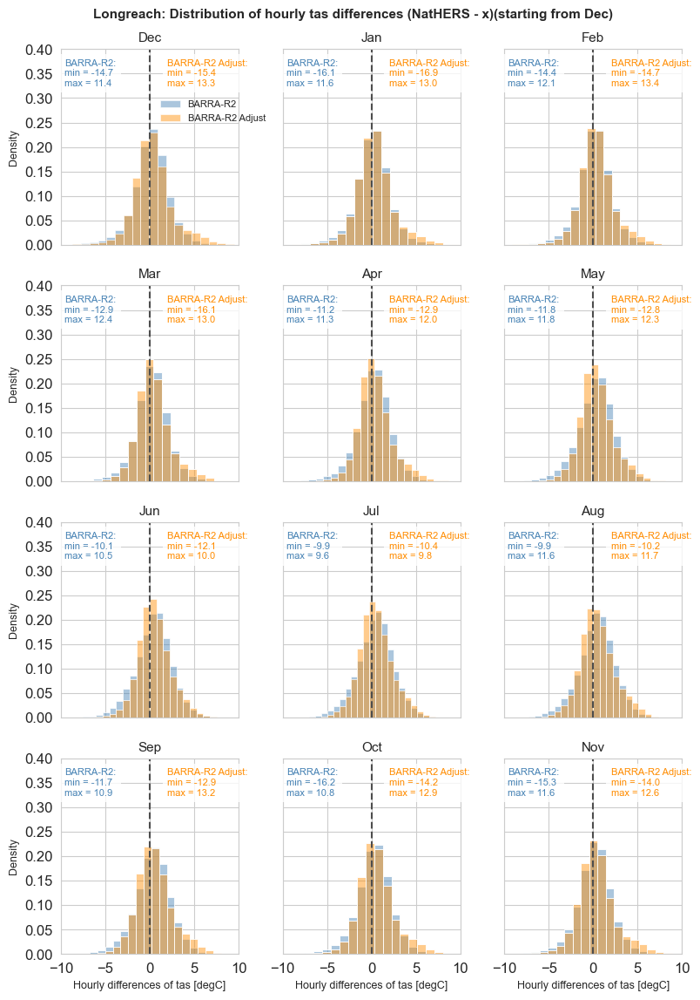

...

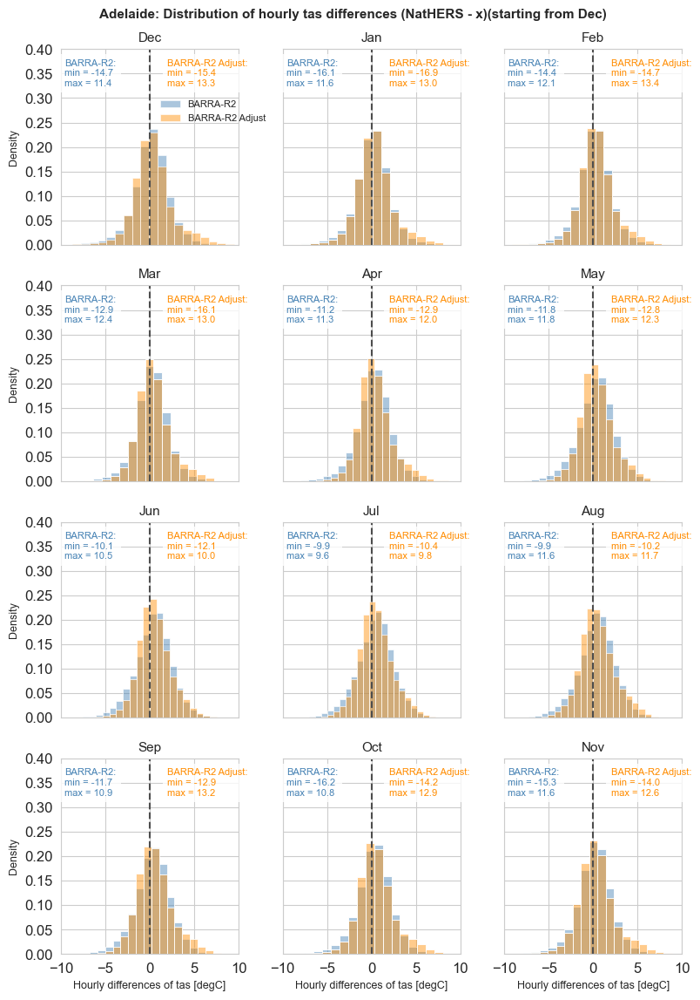

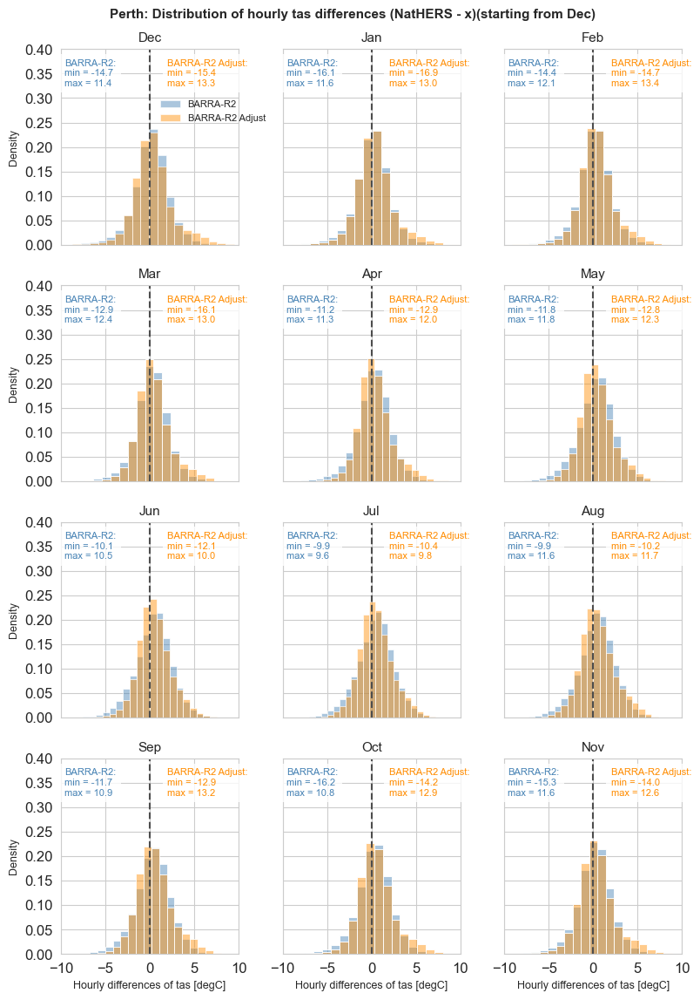

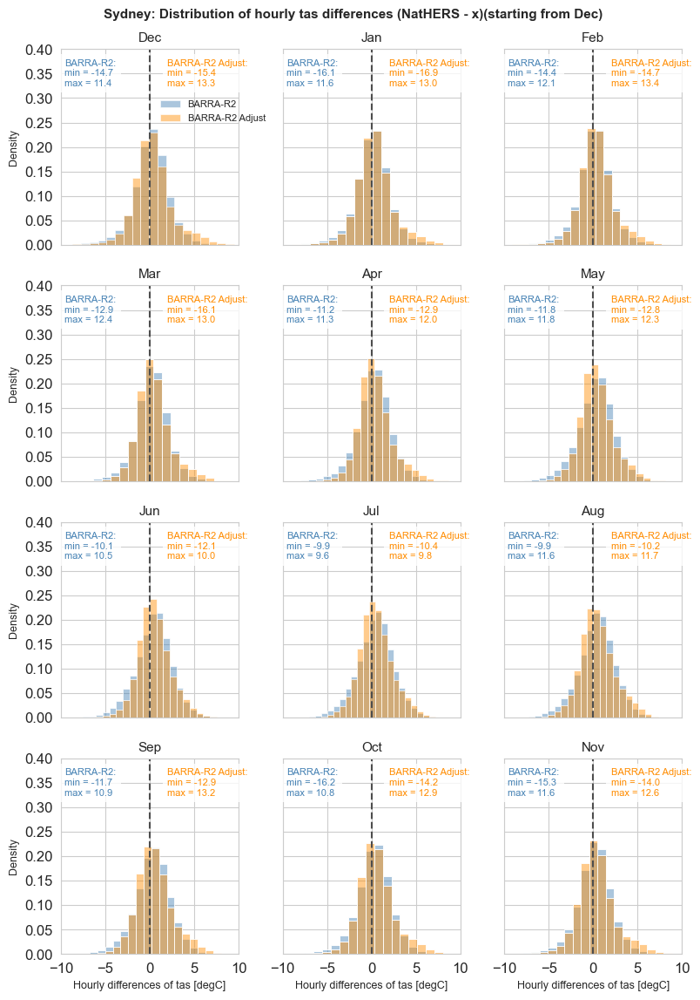

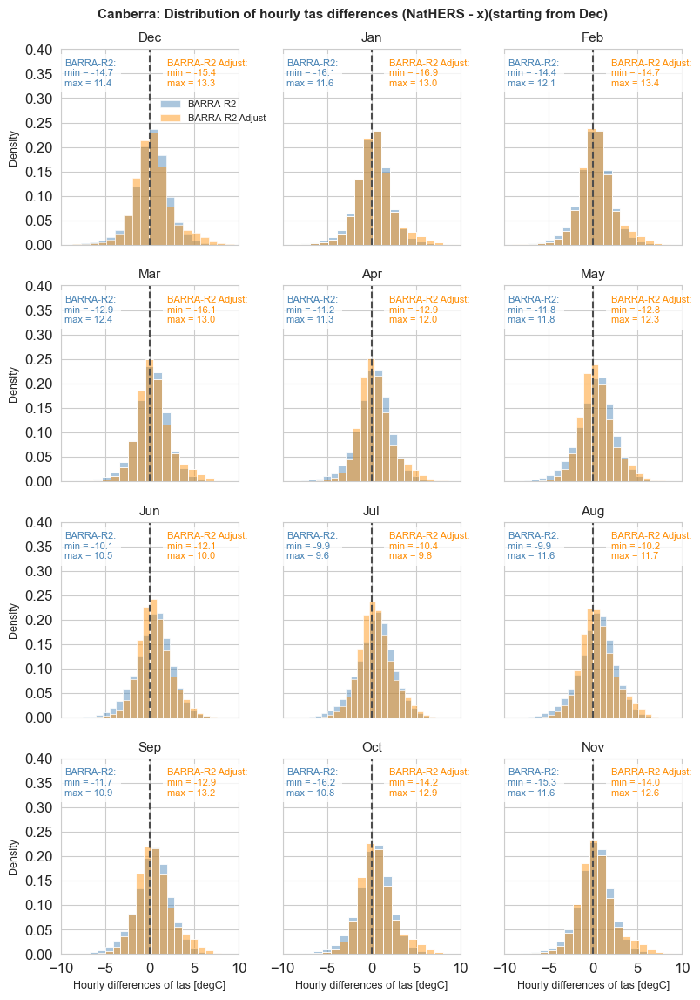

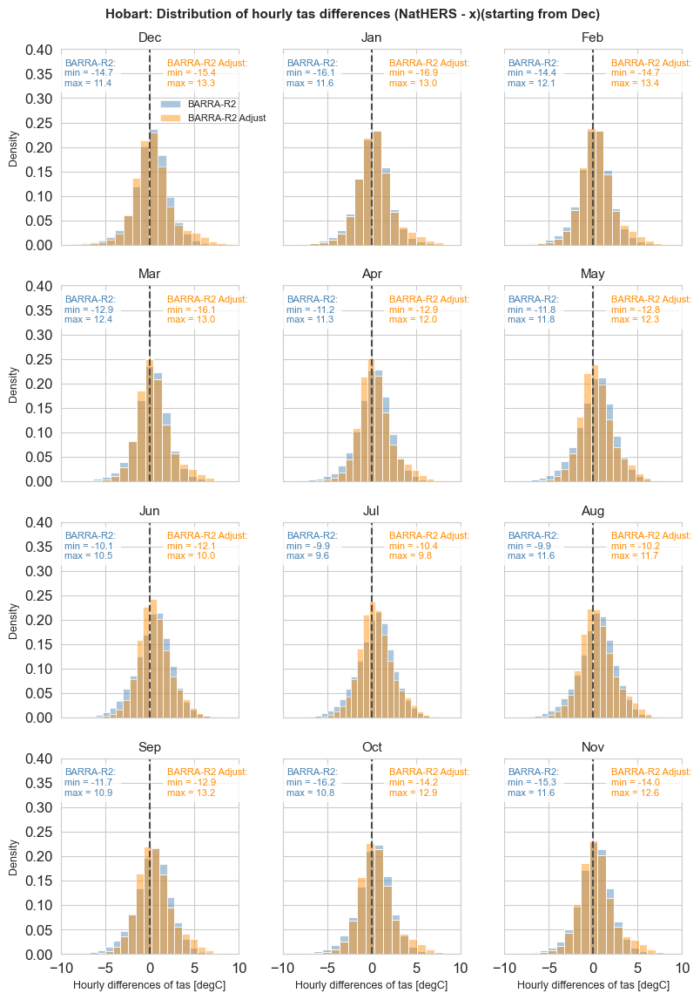

In [18]:
for l in da["loc"].values:
    data = convert_to_local_time(da,l)

    plot_monthly_two_difference_histograms_xr(
        da=da,
        location=l,
        obs_source="NatHERS",
        model1_source="BARRA-R2",
        model2_source="BARRA-R2 Adjust",
        xlim=(-10, 10),
        bins=30
    )


### Statistical tests of differences in daily temperature distributions
Distributional consistency tests for daily maximum, mean and minimum temperature: Kolmogorov-Smirnov (KS) and Mann–Whitney (MW)


Cairns — DAILY MAXIMUM TEMPERATURE
Cairns       | maximum  | Jan | KS: stat= 0.254, p= 0.000 (SIG) | MW: stat=380948.0, p= 0.000 (SIG)
Cairns       | maximum  | Feb | KS: stat= 0.273, p= 0.000 (SIG) | MW: stat=322591.0, p= 0.000 (SIG)
Cairns       | maximum  | Mar | KS: stat= 0.374, p= 0.000 (SIG) | MW: stat=420415.0, p= 0.000 (SIG)
Cairns       | maximum  | Apr | KS: stat= 0.421, p= 0.000 (SIG) | MW: stat=411105.0, p= 0.000 (SIG)
Cairns       | maximum  | May | KS: stat= 0.430, p= 0.000 (SIG) | MW: stat=448523.0, p= 0.000 (SIG)
Cairns       | maximum  | Jun | KS: stat= 0.375, p= 0.000 (SIG) | MW: stat=400722.0, p= 0.000 (SIG)
Cairns       | maximum  | Jul | KS: stat= 0.385, p= 0.000 (SIG) | MW: stat=424169.0, p= 0.000 (SIG)
Cairns       | maximum  | Aug | KS: stat= 0.321, p= 0.000 (SIG) | MW: stat=406879.0, p= 0.000 (SIG)
Cairns       | maximum  | Sep | KS: stat= 0.272, p= 0.000 (SIG) | MW: stat=372750.0, p= 0.000 (SIG)
Cairns       | maximum  | Oct | KS: stat= 0.266, p= 0.000 (SIG) 

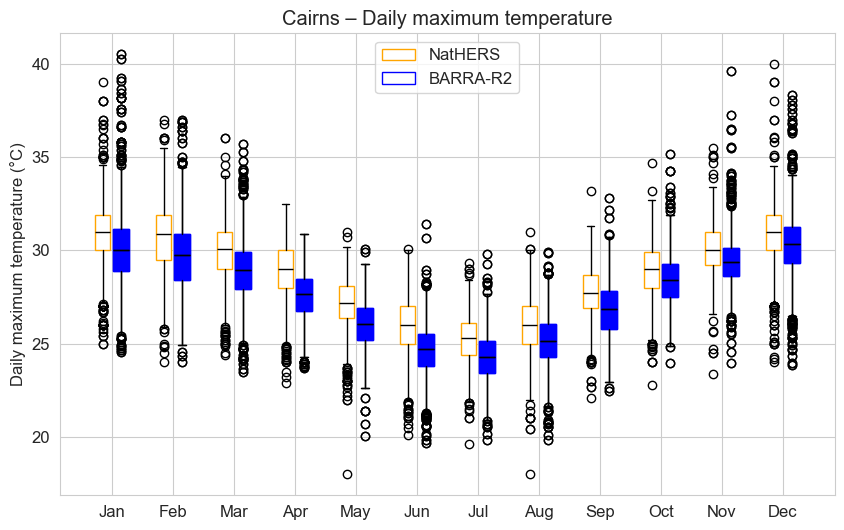

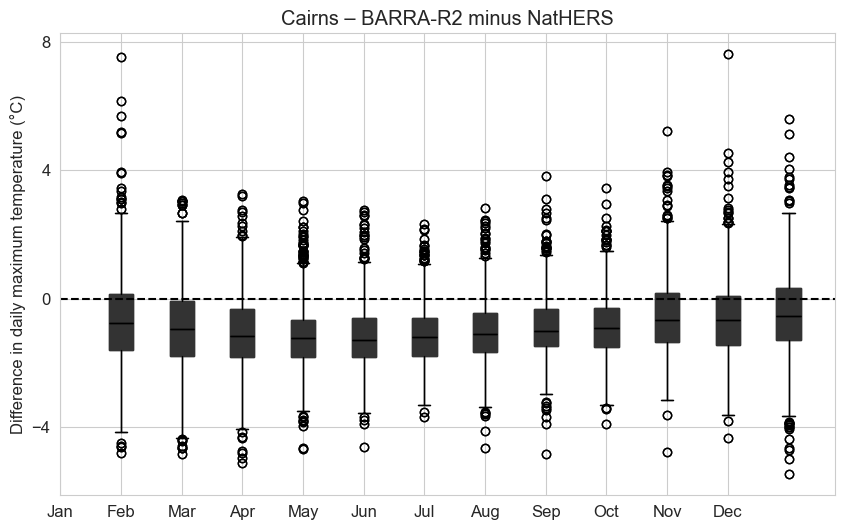


Cairns — DAILY MINIMUM TEMPERATURE
Cairns       | minimum  | Jan | KS: stat= 0.347, p= 0.000 (SIG) | MW: stat=412062.0, p= 0.000 (SIG)
Cairns       | minimum  | Feb | KS: stat= 0.412, p= 0.000 (SIG) | MW: stat=364349.0, p= 0.000 (SIG)
Cairns       | minimum  | Mar | KS: stat= 0.337, p= 0.000 (SIG) | MW: stat=420804.0, p= 0.000 (SIG)
Cairns       | minimum  | Apr | KS: stat= 0.232, p= 0.000 (SIG) | MW: stat=361244.0, p= 0.000 (SIG)
Cairns       | minimum  | May | KS: stat= 0.277, p= 0.000 (SIG) | MW: stat=390717.0, p= 0.000 (SIG)
Cairns       | minimum  | Jun | KS: stat= 0.320, p= 0.000 (SIG) | MW: stat=382946.0, p= 0.000 (SIG)
Cairns       | minimum  | Jul | KS: stat= 0.276, p= 0.000 (SIG) | MW: stat=393899.0, p= 0.000 (SIG)
Cairns       | minimum  | Aug | KS: stat= 0.330, p= 0.000 (SIG) | MW: stat=414323.0, p= 0.000 (SIG)
Cairns       | minimum  | Sep | KS: stat= 0.371, p= 0.000 (SIG) | MW: stat=404517.0, p= 0.000 (SIG)
Cairns       | minimum  | Oct | KS: stat= 0.368, p= 0.000 (SIG) 

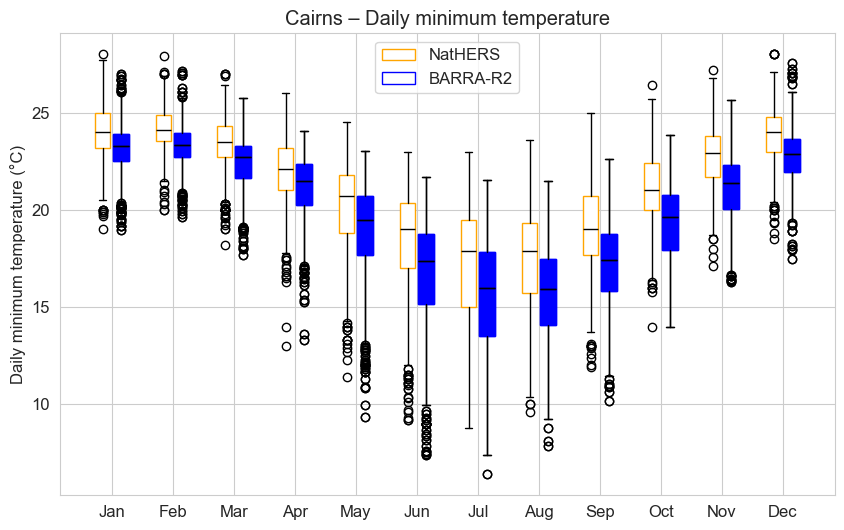

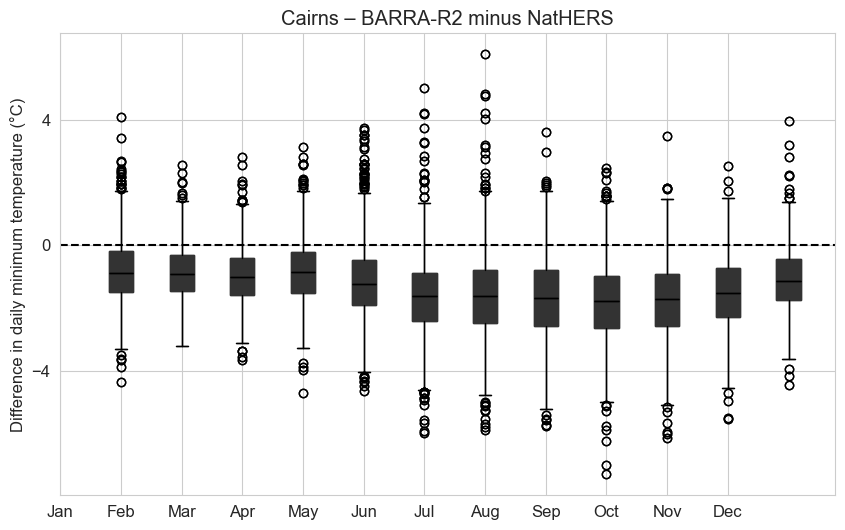


Cairns — DAILY MEAN TEMPERATURE
Cairns       | mean     | Jan | KS: stat= 0.345, p= 0.000 (SIG) | MW: stat=415707.0, p= 0.000 (SIG)
Cairns       | mean     | Feb | KS: stat= 0.391, p= 0.000 (SIG) | MW: stat=357635.0, p= 0.000 (SIG)
Cairns       | mean     | Mar | KS: stat= 0.406, p= 0.000 (SIG) | MW: stat=452631.0, p= 0.000 (SIG)
Cairns       | mean     | Apr | KS: stat= 0.353, p= 0.000 (SIG) | MW: stat=407584.0, p= 0.000 (SIG)
Cairns       | mean     | May | KS: stat= 0.355, p= 0.000 (SIG) | MW: stat=433382.0, p= 0.000 (SIG)
Cairns       | mean     | Jun | KS: stat= 0.372, p= 0.000 (SIG) | MW: stat=405530.0, p= 0.000 (SIG)
Cairns       | mean     | Jul | KS: stat= 0.329, p= 0.000 (SIG) | MW: stat=421701.0, p= 0.000 (SIG)
Cairns       | mean     | Aug | KS: stat= 0.379, p= 0.000 (SIG) | MW: stat=436648.0, p= 0.000 (SIG)
Cairns       | mean     | Sep | KS: stat= 0.405, p= 0.000 (SIG) | MW: stat=417889.0, p= 0.000 (SIG)
Cairns       | mean     | Oct | KS: stat= 0.391, p= 0.000 (SIG) | M

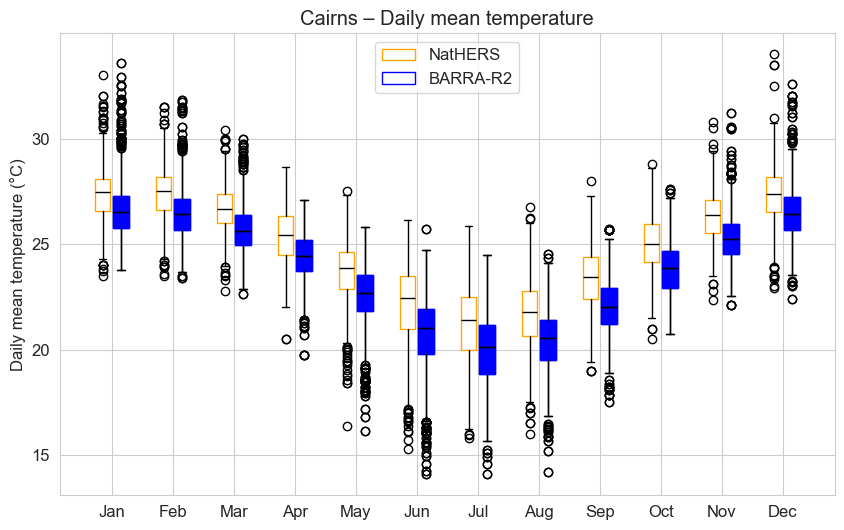

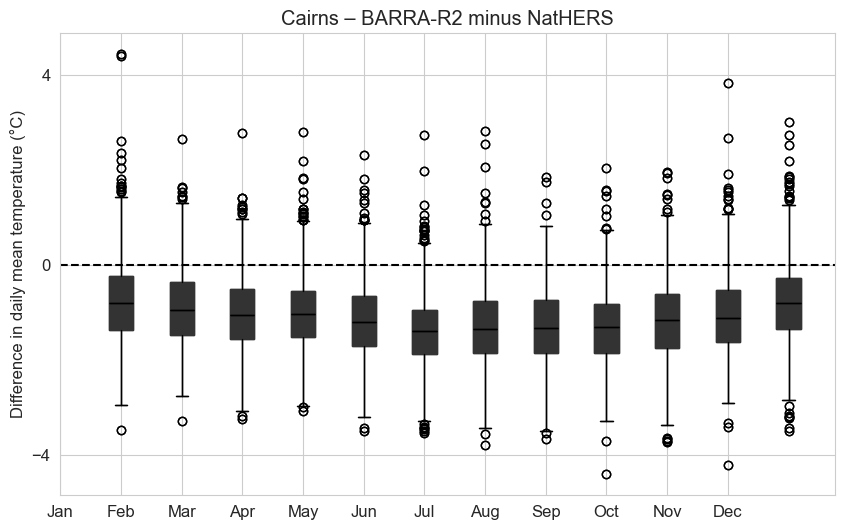


Brisbane — DAILY MAXIMUM TEMPERATURE
Brisbane     | maximum  | Jan | KS: stat= 0.191, p= 0.000 (SIG) | MW: stat=229985.0, p= 0.000 (SIG)
Brisbane     | maximum  | Feb | KS: stat= 0.126, p= 0.000 (SIG) | MW: stat=218458.0, p= 0.000 (SIG)
Brisbane     | maximum  | Mar | KS: stat= 0.135, p= 0.000 (SIG) | MW: stat=254166.0, p= 0.000 (SIG)
Brisbane     | maximum  | Apr | KS: stat= 0.144, p= 0.000 (SIG) | MW: stat=240238.0, p= 0.000 (SIG)
Brisbane     | maximum  | May | KS: stat= 0.081, p= 0.012 (SIG) | MW: stat=279339.0, p= 0.017 (SIG)
Brisbane     | maximum  | Jun | KS: stat= 0.044, p= 0.462 (ns) | MW: stat=277744.0, p= 0.676 (ns)
Brisbane     | maximum  | Jul | KS: stat= 0.065, p= 0.079 (SIG) | MW: stat=283889.0, p= 0.062 (SIG)
Brisbane     | maximum  | Aug | KS: stat= 0.154, p= 0.000 (SIG) | MW: stat=247621.0, p= 0.000 (SIG)
Brisbane     | maximum  | Sep | KS: stat= 0.212, p= 0.000 (SIG) | MW: stat=210022.0, p= 0.000 (SIG)
Brisbane     | maximum  | Oct | KS: stat= 0.240, p= 0.000 (SIG) 

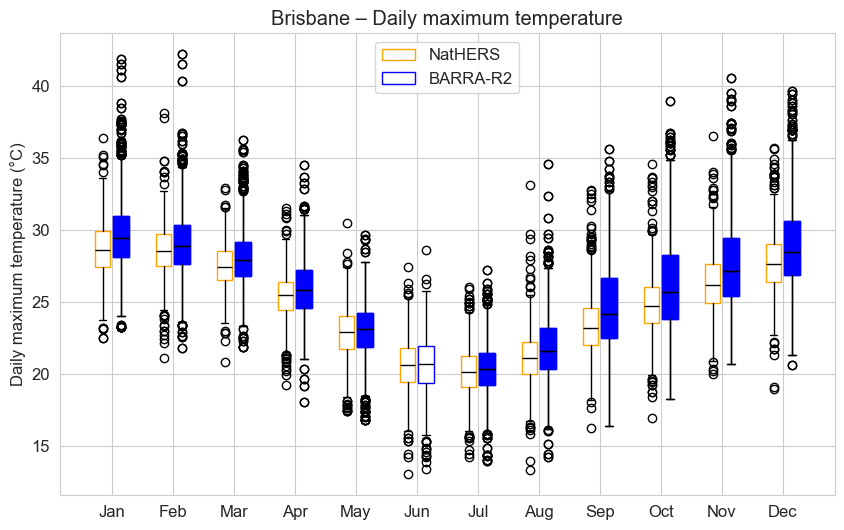

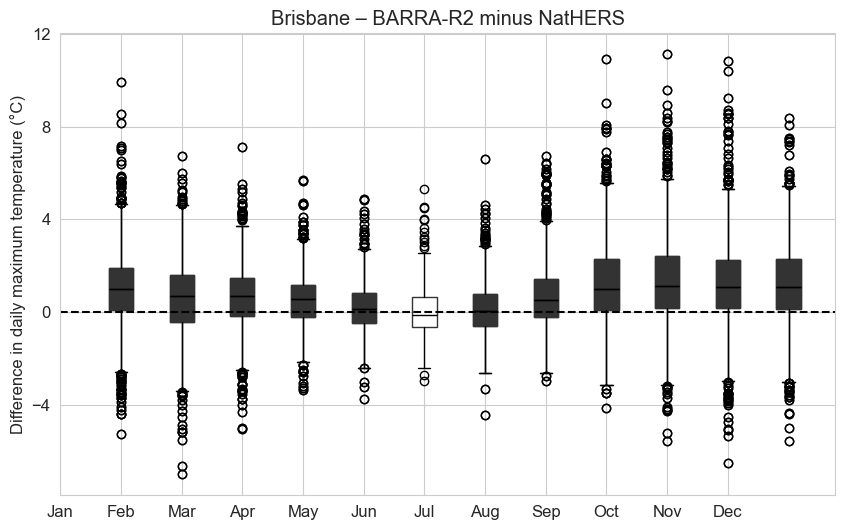


Brisbane — DAILY MINIMUM TEMPERATURE
Brisbane     | minimum  | Jan | KS: stat= 0.037, p= 0.651 (ns) | MW: stat=307483.0, p= 0.469 (ns)
Brisbane     | minimum  | Feb | KS: stat= 0.045, p= 0.463 (ns) | MW: stat=249943.0, p= 0.925 (ns)
Brisbane     | minimum  | Mar | KS: stat= 0.034, p= 0.776 (ns) | MW: stat=296899.0, p= 0.698 (ns)
Brisbane     | minimum  | Apr | KS: stat= 0.053, p= 0.237 (ns) | MW: stat=278393.0, p= 0.733 (ns)
Brisbane     | minimum  | May | KS: stat= 0.074, p= 0.030 (SIG) | MW: stat=280827.0, p= 0.027 (SIG)
Brisbane     | minimum  | Jun | KS: stat= 0.085, p= 0.008 (SIG) | MW: stat=272547.0, p= 0.300 (ns)
Brisbane     | minimum  | Jul | KS: stat= 0.093, p= 0.002 (SIG) | MW: stat=292703.0, p= 0.388 (ns)
Brisbane     | minimum  | Aug | KS: stat= 0.071, p= 0.040 (SIG) | MW: stat=293649.0, p= 0.450 (ns)
Brisbane     | minimum  | Sep | KS: stat= 0.049, p= 0.321 (ns) | MW: stat=286803.0, p= 0.508 (ns)
Brisbane     | minimum  | Oct | KS: stat= 0.086, p= 0.006 (SIG) | MW: stat=

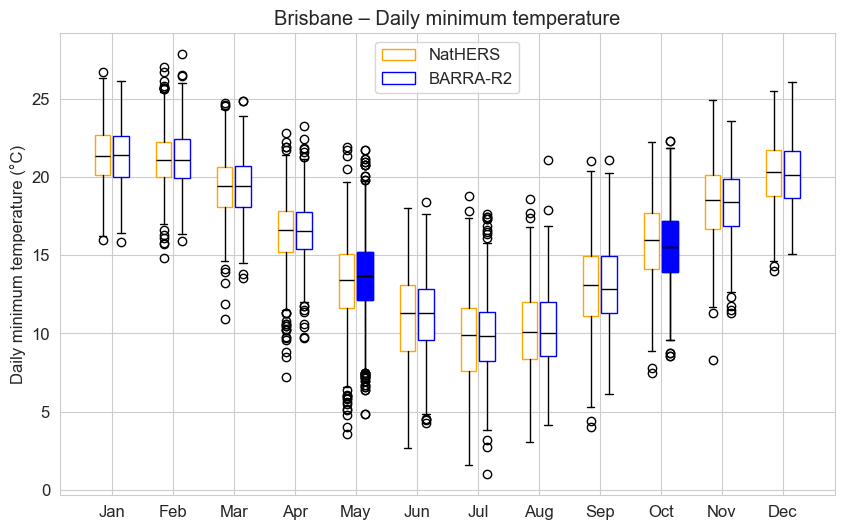

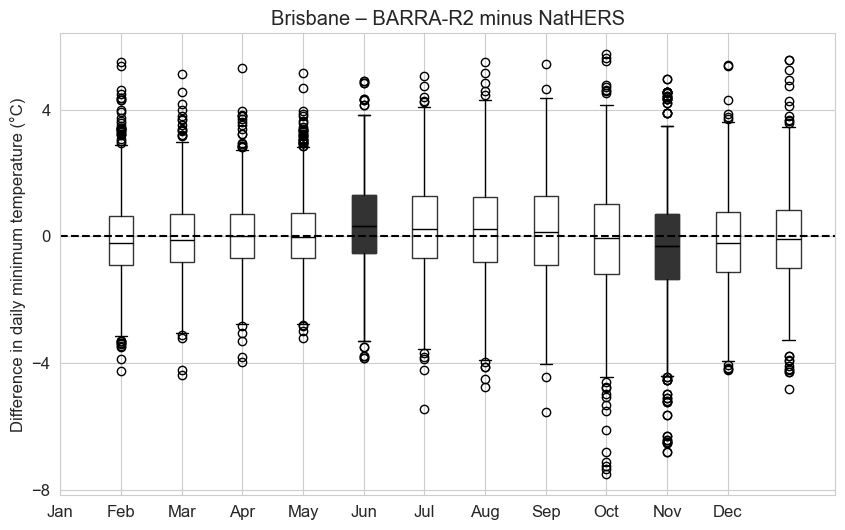


Brisbane — DAILY MEAN TEMPERATURE
Brisbane     | mean     | Jan | KS: stat= 0.110, p= 0.000 (SIG) | MW: stat=264939.0, p= 0.000 (SIG)
Brisbane     | mean     | Feb | KS: stat= 0.081, p= 0.020 (SIG) | MW: stat=232934.0, p= 0.034 (SIG)
Brisbane     | mean     | Mar | KS: stat= 0.084, p= 0.009 (SIG) | MW: stat=271054.0, p= 0.001 (SIG)
Brisbane     | mean     | Apr | KS: stat= 0.100, p= 0.001 (SIG) | MW: stat=250541.0, p= 0.000 (SIG)
Brisbane     | mean     | May | KS: stat= 0.083, p= 0.010 (SIG) | MW: stat=272847.0, p= 0.002 (SIG)
Brisbane     | mean     | Jun | KS: stat= 0.069, p= 0.054 (SIG) | MW: stat=269975.0, p= 0.179 (ns)
Brisbane     | mean     | Jul | KS: stat= 0.062, p= 0.102 (ns) | MW: stat=284271.0, p= 0.069 (SIG)
Brisbane     | mean     | Aug | KS: stat= 0.102, p= 0.001 (SIG) | MW: stat=262726.0, p= 0.000 (SIG)
Brisbane     | mean     | Sep | KS: stat= 0.117, p= 0.000 (SIG) | MW: stat=243672.0, p= 0.000 (SIG)
Brisbane     | mean     | Oct | KS: stat= 0.120, p= 0.000 (SIG) | M

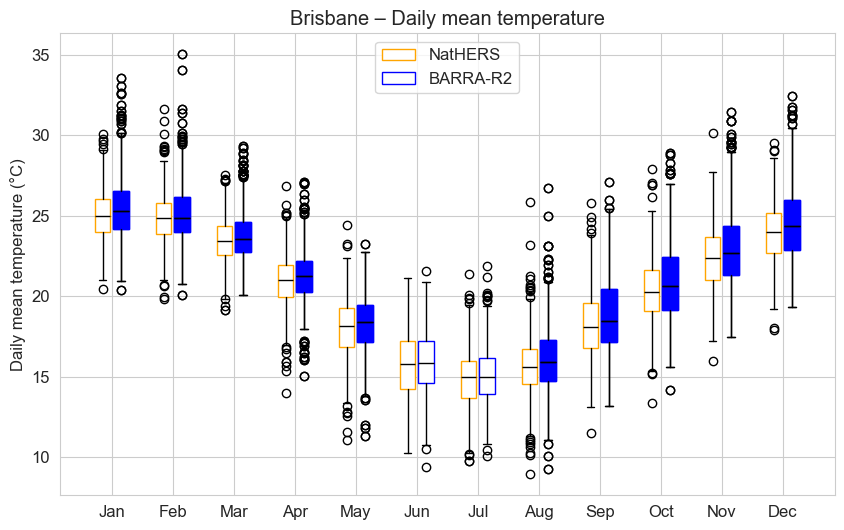

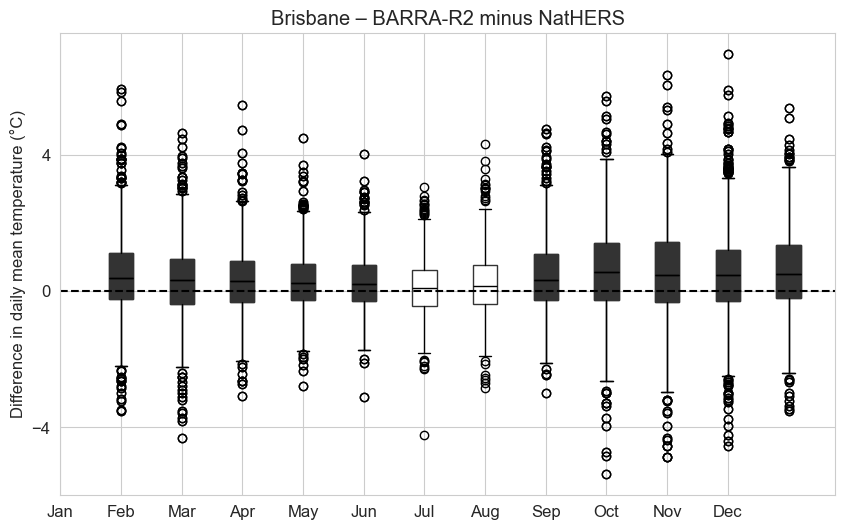


Melbourne — DAILY MAXIMUM TEMPERATURE
Melbourne    | maximum  | Jan | KS: stat= 0.072, p= 0.035 (SIG) | MW: stat=288275.0, p= 0.147 (ns)
Melbourne    | maximum  | Feb | KS: stat= 0.045, p= 0.463 (ns) | MW: stat=245180.0, p= 0.598 (ns)
Melbourne    | maximum  | Mar | KS: stat= 0.032, p= 0.815 (ns) | MW: stat=299997.0, p= 0.971 (ns)
Melbourne    | maximum  | Apr | KS: stat= 0.060, p= 0.134 (ns) | MW: stat=293102.0, p= 0.158 (ns)
Melbourne    | maximum  | May | KS: stat= 0.139, p= 0.000 (SIG) | MW: stat=341136.0, p= 0.000 (SIG)
Melbourne    | maximum  | Jun | KS: stat= 0.204, p= 0.000 (SIG) | MW: stat=344404.0, p= 0.000 (SIG)
Melbourne    | maximum  | Jul | KS: stat= 0.205, p= 0.000 (SIG) | MW: stat=366457.0, p= 0.000 (SIG)
Melbourne    | maximum  | Aug | KS: stat= 0.138, p= 0.000 (SIG) | MW: stat=344315.0, p= 0.000 (SIG)
Melbourne    | maximum  | Sep | KS: stat= 0.077, p= 0.023 (SIG) | MW: stat=298238.0, p= 0.043 (SIG)
Melbourne    | maximum  | Oct | KS: stat= 0.052, p= 0.253 (ns) | MW:

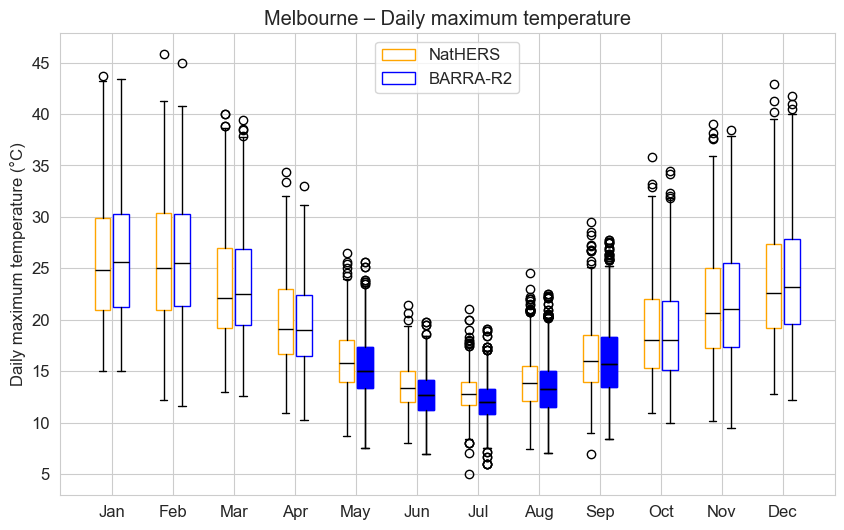

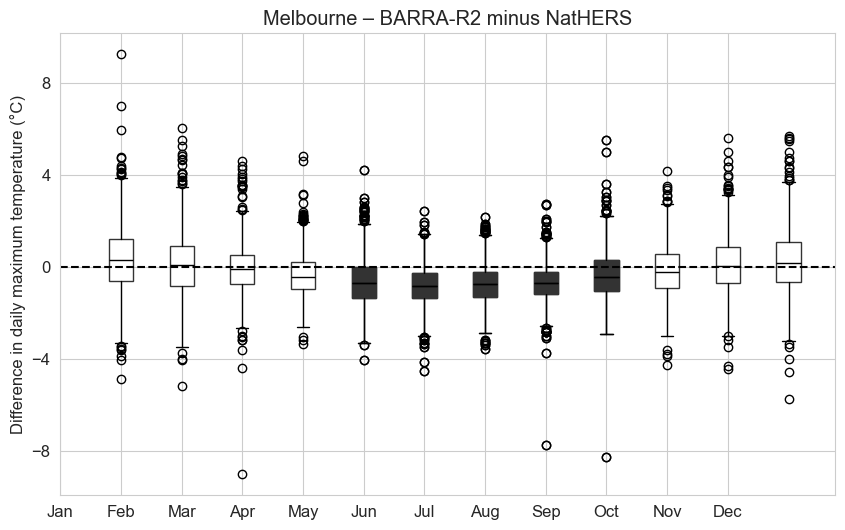


Melbourne — DAILY MINIMUM TEMPERATURE
Melbourne    | minimum  | Jan | KS: stat= 0.073, p= 0.030 (SIG) | MW: stat=306033.0, p= 0.575 (ns)
Melbourne    | minimum  | Feb | KS: stat= 0.069, p= 0.067 (SIG) | MW: stat=245473.0, p= 0.625 (ns)
Melbourne    | minimum  | Mar | KS: stat= 0.061, p= 0.116 (ns) | MW: stat=300581.0, p= 0.976 (ns)
Melbourne    | minimum  | Apr | KS: stat= 0.069, p= 0.054 (SIG) | MW: stat=274238.0, p= 0.403 (ns)
Melbourne    | minimum  | May | KS: stat= 0.111, p= 0.000 (SIG) | MW: stat=285860.0, p= 0.101 (ns)
Melbourne    | minimum  | Jun | KS: stat= 0.079, p= 0.019 (SIG) | MW: stat=275360.0, p= 0.483 (ns)
Melbourne    | minimum  | Jul | KS: stat= 0.128, p= 0.000 (SIG) | MW: stat=284437.0, p= 0.072 (SIG)
Melbourne    | minimum  | Aug | KS: stat= 0.150, p= 0.000 (SIG) | MW: stat=274426.0, p= 0.003 (SIG)
Melbourne    | minimum  | Sep | KS: stat= 0.163, p= 0.000 (SIG) | MW: stat=240821.0, p= 0.000 (SIG)
Melbourne    | minimum  | Oct | KS: stat= 0.159, p= 0.000 (SIG) | MW

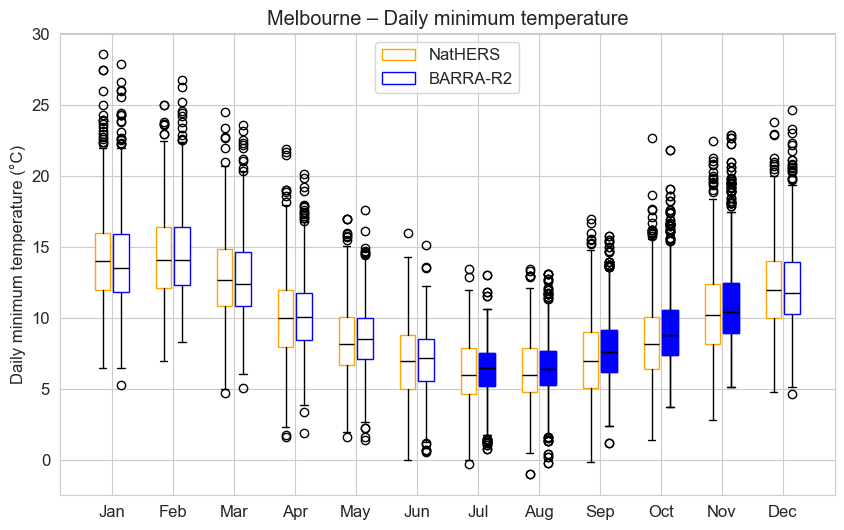

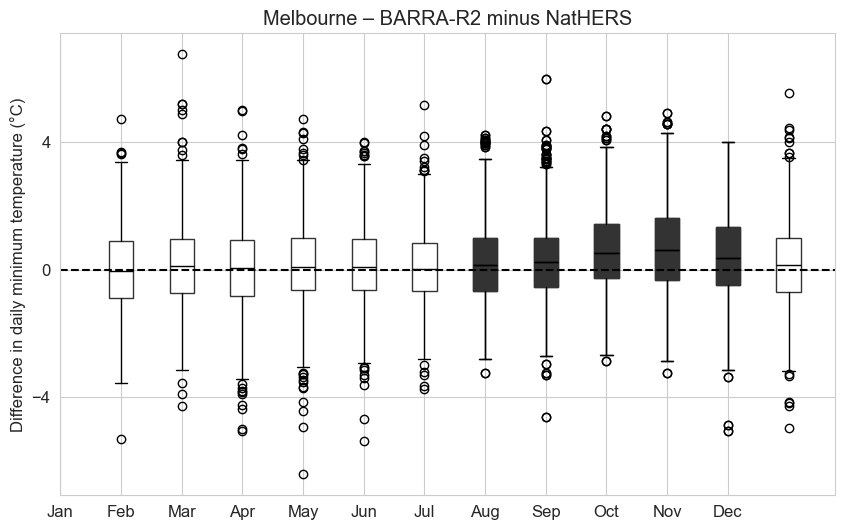


Melbourne — DAILY MEAN TEMPERATURE
Melbourne    | mean     | Jan | KS: stat= 0.043, p= 0.485 (ns) | MW: stat=293431.0, p= 0.386 (ns)
Melbourne    | mean     | Feb | KS: stat= 0.033, p= 0.848 (ns) | MW: stat=244420.0, p= 0.531 (ns)
Melbourne    | mean     | Mar | KS: stat= 0.025, p= 0.974 (ns) | MW: stat=300459.0, p= 0.987 (ns)
Melbourne    | mean     | Apr | KS: stat= 0.043, p= 0.502 (ns) | MW: stat=286697.0, p= 0.516 (ns)
Melbourne    | mean     | May | KS: stat= 0.075, p= 0.026 (SIG) | MW: stat=316621.0, p= 0.064 (SIG)
Melbourne    | mean     | Jun | KS: stat= 0.096, p= 0.002 (SIG) | MW: stat=309725.0, p= 0.001 (SIG)
Melbourne    | mean     | Jul | KS: stat= 0.095, p= 0.002 (SIG) | MW: stat=324330.0, p= 0.006 (SIG)
Melbourne    | mean     | Aug | KS: stat= 0.062, p= 0.102 (ns) | MW: stat=314722.0, p= 0.102 (ns)
Melbourne    | mean     | Sep | KS: stat= 0.060, p= 0.134 (ns) | MW: stat=271965.0, p= 0.268 (ns)
Melbourne    | mean     | Oct | KS: stat= 0.061, p= 0.116 (ns) | MW: stat=28

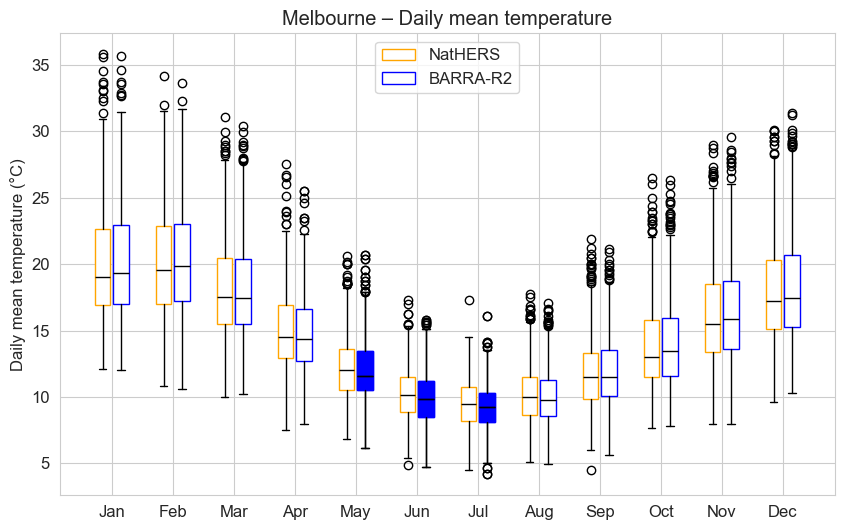

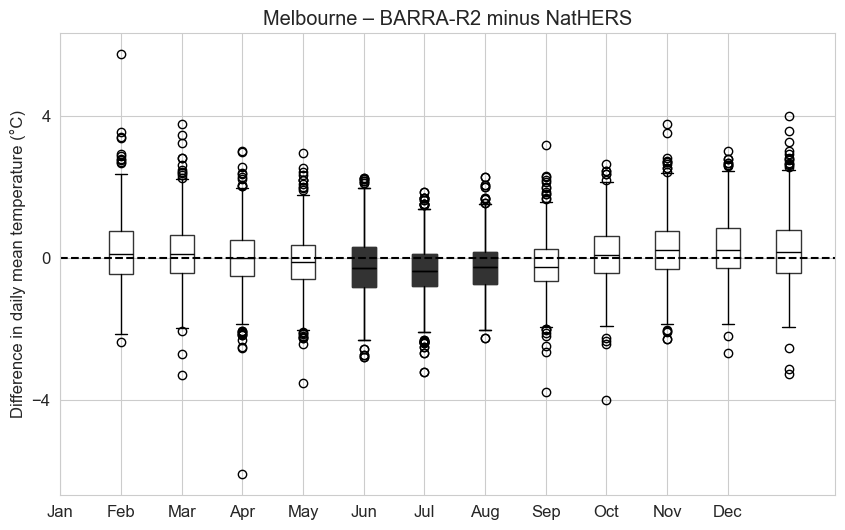


Darwin — DAILY MAXIMUM TEMPERATURE
Darwin       | maximum  | Jan | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=293804.0, p= 0.409 (ns)
Darwin       | maximum  | Feb | KS: stat= 0.098, p= 0.002 (SIG) | MW: stat=249890.0, p= 0.930 (ns)
Darwin       | maximum  | Mar | KS: stat= 0.187, p= 0.000 (SIG) | MW: stat=271605.0, p= 0.001 (SIG)
Darwin       | maximum  | Apr | KS: stat= 0.459, p= 0.000 (SIG) | MW: stat=160803.0, p= 0.000 (SIG)
Darwin       | maximum  | May | KS: stat= 0.597, p= 0.000 (SIG) | MW: stat= 89573.0, p= 0.000 (SIG)
Darwin       | maximum  | Jun | KS: stat= 0.559, p= 0.000 (SIG) | MW: stat= 86224.0, p= 0.000 (SIG)
Darwin       | maximum  | Jul | KS: stat= 0.643, p= 0.000 (SIG) | MW: stat= 63940.0, p= 0.000 (SIG)
Darwin       | maximum  | Aug | KS: stat= 0.644, p= 0.000 (SIG) | MW: stat= 63489.0, p= 0.000 (SIG)
Darwin       | maximum  | Sep | KS: stat= 0.617, p= 0.000 (SIG) | MW: stat= 70637.0, p= 0.000 (SIG)
Darwin       | maximum  | Oct | KS: stat= 0.547, p= 0.000 (SIG) | 

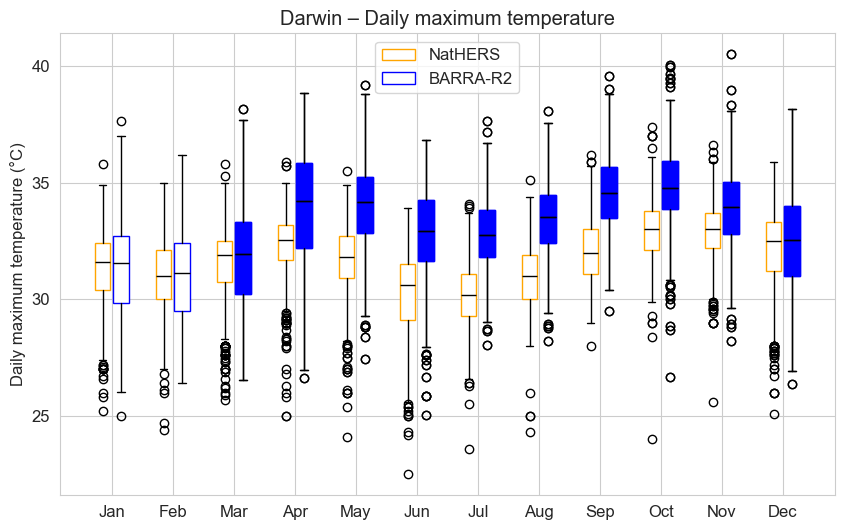

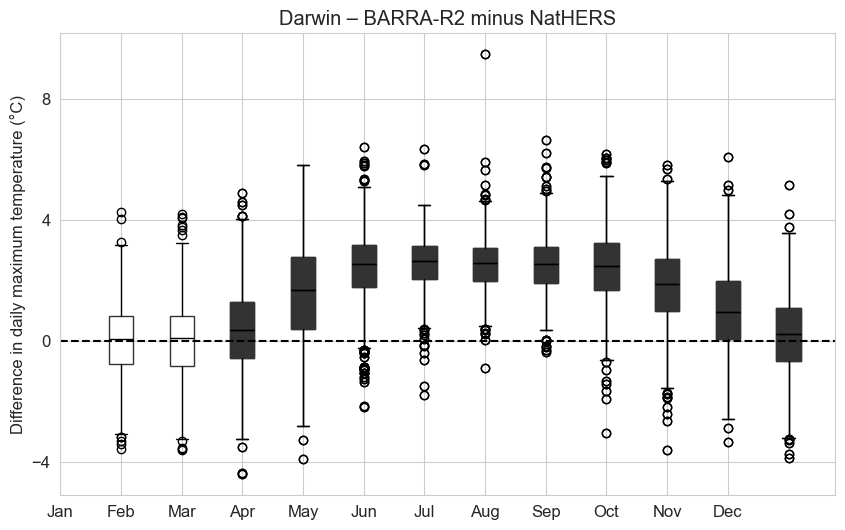


Darwin — DAILY MINIMUM TEMPERATURE
Darwin       | minimum  | Jan | KS: stat= 0.362, p= 0.000 (SIG) | MW: stat=191452.0, p= 0.000 (SIG)
Darwin       | minimum  | Feb | KS: stat= 0.273, p= 0.000 (SIG) | MW: stat=176694.0, p= 0.000 (SIG)
Darwin       | minimum  | Mar | KS: stat= 0.112, p= 0.000 (SIG) | MW: stat=283182.0, p= 0.052 (SIG)
Darwin       | minimum  | Apr | KS: stat= 0.312, p= 0.000 (SIG) | MW: stat=392515.0, p= 0.000 (SIG)
Darwin       | minimum  | May | KS: stat= 0.395, p= 0.000 (SIG) | MW: stat=458242.0, p= 0.000 (SIG)
Darwin       | minimum  | Jun | KS: stat= 0.452, p= 0.000 (SIG) | MW: stat=451379.0, p= 0.000 (SIG)
Darwin       | minimum  | Jul | KS: stat= 0.555, p= 0.000 (SIG) | MW: stat=509810.0, p= 0.000 (SIG)
Darwin       | minimum  | Aug | KS: stat= 0.525, p= 0.000 (SIG) | MW: stat=505373.0, p= 0.000 (SIG)
Darwin       | minimum  | Sep | KS: stat= 0.549, p= 0.000 (SIG) | MW: stat=468115.0, p= 0.000 (SIG)
Darwin       | minimum  | Oct | KS: stat= 0.436, p= 0.000 (SIG) 

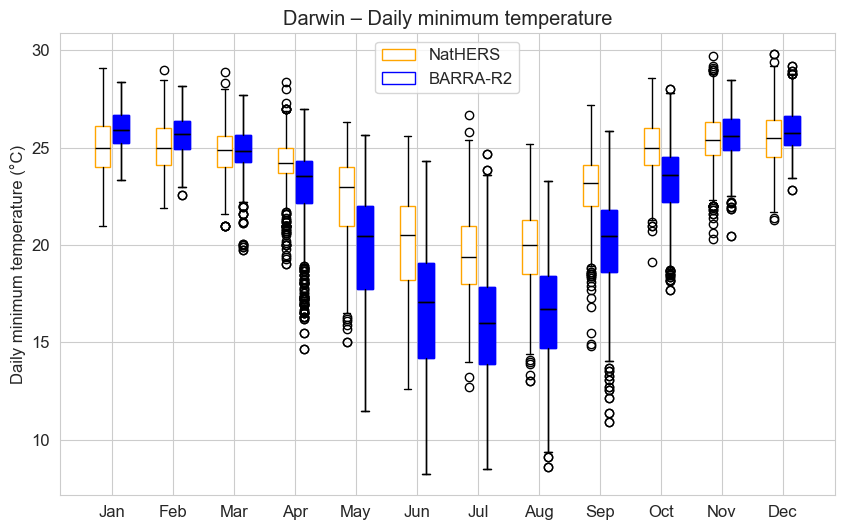

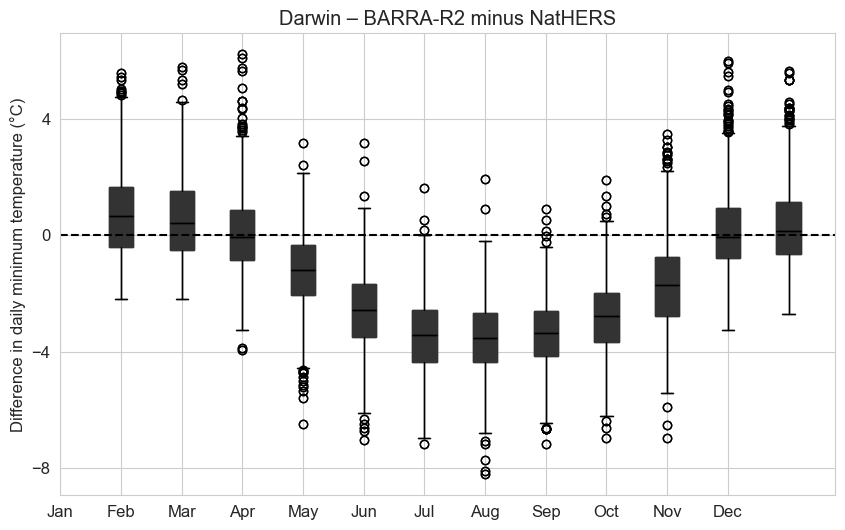


Darwin — DAILY MEAN TEMPERATURE
Darwin       | mean     | Jan | KS: stat= 0.161, p= 0.000 (SIG) | MW: stat=245031.0, p= 0.000 (SIG)
Darwin       | mean     | Feb | KS: stat= 0.110, p= 0.000 (SIG) | MW: stat=217225.0, p= 0.000 (SIG)
Darwin       | mean     | Mar | KS: stat= 0.135, p= 0.000 (SIG) | MW: stat=264655.0, p= 0.000 (SIG)
Darwin       | mean     | Apr | KS: stat= 0.132, p= 0.000 (SIG) | MW: stat=255544.0, p= 0.002 (SIG)
Darwin       | mean     | May | KS: stat= 0.059, p= 0.130 (ns) | MW: stat=303904.0, p= 0.684 (ns)
Darwin       | mean     | Jun | KS: stat= 0.112, p= 0.000 (SIG) | MW: stat=312698.0, p= 0.000 (SIG)
Darwin       | mean     | Jul | KS: stat= 0.151, p= 0.000 (SIG) | MW: stat=348838.0, p= 0.000 (SIG)
Darwin       | mean     | Aug | KS: stat= 0.132, p= 0.000 (SIG) | MW: stat=343813.0, p= 0.000 (SIG)
Darwin       | mean     | Sep | KS: stat= 0.096, p= 0.002 (SIG) | MW: stat=302724.0, p= 0.010 (SIG)
Darwin       | mean     | Oct | KS: stat= 0.077, p= 0.019 (SIG) | MW:

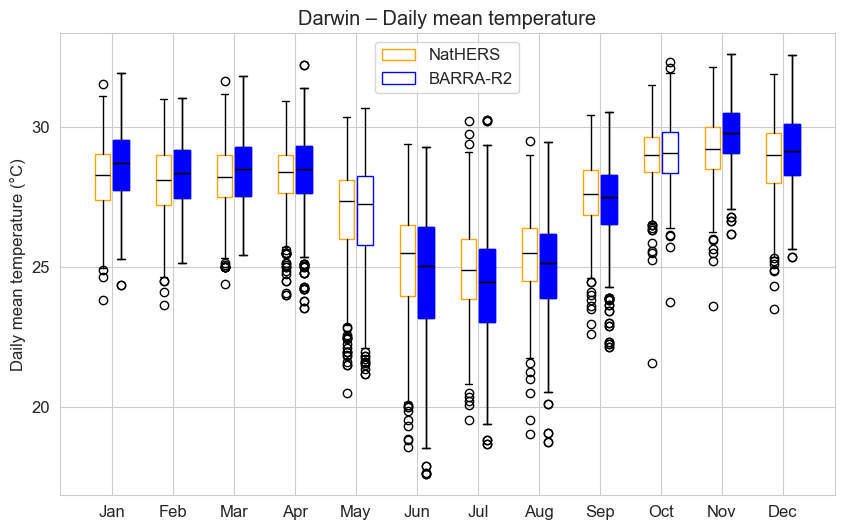

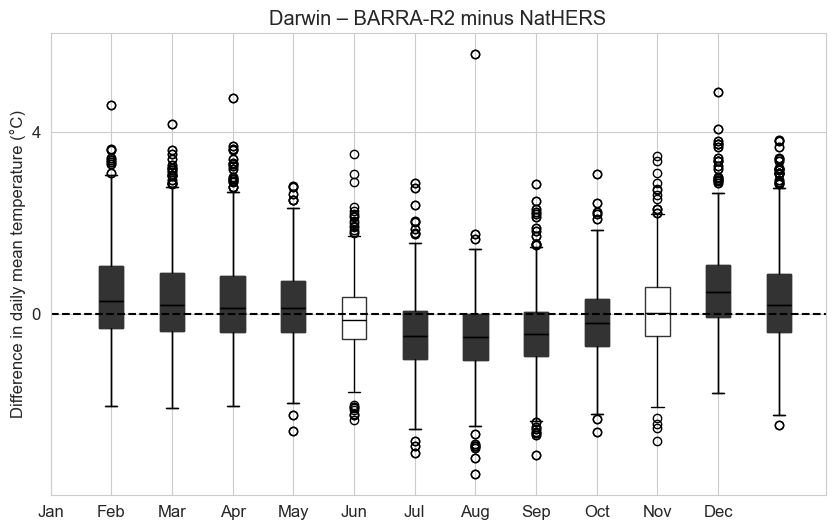


Longreach — DAILY MAXIMUM TEMPERATURE
Longreach    | maximum  | Jan | KS: stat= 0.075, p= 0.026 (SIG) | MW: stat=313791.0, p= 0.150 (ns)
Longreach    | maximum  | Feb | KS: stat= 0.071, p= 0.058 (SIG) | MW: stat=259702.0, p= 0.171 (ns)
Longreach    | maximum  | Mar | KS: stat= 0.043, p= 0.484 (ns) | MW: stat=308530.0, p= 0.351 (ns)
Longreach    | maximum  | Apr | KS: stat= 0.076, p= 0.026 (SIG) | MW: stat=297749.0, p= 0.049 (SIG)
Longreach    | maximum  | May | KS: stat= 0.107, p= 0.000 (SIG) | MW: stat=326151.0, p= 0.003 (SIG)
Longreach    | maximum  | Jun | KS: stat= 0.089, p= 0.005 (SIG) | MW: stat=309990.0, p= 0.001 (SIG)
Longreach    | maximum  | Jul | KS: stat= 0.089, p= 0.004 (SIG) | MW: stat=331003.0, p= 0.000 (SIG)
Longreach    | maximum  | Aug | KS: stat= 0.052, p= 0.253 (ns) | MW: stat=310998.0, p= 0.225 (ns)
Longreach    | maximum  | Sep | KS: stat= 0.024, p= 0.982 (ns) | MW: stat=280267.0, p= 0.907 (ns)
Longreach    | maximum  | Oct | KS: stat= 0.039, p= 0.607 (ns) | MW: 

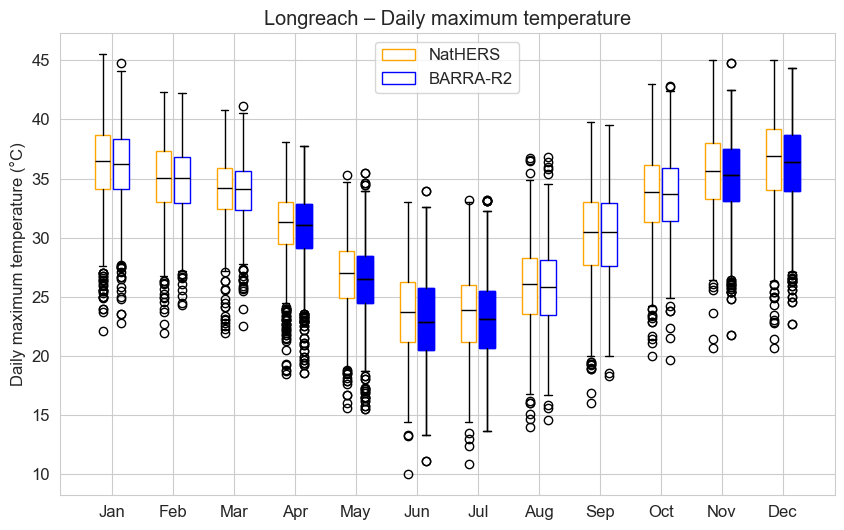

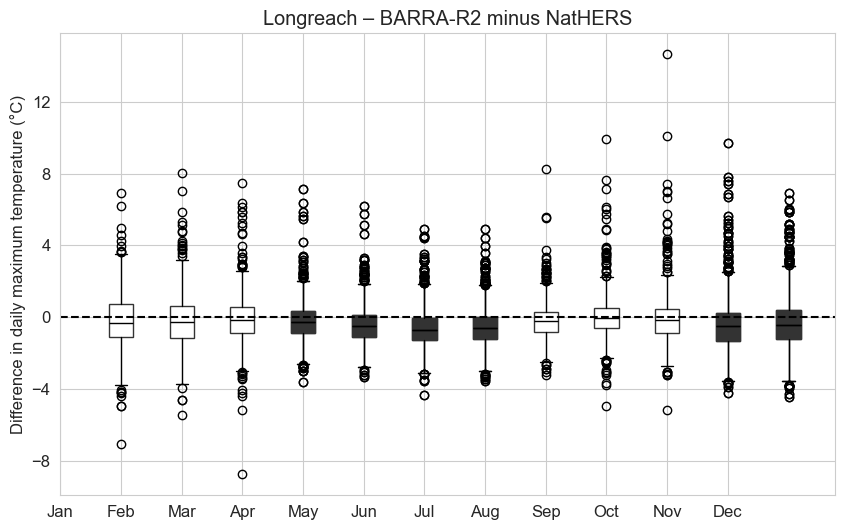


Longreach — DAILY MINIMUM TEMPERATURE
Longreach    | minimum  | Jan | KS: stat= 0.271, p= 0.000 (SIG) | MW: stat=209032.0, p= 0.000 (SIG)
Longreach    | minimum  | Feb | KS: stat= 0.279, p= 0.000 (SIG) | MW: stat=168845.0, p= 0.000 (SIG)
Longreach    | minimum  | Mar | KS: stat= 0.206, p= 0.000 (SIG) | MW: stat=226248.0, p= 0.000 (SIG)
Longreach    | minimum  | Apr | KS: stat= 0.140, p= 0.000 (SIG) | MW: stat=233637.0, p= 0.000 (SIG)
Longreach    | minimum  | May | KS: stat= 0.129, p= 0.000 (SIG) | MW: stat=257866.0, p= 0.000 (SIG)
Longreach    | minimum  | Jun | KS: stat= 0.139, p= 0.000 (SIG) | MW: stat=230955.0, p= 0.000 (SIG)
Longreach    | minimum  | Jul | KS: stat= 0.133, p= 0.000 (SIG) | MW: stat=248587.0, p= 0.000 (SIG)
Longreach    | minimum  | Aug | KS: stat= 0.126, p= 0.000 (SIG) | MW: stat=256839.0, p= 0.000 (SIG)
Longreach    | minimum  | Sep | KS: stat= 0.163, p= 0.000 (SIG) | MW: stat=225236.0, p= 0.000 (SIG)
Longreach    | minimum  | Oct | KS: stat= 0.130, p= 0.000 (SI

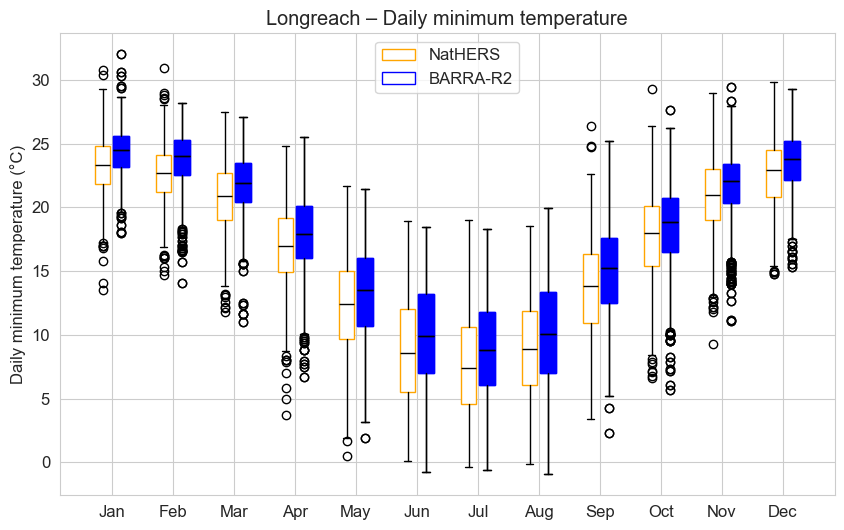

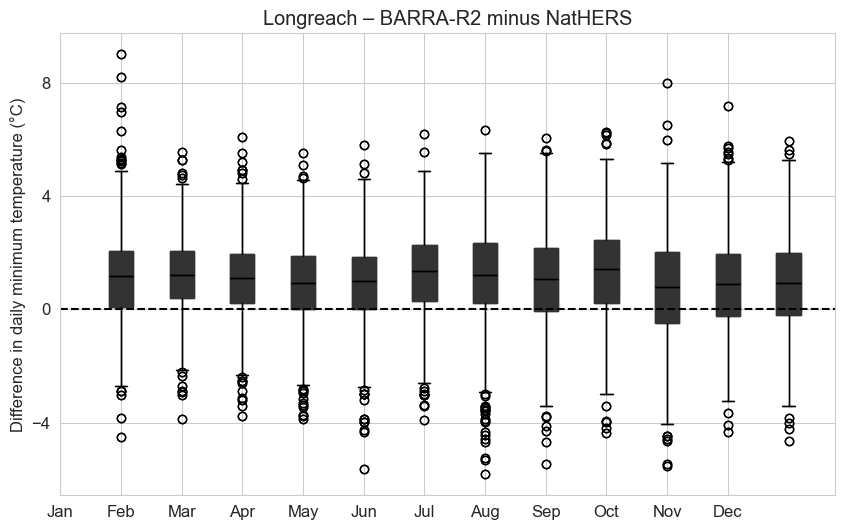


Longreach — DAILY MEAN TEMPERATURE
Longreach    | mean     | Jan | KS: stat= 0.117, p= 0.000 (SIG) | MW: stat=267772.0, p= 0.000 (SIG)
Longreach    | mean     | Feb | KS: stat= 0.135, p= 0.000 (SIG) | MW: stat=216523.0, p= 0.000 (SIG)
Longreach    | mean     | Mar | KS: stat= 0.134, p= 0.000 (SIG) | MW: stat=260611.0, p= 0.000 (SIG)
Longreach    | mean     | Apr | KS: stat= 0.087, p= 0.007 (SIG) | MW: stat=258596.0, p= 0.007 (SIG)
Longreach    | mean     | May | KS: stat= 0.058, p= 0.147 (ns) | MW: stat=284389.0, p= 0.071 (SIG)
Longreach    | mean     | Jun | KS: stat= 0.055, p= 0.212 (ns) | MW: stat=264852.0, p= 0.051 (SIG)
Longreach    | mean     | Jul | KS: stat= 0.053, p= 0.228 (ns) | MW: stat=283499.0, p= 0.056 (SIG)
Longreach    | mean     | Aug | KS: stat= 0.071, p= 0.040 (SIG) | MW: stat=278623.0, p= 0.014 (SIG)
Longreach    | mean     | Sep | KS: stat= 0.089, p= 0.005 (SIG) | MW: stat=249360.0, p= 0.000 (SIG)
Longreach    | mean     | Oct | KS: stat= 0.089, p= 0.004 (SIG) | M

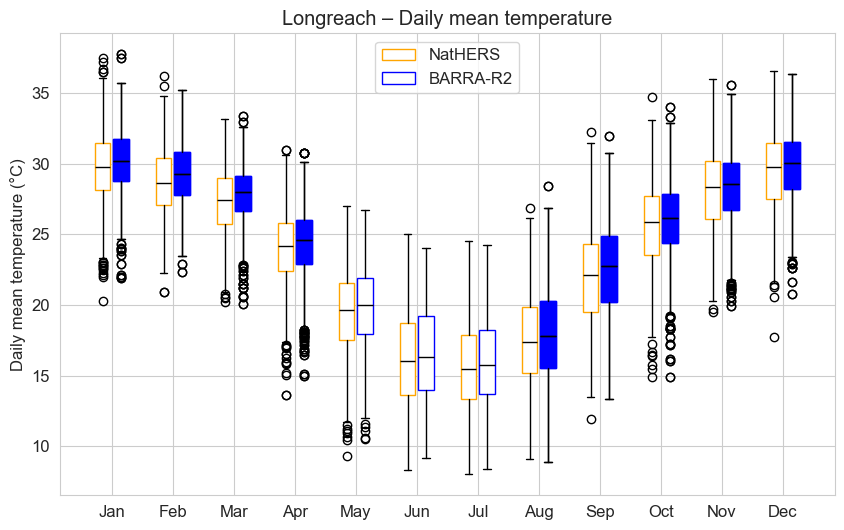

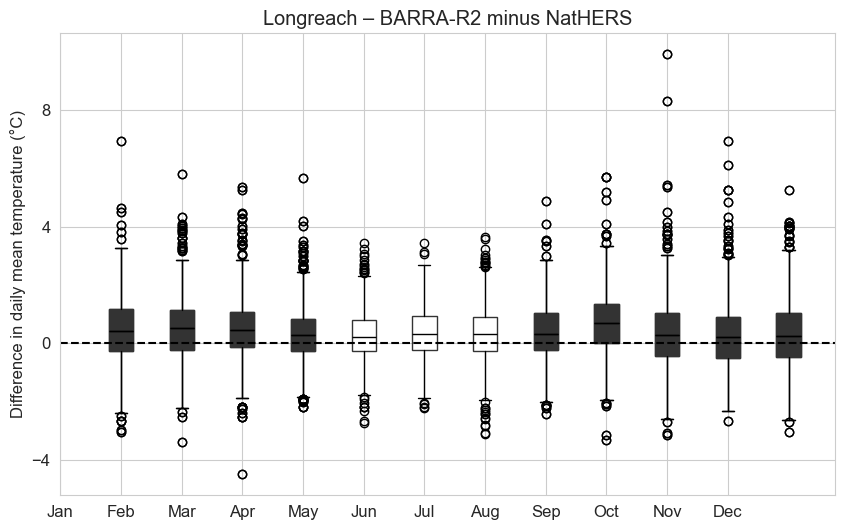


Mildura — DAILY MAXIMUM TEMPERATURE
Mildura      | maximum  | Jan | KS: stat= 0.062, p= 0.103 (ns) | MW: stat=287376.0, p= 0.120 (ns)
Mildura      | maximum  | Feb | KS: stat= 0.057, p= 0.207 (ns) | MW: stat=240835.0, p= 0.274 (ns)
Mildura      | maximum  | Mar | KS: stat= 0.050, p= 0.280 (ns) | MW: stat=294361.0, p= 0.499 (ns)
Mildura      | maximum  | Apr | KS: stat= 0.032, p= 0.838 (ns) | MW: stat=279675.0, p= 0.851 (ns)
Mildura      | maximum  | May | KS: stat= 0.072, p= 0.035 (SIG) | MW: stat=315315.0, p= 0.089 (SIG)
Mildura      | maximum  | Jun | KS: stat= 0.133, p= 0.000 (SIG) | MW: stat=316198.0, p= 0.000 (SIG)
Mildura      | maximum  | Jul | KS: stat= 0.108, p= 0.000 (SIG) | MW: stat=335578.0, p= 0.000 (SIG)
Mildura      | maximum  | Aug | KS: stat= 0.097, p= 0.001 (SIG) | MW: stat=326341.0, p= 0.003 (SIG)
Mildura      | maximum  | Sep | KS: stat= 0.052, p= 0.263 (ns) | MW: stat=289729.0, p= 0.312 (ns)
Mildura      | maximum  | Oct | KS: stat= 0.057, p= 0.164 (ns) | MW: stat

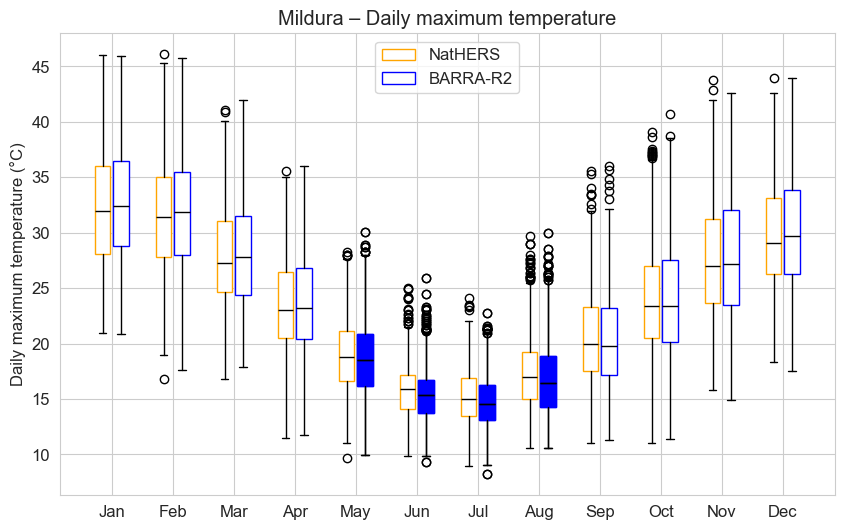

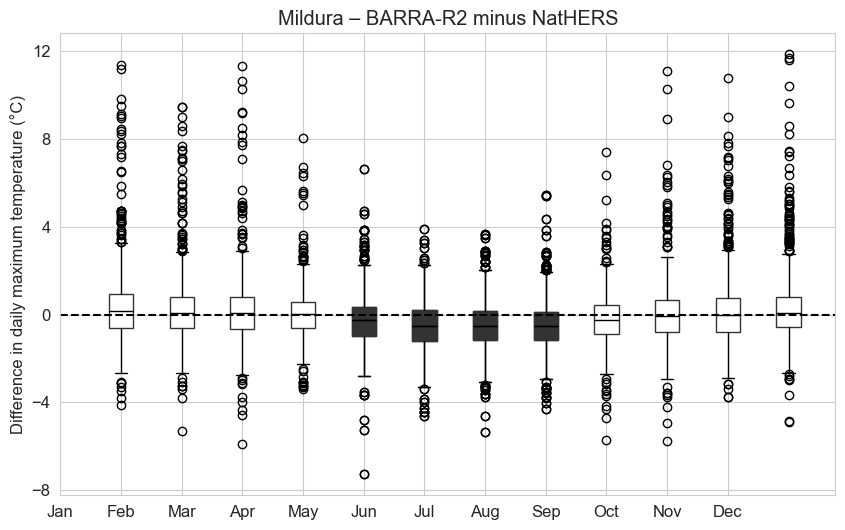


Mildura — DAILY MINIMUM TEMPERATURE
Mildura      | minimum  | Jan | KS: stat= 0.084, p= 0.009 (SIG) | MW: stat=279172.0, p= 0.013 (SIG)
Mildura      | minimum  | Feb | KS: stat= 0.068, p= 0.076 (SIG) | MW: stat=236541.0, p= 0.098 (SIG)
Mildura      | minimum  | Mar | KS: stat= 0.111, p= 0.000 (SIG) | MW: stat=270865.0, p= 0.001 (SIG)
Mildura      | minimum  | Apr | KS: stat= 0.175, p= 0.000 (SIG) | MW: stat=235757.0, p= 0.000 (SIG)
Mildura      | minimum  | May | KS: stat= 0.190, p= 0.000 (SIG) | MW: stat=243008.0, p= 0.000 (SIG)
Mildura      | minimum  | Jun | KS: stat= 0.171, p= 0.000 (SIG) | MW: stat=231147.0, p= 0.000 (SIG)
Mildura      | minimum  | Jul | KS: stat= 0.217, p= 0.000 (SIG) | MW: stat=236605.0, p= 0.000 (SIG)
Mildura      | minimum  | Aug | KS: stat= 0.217, p= 0.000 (SIG) | MW: stat=230145.0, p= 0.000 (SIG)
Mildura      | minimum  | Sep | KS: stat= 0.204, p= 0.000 (SIG) | MW: stat=222013.0, p= 0.000 (SIG)
Mildura      | minimum  | Oct | KS: stat= 0.173, p= 0.000 (SIG)

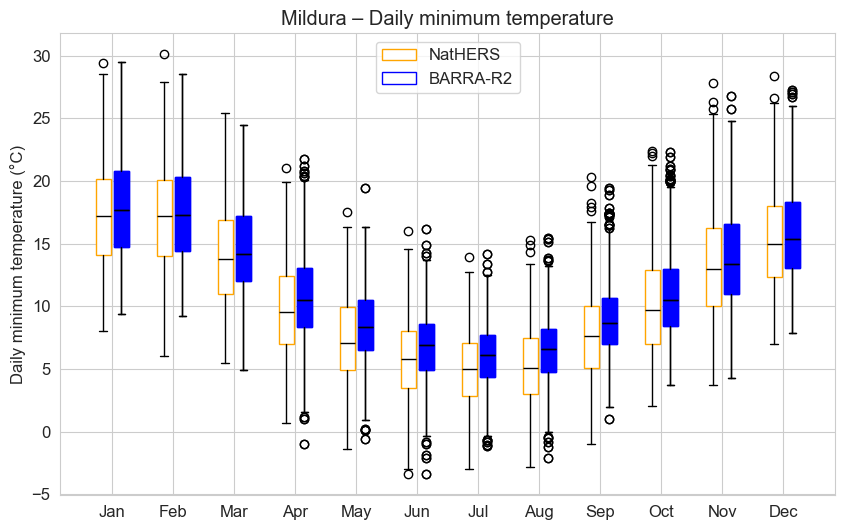

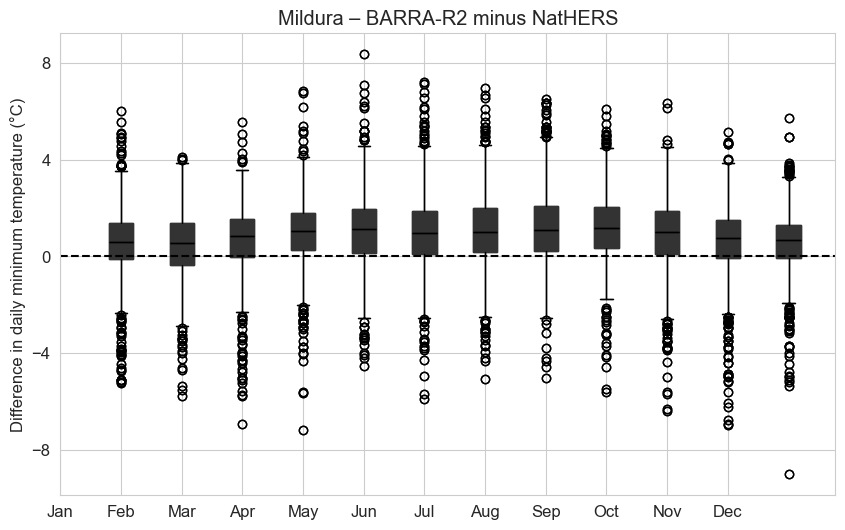


Mildura — DAILY MEAN TEMPERATURE
Mildura      | mean     | Jan | KS: stat= 0.072, p= 0.035 (SIG) | MW: stat=281798.0, p= 0.029 (SIG)
Mildura      | mean     | Feb | KS: stat= 0.058, p= 0.185 (ns) | MW: stat=237164.0, p= 0.116 (ns)
Mildura      | mean     | Mar | KS: stat= 0.055, p= 0.184 (ns) | MW: stat=282074.0, p= 0.038 (SIG)
Mildura      | mean     | Apr | KS: stat= 0.085, p= 0.008 (SIG) | MW: stat=258614.0, p= 0.007 (SIG)
Mildura      | mean     | May | KS: stat= 0.095, p= 0.002 (SIG) | MW: stat=274331.0, p= 0.003 (SIG)
Mildura      | mean     | Jun | KS: stat= 0.084, p= 0.010 (SIG) | MW: stat=264515.0, p= 0.046 (SIG)
Mildura      | mean     | Jul | KS: stat= 0.106, p= 0.000 (SIG) | MW: stat=277256.0, p= 0.009 (SIG)
Mildura      | mean     | Aug | KS: stat= 0.094, p= 0.002 (SIG) | MW: stat=276220.0, p= 0.006 (SIG)
Mildura      | mean     | Sep | KS: stat= 0.081, p= 0.014 (SIG) | MW: stat=256848.0, p= 0.004 (SIG)
Mildura      | mean     | Oct | KS: stat= 0.062, p= 0.102 (ns) | MW: 

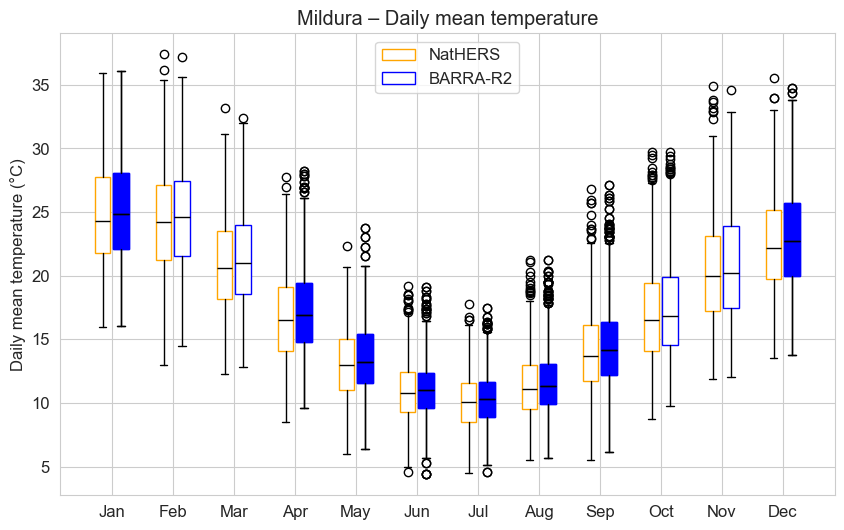

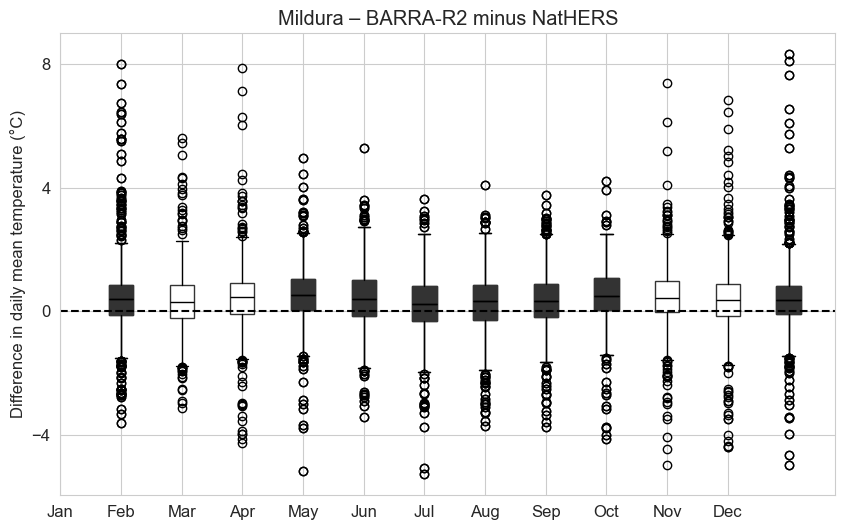


Adelaide — DAILY MAXIMUM TEMPERATURE
Adelaide     | maximum  | Jan | KS: stat= 0.075, p= 0.026 (SIG) | MW: stat=285825.0, p= 0.084 (SIG)
Adelaide     | maximum  | Feb | KS: stat= 0.086, p= 0.010 (SIG) | MW: stat=237144.0, p= 0.115 (ns)
Adelaide     | maximum  | Mar | KS: stat= 0.070, p= 0.046 (SIG) | MW: stat=288198.0, p= 0.169 (ns)
Adelaide     | maximum  | Apr | KS: stat= 0.053, p= 0.237 (ns) | MW: stat=272508.0, p= 0.297 (ns)
Adelaide     | maximum  | May | KS: stat= 0.058, p= 0.147 (ns) | MW: stat=307111.0, p= 0.440 (ns)
Adelaide     | maximum  | Jun | KS: stat= 0.080, p= 0.016 (SIG) | MW: stat=300154.0, p= 0.024 (SIG)
Adelaide     | maximum  | Jul | KS: stat= 0.115, p= 0.000 (SIG) | MW: stat=330119.0, p= 0.001 (SIG)
Adelaide     | maximum  | Aug | KS: stat= 0.119, p= 0.000 (SIG) | MW: stat=330287.0, p= 0.001 (SIG)
Adelaide     | maximum  | Sep | KS: stat= 0.097, p= 0.002 (SIG) | MW: stat=296539.0, p= 0.068 (SIG)
Adelaide     | maximum  | Oct | KS: stat= 0.061, p= 0.116 (ns) | MW:

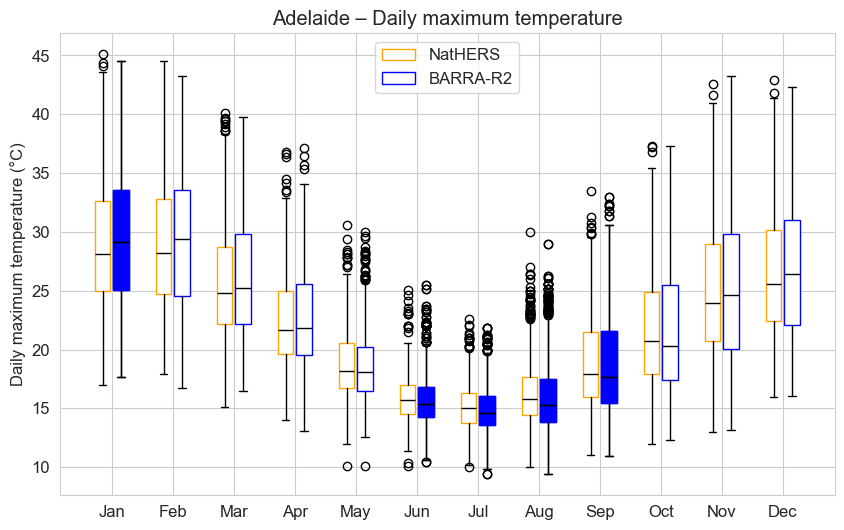

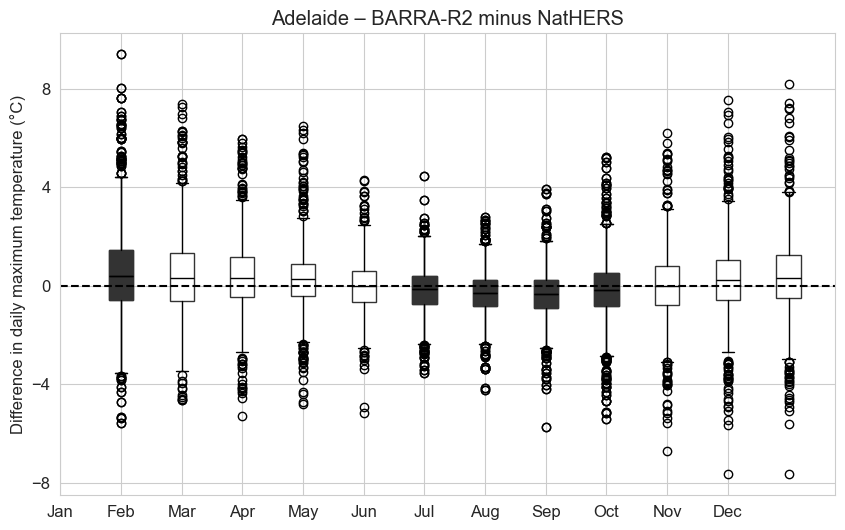


Adelaide — DAILY MINIMUM TEMPERATURE
Adelaide     | minimum  | Jan | KS: stat= 0.116, p= 0.000 (SIG) | MW: stat=259660.0, p= 0.000 (SIG)
Adelaide     | minimum  | Feb | KS: stat= 0.095, p= 0.003 (SIG) | MW: stat=218230.0, p= 0.000 (SIG)
Adelaide     | minimum  | Mar | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=240508.0, p= 0.000 (SIG)
Adelaide     | minimum  | Apr | KS: stat= 0.236, p= 0.000 (SIG) | MW: stat=199140.0, p= 0.000 (SIG)
Adelaide     | minimum  | May | KS: stat= 0.214, p= 0.000 (SIG) | MW: stat=213565.0, p= 0.000 (SIG)
Adelaide     | minimum  | Jun | KS: stat= 0.237, p= 0.000 (SIG) | MW: stat=194311.0, p= 0.000 (SIG)
Adelaide     | minimum  | Jul | KS: stat= 0.221, p= 0.000 (SIG) | MW: stat=206875.0, p= 0.000 (SIG)
Adelaide     | minimum  | Aug | KS: stat= 0.271, p= 0.000 (SIG) | MW: stat=195883.0, p= 0.000 (SIG)
Adelaide     | minimum  | Sep | KS: stat= 0.223, p= 0.000 (SIG) | MW: stat=207063.0, p= 0.000 (SIG)
Adelaide     | minimum  | Oct | KS: stat= 0.181, p= 0.000 (SIG

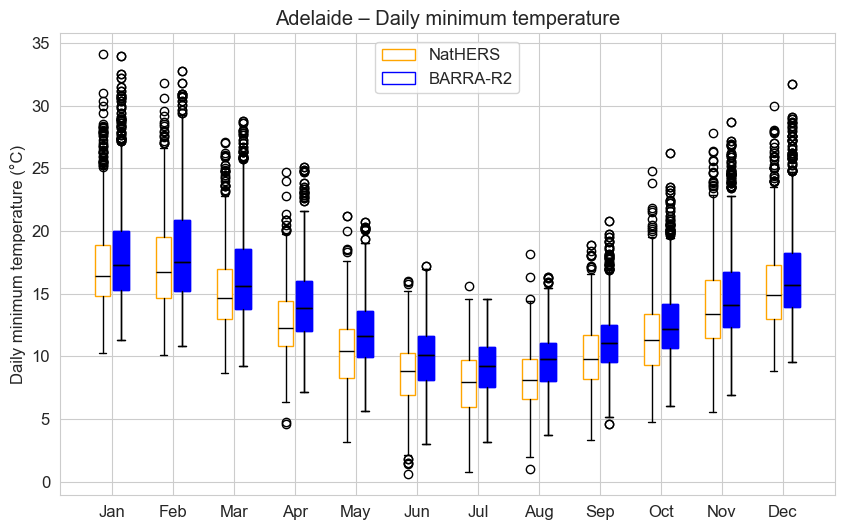

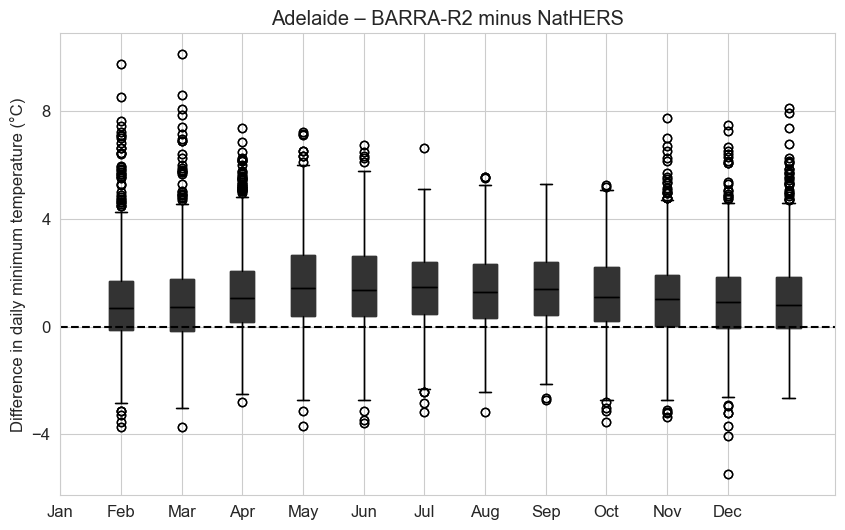


Adelaide — DAILY MEAN TEMPERATURE
Adelaide     | mean     | Jan | KS: stat= 0.088, p= 0.005 (SIG) | MW: stat=276440.0, p= 0.005 (SIG)
Adelaide     | mean     | Feb | KS: stat= 0.092, p= 0.005 (SIG) | MW: stat=229520.0, p= 0.010 (SIG)
Adelaide     | mean     | Mar | KS: stat= 0.090, p= 0.004 (SIG) | MW: stat=268417.0, p= 0.000 (SIG)
Adelaide     | mean     | Apr | KS: stat= 0.112, p= 0.000 (SIG) | MW: stat=237726.0, p= 0.000 (SIG)
Adelaide     | mean     | May | KS: stat= 0.138, p= 0.000 (SIG) | MW: stat=253048.0, p= 0.000 (SIG)
Adelaide     | mean     | Jun | KS: stat= 0.147, p= 0.000 (SIG) | MW: stat=229486.0, p= 0.000 (SIG)
Adelaide     | mean     | Jul | KS: stat= 0.145, p= 0.000 (SIG) | MW: stat=252639.0, p= 0.000 (SIG)
Adelaide     | mean     | Aug | KS: stat= 0.107, p= 0.000 (SIG) | MW: stat=259542.0, p= 0.000 (SIG)
Adelaide     | mean     | Sep | KS: stat= 0.073, p= 0.035 (SIG) | MW: stat=256632.0, p= 0.003 (SIG)
Adelaide     | mean     | Oct | KS: stat= 0.075, p= 0.026 (SIG) |

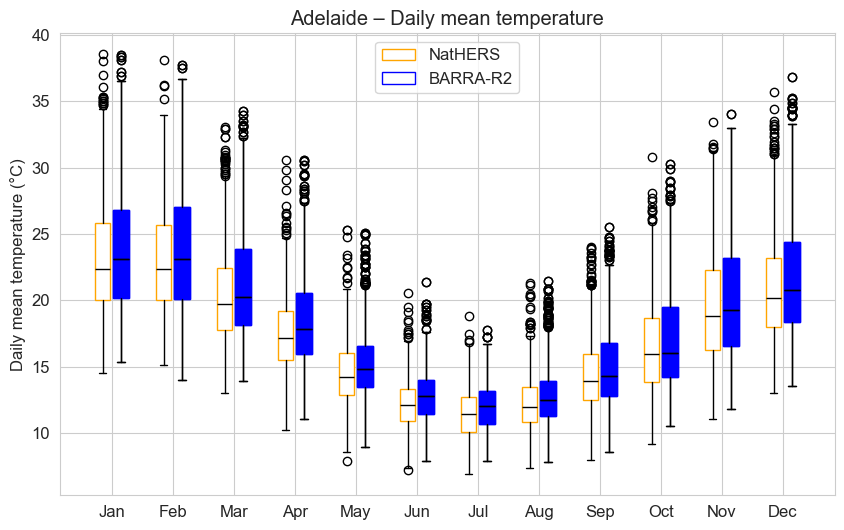

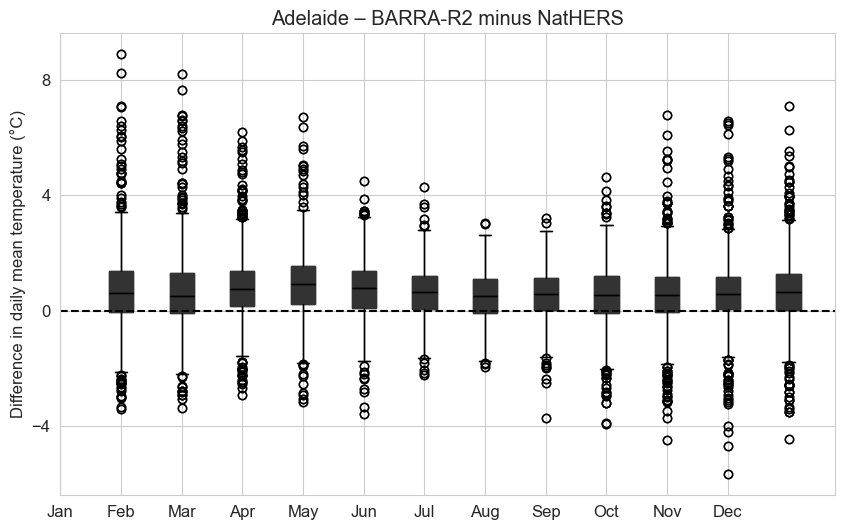


Perth — DAILY MAXIMUM TEMPERATURE
Perth        | maximum  | Jan | KS: stat= 0.104, p= 0.000 (SIG) | MW: stat=266938.0, p= 0.000 (SIG)
Perth        | maximum  | Feb | KS: stat= 0.108, p= 0.001 (SIG) | MW: stat=223334.0, p= 0.001 (SIG)
Perth        | maximum  | Mar | KS: stat= 0.094, p= 0.002 (SIG) | MW: stat=276514.0, p= 0.007 (SIG)
Perth        | maximum  | Apr | KS: stat= 0.037, p= 0.673 (ns) | MW: stat=283939.0, p= 0.749 (ns)
Perth        | maximum  | May | KS: stat= 0.089, p= 0.004 (SIG) | MW: stat=318703.0, p= 0.037 (SIG)
Perth        | maximum  | Jun | KS: stat= 0.127, p= 0.000 (SIG) | MW: stat=314190.0, p= 0.000 (SIG)
Perth        | maximum  | Jul | KS: stat= 0.116, p= 0.000 (SIG) | MW: stat=335662.0, p= 0.000 (SIG)
Perth        | maximum  | Aug | KS: stat= 0.075, p= 0.026 (SIG) | MW: stat=323917.0, p= 0.007 (SIG)
Perth        | maximum  | Sep | KS: stat= 0.045, p= 0.424 (ns) | MW: stat=287701.0, p= 0.442 (ns)
Perth        | maximum  | Oct | KS: stat= 0.061, p= 0.116 (ns) | MW: 

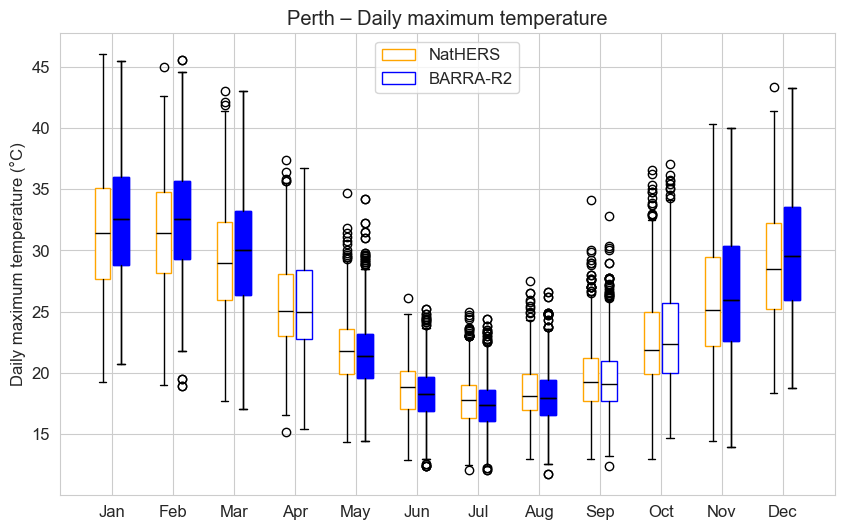

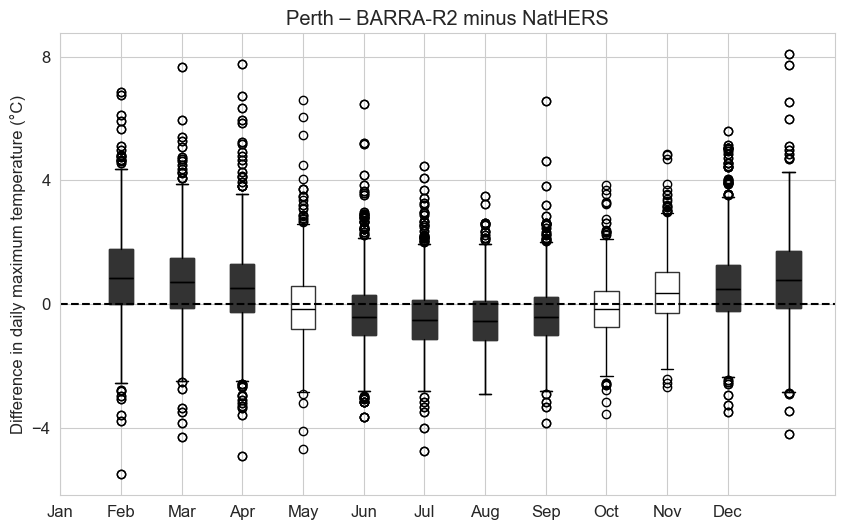


Perth — DAILY MINIMUM TEMPERATURE
Perth        | minimum  | Jan | KS: stat= 0.161, p= 0.000 (SIG) | MW: stat=239118.0, p= 0.000 (SIG)
Perth        | minimum  | Feb | KS: stat= 0.177, p= 0.000 (SIG) | MW: stat=195041.0, p= 0.000 (SIG)
Perth        | minimum  | Mar | KS: stat= 0.205, p= 0.000 (SIG) | MW: stat=218202.0, p= 0.000 (SIG)
Perth        | minimum  | Apr | KS: stat= 0.301, p= 0.000 (SIG) | MW: stat=176877.0, p= 0.000 (SIG)
Perth        | minimum  | May | KS: stat= 0.324, p= 0.000 (SIG) | MW: stat=171243.0, p= 0.000 (SIG)
Perth        | minimum  | Jun | KS: stat= 0.337, p= 0.000 (SIG) | MW: stat=154900.0, p= 0.000 (SIG)
Perth        | minimum  | Jul | KS: stat= 0.311, p= 0.000 (SIG) | MW: stat=168198.0, p= 0.000 (SIG)
Perth        | minimum  | Aug | KS: stat= 0.394, p= 0.000 (SIG) | MW: stat=153351.0, p= 0.000 (SIG)
Perth        | minimum  | Sep | KS: stat= 0.408, p= 0.000 (SIG) | MW: stat=131544.0, p= 0.000 (SIG)
Perth        | minimum  | Oct | KS: stat= 0.341, p= 0.000 (SIG) |

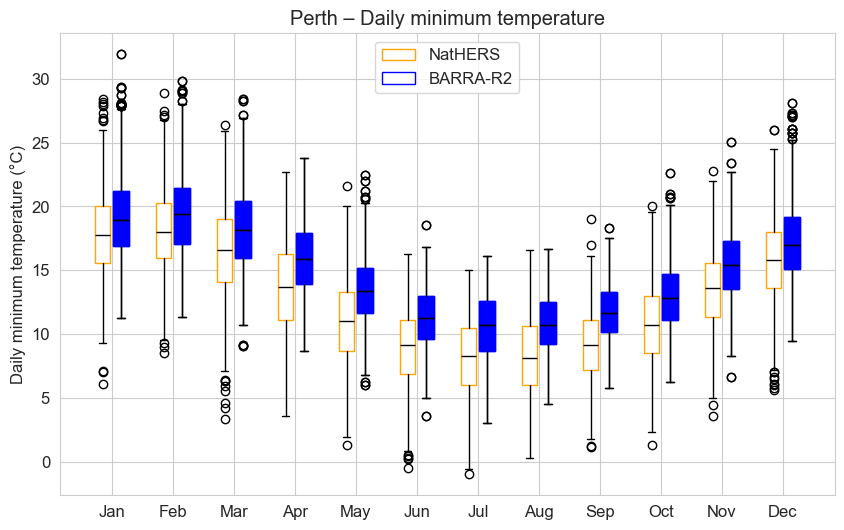

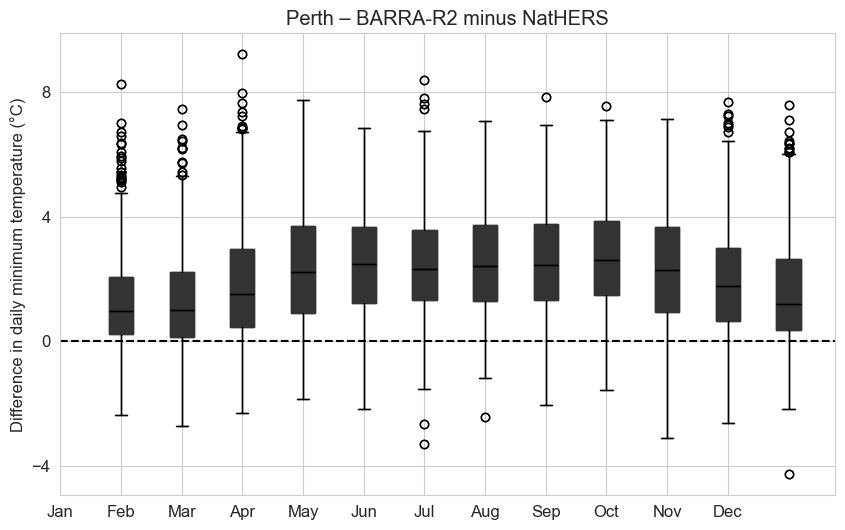


Perth — DAILY MEAN TEMPERATURE
Perth        | mean     | Jan | KS: stat= 0.131, p= 0.000 (SIG) | MW: stat=251381.0, p= 0.000 (SIG)
Perth        | mean     | Feb | KS: stat= 0.135, p= 0.000 (SIG) | MW: stat=207765.0, p= 0.000 (SIG)
Perth        | mean     | Mar | KS: stat= 0.133, p= 0.000 (SIG) | MW: stat=246204.0, p= 0.000 (SIG)
Perth        | mean     | Apr | KS: stat= 0.196, p= 0.000 (SIG) | MW: stat=223132.0, p= 0.000 (SIG)
Perth        | mean     | May | KS: stat= 0.201, p= 0.000 (SIG) | MW: stat=226413.0, p= 0.000 (SIG)
Perth        | mean     | Jun | KS: stat= 0.223, p= 0.000 (SIG) | MW: stat=205169.0, p= 0.000 (SIG)
Perth        | mean     | Jul | KS: stat= 0.214, p= 0.000 (SIG) | MW: stat=218339.0, p= 0.000 (SIG)
Perth        | mean     | Aug | KS: stat= 0.263, p= 0.000 (SIG) | MW: stat=204242.0, p= 0.000 (SIG)
Perth        | mean     | Sep | KS: stat= 0.273, p= 0.000 (SIG) | MW: stat=186397.0, p= 0.000 (SIG)
Perth        | mean     | Oct | KS: stat= 0.225, p= 0.000 (SIG) | MW

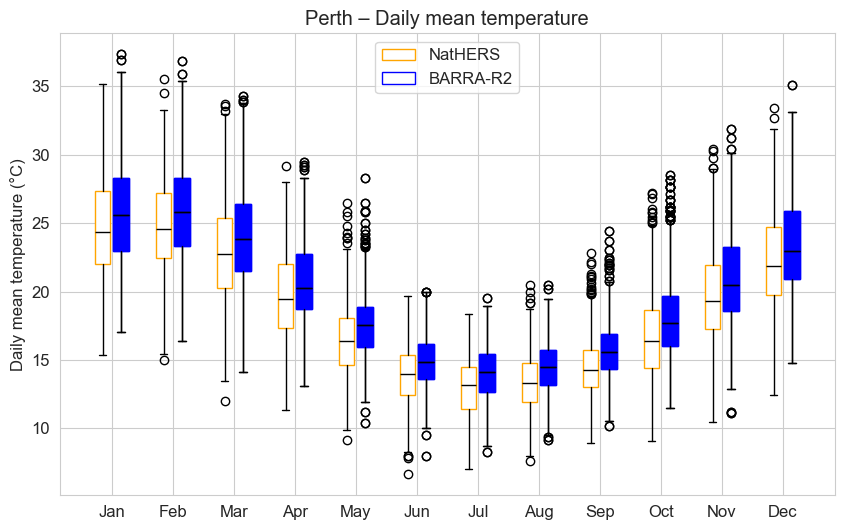

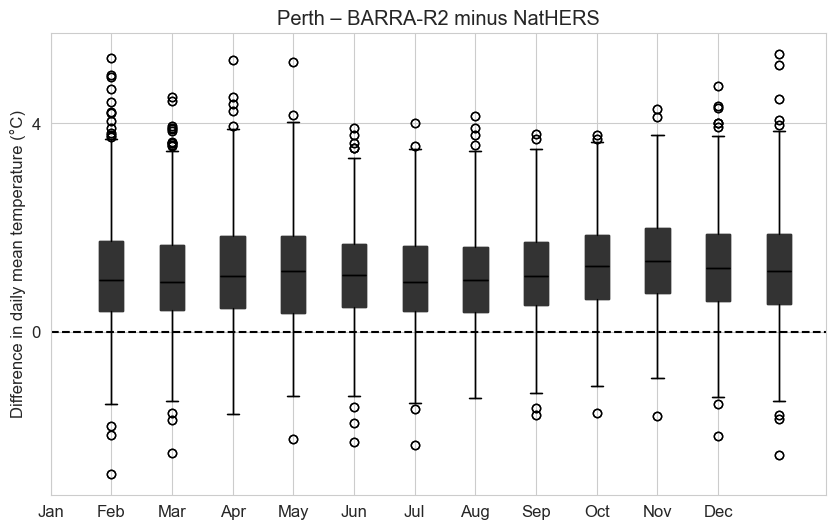


Sydney — DAILY MAXIMUM TEMPERATURE
Sydney       | maximum  | Jan | KS: stat= 0.124, p= 0.000 (SIG) | MW: stat=275616.0, p= 0.004 (SIG)
Sydney       | maximum  | Feb | KS: stat= 0.092, p= 0.005 (SIG) | MW: stat=238280.0, p= 0.153 (ns)
Sydney       | maximum  | Mar | KS: stat= 0.059, p= 0.130 (ns) | MW: stat=297395.0, p= 0.741 (ns)
Sydney       | maximum  | Apr | KS: stat= 0.072, p= 0.041 (SIG) | MW: stat=294818.0, p= 0.106 (ns)
Sydney       | maximum  | May | KS: stat= 0.164, p= 0.000 (SIG) | MW: stat=353376.0, p= 0.000 (SIG)
Sydney       | maximum  | Jun | KS: stat= 0.240, p= 0.000 (SIG) | MW: stat=359589.0, p= 0.000 (SIG)
Sydney       | maximum  | Jul | KS: stat= 0.236, p= 0.000 (SIG) | MW: stat=375052.0, p= 0.000 (SIG)
Sydney       | maximum  | Aug | KS: stat= 0.173, p= 0.000 (SIG) | MW: stat=352384.0, p= 0.000 (SIG)
Sydney       | maximum  | Sep | KS: stat= 0.064, p= 0.093 (SIG) | MW: stat=291995.0, p= 0.200 (ns)
Sydney       | maximum  | Oct | KS: stat= 0.065, p= 0.079 (SIG) | MW:

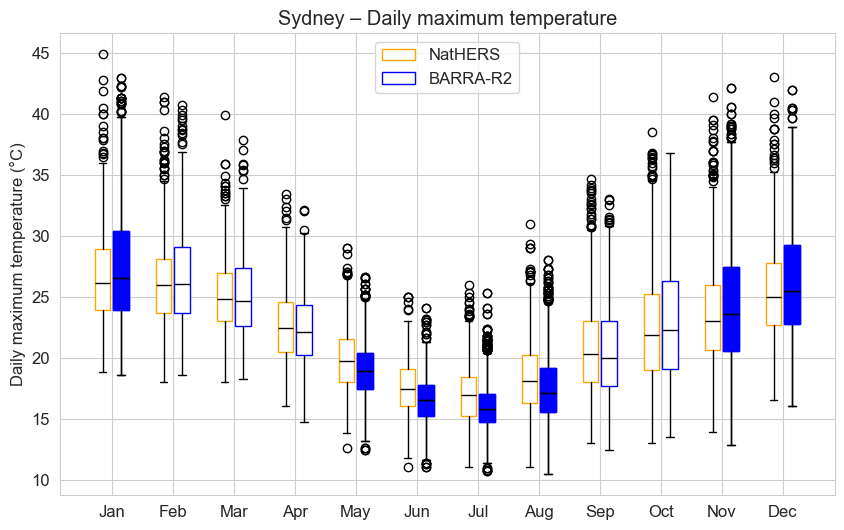

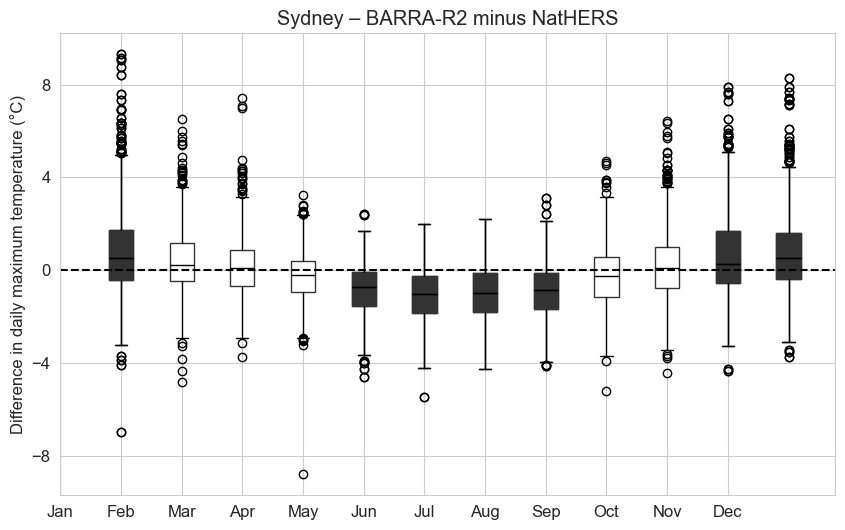


Sydney — DAILY MINIMUM TEMPERATURE
Sydney       | minimum  | Jan | KS: stat= 0.206, p= 0.000 (SIG) | MW: stat=371347.0, p= 0.000 (SIG)
Sydney       | minimum  | Feb | KS: stat= 0.195, p= 0.000 (SIG) | MW: stat=305260.0, p= 0.000 (SIG)
Sydney       | minimum  | Mar | KS: stat= 0.244, p= 0.000 (SIG) | MW: stat=385564.0, p= 0.000 (SIG)
Sydney       | minimum  | Apr | KS: stat= 0.223, p= 0.000 (SIG) | MW: stat=351617.0, p= 0.000 (SIG)
Sydney       | minimum  | May | KS: stat= 0.219, p= 0.000 (SIG) | MW: stat=385156.0, p= 0.000 (SIG)
Sydney       | minimum  | Jun | KS: stat= 0.225, p= 0.000 (SIG) | MW: stat=360224.0, p= 0.000 (SIG)
Sydney       | minimum  | Jul | KS: stat= 0.283, p= 0.000 (SIG) | MW: stat=402121.0, p= 0.000 (SIG)
Sydney       | minimum  | Aug | KS: stat= 0.208, p= 0.000 (SIG) | MW: stat=379944.0, p= 0.000 (SIG)
Sydney       | minimum  | Sep | KS: stat= 0.200, p= 0.000 (SIG) | MW: stat=347091.0, p= 0.000 (SIG)
Sydney       | minimum  | Oct | KS: stat= 0.218, p= 0.000 (SIG) 

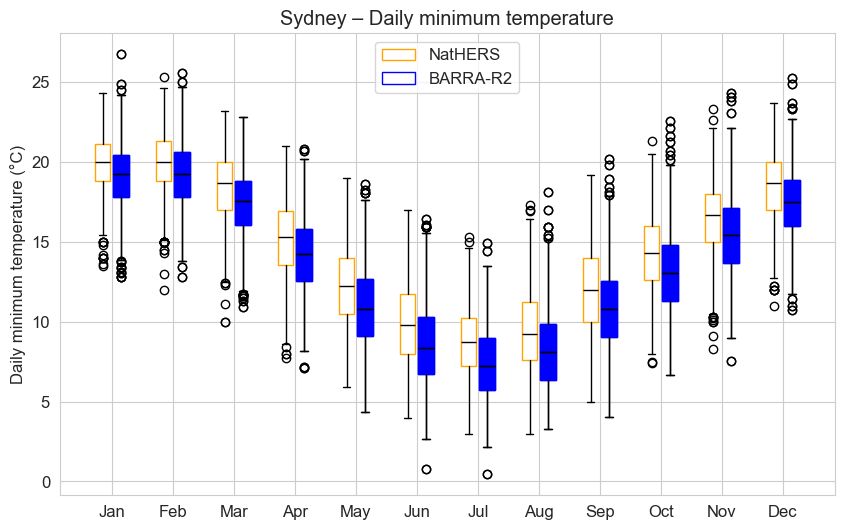

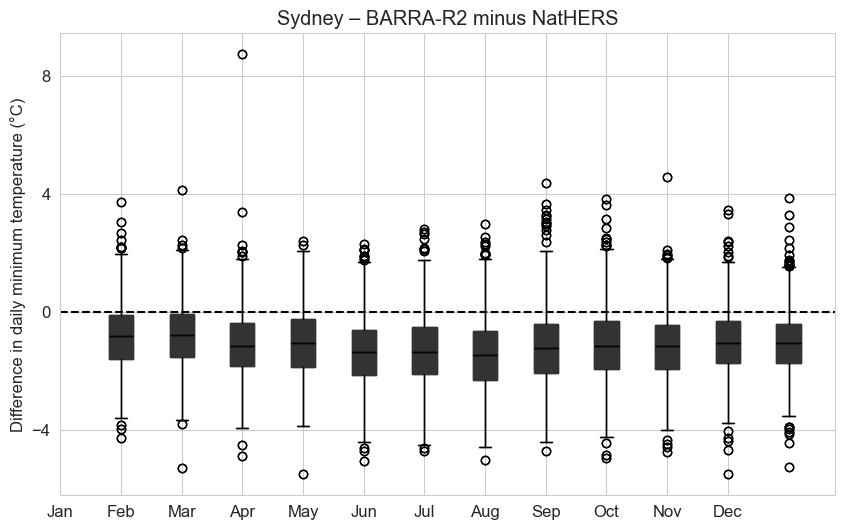


Sydney — DAILY MEAN TEMPERATURE
Sydney       | mean     | Jan | KS: stat= 0.072, p= 0.035 (SIG) | MW: stat=305958.0, p= 0.581 (ns)
Sydney       | mean     | Feb | KS: stat= 0.086, p= 0.010 (SIG) | MW: stat=263858.0, p= 0.056 (SIG)
Sydney       | mean     | Mar | KS: stat= 0.124, p= 0.000 (SIG) | MW: stat=338261.0, p= 0.000 (SIG)
Sydney       | mean     | Apr | KS: stat= 0.167, p= 0.000 (SIG) | MW: stat=329146.0, p= 0.000 (SIG)
Sydney       | mean     | May | KS: stat= 0.209, p= 0.000 (SIG) | MW: stat=384508.0, p= 0.000 (SIG)
Sydney       | mean     | Jun | KS: stat= 0.275, p= 0.000 (SIG) | MW: stat=377762.0, p= 0.000 (SIG)
Sydney       | mean     | Jul | KS: stat= 0.311, p= 0.000 (SIG) | MW: stat=414414.0, p= 0.000 (SIG)
Sydney       | mean     | Aug | KS: stat= 0.241, p= 0.000 (SIG) | MW: stat=380873.0, p= 0.000 (SIG)
Sydney       | mean     | Sep | KS: stat= 0.135, p= 0.000 (SIG) | MW: stat=321308.0, p= 0.000 (SIG)
Sydney       | mean     | Oct | KS: stat= 0.093, p= 0.002 (SIG) | MW

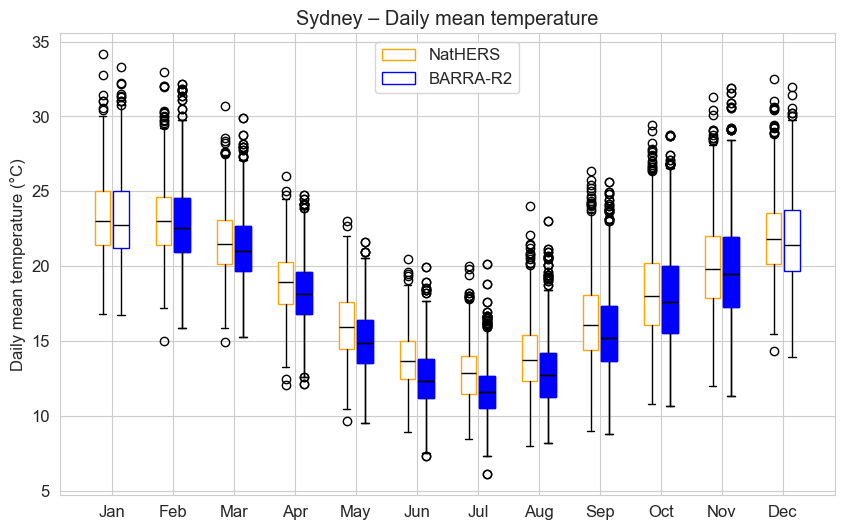

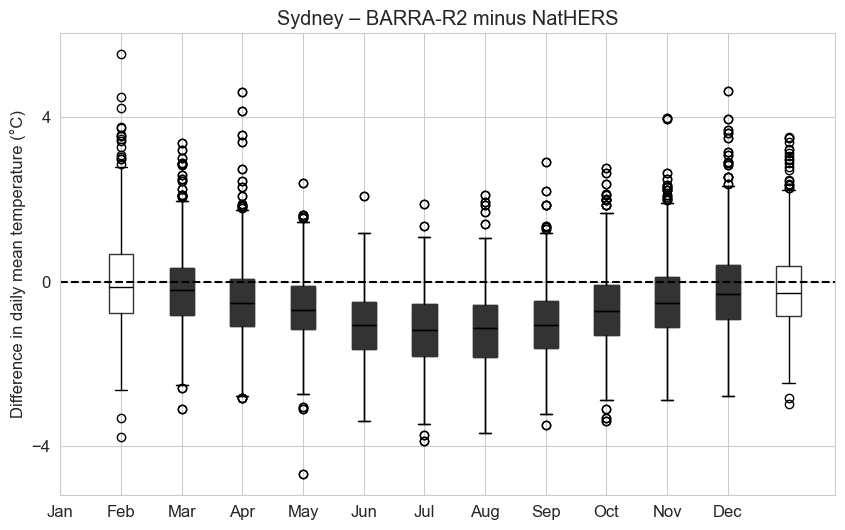


Canberra — DAILY MAXIMUM TEMPERATURE
Canberra     | maximum  | Jan | KS: stat= 0.112, p= 0.000 (SIG) | MW: stat=332918.0, p= 0.000 (SIG)
Canberra     | maximum  | Feb | KS: stat= 0.110, p= 0.000 (SIG) | MW: stat=279005.0, p= 0.000 (SIG)
Canberra     | maximum  | Mar | KS: stat= 0.130, p= 0.000 (SIG) | MW: stat=343287.0, p= 0.000 (SIG)
Canberra     | maximum  | Apr | KS: stat= 0.160, p= 0.000 (SIG) | MW: stat=330474.0, p= 0.000 (SIG)
Canberra     | maximum  | May | KS: stat= 0.249, p= 0.000 (SIG) | MW: stat=388001.0, p= 0.000 (SIG)
Canberra     | maximum  | Jun | KS: stat= 0.311, p= 0.000 (SIG) | MW: stat=385676.0, p= 0.000 (SIG)
Canberra     | maximum  | Jul | KS: stat= 0.360, p= 0.000 (SIG) | MW: stat=426005.0, p= 0.000 (SIG)
Canberra     | maximum  | Aug | KS: stat= 0.254, p= 0.000 (SIG) | MW: stat=390088.0, p= 0.000 (SIG)
Canberra     | maximum  | Sep | KS: stat= 0.133, p= 0.000 (SIG) | MW: stat=324510.0, p= 0.000 (SIG)
Canberra     | maximum  | Oct | KS: stat= 0.105, p= 0.000 (SIG

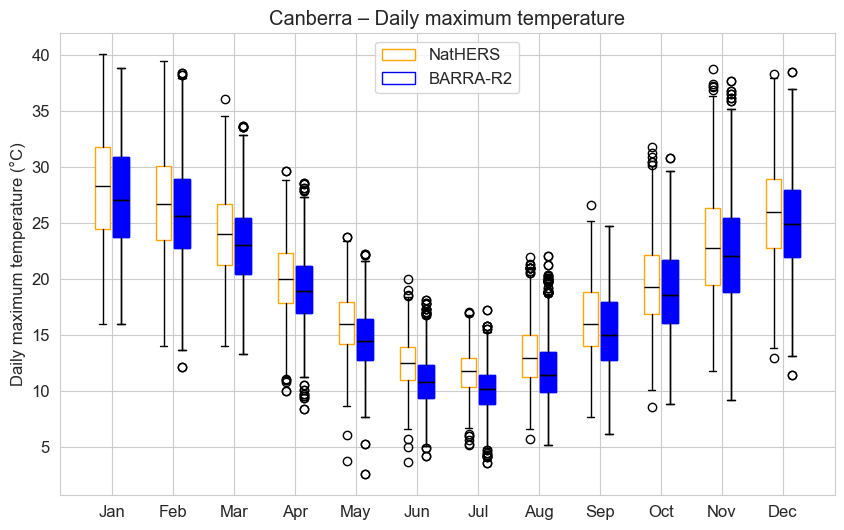

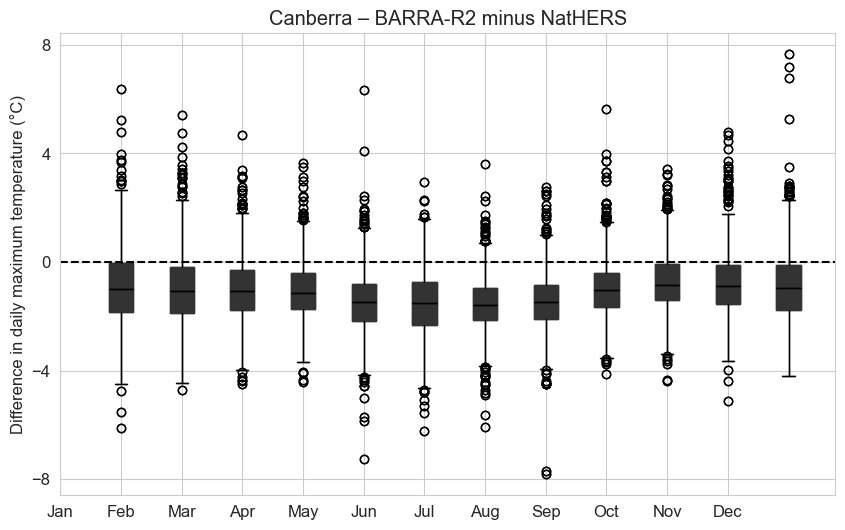


Canberra — DAILY MINIMUM TEMPERATURE
Canberra     | minimum  | Jan | KS: stat= 0.089, p= 0.004 (SIG) | MW: stat=321446.0, p= 0.021 (SIG)
Canberra     | minimum  | Feb | KS: stat= 0.055, p= 0.232 (ns) | MW: stat=249289.0, p= 0.993 (ns)
Canberra     | minimum  | Mar | KS: stat= 0.062, p= 0.102 (ns) | MW: stat=301929.0, p= 0.854 (ns)
Canberra     | minimum  | Apr | KS: stat= 0.083, p= 0.012 (SIG) | MW: stat=267533.0, p= 0.102 (ns)
Canberra     | minimum  | May | KS: stat= 0.102, p= 0.001 (SIG) | MW: stat=275597.0, p= 0.005 (SIG)
Canberra     | minimum  | Jun | KS: stat= 0.159, p= 0.000 (SIG) | MW: stat=245260.0, p= 0.000 (SIG)
Canberra     | minimum  | Jul | KS: stat= 0.177, p= 0.000 (SIG) | MW: stat=257122.0, p= 0.000 (SIG)
Canberra     | minimum  | Aug | KS: stat= 0.143, p= 0.000 (SIG) | MW: stat=271351.0, p= 0.001 (SIG)
Canberra     | minimum  | Sep | KS: stat= 0.148, p= 0.000 (SIG) | MW: stat=254331.0, p= 0.001 (SIG)
Canberra     | minimum  | Oct | KS: stat= 0.130, p= 0.000 (SIG) | M

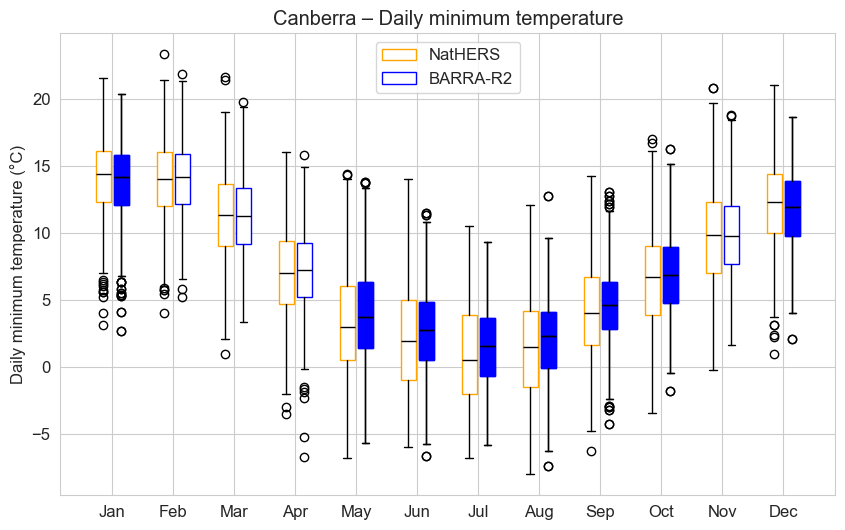

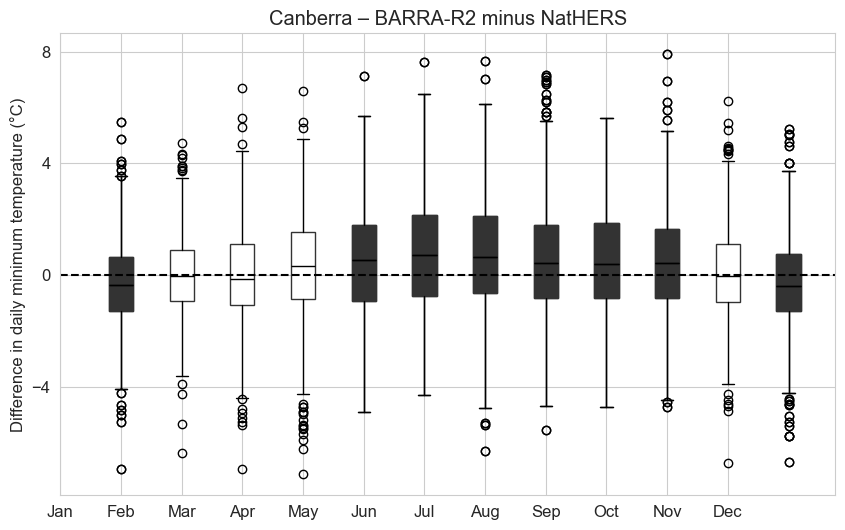


Canberra — DAILY MEAN TEMPERATURE
Canberra     | mean     | Jan | KS: stat= 0.085, p= 0.007 (SIG) | MW: stat=330640.0, p= 0.001 (SIG)
Canberra     | mean     | Feb | KS: stat= 0.085, p= 0.012 (SIG) | MW: stat=270189.0, p= 0.006 (SIG)
Canberra     | mean     | Mar | KS: stat= 0.094, p= 0.002 (SIG) | MW: stat=329243.0, p= 0.001 (SIG)
Canberra     | mean     | Apr | KS: stat= 0.085, p= 0.008 (SIG) | MW: stat=303902.0, p= 0.007 (SIG)
Canberra     | mean     | May | KS: stat= 0.105, p= 0.000 (SIG) | MW: stat=330591.0, p= 0.001 (SIG)
Canberra     | mean     | Jun | KS: stat= 0.081, p= 0.014 (SIG) | MW: stat=304972.0, p= 0.005 (SIG)
Canberra     | mean     | Jul | KS: stat= 0.103, p= 0.001 (SIG) | MW: stat=328584.0, p= 0.001 (SIG)
Canberra     | mean     | Aug | KS: stat= 0.101, p= 0.001 (SIG) | MW: stat=332590.0, p= 0.000 (SIG)
Canberra     | mean     | Sep | KS: stat= 0.080, p= 0.016 (SIG) | MW: stat=295982.0, p= 0.079 (SIG)
Canberra     | mean     | Oct | KS: stat= 0.046, p= 0.373 (ns) | 

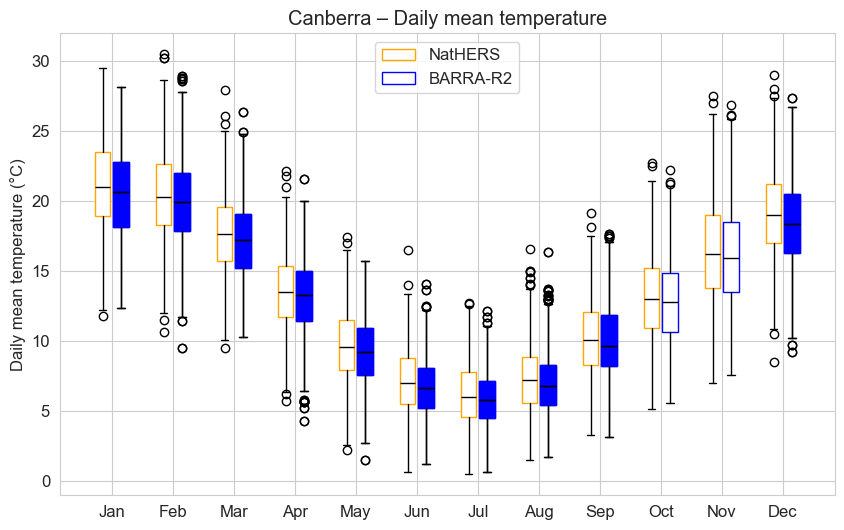

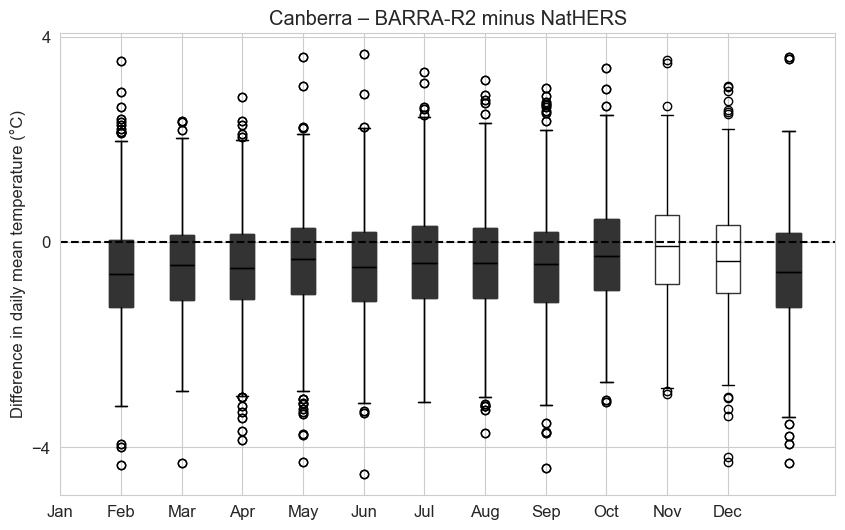


Hobart — DAILY MAXIMUM TEMPERATURE
Hobart       | maximum  | Jan | KS: stat= 0.265, p= 0.000 (SIG) | MW: stat=391730.0, p= 0.000 (SIG)
Hobart       | maximum  | Feb | KS: stat= 0.252, p= 0.000 (SIG) | MW: stat=318993.0, p= 0.000 (SIG)
Hobart       | maximum  | Mar | KS: stat= 0.356, p= 0.000 (SIG) | MW: stat=418297.0, p= 0.000 (SIG)
Hobart       | maximum  | Apr | KS: stat= 0.375, p= 0.000 (SIG) | MW: stat=414388.0, p= 0.000 (SIG)
Hobart       | maximum  | May | KS: stat= 0.508, p= 0.000 (SIG) | MW: stat=488731.0, p= 0.000 (SIG)
Hobart       | maximum  | Jun | KS: stat= 0.532, p= 0.000 (SIG) | MW: stat=469725.0, p= 0.000 (SIG)
Hobart       | maximum  | Jul | KS: stat= 0.575, p= 0.000 (SIG) | MW: stat=519500.0, p= 0.000 (SIG)
Hobart       | maximum  | Aug | KS: stat= 0.466, p= 0.000 (SIG) | MW: stat=481113.0, p= 0.000 (SIG)
Hobart       | maximum  | Sep | KS: stat= 0.429, p= 0.000 (SIG) | MW: stat=433422.0, p= 0.000 (SIG)
Hobart       | maximum  | Oct | KS: stat= 0.366, p= 0.000 (SIG) 

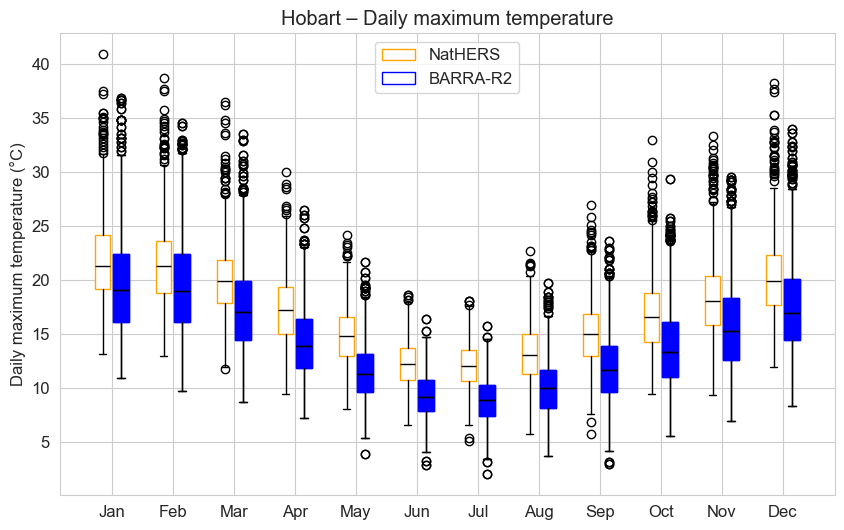

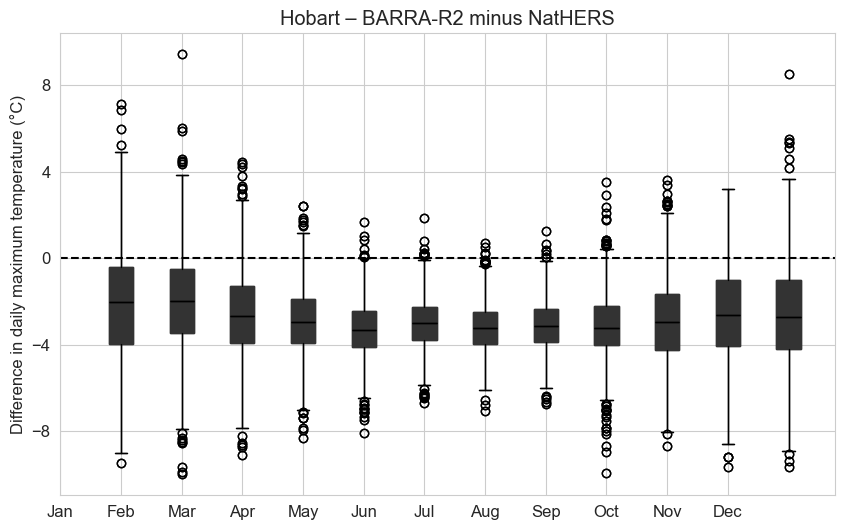


Hobart — DAILY MINIMUM TEMPERATURE
Hobart       | minimum  | Jan | KS: stat= 0.483, p= 0.000 (SIG) | MW: stat=486188.0, p= 0.000 (SIG)
Hobart       | minimum  | Feb | KS: stat= 0.462, p= 0.000 (SIG) | MW: stat=394319.0, p= 0.000 (SIG)
Hobart       | minimum  | Mar | KS: stat= 0.418, p= 0.000 (SIG) | MW: stat=462986.0, p= 0.000 (SIG)
Hobart       | minimum  | Apr | KS: stat= 0.407, p= 0.000 (SIG) | MW: stat=430572.0, p= 0.000 (SIG)
Hobart       | minimum  | May | KS: stat= 0.382, p= 0.000 (SIG) | MW: stat=455372.0, p= 0.000 (SIG)
Hobart       | minimum  | Jun | KS: stat= 0.393, p= 0.000 (SIG) | MW: stat=429159.0, p= 0.000 (SIG)
Hobart       | minimum  | Jul | KS: stat= 0.450, p= 0.000 (SIG) | MW: stat=470251.0, p= 0.000 (SIG)
Hobart       | minimum  | Aug | KS: stat= 0.421, p= 0.000 (SIG) | MW: stat=466539.0, p= 0.000 (SIG)
Hobart       | minimum  | Sep | KS: stat= 0.396, p= 0.000 (SIG) | MW: stat=431019.0, p= 0.000 (SIG)
Hobart       | minimum  | Oct | KS: stat= 0.440, p= 0.000 (SIG) 

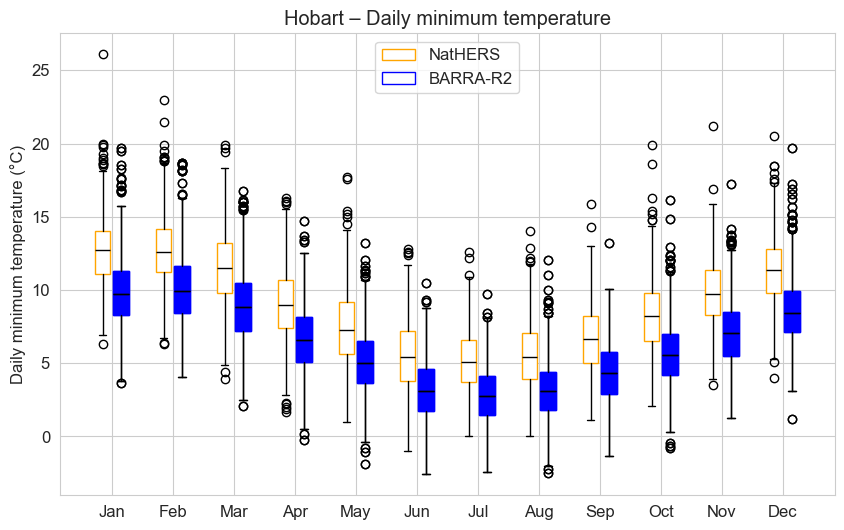

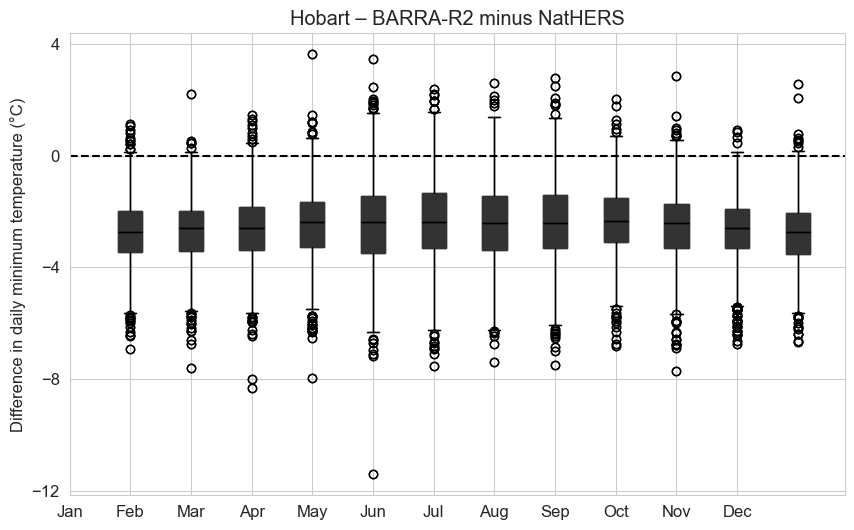


Hobart — DAILY MEAN TEMPERATURE
Hobart       | mean     | Jan | KS: stat= 0.380, p= 0.000 (SIG) | MW: stat=439668.0, p= 0.000 (SIG)
Hobart       | mean     | Feb | KS: stat= 0.344, p= 0.000 (SIG) | MW: stat=357972.0, p= 0.000 (SIG)
Hobart       | mean     | Mar | KS: stat= 0.408, p= 0.000 (SIG) | MW: stat=450348.0, p= 0.000 (SIG)
Hobart       | mean     | Apr | KS: stat= 0.435, p= 0.000 (SIG) | MW: stat=435955.0, p= 0.000 (SIG)
Hobart       | mean     | May | KS: stat= 0.497, p= 0.000 (SIG) | MW: stat=490133.0, p= 0.000 (SIG)
Hobart       | mean     | Jun | KS: stat= 0.496, p= 0.000 (SIG) | MW: stat=469242.0, p= 0.000 (SIG)
Hobart       | mean     | Jul | KS: stat= 0.572, p= 0.000 (SIG) | MW: stat=518111.0, p= 0.000 (SIG)
Hobart       | mean     | Aug | KS: stat= 0.477, p= 0.000 (SIG) | MW: stat=493058.0, p= 0.000 (SIG)
Hobart       | mean     | Sep | KS: stat= 0.455, p= 0.000 (SIG) | MW: stat=450194.0, p= 0.000 (SIG)
Hobart       | mean     | Oct | KS: stat= 0.423, p= 0.000 (SIG) | M

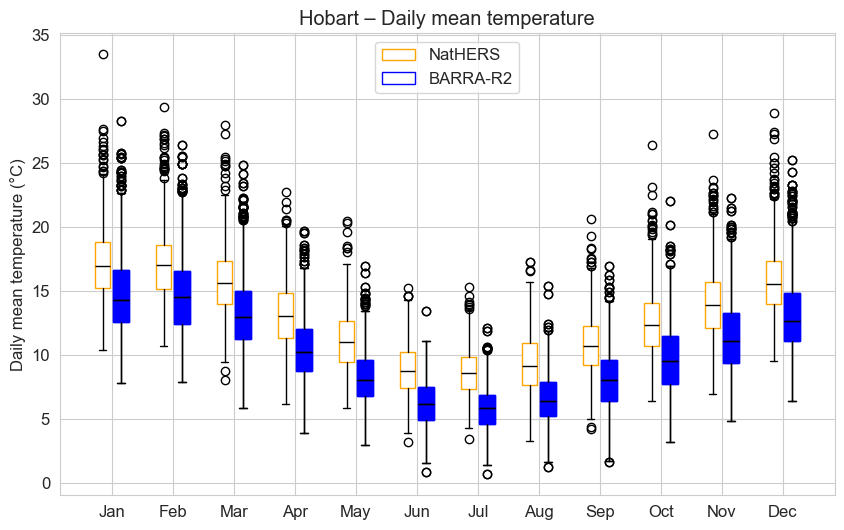

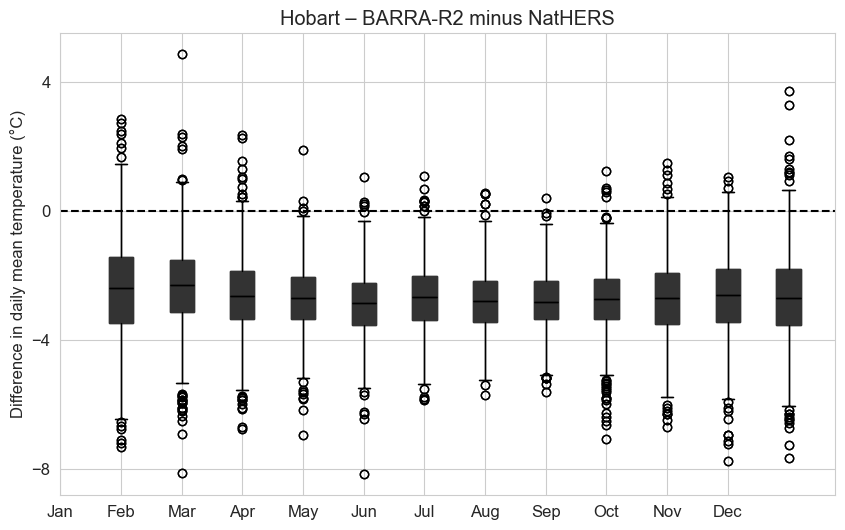

In [19]:
for l in da["loc"].values:
    display_location_header(l)
    data = convert_to_local_time(da,l)
    
    plot_monthly_daily_distribution_xr(
        data,
        loc=l,
        obs_source="NatHERS",
        model_source="BARRA-R2",
        stat_type_list=("maximum", "minimum", "mean"),
    )
